## **Table of Contents**  
* 0. Supporting Functions  
* 1. Data Preprocessing  
  * 1.1 Dealing with Duplicate Values  
  * 1.2 Dealing with is_chain  
  * 1.3 Dealing with Missing Values  
  * 1.4 Removing Strange Values  
  * 1.5 Converting the Data Types  
  * 1.6 Dealing with Outliers  
* 2. Feature Creation  
  * 2.1 payment_method_combined  
  * 2.2 city  
  * 2.3 tot_orders_per_client  
  * 2.4 tot_money_spent_per_client  
  * 2.5 CUI Binary Variables, num_unique_cuisines_tried, client_behavior_cuisine_preference  
  * 2.6 peak_days_num_orders, off_peak_days_num_orders and client_behavior_peak_preference  
  * 2.7 morning_num_orders, afternoon_num_orders, evening_num_orders and night_num_orders  
  * 2.8 avg_money_spent_per_order  
  * 2.9 avg_products_per_order  
  * 2.10 tot_non_chain_orders, client_behaviour_chain_preference, percent_chain_orders  
* 3. EDA  
* 4. Feature Transformation  
* 5. Feature Scaling  
* 6. Removing multivariate outliers using DBSCAN  
* 7. Segmentation Perspectives
  * 7.1 Value and Preference Perspective 
    * 7.1.1 Feature Selection  
    * 7.1.2 K-Means Clustering  
    * 7.1.3 Hierarchical Clustering  
    * 7.1.4 Two level approach - SOM + hierarchical clustering  
    * 7.1.5 Final model selection  
  * 7.2 Activity and Engagement Perspective  
    * 7.2.1 Feature Selection  
    * 7.2.2 K-Means Clustering  
    * 7.2.3 Hierarchical Clustering  
    * 7.2.4 Two level approach - SOM + hierarchical clustering  
    * 7.2.5 Final model selection  
* 8. Cluster Profiling
  * 8.1 Analyze final clustering solution for each perspective
    * 8.1.1 Analyze Value and Preference perspective
    * 8.1.2 Analyze Activity and Engament perspective 
  * 8.2 Merging both perspectives
    * 8.2.1 Merging Clusters using Manual approach
    * 8.2.2 Merging Clusters using Hierarchical Clustering
    * 8.2.3 Comparing the two final solutions
  * 8.3 Analyse Final Cluster Solution
    * 8.3.1 EDA for features during the clustering process
    * 8.3.2 EDA for unused features
  * 8.4 Visualyzing Final Cluster Solution
    * 8.4.1 T-SNE
  * 8.5 Feature Importance
    * 8.5.1 Semi Supervised Classification - Decision Tree
  * 8.6 Outlier classification prediction




## Group Composition

#### Joao Henriques, 20240499
#### Julia Karpienia, 20240514
#### Maria Radix, 20240687
#### Mariana Sousa, 20240516

In [563]:
# pip install umap-learn

In [397]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import chi2
import math
import os

from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split

import scipy.stats as ss
import warnings

import copy 
import numpy as np
import pandas as pd
import seaborn as sns
import scipy as sp
from scipy.stats import chi2
from sklearn.covariance import MinCovDet
from sklearn.decomposition import PCA
import scipy
import itertools
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import mpl_axes_aligner

from sklearn.impute import KNNImputer
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from minisom import MiniSom
from sklearn.metrics.pairwise import euclidean_distances

from matplotlib.patches import RegularPolygon
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.colors as mpl_colors
from matplotlib import cm

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import pairwise_distances

from sklearn.manifold import TSNE
from umap.umap_ import UMAP

import graphviz
from joblib import dump
import os

sns.set_style("white")

# Remove warnings
warnings.simplefilter(action='ignore', category=pd.errors.SettingWithCopyWarning)

# 0. Supporting Functions

In [4]:
def outlier_detection(df, features):
    if isinstance(features, str):
        features = [features]

    for feature in features:
        q3 = df[feature].quantile(0.75)
        q1 = df[feature].quantile(0.25)
        percentil_95 = round(df[feature].quantile(0.95),2)
        percentil_99 = round(df[feature].quantile(0.99),2)
        max = df[feature].max()
        min = df[feature].min()
        iqr = q3 - q1 

        #No lower bound moderate or extreme outliers in any feature
        num_mod_outl = df[feature].loc[(df[feature] > q3 + (1.5*iqr)) & (df[feature] < q3 + (3*iqr))].count()
        num_ext_outl = df[feature].loc[df[feature] > q3 + 3*iqr].count()

        total_outl = num_mod_outl + num_ext_outl
        if num_mod_outl != 0 and num_ext_outl!= 0:
            mod_outl_perc = int((num_mod_outl/total_outl)*100)
            ext_outl_perc = int((num_ext_outl/total_outl)*100)
        else:
            mod_outl_perc = ''
            ext_outl_perc = ''


        print(f"{feature}: \nNumber of extreme outliers: {num_ext_outl} ({ext_outl_perc}%) \nNumber of moderate outliers: {num_mod_outl} ({mod_outl_perc}%) \nTotal number of outliers: {total_outl}")
        print(f"Q3 + 1.5*IQR = {round(q3 + 1.5* iqr,2)} \nQ3 + 3*IQR = {round(q3 + 3* iqr,2)}\nMax: {max} \nMin: {min} \n95th percentil: {percentil_95}\n99th percentil: {percentil_99} \n")


def cor_heatmap(cor):
    mask = np.triu(np.ones_like(cor, dtype=bool))  # Mask for the upper triangle
    plt.figure(figsize=(40, 30))
    sns.heatmap(data=cor, annot=True, cmap=plt.cm.Reds, fmt='.1f', mask=mask, linewidths=0.5)
    plt.title("Spearman Correlation Matrix", fontsize=24)
    plt.show()


# Importing the dataset

In [5]:
# import dataset
path = os.path.join('data/data_set_after1st_notebook.csv')
df = pd.read_csv(path, index_col='customer_id')


In [6]:
df.head()

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,2360.0,18.0,2,5,1,0.0,1,DELIVERY,DIGI,0.00,...,0,0,0,0,2,0,0,0,0,0
5d272b9dcb,8670.0,17.0,2,2,2,0.0,1,DISCOUNT,DIGI,12.82,...,0,0,0,0,0,0,0,0,0,0
f6d1b2ba63,4660.0,38.0,1,2,2,0.0,1,DISCOUNT,CASH,9.20,...,0,0,0,0,0,0,0,0,0,0
180c632ed8,4660.0,NaN,2,3,1,0.0,2,DELIVERY,DIGI,0.00,...,1,0,0,0,0,0,0,0,0,0
4eb37a6705,4660.0,20.0,2,5,0,0.0,2,NO PROMO USED,DIGI,14.57,...,0,0,0,0,0,0,0,0,0,0


# 1. Data preprocessing

## 1.1 Dealing with Duplicate Values

Regarding duplicate values it's important to distinguish between two types
 - > Data duplicates: Detected using df.duplicated() it checks for rows in the DataFrame where all the values in the columns are identical, ignoring the index
 - > Index duplicates: Detected using df.index.duplicated() it checks for duplicate values only in the index of the DataFrame

In [7]:
path = os.path.join('data/dups_after1st_notebook.csv')
df_duplicates_treated = pd.read_csv(path, index_col='customer_id')

Data duplicates

In [8]:
df_duplicates_treated.duplicated().sum()

60

In [9]:
# Filter duplicates (keep=False ensures all instances of duplicates are included)
duplicates = df_duplicates_treated.loc[df_duplicates_treated.duplicated(keep=False), :]

# Sort by all columns to group duplicates together
duplicates_sorted = duplicates.sort_values(by=duplicates.columns.tolist())

duplicates_sorted

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,
837c49ea1b,2360,23.0,1,2,0,35.0,35,FREEBIE,DIGI,0.0,...,0,0,1,0,0,0,0,0,0,0
43d871453a,2360,23.0,1,2,0,35.0,35,FREEBIE,DIGI,0.0,...,0,0,1,0,0,0,0,0,0,0
1f616608ed,2360,23.0,1,2,1,87.0,87,DELIVERY,CARD,0.0,...,0,0,0,1,0,0,0,0,0,0
6020a9ce3d,2360,23.0,1,2,1,87.0,87,DELIVERY,CARD,0.0,...,0,0,0,1,0,0,0,0,0,0
412c8c0b2d,2360,24.0,1,2,0,0.0,11,DELIVERY,DIGI,0.0,...,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
b332d0d637,8670,37.0,3,3,3,10.0,82,-,DIGI,0.0,...,0,0,0,0,0,0,0,0,0,0
fd92130953,8670,38.0,9,31,9,7.0,89,-,CARD,0.0,...,0,0,0,0,0,0,0,0,0,0
d061dc5798,8670,38.0,9,31,9,7.0,89,-,CARD,0.0,...,0,0,0,0,0,0,0,0,0,0


> When analyzing each pair of data duplicates, we can see that only the customer_id differs. Here are some of the possibilities to explain this behaviour:
1. Same household making duplicated orders (e.g a couple decides to order pizza and both end up making a request and causing a duplicate entry in the system)
2. Truly Independent Clients - Different customers whose behaviors and attributes are coincidentally identical. This possobility is less likely since is very unlikely that the dolar amount spent on specifc cuisines was the same
3. Entry errors: An order is recorded twice due to a system lag or error in processing the transaction
<br> <br>

> Considering the possbilities and the fact that having those duplicates doesn't add relevant information to our data, we decided to drop them


In [10]:
df_duplicates_treated.drop_duplicates(inplace=True)

In [11]:
df_duplicates_treated

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,
412c8c0b2d,2360,24.0,1,2,0,0.0,11,DELIVERY,DIGI,0.00,...,0,0,0,0,0,0,1,0,0,0
11a56d6fbf,4660,32.0,3,4,3,1.0,43,-,CARD,10.15,...,0,1,2,0,0,0,0,0,0,0
b55012ee1c,8550,23.0,4,11,1,2.0,89,FREEBIE,CARD,0.00,...,0,0,0,0,0,0,0,0,0,0
839055942a,4660,25.0,4,5,5,3.0,69,-,CARD,11.59,...,0,1,1,2,0,0,1,0,0,0
8daf79a822,2360,29.0,11,39,24,3.0,75,DELIVERY,CARD,0.00,...,3,2,1,1,1,0,1,0,0,1
be3beff0d5,2360,35.0,4,14,6,3.0,83,DISCOUNT,CARD,0.00,...,0,2,1,1,0,0,1,1,1,0
88ea5f2c79,2360,32.0,9,16,9,4.0,88,-,CARD,3.62,...,0,1,2,1,0,0,1,0,3,0
2f43a190f5,8670,19.0,6,11,7,6.0,63,-,DIGI,5.71,...,5,0,0,0,0,0,0,0,0,0
11af72d97b,4660,31.0,4,6,4,7.0,84,FREEBIE,CARD,22.95,...,0,0,1,0,0,0,0,0,0,0


Index duplicates

In [12]:
df_duplicates_treated.index.duplicated().sum()

0

> No index duplicates

## 1.2 Dealing with is_chain (Data and Metadata contradicting information)

> When reading the metadata description for is_chain, it seems that the feature is identified as a binary feature. However, during our EDA we verified that the feature has more than two unique values.

> In this case we were presented with two options. Either trust the metadata and transform the feature into a binary feature or trust the values on our dataset and identify the feature has the number orders made in chain restaurants.

> We opted for the last option for the following reasons:
1. Loss of information: Converting the feature to binary would result in a loss of information since we would simplify the data and sacrifice distribution and range of the original values. Addtionnaly, it would limit feature creation using this feature
2. Potential Introduction of Bias: Choosing the threshold for binarization might unintentionally introduce bias, as the cutoff might favor or penalize certain groups or regions of the data.

In [13]:
df.rename(columns={'is_chain': 'tot_chain_orders'}, inplace=True)

## 1.3 Dealing with missing values

In [14]:
df_na_removed = df.copy()

In [15]:
# Missing values as a percentage as total elements in descending order
round((df.isna().sum() / len(df_na_removed)) * 100,2).sort_values(ascending=False)

HR_0                        3.66
customer_age                2.28
customer_region             1.39
first_order                 0.33
HR_21                       0.00
HR_9                        0.00
DOW_6                       0.00
HR_22                       0.00
HR_1                        0.00
HR_2                        0.00
HR_3                        0.00
HR_4                        0.00
HR_5                        0.00
HR_6                        0.00
HR_7                        0.00
HR_8                        0.00
HR_10                       0.00
HR_20                       0.00
DOW_5                       0.00
HR_12                       0.00
HR_13                       0.00
HR_14                       0.00
HR_15                       0.00
HR_16                       0.00
HR_17                       0.00
HR_18                       0.00
HR_19                       0.00
HR_11                       0.00
DOW_3                       0.00
DOW_4                       0.00
DOW_2     

#### Customer Region

> Considering that customer's region missing values may relate to unobserved reasons like frequent travelling clients who regularly move between different places or clients who share the same account and live in different cities, our imputation options were more limited. Using methods like the KNN imputer or the median values could result in the introduction of a bias as explained in our EDA.

> Hence we opted to create a new category called 'Unkown location', preserving the meaningful absence of these values.

In [16]:
df_na_removed["customer_region"] = df_na_removed["customer_region"].fillna('Unknown Location')
df_na_removed["customer_region"].isnull().sum()

0

#### First order

> For first_order, we will proceed with the logic explained in the EDA and imput these values with 0


In [17]:
df_na_removed["first_order"] = df_na_removed["first_order"].fillna(0)
df_na_removed["first_order"].isnull().sum()

0

Checking for duplicated values

In [18]:
df_na_removed.duplicated().sum() 

0

#### HR_0

> For HR_0, we will make the correct imputation since the missing values are deterministically imputable using other features

In [19]:
# Number of missing values 
df_na_removed["HR_0"].isnull().sum()

1164

In [20]:
columns = [element for element in df.columns if "DOW" in str(element) or "HR" in str(element)]
df_HR_DOW = df[columns]

columns_to_sum = [f'DOW_{i}' for i in range(7)]
df_HR_DOW.insert(7, "total_orders_DOW", df[columns_to_sum].sum(axis=1) )

columns_to_sum = [f'HR_{i}' for i in range(24)]
df_HR_DOW["total_orders_HR"] = df[columns_to_sum].sum(axis=1).astype(int)
df_HR_DOW

total_ord_diff = df_HR_DOW.loc[df_HR_DOW["total_orders_DOW"] != df_HR_DOW["total_orders_HR"] ]
total_is_dif_HR_is_NaN = df_HR_DOW.loc[ (df_HR_DOW["total_orders_DOW"] != df_HR_DOW["total_orders_HR"]) & (df_HR_DOW["HR_0"].isnull()) & (df_HR_DOW["total_orders_HR"] < df_HR_DOW["total_orders_DOW"]) ]

#making a copy of the column to then input the values
df_HR_DOW.insert(9, "HR_0_corrected", df_HR_DOW["HR_0"])

#Correct values to input HR_0 NaN
values_HR_0_corrected = total_ord_diff["total_orders_DOW"] - total_ord_diff["total_orders_HR"]
df_na_removed["HR_0"] = df_na_removed["HR_0"].fillna(values_HR_0_corrected)
df_na_removed["HR_0"].isnull().sum()

0

Plot with imputed values for HR 0

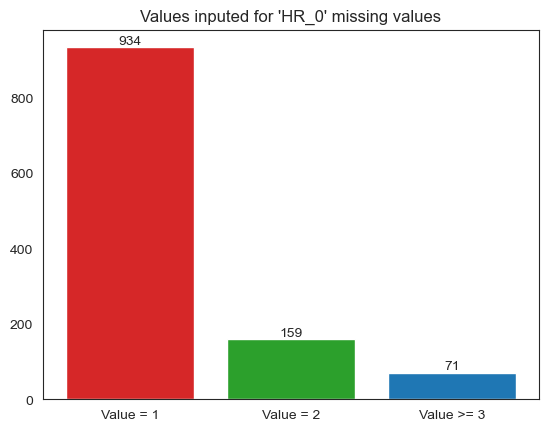

Total values inputed 1164
Number of HR_0 missing value: 1164


In [21]:
"""Imputed values for HR_0"""
values_1_inputed = values_HR_0_corrected.loc[values_HR_0_corrected == 1].count()
values_2_inputed = values_HR_0_corrected.loc[values_HR_0_corrected == 2].count()
values_3_inputed = values_HR_0_corrected.loc[values_HR_0_corrected >= 3].count()

y_values = [values_1_inputed, values_2_inputed, values_3_inputed]

x_values = ["Value = 1", "Value = 2", "Value >= 3"]
fig, ax = plt.subplots()
bar_color = ["tab:red", "tab:green", "tab:blue"]
p = ax.bar(x_values, y_values, color= bar_color)
ax.bar_label(p, labels= [str(element) for element in y_values])
ax.set_title("Values inputed for 'HR_0' missing values")
plt.show()

HR_0_Nan = df["HR_0"].isnull().sum()
print(f"Total values inputed {values_1_inputed+values_2_inputed+values_3_inputed}")
print(f"Number of HR_0 missing value: {HR_0_Nan}") 

#### Customer age

Initially we were considering 2 options: 

> Option 1) Fill in missing values with new category called 'Unknown Age' and bin the feature. This would allow us to preserve the missing values information since these could be considered not missing at random and enhance feature interpretability by binning the feature. However, this would result in a big issue later on: as explained during the lectures, using non continous features introduces a bias during the training of our Clustering algorithms. This happens because the variability in the features is a lot greater when compared with continous features (e.g for binary features, observations either assume the maximum or minimum value). So if we procedded with the binning and introduction of a new category called Unknown Age we would transform a continous and important feature into a non continous feature.
 
> Option 2) Instead we opted to use KNN to fill in the missing values and keep the feature continous and to leverage relationships in the data, ensuring meaningful and objective imputations. 

In [22]:
df_na_removed["customer_age"]

customer_id
1b8f824d5e    18.0
5d272b9dcb    17.0
f6d1b2ba63    38.0
180c632ed8     NaN
4eb37a6705    20.0
              ... 
f4e366c281    30.0
f6b6709018     NaN
f74ad8ce3f    24.0
f7b19c0241    34.0
fd40d3b0e0    30.0
Name: customer_age, Length: 31828, dtype: float64

In [23]:
df_na_removed.dtypes

customer_region              object
customer_age                float64
vendor_count                  int64
product_count                 int64
tot_chain_orders              int64
first_order                 float64
last_order                    int64
last_promo                   object
payment_method               object
CUI_American                float64
CUI_Asian                   float64
CUI_Beverages               float64
CUI_Cafe                    float64
CUI_Chicken Dishes          float64
CUI_Chinese                 float64
CUI_Desserts                float64
CUI_Healthy                 float64
CUI_Indian                  float64
CUI_Italian                 float64
CUI_Japanese                float64
CUI_Noodle Dishes           float64
CUI_OTHER                   float64
CUI_Street Food / Snacks    float64
CUI_Thai                    float64
DOW_0                         int64
DOW_1                         int64
DOW_2                         int64
DOW_3                       

In [24]:
df_na_removed['customer_age'] = df_na_removed['customer_age'].fillna(100000)
df_na_removed.loc[df_na_removed["customer_age"] == 100000, "customer_age"] = np.nan

In [25]:
original_customer_age = df_na_removed["customer_age"].copy()
numeric_features = df_na_removed.select_dtypes(include=[np.number]).columns
original_dtypes = df_na_removed[numeric_features].dtypes

imputer = KNNImputer(n_neighbors=5, weights="uniform")
df_na_removed[numeric_features] = imputer.fit_transform(df_na_removed[numeric_features])
df_na_removed["customer_age"] = df_na_removed["customer_age"].round().astype(int)
df_na_removed["customer_age"].isnull().sum()

# Revert to original data types
for col in numeric_features:
    df_na_removed[col] = df_na_removed[col].astype(original_dtypes[col])

Identify imputed values

In [26]:
imputed_indices = original_customer_age.isnull() & df_na_removed["customer_age"].notnull()
imputed_values = df_na_removed.loc[imputed_indices, "customer_age"]
print(imputed_values)

customer_id
180c632ed8    24.0
8e8652bdc8    28.0
6137fa5620    27.0
2a90e9da84    27.0
a67d3108cb    27.0
              ... 
46aa9dfeb0    37.0
29207a92c8    25.0
d7bf721199    28.0
ee49f4eb0a    28.0
f6b6709018    25.0
Name: customer_age, Length: 727, dtype: float64


In [27]:
imputed_values.describe()

count    727.000000
mean      27.517194
std        3.349589
min       21.000000
25%       25.000000
50%       27.000000
75%       29.000000
max       43.000000
Name: customer_age, dtype: float64

<Axes: xlabel='customer_age', ylabel='Count'>

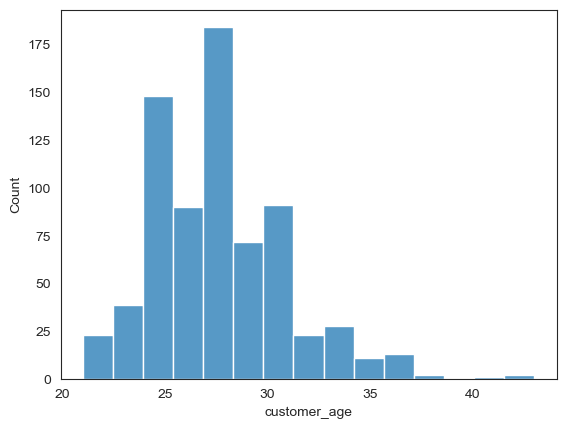

In [28]:
sns.histplot(imputed_values, kde=False, bins=15)

Notes
> Despite having a young customer base (50% of customer between 23 and 31), the clients with missing values could still share more similarities with older clients hence we didn't have an initial expectation of the imputed values.

> The imputed values in this case correspond to a younger demographic with 75% of the clients with a missing value in age being under 30 years old.

#### Visualize the impact on distributions 

a) Customer Age and Customer Region

/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_39221/549307720.py:33: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='customer_region', data=df_na_removed, ax=axes[1, 1], palette='viridis', order=region_order_ai)


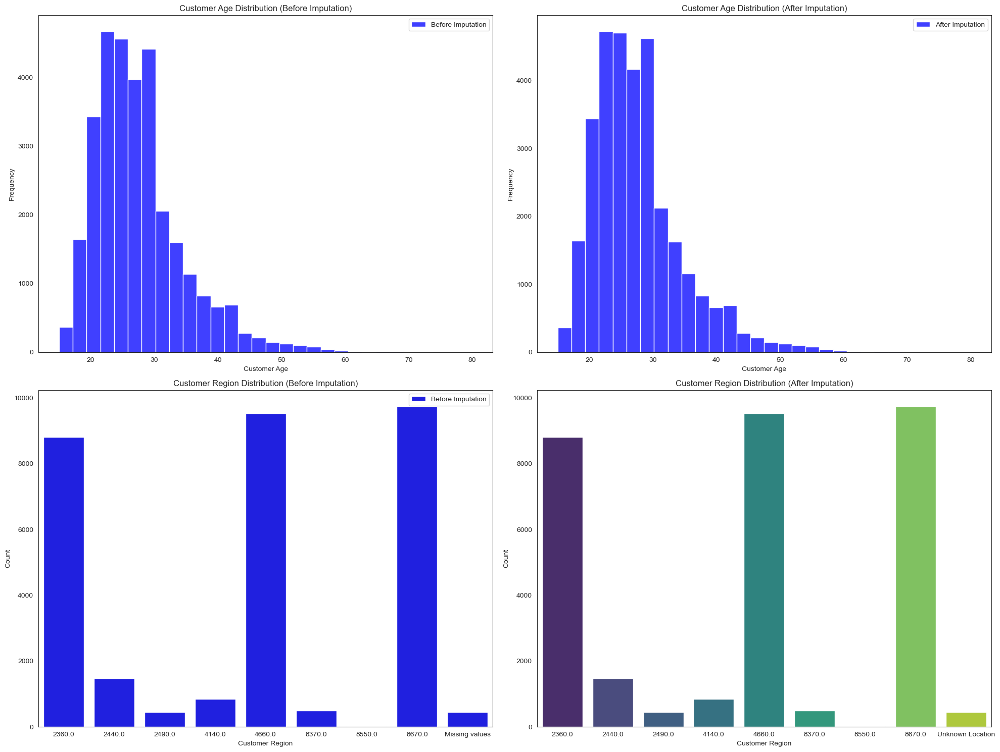

In [29]:
fig, axes = plt.subplots(2, 2, figsize=(20, 15))

# Customer Age: Before and After Imputation
df_copy = df.copy()
df_copy["customer_region"] = df["customer_region"].fillna("Missing values")

sns.histplot(df['customer_age'].dropna(), kde=False, color='blue', bins=30, ax=axes[0, 0], label='Before Imputation')
axes[0, 0].set_title('Customer Age Distribution (Before Imputation)')
axes[0, 0].set_xlabel('Customer Age')
axes[0, 0].set_ylabel('Frequency')
axes[0, 0].legend()

sns.histplot(df_na_removed['customer_age'], kde=False, color='blue', bins=30, ax=axes[0, 1], label='After Imputation')
#sns.countplot(x='customer_age', data=df_na_removed, ax=axes[0, 1], palette='viridis', order=df_na_removed['customer_age'].value_counts().index)
axes[0, 1].set_title('Customer Age Distribution (After Imputation)')
axes[0, 1].set_xlabel('Customer Age')
axes[0, 1].set_ylabel('Frequency')
axes[0, 1].legend()


# Define the order for customer_region
region_order_bi = sorted(df_copy['customer_region'].unique(), key=lambda x: (str(x)[0], x))
region_order_ai = sorted(df_na_removed['customer_region'].unique(), key=lambda x: (str(x)[0], x))


# Customer Region: Before and After Imputation (Vertical Bars)
sns.countplot(x=df_copy['customer_region'], color='blue', ax=axes[1, 0], order=region_order_bi, label='Before Imputation')
axes[1, 0].set_title('Customer Region Distribution (Before Imputation)')
axes[1, 0].set_xlabel('Customer Region')
axes[1, 0].set_ylabel('Count')
axes[1, 0].legend()

sns.countplot(x='customer_region', data=df_na_removed, ax=axes[1, 1], palette='viridis', order=region_order_ai)
axes[1, 1].set_title('Customer Region Distribution (After Imputation)')
axes[1, 1].set_xlabel('Customer Region')
axes[1, 1].set_ylabel('Count')

# Adjust layout
plt.tight_layout()
plt.show()


> As expected the imputation process for customer region, hasn't made any distribution changes

b) First Order and HR_0

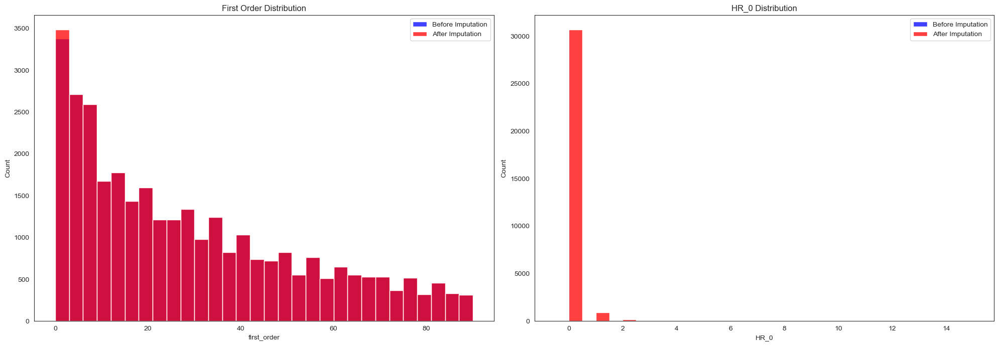

In [30]:
fig, axes = plt.subplots(1, 2, figsize=(20, 7))

# Plot for first_order
sns.histplot(df['first_order'].dropna(), kde=False, color='blue', bins=30, ax=axes[0], label='Before Imputation')
sns.histplot(df_na_removed['first_order'], kde=False, color='red', bins=30, ax=axes[0], label='After Imputation')
axes[0].set_title('First Order Distribution')
axes[0].legend()

# Plot for HR_0
sns.histplot(df['HR_0'].dropna(), kde=False, color='blue', bins=30, ax=axes[1], label='Before Imputation')
sns.histplot(df_na_removed['HR_0'], kde=False, color='red', bins=30, ax=axes[1], label='After Imputation')
axes[1].set_title('HR_0 Distribution')
axes[1].legend()

plt.tight_layout()
plt.show()

> Since the number of missing values was quite low in both features, the imputation processes adopted didn't result in any changes in distribution

## 1.4 Removing strange values
During our EDA we identified two strange situations:
- > Clients who have ordered zero products and haven't ordered from any vendor (vendor_count = 0) 
- > Client that despite having a vendor_count different from 0, still have product_count equal to 0

Product_count and vendor_count equal to 0

In [34]:
pc_vc_0 = df_na_removed.loc[(df_na_removed["product_count"] == 0) & (df_na_removed["product_count"] == df_na_removed["vendor_count"]) ]
pc_vc_0

,customer_region,customer_age,vendor_count,product_count,tot_chain_orders,first_order,last_order,last_promo,payment_method,CUI_American,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,
4903041977,8670.0,22.0,0,0,1,1.0,1,DELIVERY,DIGI,0.0,...,0,0,0,0,0,0,0,0,0,0
c94b288475,8670.0,26.0,0,0,0,1.0,1,DELIVERY,CASH,0.0,...,0,0,0,0,0,0,0,0,0,0
f687717dc1,8670.0,21.0,0,0,1,1.0,1,DELIVERY,DIGI,0.0,...,0,0,0,0,0,0,0,0,0,0
c6cf0b76fb,8670.0,38.0,0,0,0,2.0,2,DELIVERY,CASH,0.0,...,0,0,0,0,0,0,0,0,0,0
1b7c34738e,8670.0,24.0,0,0,0,3.0,3,NO PROMO USED,CASH,0.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177ede2420,8670.0,30.0,0,0,1,86.0,86,NO PROMO USED,DIGI,0.0,...,0,0,0,0,0,0,0,0,0,0
0039059c9c,8670.0,22.0,0,0,1,88.0,88,DISCOUNT,CARD,0.0,...,0,0,0,0,0,0,0,0,0,0
0e60632fe2,8670.0,23.0,0,0,0,89.0,89,DISCOUNT,CARD,0.0,...,0,0,0,0,0,0,0,0,0,0


In [35]:
indices_to_remove = pc_vc_0.index
df_na_removed.drop(index=indices_to_remove, inplace=True)

Product_count equal to 0 but vendor_count different from 0

- It seems like the client made orders however, the product_count value is missing. Since they only represent 18 observations, we will drop them as weel

In [36]:
pc_0 = df_na_removed.loc[(df_na_removed["product_count"] == 0) ]
indices_to_remove = pc_0.index
df_na_removed.drop(index=indices_to_remove, inplace=True)

## 1.5 Converting data types

In [37]:
df_na_removed.dtypes

customer_region              object
customer_age                float64
vendor_count                  int64
product_count                 int64
tot_chain_orders              int64
first_order                 float64
last_order                    int64
last_promo                   object
payment_method               object
CUI_American                float64
CUI_Asian                   float64
CUI_Beverages               float64
CUI_Cafe                    float64
CUI_Chicken Dishes          float64
CUI_Chinese                 float64
CUI_Desserts                float64
CUI_Healthy                 float64
CUI_Indian                  float64
CUI_Italian                 float64
CUI_Japanese                float64
CUI_Noodle Dishes           float64
CUI_OTHER                   float64
CUI_Street Food / Snacks    float64
CUI_Thai                    float64
DOW_0                         int64
DOW_1                         int64
DOW_2                         int64
DOW_3                       

After checking the datatypes we saw that first_order and HR_0 are floats but they should be integers.

In [38]:
df_na_removed['first_order'] = df_na_removed['first_order'].astype('int64')
df_na_removed['HR_0'] = df_na_removed['HR_0'].astype('int64')

## 1.6 Dealing with outliers

- Considering the highly skewed distributions analyzed during our EDA, we defined two approaches

> Option 1 (99.9th percentil): Using the 99.9th percentil as the threshold for outlier identification and removal for all the numeric features.

> Option 2 (Boxplot): Using the boxplot approach used in practical classes, we ended up usign the whiskers the upper and lower threshold limits for outlier identification and removal for all the numeric features.

> Option 3 (Winsorizing): Instead of removing outliers entirely, winsorizing replaces them with a less extreme value to keep the data more robust and improve the stability of analysis results.

> Option 4 (DBSCAN): Considering the density approach followed by DBSCAN to identify clusters, it could also be helpful to identify multi diemnsional outliers (ONLY applier later on after feature scaling)

In [39]:
df_outliers_999th_percentil = df_na_removed.copy()
df_outliers_IQR = df_na_removed.copy()
df_outliers_winsorized = df_na_removed.copy()

In [40]:
df_outliers_999th_percentil.duplicated().sum() 

0

#### Option 1: Using the 99.9th percentil approach 

In [41]:
df_outliers_999th_percentil.columns

Index(['customer_region', 'customer_age', 'vendor_count', 'product_count',
       'tot_chain_orders', 'first_order', 'last_order', 'last_promo',
       'payment_method', 'CUI_American', 'CUI_Asian', 'CUI_Beverages',
       'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts',
       'CUI_Healthy', 'CUI_Indian', 'CUI_Italian', 'CUI_Japanese',
       'CUI_Noodle Dishes', 'CUI_OTHER', 'CUI_Street Food / Snacks',
       'CUI_Thai', 'DOW_0', 'DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5',
       'DOW_6', 'HR_0', 'HR_1', 'HR_2', 'HR_3', 'HR_4', 'HR_5', 'HR_6', 'HR_7',
       'HR_8', 'HR_9', 'HR_10', 'HR_11', 'HR_12', 'HR_13', 'HR_14', 'HR_15',
       'HR_16', 'HR_17', 'HR_18', 'HR_19', 'HR_20', 'HR_21', 'HR_22', 'HR_23'],
      dtype='object')

In [42]:
# Selecting numerical features and 99.9th percentile threshold
num_features_selected = df_outliers_999th_percentil.select_dtypes(include=['number']).columns.tolist()
num_features_selected_df = df_outliers_999th_percentil.loc[:, num_features_selected]

percentil_999th = num_features_selected_df.quantile(0.999)

# Filter the DataFrame and remove the outliers
filtering_df = num_features_selected_df < percentil_999th
indices = filtering_df.all(axis=1)

df_outliers_999th_percentil = df_outliers_999th_percentil.loc[indices]
df_reamining_out = df_outliers_999th_percentil.loc[~indices]
print('Percentage of data kept after removing outliers:', np.round(df_outliers_999th_percentil.shape[0] / df_na_removed.shape[0]*100, 2))

Percentage of data kept after removing outliers: 96.04


#### Option 2: IQR Rule for Outlier removal

In [46]:
num_features_selected = df_outliers_IQR.select_dtypes(include=['number']).columns.tolist()
num_features_selected_df = df_outliers_IQR.loc[:, num_features_selected]

q1 = num_features_selected_df.quantile(.25)
q3 = num_features_selected_df.quantile(.75)
iqr = (q3 - q1)

upper_lim = q3 + 1.5 * iqr
lower_lim = q1 - 1.5 * iqr

# if a single column is considered an outliers then the row is considered an outlier
outliers = ((num_features_selected_df < lower_lim) | (num_features_selected_df > upper_lim)).any(axis=1)


percentage_outliers = outliers.sum() / len(df_outliers_IQR) * 100

print(f"Percentage of outliers in the entire dataset: {percentage_outliers:.2f}%")

Percentage of outliers in the entire dataset: 100.00%


 > Most of the data have at least one column that is considered an outlier. Using the IQR method would endup removing almost all the data, making it infeasible to use this method.

#### Option 3: Winsorizing strategy (no removal)

> As noticed during the EDA, the dataset original features contains extremely high outliers with values above the 99th percentile.

> Moreover this situation is even more noticable in the HR, DOW and CUI features where the features are extremely positively disrubuted due to the high number of clients with zero values.
This leads to boxplots where the right whiskers end up being far to the right of the centre of the distribution.

> To address this, we will use the following strategy:
- During the EDA, we compared using of the 99th percentil or visual threhsold to define the threshold that would be used to apply the winsoring strategy.
- For the features with outlier values we will replace the values above the 99th percentil with the 99th percentil value and check the visual changes in the boxplots

In [47]:
num_features_selected = df_outliers_winsorized.select_dtypes(include=['number']).columns.tolist()

# Removing first_order and last_order because they don't have outliers
num_features_selected = [feature for feature in num_features_selected if feature not in ['first_order', 'last_order']]
num_features_selected_df = df_outliers_winsorized.loc[:, num_features_selected]
num_features_selected_df.columns

Index(['customer_age', 'vendor_count', 'product_count', 'tot_chain_orders',
       'CUI_American', 'CUI_Asian', 'CUI_Beverages', 'CUI_Cafe',
       'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts', 'CUI_Healthy',
       'CUI_Indian', 'CUI_Italian', 'CUI_Japanese', 'CUI_Noodle Dishes',
       'CUI_OTHER', 'CUI_Street Food / Snacks', 'CUI_Thai', 'DOW_0', 'DOW_1',
       'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5', 'DOW_6', 'HR_0', 'HR_1', 'HR_2',
       'HR_3', 'HR_4', 'HR_5', 'HR_6', 'HR_7', 'HR_8', 'HR_9', 'HR_10',
       'HR_11', 'HR_12', 'HR_13', 'HR_14', 'HR_15', 'HR_16', 'HR_17', 'HR_18',
       'HR_19', 'HR_20', 'HR_21', 'HR_22', 'HR_23'],
      dtype='object')

Winsorizing with 1%,2%, 3%, 4% and 5% threshold

In [48]:
for feature in num_features_selected:
    df_outliers_winsorized[feature + "_winsorized_99th"] = sp.stats.mstats.winsorize(df_outliers_winsorized[feature], limits=[0, 0.01])
    df_outliers_winsorized[feature + "_winsorized_98th"] = sp.stats.mstats.winsorize(df_outliers_winsorized[feature], limits=[0, 0.02])
    df_outliers_winsorized[feature + "_winsorized_97th"] = sp.stats.mstats.winsorize(df_outliers_winsorized[feature], limits=[0, 0.03])
    df_outliers_winsorized[feature + "_winsorized_96th"] = sp.stats.mstats.winsorize(df_outliers_winsorized[feature], limits=[0, 0.04])
    df_outliers_winsorized[feature + "_winsorized_95th"] = sp.stats.mstats.winsorize(df_outliers_winsorized[feature], limits=[0, 0.05])


/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_39221/3991477736.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_outliers_winsorized[feature + "_winsorized_97th"] = sp.stats.mstats.winsorize(df_outliers_winsorized[feature], limits=[0, 0.03])
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_39221/3991477736.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_outliers_winsorized[feature + "_winsorized_96th"] = sp.stats.mstats.winsorize(df_outliers_winsorized[feature], limits=[0, 0.04])
/var/folders/g

Boxplot with the comparison between original feature and winsorized feature

In [49]:
# Define the number of features
num_features = len(num_features_selected)
plots_per_row = 6  # Each row corresponds to a single feature with its variations

# Calculate total rows needed (one row per feature)
rows = num_features

# Create subplots
fig, axes = plt.subplots(rows, plots_per_row, figsize=(20, 5 * rows))
axes = axes.reshape(rows, plots_per_row)  # Reshape for row-column structure

# Plot each feature and its winsorized versions
for i, feature in enumerate(num_features_selected):
    # Plot original feature
    axes[i, 0].boxplot(df_outliers_winsorized[feature].dropna())
    axes[i, 0].set_title(f"Original: {feature}")
    
    # Plot winsorized versions for 99th, 98th, 97th, 96th, and 95th percentiles
    axes[i, 1].boxplot(df_outliers_winsorized[feature + "_winsorized_99th"])
    axes[i, 1].set_title(f"99th Winsorized: {feature}")
    
    axes[i, 2].boxplot(df_outliers_winsorized[feature + "_winsorized_98th"])
    axes[i, 2].set_title(f"98th Winsorized: {feature}")
    
    axes[i, 3].boxplot(df_outliers_winsorized[feature + "_winsorized_97th"])
    axes[i, 3].set_title(f"97th Winsorized: {feature}")
    
    axes[i, 4].boxplot(df_outliers_winsorized[feature + "_winsorized_96th"])
    axes[i, 4].set_title(f"96th Winsorized: {feature}")
    
    axes[i, 5].boxplot(df_outliers_winsorized[feature + "_winsorized_95th"])
    axes[i, 5].set_title(f"95th Winsorized: {feature}")

plt.tight_layout()
plt.show()

Histogram with the comparison between original feature and winsorized feature with comparable x axis

In [604]:
"""
# Define the number of features
num_features = len(num_features_selected)
plots_per_row = 6  # Each row corresponds to a single feature with its variations

# Calculate total rows needed (one row per feature)
rows = num_features

# Create subplots
fig, axes = plt.subplots(rows, plots_per_row, figsize=(20, 5 * rows))
axes = axes.reshape(rows, plots_per_row)  # Reshape for row-column structure

# Plot each feature and its winsorized versions
for i, feature in enumerate(num_features_selected):
    # Calculate the min and max values for the original feature
    x_min = df_outliers_winsorized[feature].min()
    x_max = df_outliers_winsorized[feature].max()

    # Plot original feature
    axes[i, 0].hist(df_outliers_winsorized[feature].dropna(), bins=20, range=(x_min, x_max))
    axes[i, 0].set_title(f"Original: {feature}")
    
    # Plot winsorized versions for 99th, 98th, 97th, 96th, and 95th percentiles
    axes[i, 1].hist(df_outliers_winsorized[feature + "_winsorized_99th"], bins=20, range=(x_min, x_max))
    axes[i, 1].set_title(f"99th Winsorized: {feature}")
    
    axes[i, 2].hist(df_outliers_winsorized[feature + "_winsorized_98th"], bins=20, range=(x_min, x_max))
    axes[i, 2].set_title(f"98th Winsorized: {feature}")
    
    axes[i, 3].hist(df_outliers_winsorized[feature + "_winsorized_97th"], bins=20, range=(x_min, x_max))
    axes[i, 3].set_title(f"97th Winsorized: {feature}")
    
    axes[i, 4].hist(df_outliers_winsorized[feature + "_winsorized_96th"], bins=20, range=(x_min, x_max))
    axes[i, 4].set_title(f"96th Winsorized: {feature}")
    
    axes[i, 5].hist(df_outliers_winsorized[feature + "_winsorized_95th"], bins=20, range=(x_min, x_max))
    axes[i, 5].set_title(f"95th Winsorized: {feature}")

# Adjust layout
plt.tight_layout()
plt.show()
"""


'\n# Define the number of features\nnum_features = len(num_features_selected)\nplots_per_row = 6  # Each row corresponds to a single feature with its variations\n\n# Calculate total rows needed (one row per feature)\nrows = num_features\n\n# Create subplots\nfig, axes = plt.subplots(rows, plots_per_row, figsize=(20, 5 * rows))\naxes = axes.reshape(rows, plots_per_row)  # Reshape for row-column structure\n\n# Plot each feature and its winsorized versions\nfor i, feature in enumerate(num_features_selected):\n    # Calculate the min and max values for the original feature\n    x_min = df_outliers_winsorized[feature].min()\n    x_max = df_outliers_winsorized[feature].max()\n\n    # Plot original feature\n    axes[i, 0].hist(df_outliers_winsorized[feature].dropna(), bins=20, range=(x_min, x_max))\n    axes[i, 0].set_title(f"Original: {feature}")\n    \n    # Plot winsorized versions for 99th, 98th, 97th, 96th, and 95th percentiles\n    axes[i, 1].hist(df_outliers_winsorized[feature + "_wins

Histogram with the comparison between original feature and winsorized feature without comparable x axis

In [605]:
# Define the number of features
num_features = len(num_features_selected)
plots_per_row = 6  # Each row corresponds to a single feature with its variations

# Calculate total rows needed (one row per feature)
rows = num_features

# Create subplots
fig, axes = plt.subplots(rows, plots_per_row, figsize=(20, 5 * rows))
axes = axes.reshape(rows, plots_per_row)  # Reshape for row-column structure

# Plot each feature and its winsorized versions
for i, feature in enumerate(num_features_selected):
    # Plot original feature
    axes[i, 0].hist(df_outliers_winsorized[feature].dropna(), bins=12)
    axes[i, 0].set_title(f"Original: {feature}")
    
    # Plot winsorized versions for 99th, 98th, 97th, 96th, and 95th percentiles
    axes[i, 1].hist(df_outliers_winsorized[feature + "_winsorized_99th"], bins=12)
    axes[i, 1].set_title(f"99th Winsorized: {feature}")
    
    axes[i, 2].hist(df_outliers_winsorized[feature + "_winsorized_98th"], bins=12)
    axes[i, 2].set_title(f"98th Winsorized: {feature}")
    
    axes[i, 3].hist(df_outliers_winsorized[feature + "_winsorized_97th"], bins=12)
    axes[i, 3].set_title(f"97th Winsorized: {feature}")
    
    axes[i, 4].hist(df_outliers_winsorized[feature + "_winsorized_96th"], bins=12)
    axes[i, 4].set_title(f"96th Winsorized: {feature}")
    
    axes[i, 5].hist(df_outliers_winsorized[feature + "_winsorized_95th"], bins=12)
    axes[i, 5].set_title(f"95th Winsorized: {feature}")

# Adjust layout
plt.tight_layout()
plt.show()


Notes

> Based on the boxplots for each winsorized feature, we deemed the most appropriate threshold to use 2% (all the values above the 98th percentil were converted to the 98th percentil value) for the following reasons: First, the new maximum values (previous 98th percentil) seems more appropriate than the maximum values imposed by more extreme winsorizing strategies. This way we are able to keep some of the variability in the data while being able to reduce number of outliers

> After analyzing the winsorizing effect on HR features on the histogram without fixed x axis, we seem to have the formation of clusters reinforcing the anlysis done on these features during the EDA: over 70% of clients for each feature have a value of 0. With that in mind, we decided not apply the winsorizing strategy for the HR features nor remove any outliers. We will first do feature creation later on and apply the DBSCAN to remove any existing multivariate outliers

> It is now crucial to understand if the number of outliers after applying the winsorizing strategy for each feature. That will help us make the final decision on whether to use this method for treating outliers or not.




Drop HR winsorized columns

In [50]:
df_outliers_winsorized.columns

Index(['customer_region', 'customer_age', 'vendor_count', 'product_count',
       'tot_chain_orders', 'first_order', 'last_order', 'last_promo',
       'payment_method', 'CUI_American',
       ...
       'HR_22_winsorized_99th', 'HR_22_winsorized_98th',
       'HR_22_winsorized_97th', 'HR_22_winsorized_96th',
       'HR_22_winsorized_95th', 'HR_23_winsorized_99th',
       'HR_23_winsorized_98th', 'HR_23_winsorized_97th',
       'HR_23_winsorized_96th', 'HR_23_winsorized_95th'],
      dtype='object', length=305)

In [51]:
HR_winsorized_features = [
    f"{feature}_winsorized_{percentile}"
    for feature in num_features_selected if 'HR' in feature
    for percentile in ["99th", "98th", "97th", "96th", "95th"]
]
df_outliers_winsorized.drop(columns=HR_winsorized_features, inplace=True)

Number of outliers removed in each feature

In [52]:
def num_outliers_fixed(df, feature, original_q1, original_q3, original_iqr):
    """Calculate the number of outliers for a feature using the original thresholds."""
    upper_bound = original_q3 + 1.5 * original_iqr
    lower_bound = original_q1 - 1.5 * original_iqr
    return df[feature].loc[(df[feature] > upper_bound) | (df[feature] < lower_bound)].count()



original_winsorized_features = [
    feature for feature in df_outliers_winsorized.columns 
    if any(f"{feature}_winsorized_{percentile}" in df_outliers_winsorized.columns for percentile in ["99th", "98th", "97th", "96th", "95th"])
]


# Store the results for each feature
outlier_differences = {}

# Iterate through each feature
for feature in original_winsorized_features:
    # Calculate original thresholds
    q3 = df_outliers_winsorized[feature].quantile(0.75)
    q1 = df_outliers_winsorized[feature].quantile(0.25)
    iqr = q3 - q1
    
    # Count outliers in the original data
    original_outliers = num_outliers_fixed(df_outliers_winsorized, feature, q1, q3, iqr)
    
    # Initialize a dictionary to store outlier counts for winsorized versions
    differences = {}
    
    # Iterate through winsorized versions
    for percentile in ["99th", "98th", "97th", "96th", "95th"]:
        winsorized_feature = f"{feature}_winsorized_{percentile}"
        winsorized_outliers = num_outliers_fixed(df_outliers_winsorized, winsorized_feature, q1, q3, iqr)
        
        # Calculate the difference
        difference = original_outliers - winsorized_outliers
        differences[percentile] = difference
    
    # Store the differences for the feature
    outlier_differences[feature] = differences

# Display the results
outlier_diff_df = pd.DataFrame(outlier_differences).T
outlier_diff_df

,99th,98th,97th,96th,95th
customer_age,0,0,0,1078,1078
vendor_count,0,0,0,0,1519
product_count,0,0,0,0,0
tot_chain_orders,0,0,0,0,0
CUI_American,0,0,0,0,0
CUI_Asian,0,0,0,0,0
CUI_Beverages,0,0,0,0,0
CUI_Cafe,0,0,0,0,1363
CUI_Chicken Dishes,0,0,0,0,0
CUI_Chinese,0,0,0,0,0


> It seems like the reduction of outliers only happens for 5 features with the 5% upper threshold. The other features have no reduction in the number of outliers. 

> This seems to indicate that the winsorization method is not effective for these features.

> Hence the selected method for outlier removal is the 99.9th percentile threshold.

#### After dealing with outliers we perfomed EDA once again

a) Vendor count, Product count and Is chain

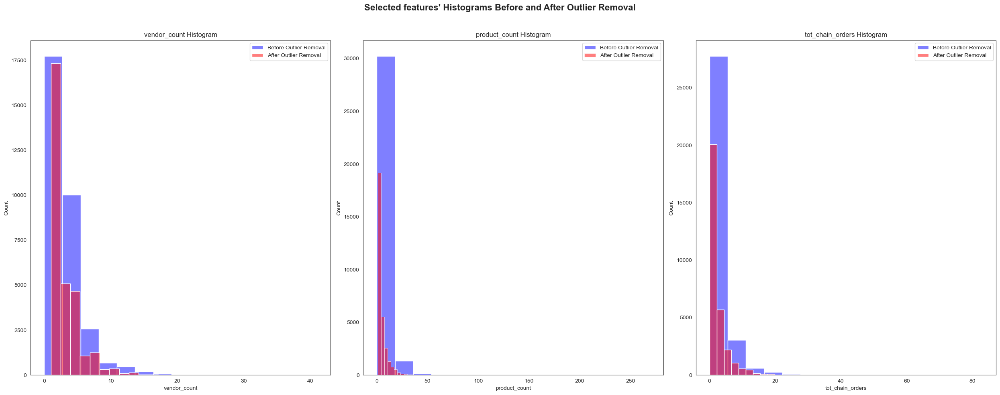

In [53]:
# CUI features' Histograms before and after outlier removal
fig, axes = plt.subplots(1, 3, figsize=(25, 10))
selected_columns = ["vendor_count", "product_count", "tot_chain_orders"]

# Loop through each feature in selected columns and plot histograms
for i, feature in enumerate(selected_columns):
    ax = axes[i]
    sns.histplot(df[feature], kde=False, ax=ax, alpha=0.5, bins=15, color='blue', label='Before Outlier Removal')
    sns.histplot(df_outliers_999th_percentil[feature], kde=False, ax=ax, alpha=0.5, bins=15, color='red', label='After Outlier Removal')
    
    # Set title for each subplot
    ax.set_title(f"{feature} Histogram")
    ax.legend()

# Adding an overall title for the entire figure
plt.suptitle("Selected features' Histograms Before and After Outlier Removal", fontsize=16, fontweight='bold')

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Show the plot
plt.show()

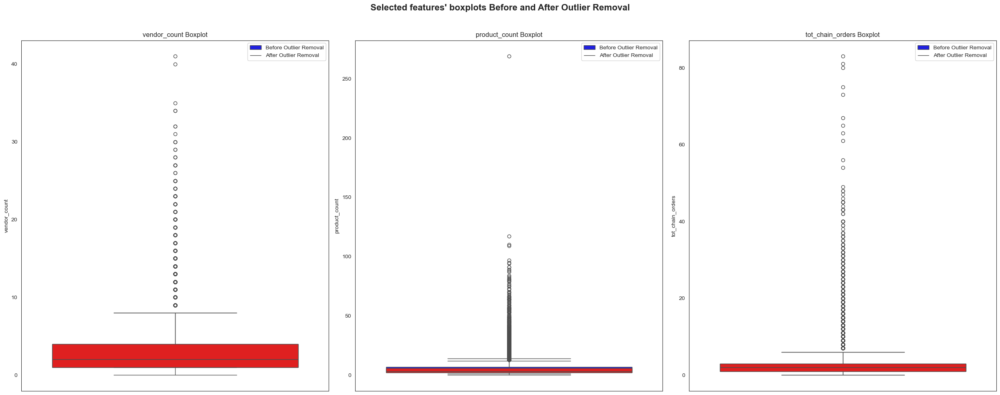

In [54]:
# CUI features' Histograms before and after outlier removal
fig, axes = plt.subplots(1, 3, figsize=(25, 10))
selected_columns = ["vendor_count", "product_count", "tot_chain_orders"]

# Loop through each feature in selected columns and plot boxplots
for i, feature in enumerate(selected_columns):
    ax = axes[i]
    
    # Plot boxplots for before and after outlier removal
    sns.boxplot(df[feature], ax=ax, color='blue')
    sns.boxplot(df_outliers_999th_percentil[feature], ax=ax, color='red')
    
    # Add a title for each subplot
    ax.set_title(f"{feature} Boxplot")
    
    # Create a legend manually
    ax.legend(["Before Outlier Removal", "After Outlier Removal"], loc='upper right')

# Add an overall title for the entire figure
plt.suptitle("Selected features' boxplots Before and After Outlier Removal", fontsize=16, fontweight='bold')

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Show the plot
plt.show()


b) CUI variables

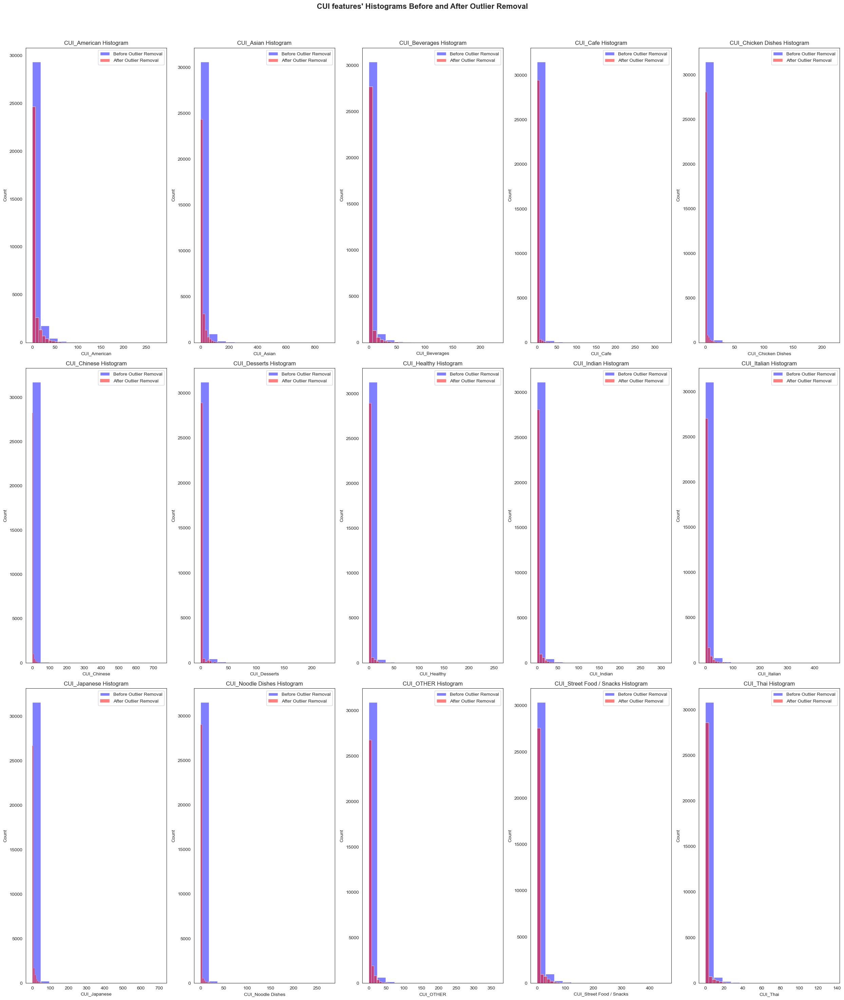

In [55]:
# CUI features' Histograms before and after outlier removal
fig, axes = plt.subplots(3, 5, figsize=(25, 30))
CUI_columns = [element for element in df_outliers_999th_percentil.columns if 'CUI' in str(element)]


# Loop through each feature in CUI columns and plot histograms
for i, feature in enumerate(CUI_columns):
    ax = axes[i // 5, i % 5]
    sns.histplot(df[feature], kde=False, ax=ax, alpha=0.5, bins=15, color='blue', label='Before Outlier Removal')
    sns.histplot(df_outliers_999th_percentil[feature], kde=False, ax=ax, alpha=0.5, bins=15, color='red', label='After Outlier Removal')
    
    # Set title for each subplot
    ax.set_title(f"{feature} Histogram")
    ax.legend()

# Adding an overall title for the entire figure
plt.suptitle("CUI features' Histograms Before and After Outlier Removal", fontsize=16, fontweight='bold')

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Show the plot
plt.show()

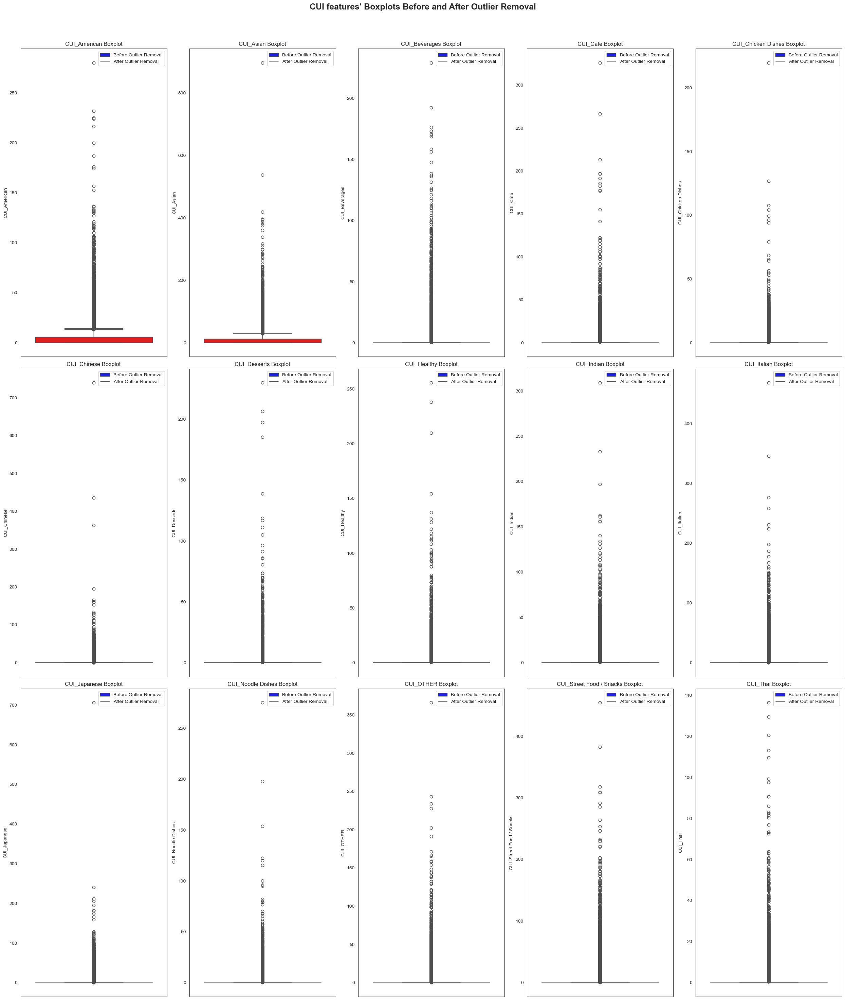

In [56]:
# CUI features' Histograms before and after outlier removal
fig, axes = plt.subplots(3, 5, figsize=(25, 30))

# Loop through each feature in CUI columns and plot histograms
for i, feature in enumerate(CUI_columns):
    ax = axes[i // 5, i % 5]
    
    # Plot before and after outlier removal (boxplots)
    sns.boxplot(data=df[feature], ax=ax, color='blue')
    sns.boxplot(data=df_outliers_999th_percentil[feature], ax=ax, color='red')
    
    # Set title for each subplot
    ax.set_title(f"{feature} Boxplot")
    ax.legend(['Before Outlier Removal', 'After Outlier Removal'])

# Adding an overall title for the entire figure
plt.suptitle("CUI features' Boxplots Before and After Outlier Removal", fontsize=18, fontweight='bold')

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Show the plot
plt.show()


c) DOW variables

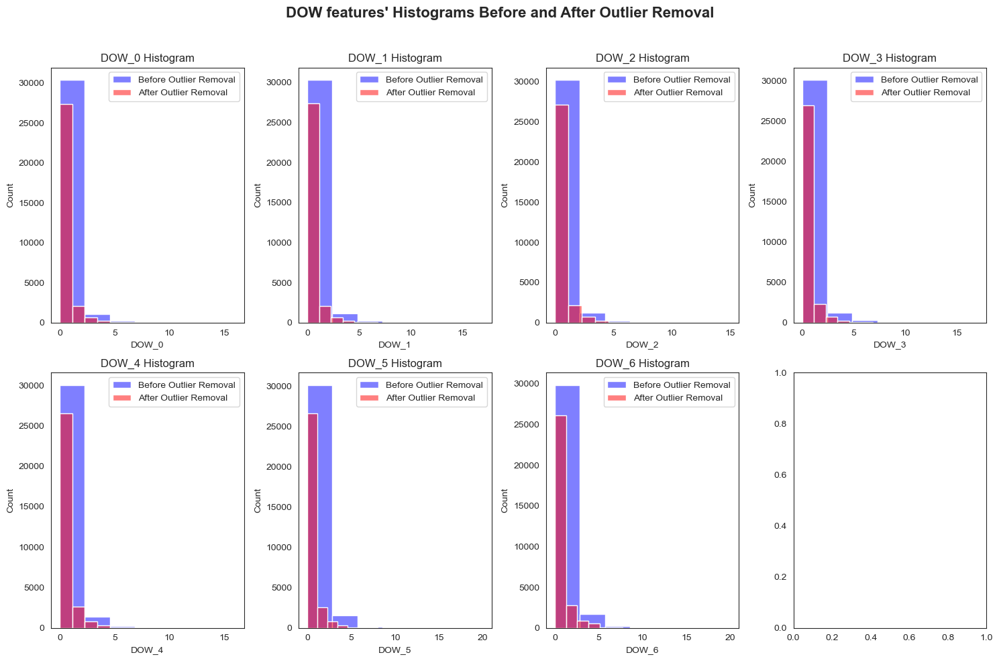

In [57]:
# DOW features' Histograms before and after outlier removal
fig, axes = plt.subplots(2, 4, figsize=(15, 10))
DOW_columns = [element for element in df_outliers_999th_percentil.columns if 'DOW' in str(element)]


# Loop through each feature in CUI columns and plot boxplots
for i, feature in enumerate(DOW_columns):
    ax = axes[i // 4, i % 4]
    sns.histplot(df[feature], kde=False, ax=ax, alpha=0.5, bins=7, color='blue', label='Before Outlier Removal')
    sns.histplot(df_outliers_999th_percentil[feature], kde=False, ax=ax, alpha=0.5, bins=7, color='red', label='After Outlier Removal')
    
    # Set title for each subplot
    ax.set_title(f"{feature} Histogram")
    ax.legend()

# Adding an overall title for the entire figure
plt.suptitle("DOW features' Histograms Before and After Outlier Removal", fontsize=16, fontweight='bold')

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Show the plot
plt.show()

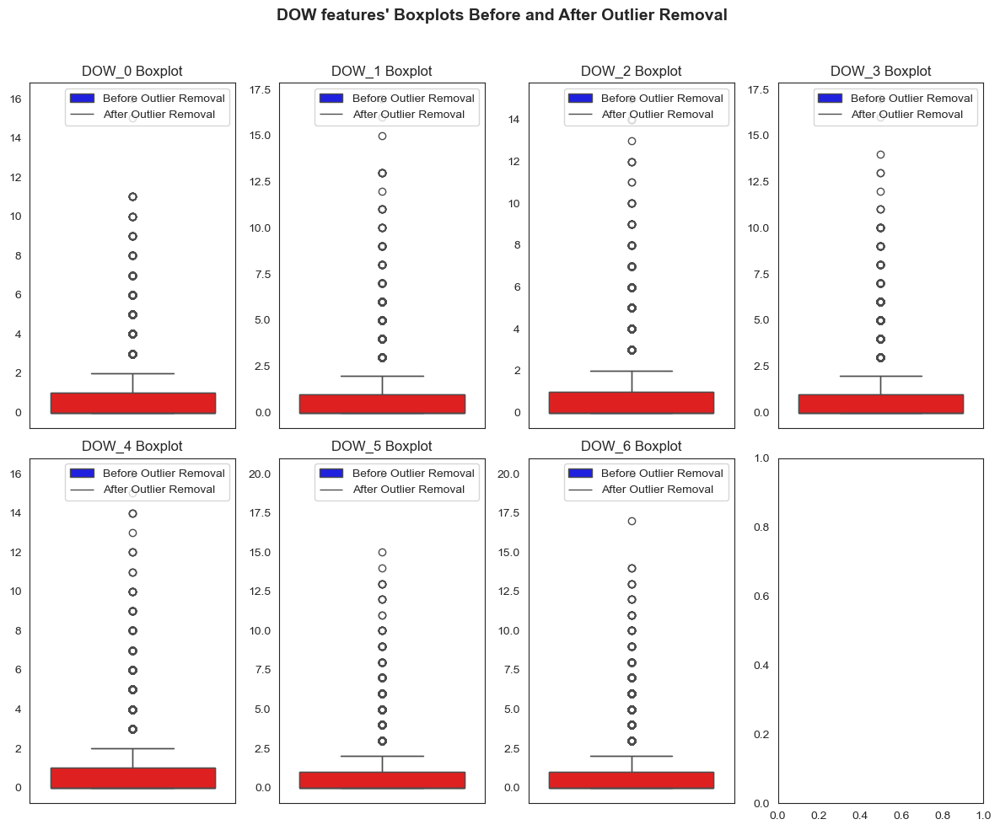

In [58]:
# DOW features' Boxplots before and after outlier removal
fig, axes = plt.subplots(2, 4, figsize=(12, 10))

# Loop through each feature in DOW columns and plot boxplots
for i, feature in enumerate(DOW_columns):
    ax = axes[i // 4, i % 4]
    
    # Plot before and after outlier removal (boxplots)
    sns.boxplot(data=df[feature], ax=ax, color='blue')
    sns.boxplot(data=df_outliers_999th_percentil[feature], ax=ax, color='red')
    
    # Set title for each subplot
    ax.set_title(f"{feature} Boxplot")
    ax.set_ylabel("")
    
    # Add legend manually after plotting
    ax.legend(['Before Outlier Removal', 'After Outlier Removal'])

# Adding an overall title for the entire figure
plt.suptitle("DOW features' Boxplots Before and After Outlier Removal", fontsize=14, fontweight='bold')

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Show the plot
plt.show()


d) HR variables

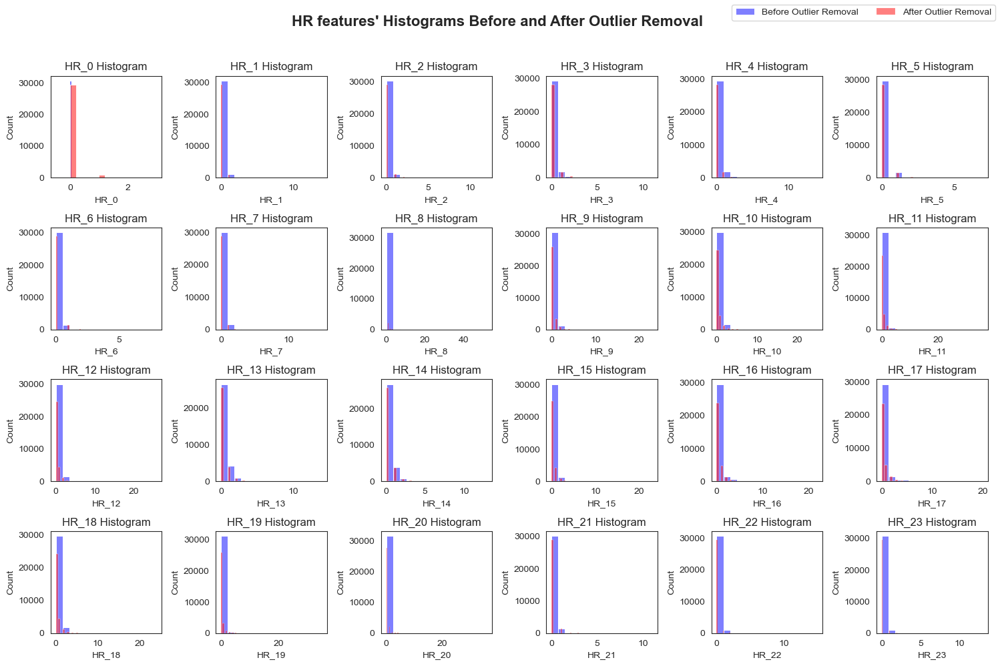

In [59]:
# HR features' Histograms before and after outlier removal
fig, axes = plt.subplots(4, 6, figsize=(15, 10))
HR_columns = [element for element in df_outliers_999th_percentil.columns if 'HR' in str(element)]

# Loop through each feature in HR columns and plot histograms
for i, feature in enumerate(HR_columns):
    ax = axes[i // 6, i % 6]
    sns.histplot(df[feature], kde=False, ax=ax, alpha=0.5, bins=15, color='blue', label='Before Outlier Removal')
    sns.histplot(df_outliers_999th_percentil[feature], kde=False, ax=ax, alpha=0.5, bins=15, color='red', label='After Outlier Removal')
    
    # Set title for each subplot
    ax.set_title(f"{feature} Histogram")

# Adding an overall title for the entire figure
plt.suptitle("HR features' Histograms Before and After Outlier Removal", fontsize=16, fontweight='bold')

# Create a single legend for the entire figure
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='upper right', ncol=2)

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Show the plot
plt.show()

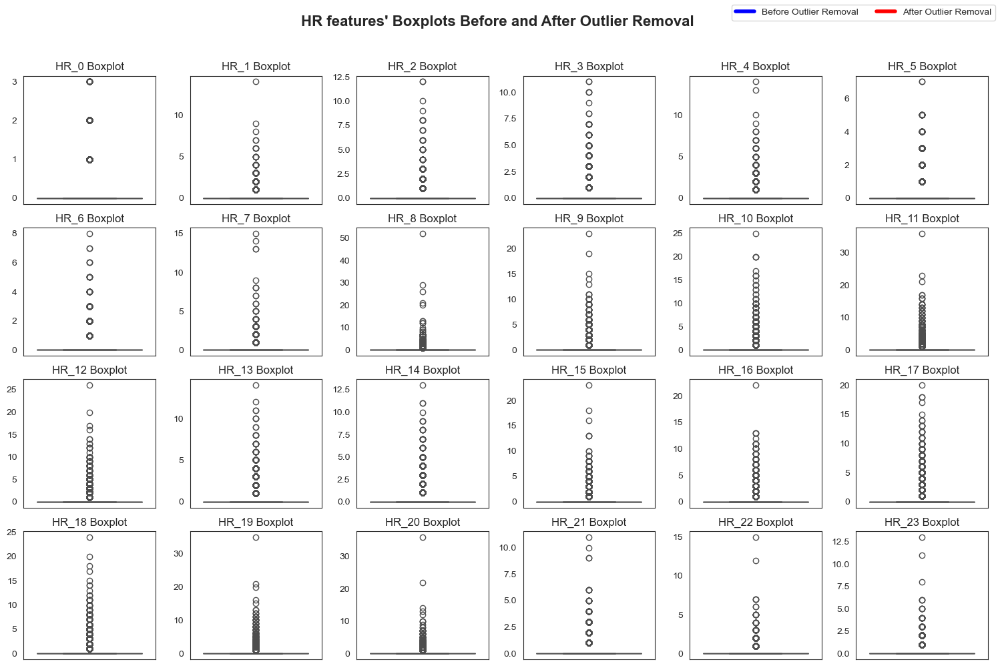

In [60]:
# HR features' Boxplots before and after outlier removal
fig, axes = plt.subplots(4, 6, figsize=(15, 10))

# Loop through each feature in HR columns and plot boxplots
for i, feature in enumerate(HR_columns):
    ax = axes[i // 6, i % 6]
    
    # Plot before and after outlier removal (boxplots)
    sns.boxplot(data=df[feature], ax=ax, color='blue')
    sns.boxplot(data=df_outliers_999th_percentil[feature], ax=ax, color='red')
    
    # Set title for each subplot
    ax.set_title(f"{feature} Boxplot")
    ax.set_ylabel("")

# Adding an overall title for the entire figure
plt.suptitle("HR features' Boxplots Before and After Outlier Removal", fontsize=16, fontweight='bold')

# Create a single legend for the entire figure
handles = [plt.Line2D([0], [0], color='blue', lw=4), plt.Line2D([0], [0], color='red', lw=4)]
labels = ['Before Outlier Removal', 'After Outlier Removal']
fig.legend(handles, labels, loc='upper right', ncol=2)

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Show the plot
plt.show()


Notes

> Due to the high Proportion of Zero or Low Values and Long Tails in the Distribution of the CUI, DOW and HR features, the boxplots had a noticable reduction in spread.

> All Features distribution have become less right skewed with the removal of the 0.5% of values with the x-axis shifitng to the left

> Fom vendor_count, product_count and tot_chain_orders, tot_chain_orders  is the only feature whose boxplot hasn't shown a significant reduction in spread in the boxplot.

# 2. Feature creation

In [84]:
#Copying df_nan instead of df in order to have the HR_0 correct values. It would impact the creatiom of night_num_orders 
df_feature_creation = df_outliers_999th_percentil.copy()

In [85]:
df_feature_creation.isnull().sum().sum()

0

In [86]:
df_feature_creation.duplicated().sum()

0

In [131]:
df_feature_creation.shape

(30417, 76)

## 2.1 payment_method_combined

#### 1. Why did we create the feature

> Created the feature to better differentiate clients who prefer to order online or pay in person

> Assumed that CASH mean't paying in person when the delivery arrived and CARD and DIGI refered to online payment methods with DIGI most likely refering to other payment methods like apple pay, paypal, mbway, etc...

#### 2. How did we create the feature

> Based on the assumptions defined above, we considered 'CASH' as the only 'In Person' payment options and 'CARD' and 'DIGI' as the 'Online' payment options

Creating the payment_method_combined feature

In [87]:
df_feature_creation['payment_method_combined'] = df_feature_creation['payment_method']
df_feature_creation['payment_method_combined'] = df_feature_creation['payment_method_combined'].replace({'CARD': 'Online', 'CASH': 'In Person', 'DIGI': 'Online'})

In [88]:
df_feature_creation["payment_method_combined"].describe()

count      30417
unique         2
top       Online
freq       25012
Name: payment_method_combined, dtype: object

In [137]:
df_feature_creation["payment_method_combined"].value_counts()

payment_method_combined
Online       25012
In Person     5405
Name: count, dtype: int64

In [139]:
df_feature_creation["payment_method_combined"].value_counts(normalize=True) * 100

payment_method_combined
Online       82.230332
In Person    17.769668
Name: proportion, dtype: float64

a) bar plot

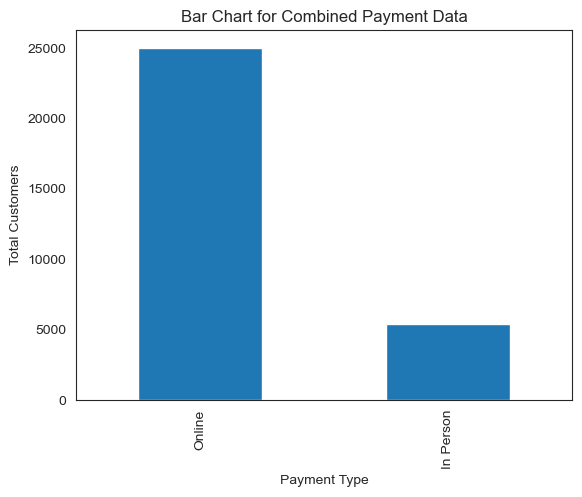

In [89]:
df_feature_creation['payment_method_combined'].value_counts().plot(kind='bar')

plt.title('Bar Chart for Combined Payment Data')
plt.xlabel('Payment Type')
plt.ylabel('Total Customers')

plt.show()

b) missing values

In [90]:
df_feature_creation["payment_method_combined"].isnull().sum()

0

<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`payment_method_combined`**:
- Data type is object
- Customers paying online: 25012 (82%)
- Customers paying in Person: 5405 (17%)
- Customers paying upon pickup may not show up, delivery drives may have to wait longer to move on to the next order, etc. It would be in the company's best interest to move more payments to online.

## 2.2 city

#### 1. Why did we create the feature

> Based on project description, we know that ABCDeats business is based on three cities so it seemed like the regions starting with the same number were related to different areas of the same city. 

> Based on these asusmptions, we decided to combine the regions (including "Unknown Location") into 4 Cities:
    - City 2, City 4, City 8 and Unknown City

#### 2. How did we create the feature
> Combined regions based on their first digit --> for example, regions 2360, 2440 and 2490 are combined into 'city 2'

In [91]:
df_feature_creation["customer_region"].unique()

array([2360.0, 8670.0, 4660.0, 2440.0, 'Unknown Location', 4140.0, 2490.0,
       8370.0, 8550.0], dtype=object)

Creating the new feature

In [92]:
# creating a new variable (city) that groups regions by first digit
#df_feature_creation['city'] = df_feature_creation["customer_region"].astype("object").str[0]
#df_feature_creation["city"]

In [93]:
df_feature_creation["city"] = df_feature_creation["customer_region"].astype(str).apply(lambda x: f"City {x[0]}" if x!= "Unknown Location" else "Unknown City")

In [94]:
df_feature_creation["city"].unique()

array(['City 2', 'City 8', 'City 4', 'Unknown City'], dtype=object)

In [95]:
df_feature_creation["city"].describe()

count      30417
unique         4
top       City 2
freq       10278
Name: city, dtype: object

In [96]:
#creating data frames for each of the cities
city_2 = df_feature_creation[df_feature_creation['city'] == 'City 2']
city_4 = df_feature_creation[df_feature_creation['city'] == 'City 4']
city_8 = df_feature_creation[df_feature_creation['city'] == 'City 8']

In [140]:
df_feature_creation['city'].value_counts()

city
City 2          10278
City 4          10014
City 8           9697
Unknown City      428
Name: count, dtype: int64

a) bar plot

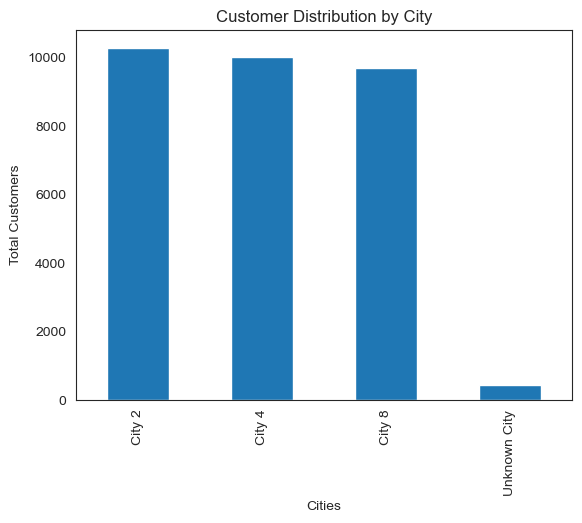

In [98]:
#add bar chart for this
#making a boxplot for region data
city_counts = pd.DataFrame(df_feature_creation['city'].value_counts())

df_feature_creation['city'].value_counts().plot(kind='bar')

plt.title('Customer Distribution by City')
plt.xlabel('Cities')
plt.ylabel('Total Customers')

plt.show()

b) missing values

In [99]:
df_feature_creation["city"].isnull().sum()

0

<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`city`**  
- If we assume the first digit of the region indicates city, customers are split appproximately evenly throughout the three cities
    - 10,278 customers in City 2 (cities beginning with 2)
    - 10,014 customers in City 4 (cities beginning with 4)
    - 9,697 customers in City 8 (cities beginning with 8)
- 428 "unknown region" values are kept as unknown when assigned to a city
- We don't know specifically what these region codes represent, not much benefit is gained by analying the regions individually. When we combine the regions into cities, this feature gains meaning and interpretability.

---

## 2.3 tot_orders_per_client

#### 1. Why did we create the feature

> Provides a direct measure of how frequently a customer engages with the platform provind more agregating information provided by original features
> <br> Allows for cross feature creation: It will allow us to develop new features to segment customers according to different perspectives. Features like the average money spent per order or average number of products made per order

#### 2. How did we create the feature?
> The DOW variables represent how many orders each client made per day of the week throughout the 3 months
> Since these features are mutualy exclusive and don't have any missing values, we can sum them row wise to determine total number of orders per client

In [100]:
columns_to_sum = [f'DOW_{i}' for i in range(7)]
df_feature_creation["tot_orders_per_client"] = df_feature_creation[columns_to_sum].sum(axis=1).astype(int)

a) Histogram and boxplot

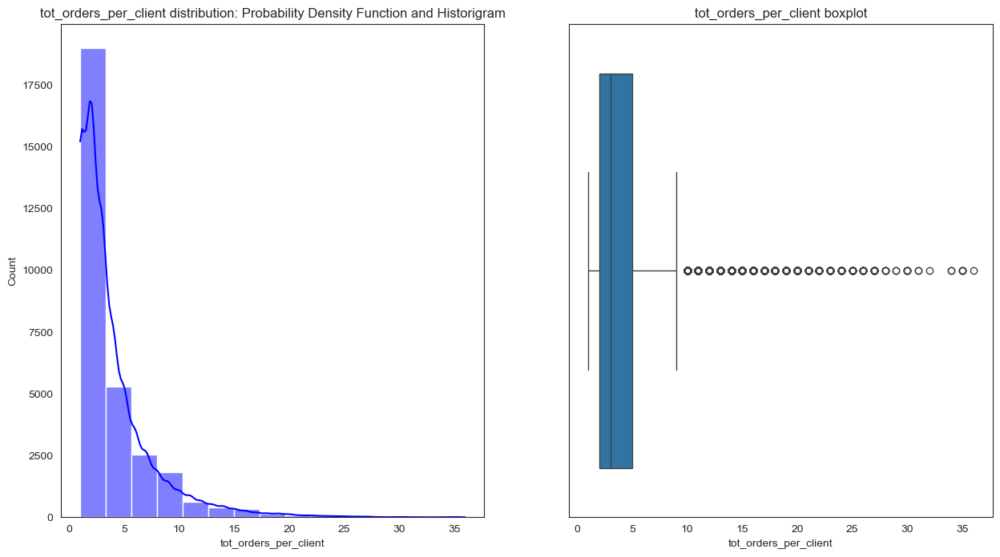

In [101]:
fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df_feature_creation["tot_orders_per_client"], kde=True, color="blue", bins=15, ax=axes[0])
axes[0].set_title("tot_orders_per_client distribution: Probability Density Function and Historigram")

sns.boxplot(x = df_feature_creation["tot_orders_per_client"], ax=axes[1])
axes[1].set_title("tot_orders_per_client boxplot")
plt.show()

In [102]:
df_feature_creation["tot_orders_per_client"].describe()

count    30417.000000
mean         3.872045
std          3.564577
min          1.000000
25%          2.000000
50%          3.000000
75%          5.000000
max         36.000000
Name: tot_orders_per_client, dtype: float64

b) Total orders per client class segmentation 

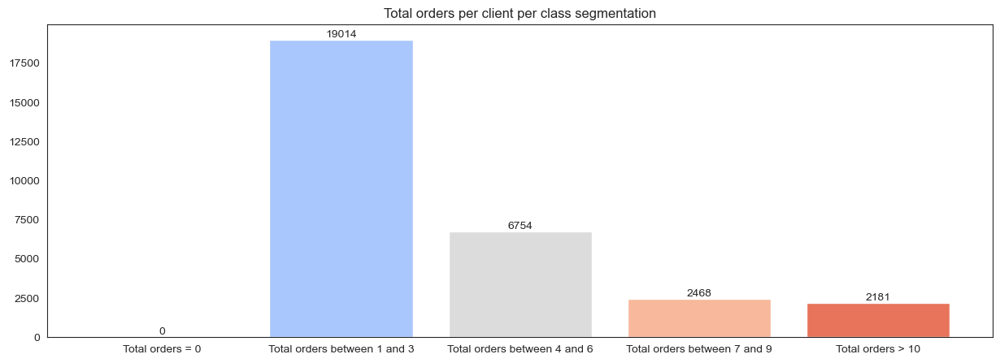

In [103]:
tot_orders_0 = df_feature_creation.loc[df_feature_creation["tot_orders_per_client"] == 0].shape[0]
tot_orders_1_3 = df_feature_creation.loc[(df_feature_creation["tot_orders_per_client"] >= 1) & (df_feature_creation["tot_orders_per_client"] <=3)].shape[0]
tot_orders_4_6 = df_feature_creation.loc[(df_feature_creation["tot_orders_per_client"] >=4) & (df_feature_creation["tot_orders_per_client"] <=6)].shape[0]
tot_orders_7_9 = df_feature_creation.loc[(df_feature_creation["tot_orders_per_client"] >=7) & (df_feature_creation["tot_orders_per_client"] <=9)].shape[0]
tot_orders_10 = df_feature_creation.loc[df_feature_creation["tot_orders_per_client"] >=10].shape[0]

total_elements = df_feature_creation.shape[0]

fig, ax = plt.subplots(1,1, figsize = (15,5))
y_values= [tot_orders_0, tot_orders_1_3, tot_orders_4_6, tot_orders_7_9, tot_orders_10]
x_values = ["Total orders = 0", "Total orders between 1 and 3", "Total orders between 4 and 6", "Total orders between 7 and 9", "Total orders > 10" ]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element}" for element in y_values])
ax.set_title("Total orders per client per class segmentation")
plt.show()

c) Strange clients

In [83]:
# Some clients have 0 total orders if we sum the DOW variables

HR_columns = [element for element in df_feature_creation.columns if 'HR' in str(element)]
strange_clients_df = df_feature_creation.loc[(df_feature_creation["tot_orders_per_client"]==0) & ( (df_feature_creation["product_count"]!=0) | (df_feature_creation["tot_chain_orders"]!=0) | (df_feature_creation["first_order"]!=0)| (df_feature_creation["last_order"]!=0) )]
tot_orders_0= df_feature_creation.loc[(df_feature_creation["tot_orders_per_client"]==0)].shape[0]
strange_clients_df

,customer_region,customer_age,vendor_count,product_count,tot_chain_orders,first_order,last_order,last_promo,payment_method,CUI_American,...,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,payment_method_combined,city,tot_orders_per_client
customer_id,,,,,,,,,,,,,,,,,,,,,


c) Missing values

In [638]:
df_feature_creation["tot_orders_per_client"].isnull().sum()

0

d) Outliers

In [639]:
outlier_detection(df_feature_creation, "tot_orders_per_client")


tot_orders_per_client: 
Number of extreme outliers: 685 (34%) 
Number of moderate outliers: 1307 (65%) 
Total number of outliers: 1992
Q3 + 1.5*IQR = 9.5 
Q3 + 3*IQR = 14.0
Max: 36 
Min: 1 
95th percentil: 11.0
99th percentil: 18.0 



<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`tot_orders_per_client`**
1. Represents a numerical feature with total orders made per clietn
2. To build the feature, we had 2 initial options: sum all the DOW variables or all the HR variables. We decided to use the CUI features
4. From 30,417 clients, around 19k have made a total number of orders between 1 and 3
5. From boxplot and histogram, we can conclude that:
    - highly positively skewed distribution
6. No NaN values



---

## 2.4 tot_money_spent_per_client


#### 1. Why did we create the feature

> Helps determine which clients are contributing the most revenue to the business.

> Enables customer segmentation, such as distinguishing "premium customers" from "low-value customers."

#### 2.How did we create the feature?
> The CUI variables represent the monetary amount spent by each client in each of the different types of cousines throughout the 3 months

> Since these variables are mutually exclusive and don't have any missing values, we just need to sum these values row wise to obtain the total money spent per client

In [104]:
CUI_columns = [element for element in df_feature_creation.columns if 'CUI' in str(element)]
df_feature_creation[CUI_columns].isnull().sum()
df_feature_creation["tot_money_spent_per_client"] = df_feature_creation[CUI_columns].sum(axis=1).astype(float)

a) Histogram and Boxplot

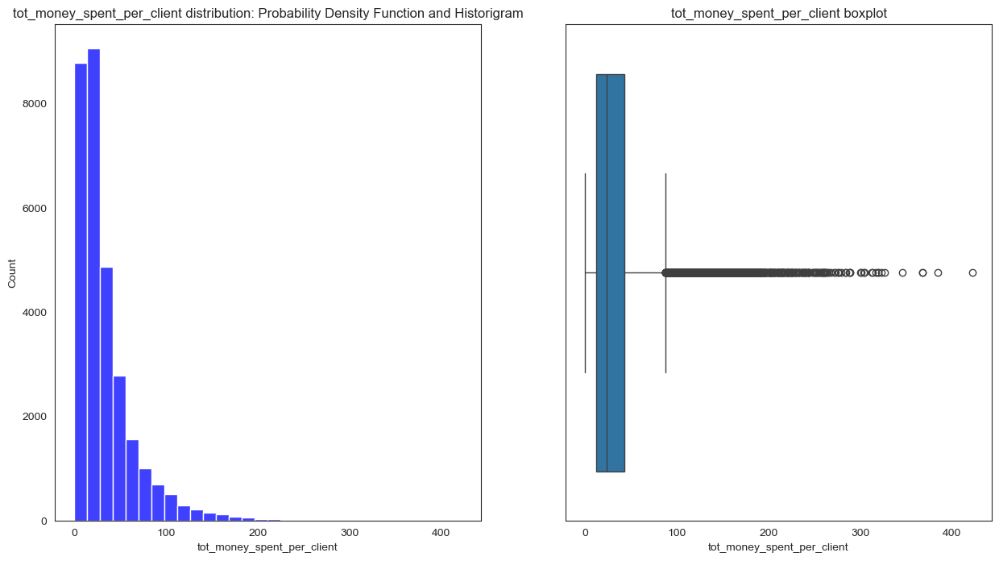

In [106]:
fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df_feature_creation["tot_money_spent_per_client"], kde=False, color="blue", bins=30, ax=axes[0])
axes[0].set_title("tot_money_spent_per_client distribution: Probability Density Function and Historigram")

sns.boxplot(x = df_feature_creation["tot_money_spent_per_client"], ax=axes[1])
axes[1].set_title("tot_money_spent_per_client boxplot")
plt.show()

b) Total money spent per client per class segmentation 

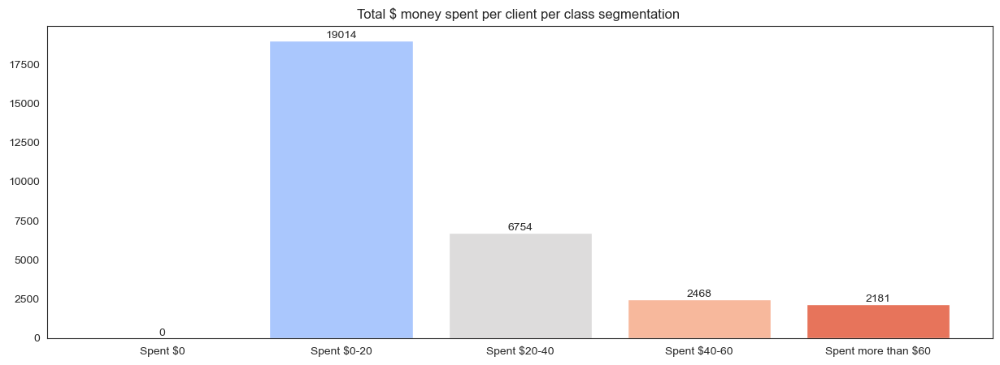

In [107]:
spent_0 = df_feature_creation.loc[df_feature_creation["tot_money_spent_per_client"] == 0].shape[0]
spent_0_20 =  df_feature_creation.loc[(df_feature_creation["tot_money_spent_per_client"] > 0) & (df_feature_creation["tot_money_spent_per_client"] <20)].shape[0]
spent_20_40 = df_feature_creation.loc[(df_feature_creation["tot_money_spent_per_client"] >= 20) & (df_feature_creation["tot_money_spent_per_client"] <40)].shape[0]
spent_40_60 = df_feature_creation.loc[(df_feature_creation["tot_money_spent_per_client"] >= 40) & (df_feature_creation["tot_money_spent_per_client"] <60)].shape[0]
spent_more_60 = df_feature_creation.loc[(df_feature_creation["tot_money_spent_per_client"] >= 60) ].shape[0]

total_elements = df_feature_creation.shape[0]

fig, ax = plt.subplots(1,1, figsize = (15,5))
y_values= [tot_orders_0, tot_orders_1_3, tot_orders_4_6, tot_orders_7_9, tot_orders_10]
x_values = ["Spent $0", "Spent $0-20", "Spent $20-40", "Spent $40-60", "Spent more than $60" ]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element}" for element in y_values])
ax.set_title("Total $ money spent per client per class segmentation ")
plt.show()

c) Strange clients

In [108]:
#Check if there are any  clients that have $0 total money spent

tms_strange_clients_df = df_feature_creation.loc[(df_feature_creation["tot_money_spent_per_client"]==0) & (df_feature_creation["tot_orders_per_client"] == 0)]
tms_strange_clients_df

#There are no strange clients

,customer_region,customer_age,vendor_count,product_count,tot_chain_orders,first_order,last_order,last_promo,payment_method,CUI_American,...,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,payment_method_combined,city,tot_orders_per_client,tot_money_spent_per_client
customer_id,,,,,,,,,,,,,,,,,,,,,


d) Missing values

In [109]:
df_feature_creation["tot_orders_per_client"].isnull().sum()

0

e) Outliers

In [110]:
outlier_detection(df_feature_creation, "tot_orders_per_client")

tot_orders_per_client: 
Number of extreme outliers: 685 (34%) 
Number of moderate outliers: 1307 (65%) 
Total number of outliers: 1992
Q3 + 1.5*IQR = 9.5 
Q3 + 3*IQR = 14.0
Max: 36 
Min: 1 
95th percentil: 11.0
99th percentil: 18.0 



<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`tot_money_spent_per_client`**
1. Represents a numerical feature with total money spent made per client
2. To build the feature, we did the sum of All CUI variables
3. Strange values are not detected. 
4. From 30,417 clients, around 19k spent between $0-$20
5. From boxplot and histogram we can conclude that:
    - There are a lot of outliers present (both extreme and moderate)
    - highly positively skewed distribution meaning that most clients didn't spend a lot of money during the 3 months
    
6. No NaN values


---

## 2.5 CUI binary variables, num_unique_cuisines_tried, client_behavior_cuisine_preference

> #### CUI binary variable

Why did we create the feature?
1. Since each CUI variable has a lot of non spending clients, we decided to create a new feature ('purchased_cousine_type') that evaluates whether the client spent any money or not for each type of cuisine
2. It will help us simplify the data and allow us to determine the number of unqiue cuisines tried by each customer 

How did we create the feature
1. has value equal to 0 if client didn't spend any money on that cuisine
2. has value equal to 1 if client spend something on that cuisine

<br>

> #### num_unique_cuisines_tried
Why did we create the feature?
1. It will provide a good insight into customer diversity and engagement
2. Help us differentitate between “Loyalists clients" (who tend always order from same cuisines) and "Variety Seeker clients" (who prefer to try different things)

How did we create the feature ?
1. Since the purchased binary feature indicate whether the client spent money or not in the cuisines, ff we sum all of them row wise, we will get the total number of unique cuisines tried by each client.

<br>

> #### client_behavior_cuisine_preference
Why did we create this feature ?

1. Helps understand client preferences and behavior regarding their favorite type of cuisines 
2. Helps define type of clients for eahc type of cuisines

How did we create the feature?
1. To create this feature, we are assuming that spending more money in a specific cuisine implies that the respective cuisines corresponds to the client's favorite cuisine 
2. For each client we checked the Cuisine where he spent the most


Creating the **'purchased_'** binary features

In [111]:
for element in CUI_columns:
    current_ele = str(element).split("_")[1]
    type_clients = df_feature_creation[element].map(lambda x: 0 if x==0 else 1)
    df_feature_creation["purchased_"+ current_ele] = type_clients

purchased_features = [element for element in df_feature_creation.columns if 'purchased' in str(element)]
df_feature_creation[purchased_features]

,purchased_American,purchased_Asian,purchased_Beverages,purchased_Cafe,purchased_Chicken Dishes,purchased_Chinese,purchased_Desserts,purchased_Healthy,purchased_Indian,purchased_Italian,purchased_Japanese,purchased_Noodle Dishes,purchased_OTHER,purchased_Street Food / Snacks,purchased_Thai
customer_id,,,,,,,,,,,,,,,
1b8f824d5e,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
5d272b9dcb,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
f6d1b2ba63,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
180c632ed8,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0
4eb37a6705,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
f6b6709018,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
f74ad8ce3f,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0


Converting dtype of purchased features to int32 to differentiate them from the actual numeric features

In [112]:
for feature in purchased_features:
    df_feature_creation[feature] = df_feature_creation[feature].astype('int32')

a) Bar plots

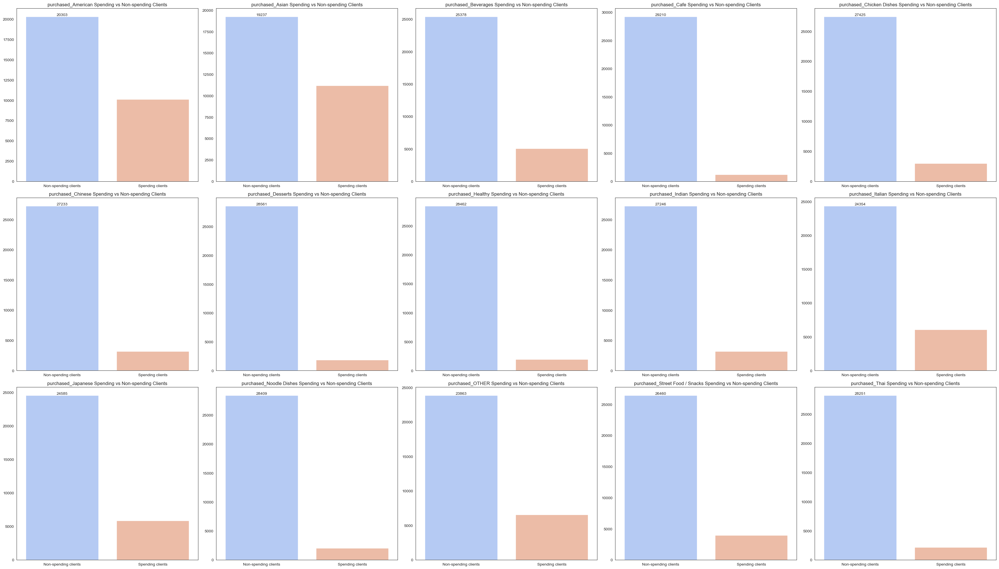

In [113]:
warnings.simplefilter(action='ignore', category=FutureWarning)
columns = purchased_features

fig, axes = plt.subplots(3, 5, figsize=(35, 20))

# Loop through each feature and plot barplots
for i, feature in enumerate(columns):
    ax = axes[i // 5, i % 5]
    sns.barplot(
        x=["Non-spending clients", "Spending clients"],
        y=[
            df_feature_creation.loc[df_feature_creation[feature] == 0].shape[0],
            df_feature_creation.loc[df_feature_creation[feature] == 1].shape[0],
        ],
        ax=ax,
        palette="coolwarm"
    )
    ax.set_title(f"{feature} Spending vs Non-spending Clients")
    ax.bar_label(ax.containers[0])

plt.tight_layout()
plt.show()


b) Missing values

In [114]:
df_feature_creation[purchased_features].isnull().sum()

purchased_American                0
purchased_Asian                   0
purchased_Beverages               0
purchased_Cafe                    0
purchased_Chicken Dishes          0
purchased_Chinese                 0
purchased_Desserts                0
purchased_Healthy                 0
purchased_Indian                  0
purchased_Italian                 0
purchased_Japanese                0
purchased_Noodle Dishes           0
purchased_OTHER                   0
purchased_Street Food / Snacks    0
purchased_Thai                    0
dtype: int64

Creating num_unique_cuisines_tried

In [115]:
df_feature_creation["num_unique_cuisines_tried"] = df_feature_creation[purchased_features].sum(axis = 1)

a) Histogram and boxplot

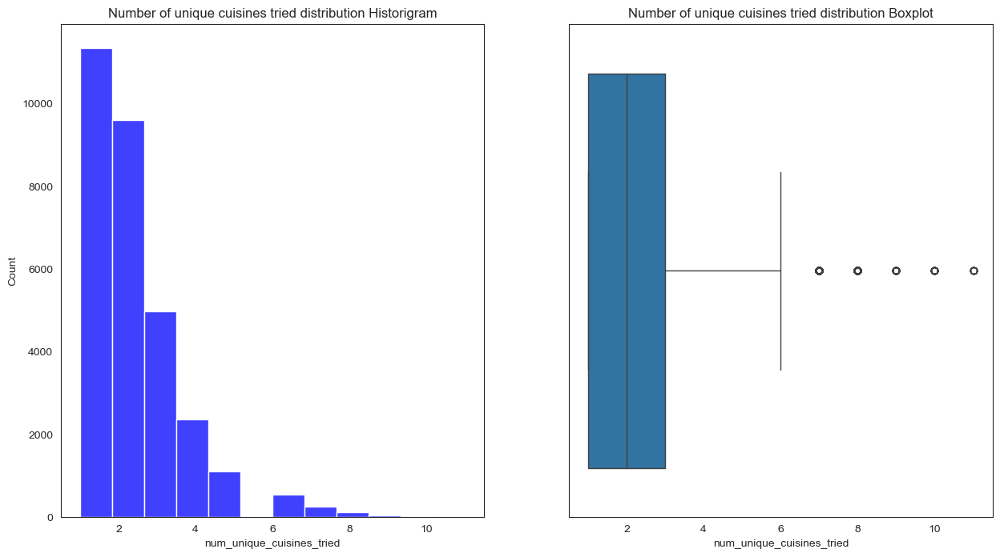

In [116]:
fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df_feature_creation["num_unique_cuisines_tried"], kde=False, color="blue", bins=12, ax=axes[0])
axes[0].set_title("Number of unique cuisines tried distribution Historigram")

sns.boxplot(x = df_feature_creation["num_unique_cuisines_tried"], ax=axes[1])
axes[1].set_title("Number of unique cuisines tried distribution Boxplot")
plt.show()

b) Number of unique cuisines tried per class segmentation bar plot

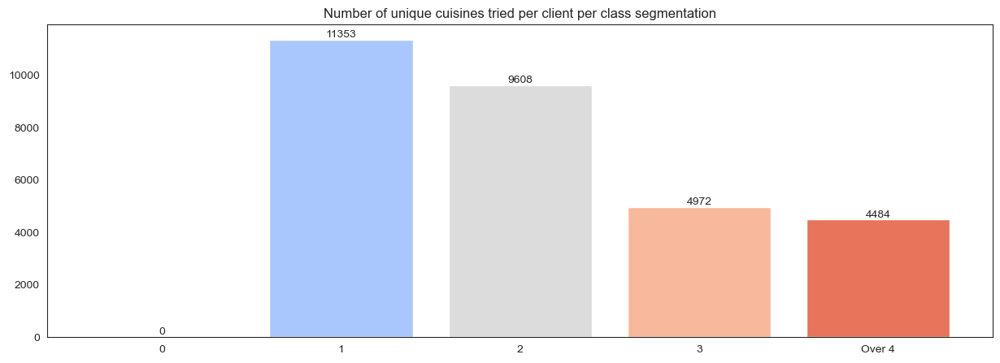

In [117]:
fig, ax = plt.subplots(1,1, figsize = (15,5))

unique_cui_0 = df_feature_creation.loc[df_feature_creation["num_unique_cuisines_tried"] == 0].shape[0]
unique_cui_1 = df_feature_creation.loc[df_feature_creation["num_unique_cuisines_tried"] == 1].shape[0]
unique_cui_2 = df_feature_creation.loc[df_feature_creation["num_unique_cuisines_tried"] == 2].shape[0]
unique_cui_3 = df_feature_creation.loc[df_feature_creation["num_unique_cuisines_tried"] == 3].shape[0]
unique_cui_over_4 = df_feature_creation.loc[df_feature_creation["num_unique_cuisines_tried"] >= 4].shape[0]

y_values = [unique_cui_0, unique_cui_1, unique_cui_2, unique_cui_3, unique_cui_over_4]
x_values = ["0", "1", "2", "3", "Over 4"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element}" for element in y_values])
ax.set_title("Number of unique cuisines tried per client per class segmentation")
plt.show()

c) Missing values

In [118]:
df_feature_creation["num_unique_cuisines_tried"].isnull().sum()

0

d) Outliers

In [119]:
outlier_detection(df_feature_creation,"num_unique_cuisines_tried")

num_unique_cuisines_tried: 
Number of extreme outliers: 29 (6%) 
Number of moderate outliers: 389 (93%) 
Total number of outliers: 418
Q3 + 1.5*IQR = 6.0 
Q3 + 3*IQR = 9.0
Max: 11 
Min: 1 
95th percentil: 5.0
99th percentil: 7.0 



e) Strange values

In [203]:
# Check if there are any clients that tried 0 unique cuisines

uct_strange_clients_df = df_feature_creation.loc[(df_feature_creation["tot_money_spent_per_client"]==0) & (df_feature_creation["tot_orders_per_client"] == 0) & (df_feature_creation["num_unique_cuisines_tried"] == 0)]
uct_strange_clients_df = df_feature_creation.loc[(df_feature_creation["tot_money_spent_per_client"]==0) & (df_feature_creation["tot_orders_per_client"] == 0)]
uct_strange_clients_df


# There are no strange values 

,customer_region,customer_age,vendor_count,product_count,tot_chain_orders,first_order,last_order,last_promo,payment_method,CUI_American,...,client_behavior_peak_preference,morning_num_orders,afternoon_num_orders,evening_num_orders,night_num_orders,avg_money_spent_per_order,avg_products_per_order,tot_non_chain_orders,client_behavior_chain_preference,percent_chain_orders
customer_id,,,,,,,,,,,,,,,,,,,,,


Creating client_behavior_cuisine_preference feature 

In [121]:
df_feature_creation["client_behavior_cuisine_preference"] = df_feature_creation[CUI_columns].idxmax(axis=1).str.replace("CUI_", "", regex=False)
df_feature_creation["client_behavior_cuisine_preference"].value_counts()

client_behavior_cuisine_preference
Asian                   6746
American                4047
OTHER                   3012
Italian                 2959
Japanese                2290
Street Food / Snacks    2211
Beverages               1968
Indian                  1605
Chinese                 1246
Chicken Dishes          1086
Noodle Dishes            825
Thai                     711
Healthy                  676
Desserts                 590
Cafe                     445
Name: count, dtype: int64

a) Bar plots

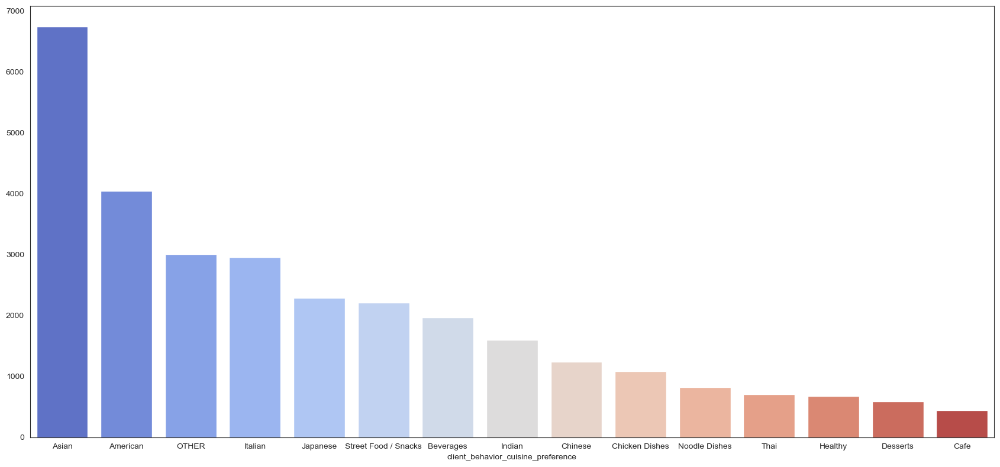

In [122]:
warnings.simplefilter(action='ignore', category=FutureWarning)
columns = purchased_features

fig, axes = plt.subplots(1, 1, figsize=(17, 8))
sns.barplot(
    x=df_feature_creation["client_behavior_cuisine_preference"].value_counts().index,
    y=df_feature_creation["client_behavior_cuisine_preference"].value_counts().values,
    ax=axes,
    palette="coolwarm"
)


plt.tight_layout()
plt.show()


b) Missing values

In [123]:
df_feature_creation["client_behavior_cuisine_preference"].isnull().sum()

0

In [124]:
#df_feature_creation.loc[df_feature_creation["client_behavior_cuisine_preference"].isin(["Asian", "American", "Italian"])].shape[0]/df_feature_creation.shape[0]
df_feature_creation.loc[df_feature_creation["client_behavior_cuisine_preference"].isin(["Asian", "American"])].shape[0]/df_feature_creation.shape[0]

0.3548344675674787

<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`CUI binary variables`**
1. Represents a binary feature that evaluates whether the client spent any money or not for each type of cousine. The value 0 means that the client didn't spent any money on that cousine and 1 that the client spent money
2. Important to highlight "American" and "Asian" cuisines with the highest numbers of spending clients. From the total ~30k clients in the dataset, ~6,7k and ~4k spent money on Asian and American cuisines respectively 
3. Important to note cafe as the CUI with the least number of spending clients (~0.5k)
4. No nan values


### Key notes **`num_unique_cuisines_tried`**
1. Represents a numerical feature with total number of unique cuisines tried per client.
2. To build the feature, we did the row wise sum of all binary CUI variables
3. Strange values are not detected. 
4. From 30,417 clients, ~11.3k tried a single cuisine. This suggests that a significant portion of the customer base may have narrow or specific tastes, preferring familiar options. 
5. No NaN values


### Key notes **`client_behavior_cuisine_preference`**
1. As expected Asian and American are the most popular Cuisines having with around 35% of clints having one or the other has their preferntial Cuisines
2. No missing values

---

## 2.6 peak_days_num_orders, off_peak_days_num_orders and client_behavior_peak_preference 

 > #### peak_days_num_orders and off_peak_days_num_orders 

Why did we create the features ?

1. We created the features related to the number of orders made during peak days or off peak days to reduce the input space dimensionality in a way tha would minimize loss of information
<br>  We opted for this approach instead of doing week_day_num_orders and weekend_num_orders considering the the analysis of the DOW variables distribution during EDA. We can see that orders made during the weekend do not exactly represent the days where the most orders were made.

How did we create the featutres ?
1. peak_days_num_orders: Correspond to the total number of orders made by the client on Thursdays, Fridays and Saturdays (correspond to the days with the most orders)
2. off_peak_num_orders: Correspond to the total number of orders made by the client made in the remaining days of the week (days with the least amount of orders)

<br>

> #### client_behavior_peak_preference - How did we create the feature?

Why did we create the feature ?
1. After creating the 'peak_days_num_orders' and 'off_peak_days_num_orders' we can determine for each client whether their mostly order during the peak or off peak days. This feature will be called client_behavior_peak_preference
2. Helps identify client behavior related to time-based order preferences reveal their habits 
3. Enables better demand forecasting during peak and off-peak periods.

How did we create the feature 
1. If the peak_days_num_orders is bigger than the off_peak_days_num_orders, client is considered a Peak Order client and classified as a 1
2. If the opposite happens, client is considered Off-Peak order client and classified as a 0


2.6.1 Creating **'peak_days_num_orders'** and **'off_peak_days_num_orders'** features

In [145]:
peak_days_columns = ["DOW_4", "DOW_5", "DOW_6"]
off_peak_days_columns = ["DOW_0", "DOW_1", "DOW_2", "DOW_3"]

df_feature_creation["peak_days_num_orders"] = df_feature_creation[peak_days_columns].sum(axis=1).astype(int)
df_feature_creation["off_peak_days_num_orders"] = df_feature_creation[off_peak_days_columns].sum(axis=1).astype(int)

In [146]:
print (f"peak_days_num_orders statistics: \n")
print (df_feature_creation["peak_days_num_orders"].describe())

print (f"\noff_peak_days_num_orders statistics \n")
print (df_feature_creation["off_peak_days_num_orders"].describe())


peak_days_num_orders statistics: 

count    30417.000000
mean         1.831706
std          1.933786
min          0.000000
25%          1.000000
50%          1.000000
75%          2.000000
max         20.000000
Name: peak_days_num_orders, dtype: float64

off_peak_days_num_orders statistics 

count    30417.000000
mean         2.040339
std          2.316968
min          0.000000
25%          1.000000
50%          1.000000
75%          3.000000
max         22.000000
Name: off_peak_days_num_orders, dtype: float64


a) Histogram and boxplot for 'peak_days_num_orders' and 'off_peak_days_num_orders' 

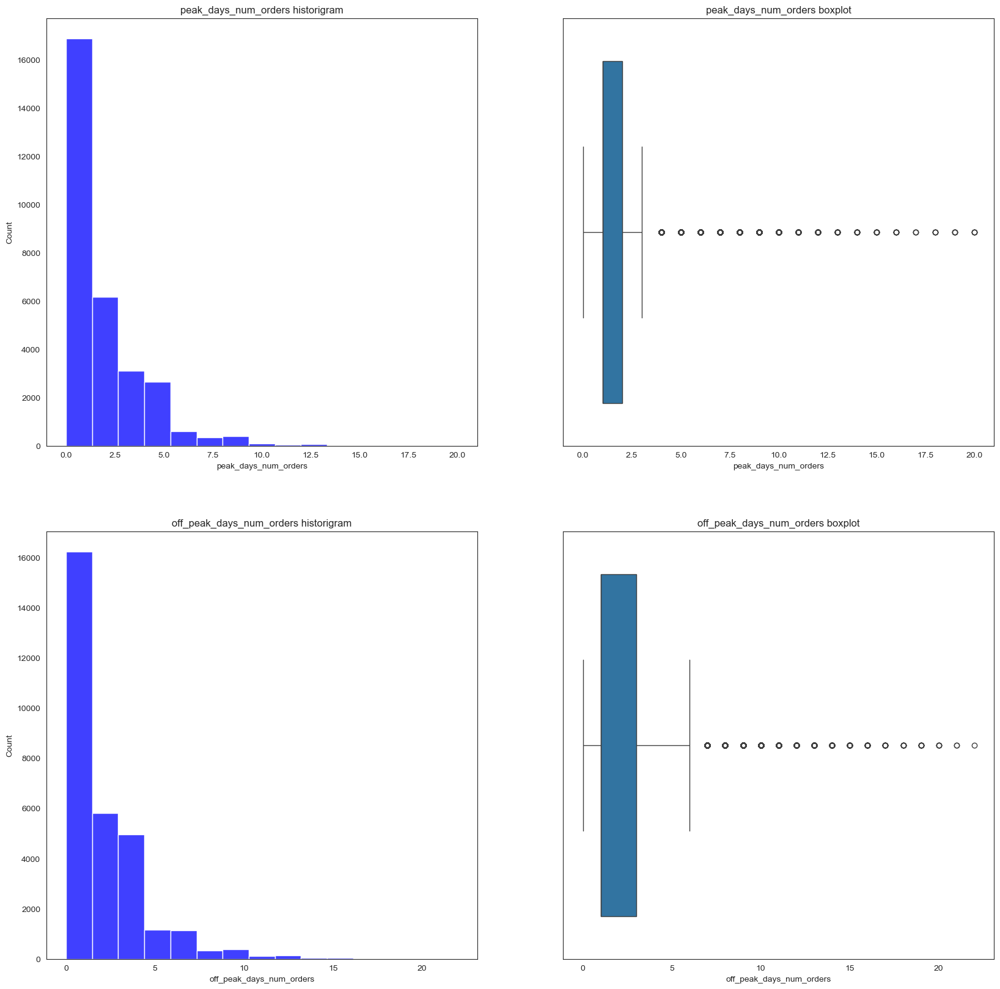

In [147]:
fig, axes = plt.subplots(2, 2, figsize = (20,20))

# Peak number of orders
sns.histplot(df_feature_creation["peak_days_num_orders"], kde=False, color="blue", bins=15, ax=axes[0,0])
axes[0,0].set_title("peak_days_num_orders historigram")

sns.boxplot(x = df_feature_creation["peak_days_num_orders"], ax=axes[0,1])
axes[0,1].set_title("peak_days_num_orders boxplot")

# Off-Peak number of orders
sns.histplot(df_feature_creation["off_peak_days_num_orders"], kde=False, color="blue", bins=15, ax=axes[1,0])
axes[1,0].set_title("off_peak_days_num_orders historigram")

sns.boxplot(x = df_feature_creation["off_peak_days_num_orders"], ax=axes[1,1])
axes[1,1].set_title("off_peak_days_num_orders boxplot")

plt.show()

b) Number of orders made during off-peak and peak days per class segmentation bar plot

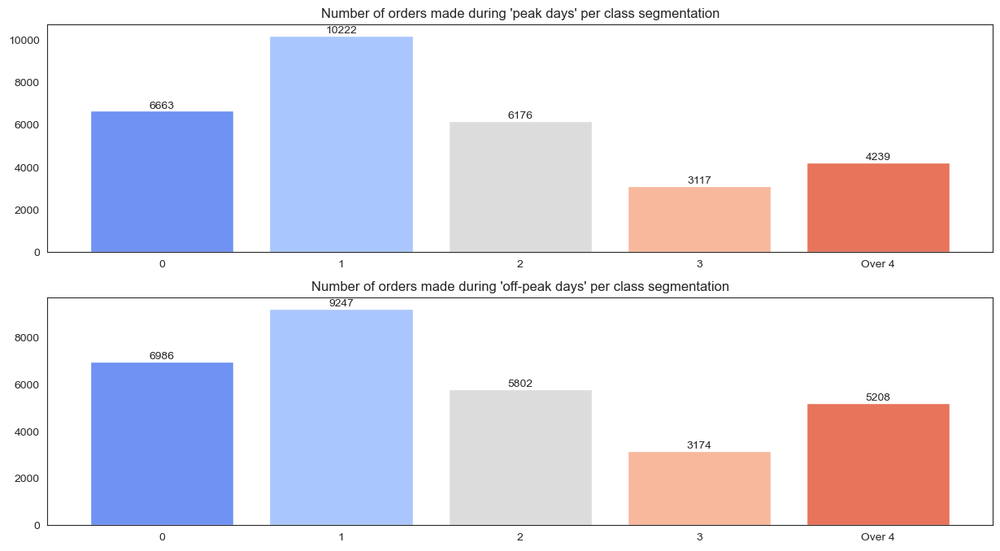

In [148]:
fig, ax = plt.subplots(2,1, figsize = (15,8))

# Peak days
peak_days_0 = df_feature_creation.loc[(df_feature_creation["peak_days_num_orders"] == 0)].shape[0]
peak_days_1 = df_feature_creation.loc[(df_feature_creation["peak_days_num_orders"] == 1)].shape[0]
peak_days_2 = df_feature_creation.loc[(df_feature_creation["peak_days_num_orders"] == 2)].shape[0]
peak_days_3 = df_feature_creation.loc[(df_feature_creation["peak_days_num_orders"] == 3)].shape[0]
peak_days_4more =df_feature_creation.loc[(df_feature_creation["peak_days_num_orders"] >= 4)].shape[0]

y_values = [peak_days_0, peak_days_1, peak_days_2, peak_days_3, peak_days_4more]
x_values = ["0", "1", "2", "3", "Over 4"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[0].bar(x_values, y_values, color=bar_colours)
ax[0].bar_label(p, labels= [f"{element}" for element in y_values], fontsize = 10)
ax[0].set_title("Number of orders made during 'peak days' per class segmentation")

# Off-Peak days
off_peak_days_0 = df_feature_creation.loc[(df_feature_creation["off_peak_days_num_orders"] == 0)].shape[0]
off_peak_days_1 = df_feature_creation.loc[(df_feature_creation["off_peak_days_num_orders"] == 1)].shape[0]
off_peak_days_2 = df_feature_creation.loc[(df_feature_creation["off_peak_days_num_orders"] == 2)].shape[0]
off_peak_days_3 = df_feature_creation.loc[(df_feature_creation["off_peak_days_num_orders"] == 3)].shape[0]
off_peak_days_4more =df_feature_creation.loc[(df_feature_creation["off_peak_days_num_orders"] >= 4)].shape[0]

y_values = [off_peak_days_0, off_peak_days_1, off_peak_days_2, off_peak_days_3, off_peak_days_4more]
x_values = ["0", "1", "2", "3", "Over 4"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[1].bar(x_values, y_values, color=bar_colours)
ax[1].bar_label(p, labels= [f"{element}" for element in y_values], fontsize = 10)
ax[1].set_title("Number of orders made during 'off-peak days' per class segmentation")

plt.show()

c) Missing values

In [149]:
print(df_feature_creation["off_peak_days_num_orders"].isnull().sum())
print(df_feature_creation["peak_days_num_orders"].isnull().sum())

0
0


d) Outliers

In [150]:
outlier_detection(df_feature_creation, ["off_peak_days_num_orders","peak_days_num_orders"])

off_peak_days_num_orders: 
Number of extreme outliers: 561 (41%) 
Number of moderate outliers: 780 (58%) 
Total number of outliers: 1341
Q3 + 1.5*IQR = 6.0 
Q3 + 3*IQR = 9.0
Max: 22 
Min: 0 
95th percentil: 7.0
99th percentil: 11.0 

peak_days_num_orders: 
Number of extreme outliers: 1597 (48%) 
Number of moderate outliers: 1704 (51%) 
Total number of outliers: 3301
Q3 + 1.5*IQR = 3.5 
Q3 + 3*IQR = 5.0
Max: 20 
Min: 0 
95th percentil: 6.0
99th percentil: 9.0 



2.6.2 Creating feature **client_behavior_peak_preference** regarding num_orders made in each category

In [151]:
df_feature_creation.loc[df_feature_creation["peak_days_num_orders"] > df_feature_creation["off_peak_days_num_orders"]].shape[0]
df_feature_creation.loc[df_feature_creation["peak_days_num_orders"] < df_feature_creation["off_peak_days_num_orders"]].shape[0]


df_feature_creation["client_behavior_peak_preference"] = df_feature_creation.apply(lambda x: 1 if x["peak_days_num_orders"] >= x["off_peak_days_num_orders"] else 0, axis=1 )

Changing the dtype of client_behavior_peak_preference to int32 to differentiate it from numerical features

In [152]:
df_feature_creation["client_behavior_peak_preference"] = df_feature_creation["client_behavior_peak_preference"].astype('int32')

a) Client order behaviour bar plot

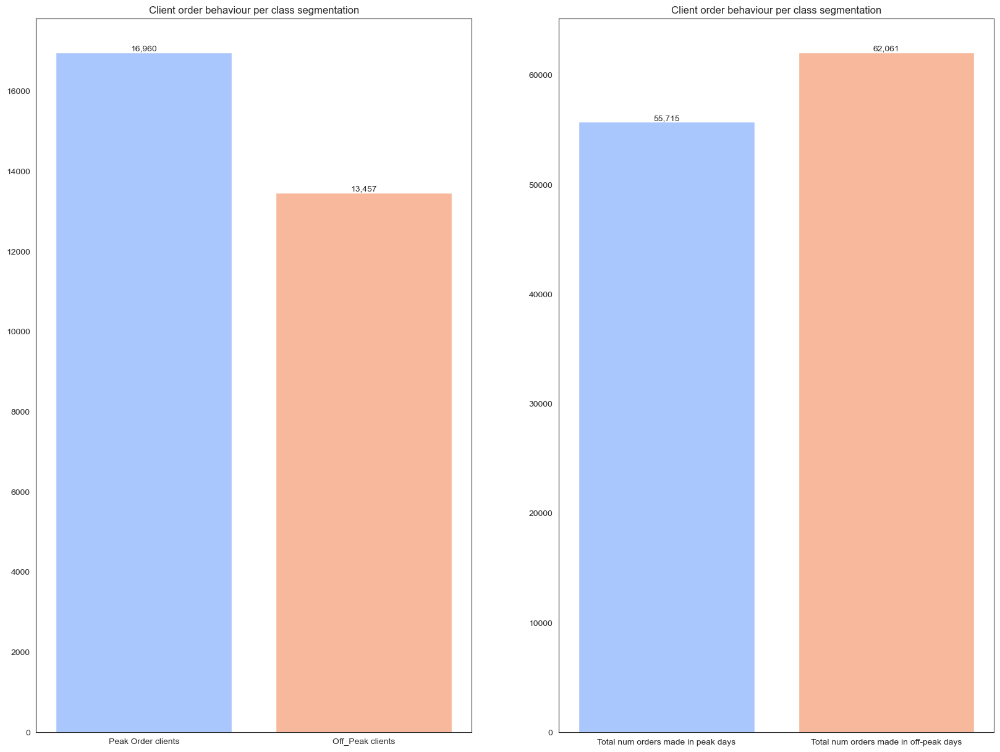

In [153]:
sns.set_style("white")
fig, ax = plt.subplots(1,2, figsize = (20,15))

# Client order behaviour per class segmentation
peak_order_num_clients = df_feature_creation.loc[df_feature_creation["client_behavior_peak_preference"] == 1].shape[0]
off_peak_order_num_clients = df_feature_creation.loc[df_feature_creation["client_behavior_peak_preference"] == 0].shape[0]

y_values = [peak_order_num_clients, off_peak_order_num_clients]
x_values = ["Peak Order clients","Off_Peak clients"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[0].bar(x_values, y_values, color=bar_colours)
ax[0].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[0].set_title("Client order behaviour per class segmentation")

# Total orders made during peak and off peak days bar plots

tot_num_peak_days_orders = df_feature_creation["peak_days_num_orders"].sum()
tot_num_off_peak_days_orders = df_feature_creation["off_peak_days_num_orders"].sum()

y_values = [tot_num_peak_days_orders, tot_num_off_peak_days_orders  ]
x_values = ["Total num orders made in peak days","Total num orders made in off-peak days"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[1].bar(x_values, y_values, color=bar_colours)
ax[1].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[1].set_title("Client order behaviour per class segmentation")

plt.show()

b) Missing values

In [154]:
df_feature_creation["client_behavior_peak_preference"].isnull().sum()

0

c) Duplicate values

In [155]:
df_feature_creation["client_behavior_peak_preference"].duplicated().sum()

30415

<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`peak_days_num_orders`** and **`off_peak_days_num_orders`**
1. Respectively, the features represent the total number of orders made during peak days (Thursday, Saturday and Sunday) and off-peak days (remaining days) per client during the 3 months.
2. 75% of clients have made less or equal to 3 orders during peak days and off-peak days.
3. Both have outliers and no nan values


### Key notes **`client_behavior_peak_preference`**
1. Represents a binary feature that evaluates whether the client has made more orders during peak or off-peak days. Value 0 means that the client has made more orders during off-peak days and 1 means that the client has made more orders during peak days
2. Important to highlight the fact that despite the total orders made during peak days (~55) being superior to the total orders made during off-peak days (~62k), the number of peak orders clients (~17k) is superior than the number of off-peak clients (~14k). This means that despite more orders being made during the 4 off peak days, more clients prefer to make their orders during the peak days 
3. No nan values

---

## 2.7 morning_num_orders, afternoon_num_orders, evening_num_orders and night_num_orders

#### Why did we create the features ?
1. Help determine the times of day when customers prefer to place orders.
2. Reducing input space dimensionality by aggregating the 24 initial features into four, helping mitigate this risk by consolidating the relevant information into fewer, meaningful variables.

#### How did we create the features?
1. We decided to create four features:
    - morning_num_orders: includes number of orders made per client from 6:00 - 11:59 (HR_6 - HR_11)
    - afternoon_num_orders: includes number of orders made per client from 12:00 - 17:59 (HR_12 - HR_17)
    - evening num_orders: includes number of orders made per client from 18:00 - 21:59 (HR_18 - HR_21)
    - night_num_orders: includes number of orders made per client from 22:00 - 5:59 (HR_22 - HR_5)

2. Opted for uneven time slots so they are meaningful and capture typical customer behavior patterns

a) Creating the features

In [161]:
morning_columns = [element for element in HR_columns if int(element.split("_")[1]) in range (6,12)]
afternoon_columns = [element for element in HR_columns if int(element.split("_")[1]) in range (12,18)]
evening_columns = [element for element in HR_columns if int(element.split("_")[1]) in range (18,22)]
night_columns = ['HR_22', 'HR_23', 'HR_0', 'HR_1', 'HR_2', 'HR_3', 'HR_4', 'HR_5']

df_feature_creation["morning_num_orders"] = df_feature_creation[morning_columns].sum(axis=1).astype(int)
df_feature_creation["afternoon_num_orders"] = df_feature_creation[afternoon_columns].sum(axis=1).astype(int)
df_feature_creation["evening_num_orders"] = df_feature_creation[evening_columns].sum(axis=1).astype(int)
df_feature_creation["night_num_orders"] = df_feature_creation[night_columns].sum(axis=1).astype(int)

In [162]:
print (f"morning_num_orders statistics: \n")
print (df_feature_creation["morning_num_orders"].describe())

print (f"\nafternoon_num_orders statistics \n")
print (df_feature_creation["afternoon_num_orders"].describe())

print (f"\nevening_num_orders statistics \n")
print (df_feature_creation["evening_num_orders"].describe())

print (f"\n night_num_orders statistics \n")
print (df_feature_creation["night_num_orders"].describe())

morning_num_orders statistics: 

count    30417.000000
mean         1.060887
std          1.631340
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max         21.000000
Name: morning_num_orders, dtype: float64

afternoon_num_orders statistics 

count    30417.000000
mean         1.618700
std          2.118868
min          0.000000
25%          0.000000
50%          1.000000
75%          2.000000
max         21.000000
Name: afternoon_num_orders, dtype: float64

evening_num_orders statistics 

count    30417.000000
mean         0.713318
std          1.412843
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max         16.000000
Name: evening_num_orders, dtype: float64

 night_num_orders statistics 

count    30417.000000
mean         0.479140
std          1.050522
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max         12.000000
Name: night_num_orders, dtype: float64

b) Plot histogram and boxplot for each created feature

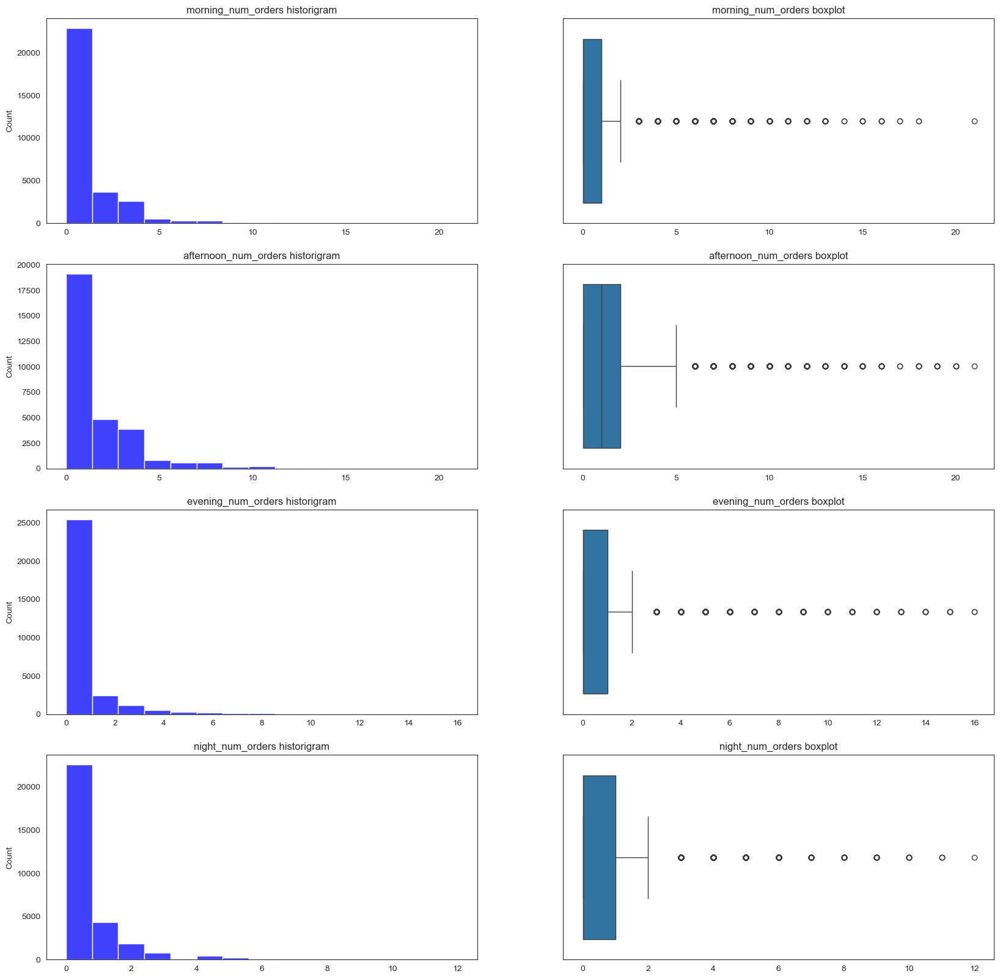

In [163]:
fig, axes = plt.subplots(4, 2, figsize = (20,20))

# Morning number of orders
sns.histplot(df_feature_creation["morning_num_orders"], kde=False, color="blue", bins=15, ax=axes[0,0])
axes[0,0].set_title("morning_num_orders historigram")
axes[0,0].set_xlabel("")

sns.boxplot(x = df_feature_creation["morning_num_orders"], ax=axes[0,1])
axes[0,1].set_title("morning_num_orders boxplot")
axes[0,1].set_xlabel("")

# Afternoon number of orders
sns.histplot(df_feature_creation["afternoon_num_orders"], kde=False, color="blue", bins=15, ax=axes[1,0])
axes[1,0].set_title("afternoon_num_orders historigram")
axes[1,0].set_xlabel("")

sns.boxplot(x = df_feature_creation["afternoon_num_orders"], ax=axes[1,1])
axes[1,1].set_title("afternoon_num_orders boxplot")
axes[1,1].set_xlabel("")

# Afternoon number of orders
sns.histplot(df_feature_creation["evening_num_orders"], kde=False, color="blue", bins=15, ax=axes[2,0])
axes[2,0].set_title("evening_num_orders historigram")
axes[2,0].set_xlabel("")

sns.boxplot(x = df_feature_creation["evening_num_orders"], ax=axes[2,1])
axes[2,1].set_title("evening_num_orders boxplot")
axes[2,1].set_xlabel("")

# Night number of orders
sns.histplot(df_feature_creation["night_num_orders"], kde=False, color="blue", bins=15, ax=axes[3,0])
axes[3,0].set_title("night_num_orders historigram")
axes[3,0].set_xlabel("")

sns.boxplot(x = df_feature_creation["night_num_orders"], ax=axes[3,1])
axes[3,1].set_title("night_num_orders boxplot")
axes[3,1].set_xlabel("")


plt.show()

c) Client Order Frequency Analysis for Morning/Afternoon/Evening/Night Time Slots

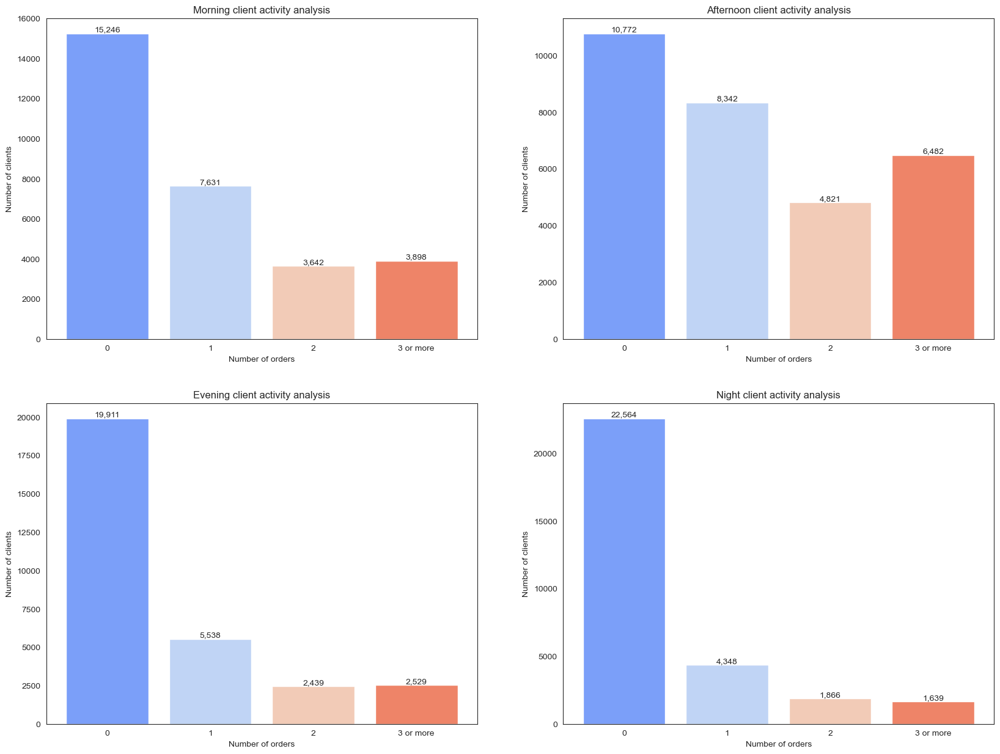

In [164]:
fig, ax = plt.subplots(2,2, figsize = (20,15))

# Morning
morning_orders_0 = df_feature_creation.loc[df_feature_creation["morning_num_orders"] == 0].shape[0]
morning_orders_1 = df_feature_creation.loc[df_feature_creation["morning_num_orders"] == 1].shape[0]
morning_orders_2 = df_feature_creation.loc[df_feature_creation["morning_num_orders"] == 2].shape[0]
morning_orders_3_more = df_feature_creation.loc[df_feature_creation["morning_num_orders"] >= 3].shape[0]

y_values = [morning_orders_0, morning_orders_1, morning_orders_2, morning_orders_3_more]
x_values = ["0","1", "2", "3 or more"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[0, 0].bar(x_values, y_values, color=bar_colours)
ax[0,0].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[0,0].set_title("Morning client activity analysis")
ax[0,0].set_ylabel("Number of clients")
ax[0,0].set_xlabel("Number of orders")


# Afternoon
afternoon_orders_0 = df_feature_creation.loc[df_feature_creation["afternoon_num_orders"] == 0].shape[0]
afternoon_orders_1 = df_feature_creation.loc[df_feature_creation["afternoon_num_orders"] == 1].shape[0]
afternoon_orders_2 = df_feature_creation.loc[df_feature_creation["afternoon_num_orders"] == 2].shape[0]
afternoon_orders_3_more = df_feature_creation.loc[df_feature_creation["afternoon_num_orders"] >= 3].shape[0]

y_values = [afternoon_orders_0, afternoon_orders_1, afternoon_orders_2, afternoon_orders_3_more]
x_values = ["0","1", "2", "3 or more"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[0, 1].bar(x_values, y_values, color=bar_colours)
ax[0,1].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[0,1].set_title("Afternoon client activity analysis")
ax[0,1].set_ylabel("Number of clients")
ax[0,1].set_xlabel("Number of orders")


# Evening
evening_orders_0 = df_feature_creation.loc[df_feature_creation["evening_num_orders"] == 0].shape[0]
evening_orders_1 = df_feature_creation.loc[df_feature_creation["evening_num_orders"] == 1].shape[0]
evening_orders_2 = df_feature_creation.loc[df_feature_creation["evening_num_orders"] == 2].shape[0]
evening_orders_3_more = df_feature_creation.loc[df_feature_creation["evening_num_orders"] >= 3].shape[0]

y_values = [evening_orders_0, evening_orders_1, evening_orders_2, evening_orders_3_more]
x_values = ["0","1", "2", "3 or more"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[1, 0].bar(x_values, y_values, color=bar_colours)
ax[1,0].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[1,0].set_title("Evening client activity analysis")
ax[1,0].set_ylabel("Number of clients")
ax[1,0].set_xlabel("Number of orders")

# Night
night_orders_0 = df_feature_creation.loc[df_feature_creation["night_num_orders"] == 0].shape[0]
night_orders_1 = df_feature_creation.loc[df_feature_creation["night_num_orders"] == 1].shape[0]
night_orders_2 = df_feature_creation.loc[df_feature_creation["night_num_orders"] == 2].shape[0]
night_orders_3_more = df_feature_creation.loc[df_feature_creation["night_num_orders"] >= 3].shape[0]

y_values = [night_orders_0, night_orders_1, night_orders_2, night_orders_3_more]
x_values = ["0","1", "2", "3 or more"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax[1, 1].bar(x_values, y_values, color=bar_colours)
ax[1,1].bar_label(p, labels= [f"{element:,}" for element in y_values], fontsize =10)
ax[1,1].set_title("Night client activity analysis")
ax[1,1].set_ylabel("Number of clients")
ax[1,1].set_xlabel("Number of orders")

plt.show()

d) Number of orders Per Time of day: Morning, Afternoon, Evening, and Night

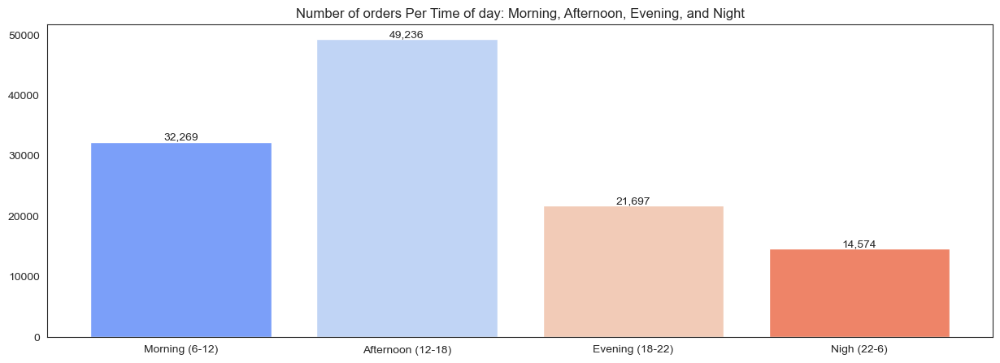

In [165]:
fig, ax = plt.subplots(1,1, figsize = (15,5))

morning_tot_orders = df_feature_creation["morning_num_orders"].sum()
afternoon_tot_orders = df_feature_creation["afternoon_num_orders"].sum()
evening_tot_orders = df_feature_creation["evening_num_orders"].sum()
night_tot_orders = df_feature_creation["night_num_orders"].sum()

y_values = [morning_tot_orders, afternoon_tot_orders, evening_tot_orders, night_tot_orders]
x_values = ["Morning (6-12)", "Afternoon (12-18)", "Evening (18-22)", "Nigh (22-6)"]
bar_colours = sns.color_palette("coolwarm", len(x_values))

p = ax.bar(x_values, y_values, color=bar_colours)
ax.bar_label(p, labels= [f"{element:,}" for element in y_values])
ax.set_title("Number of orders Per Time of day: Morning, Afternoon, Evening, and Night")
plt.show()


e) missing values

In [166]:
df_feature_creation[["morning_num_orders", "afternoon_num_orders","evening_num_orders", "night_num_orders"]].isnull().sum()

#No nan values 


morning_num_orders      0
afternoon_num_orders    0
evening_num_orders      0
night_num_orders        0
dtype: int64

f) Total amount of orders made by the whole client base

In [167]:
tot_num_orders = df_feature_creation["morning_num_orders"].sum() + df_feature_creation["afternoon_num_orders"].sum() + df_feature_creation["evening_num_orders"].sum() + df_feature_creation["night_num_orders"].sum()
tot_num_orders

117776

<div class="alert alert-block alert-info" style="font-size:16px">

### Key notes **`morning_num_orders`**, **`afternoon_num_orders`** , **`evening_num_orders`** and **`night_num_orders`**
These feature group order times (HR features) into four categories. This dimensionality reduction allows for a clearer analysis of customer behavior by meal times. We found that afternoons account for the highest order volume.



---

## 2.8 avg_money_spent_per_order


#### Why we create this feature ? 

1. Identify cross selling opportunities: If the average spending per order is lower than expected, this could highlight the need for upselling or cross-selling tactics, like recommending beverages or desserts to accompany meals
2. Pricing Strategy Assessment: Helps evaluate if the pricing of items is aligned with customer purchasing behaviors. For example, a low average spending per order in chain restaurants might suggest opportunities to introduce higher-margin products or bundle deals

#### How did we create this feature 

1. Dividing total money spent per client by total orders made

In [168]:
df_feature_creation["avg_money_spent_per_order"] = df_feature_creation["tot_money_spent_per_client"] / df_feature_creation["tot_orders_per_client"]
df_feature_creation["avg_money_spent_per_order"]

customer_id
1b8f824d5e    14.440
5d272b9dcb     9.605
f6d1b2ba63     4.600
180c632ed8    15.780
4eb37a6705    27.720
               ...  
f4e366c281    18.040
f6b6709018    18.040
f74ad8ce3f    17.790
f7b19c0241    12.030
fd40d3b0e0     7.910
Name: avg_money_spent_per_order, Length: 30417, dtype: float64

a) Histogram and Boxplot

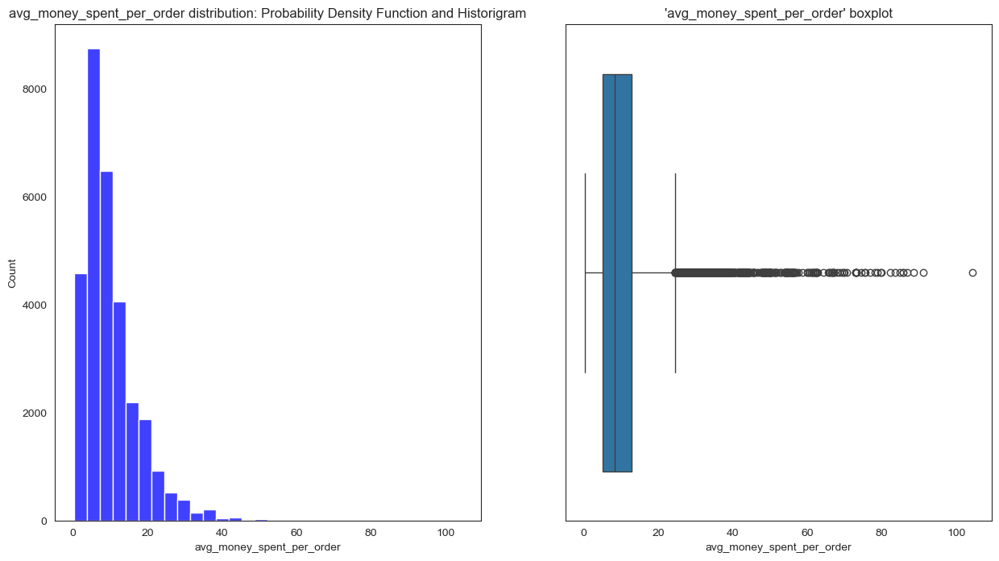

In [169]:
fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df_feature_creation["avg_money_spent_per_order"], kde=False, color="blue", bins=30, ax=axes[0])
axes[0].set_title("avg_money_spent_per_order distribution: Probability Density Function and Historigram")

sns.boxplot(x = df_feature_creation["avg_money_spent_per_order"], ax=axes[1])
axes[1].set_title("'avg_money_spent_per_order' boxplot")
plt.show()

In [680]:
df_feature_creation["avg_money_spent_per_order"].describe()

count    30417.000000
mean        10.284109
std          7.839884
min          0.370000
25%          5.063333
50%          8.205000
75%         12.870000
max        104.320000
Name: avg_money_spent_per_order, dtype: float64

Notes
> On average, the average money spent per client per food delivery is 10.3 dollars. It seems quite a low value.

> The ditribution of the variable is right skewed. This means that over 50% of the clients spend less than 10.3 dollars per order.

> Feature seems to have high number of outliers that need be analyzed. This shows a great variability in the feature. Some clients client spend on average more than 100 dollars per delivery order and others spend less than one dollar per order

b) Strange clients

Clients who spent too litle money per order considering the type of cuisine in question

In [170]:
df_feature_creation.loc[df_feature_creation["avg_money_spent_per_order"] < 5, ["tot_money_spent_per_client", "tot_orders_per_client", "avg_money_spent_per_order", "client_behavior_cuisine_preference", "num_unique_cuisines_tried"]]

,tot_money_spent_per_client,tot_orders_per_client,avg_money_spent_per_order,client_behavior_cuisine_preference,num_unique_cuisines_tried
customer_id,,,,,
f6d1b2ba63,9.20,2,4.600000,American,1
8475ee66ef,7.41,2,3.705000,American,2
5b650c89cc,14.44,3,4.813333,OTHER,3
f3070b7bbf,9.90,2,4.950000,Indian,1
7c027ecfd3,8.28,2,4.140000,American,1
...,...,...,...,...,...
d068a522ef,3.51,1,3.510000,Asian,1
d1803b5176,4.26,1,4.260000,American,1
d545ba3fc6,4.71,1,4.710000,Japanese,1


Notes

> The avg money spent seems to be very low. Additionally, the Cuisine preference makes it even more odly.


Clients who spent less than 1 dollar per order

In [171]:
avg_spent_less_1 = df_feature_creation.loc[df_feature_creation["avg_money_spent_per_order"] < 1, ["tot_money_spent_per_client", "tot_orders_per_client", "avg_money_spent_per_order", "client_behavior_cuisine_preference", "num_unique_cuisines_tried"]]
avg_spent_less_1

,tot_money_spent_per_client,tot_orders_per_client,avg_money_spent_per_order,client_behavior_cuisine_preference,num_unique_cuisines_tried
customer_id,,,,,
c28a71a4fa,0.86,1,0.860000,American,1
d0606f7a50,0.74,1,0.740000,Beverages,1
d70104705b,3.64,4,0.910000,Healthy,1
a95e89723a,3.10,4,0.775000,Noodle Dishes,2
c69e2f40fc,0.96,1,0.960000,Healthy,1
1a18e9b684,0.66,1,0.660000,American,1
ba8eb4df60,1.78,2,0.890000,Chicken Dishes,2
70559272e8,3.37,4,0.842500,Chinese,2
325fd45be8,0.88,1,0.880000,Italian,1


In [172]:
avg_spent_less_1.shape[0]

53

Clients who spent more than 70 dollar per order

In [173]:
avg_spent_more_100 = df_feature_creation.loc[df_feature_creation["avg_money_spent_per_order"] > 70, ["tot_money_spent_per_client", "tot_orders_per_client", "avg_money_spent_per_order", "client_behavior_cuisine_preference", "num_unique_cuisines_tried"]]
avg_spent_more_100


,tot_money_spent_per_client,tot_orders_per_client,avg_money_spent_per_order,client_behavior_cuisine_preference,num_unique_cuisines_tried
customer_id,,,,,
04f5b4ee98,85.75,1,85.750,Street Food / Snacks,1
2281ba6873,83.55,1,83.550,Street Food / Snacks,1
d3a4f15281,141.12,2,70.560,Street Food / Snacks,2
fc8063949b,72.96,1,72.960,Street Food / Snacks,1
2be65ac687,73.21,1,73.210,Street Food / Snacks,1
c5043b56c8,78.18,1,78.180,Street Food / Snacks,1
496e781eb6,104.32,1,104.320,Street Food / Snacks,1
4d2c2791fc,85.68,1,85.680,Street Food / Snacks,1
939b47d1a0,79.64,1,79.640,Street Food / Snacks,1


> Most of the clients who have spent more than $100 have only made 1 order and have tried only 1 unique cuisine.

> Most likely these clients are not regular customers and have made a large order for a special occasion.

b) Missing values

In [174]:
df_feature_creation["avg_money_spent_per_order"].isnull().sum()

0

> No missing values

c) Outliers

In [175]:
outlier_detection(df_feature_creation, "avg_money_spent_per_order")

avg_money_spent_per_order: 
Number of extreme outliers: 418 (26%) 
Number of moderate outliers: 1148 (73%) 
Total number of outliers: 1566
Q3 + 1.5*IQR = 24.58 
Q3 + 3*IQR = 36.29
Max: 104.32 
Min: 0.37 
95th percentil: 24.7
99th percentil: 37.69 



---

## 2.9 avg_products_per_order


#### Why did we create this feature?
1. Understanding the average number of products per order helps identify clients who tend to order fewer items. This could guide personalized recommendations to increase basket size, such as suggesting complementary items.
2. Knowing the typical order size enables better resource allocation, such as predicting packaging needs or optimizing delivery logistics. For instance, customers with higher average product counts may require larger packaging or longer preparation times.

#### How did we create this feature 

1. Dividing the total number of products purchased by the total number of orders made.


In [176]:
df_feature_creation["avg_products_per_order"] = df_feature_creation["product_count"] / df_feature_creation["tot_orders_per_client"]

a) Histogram and Boxplot

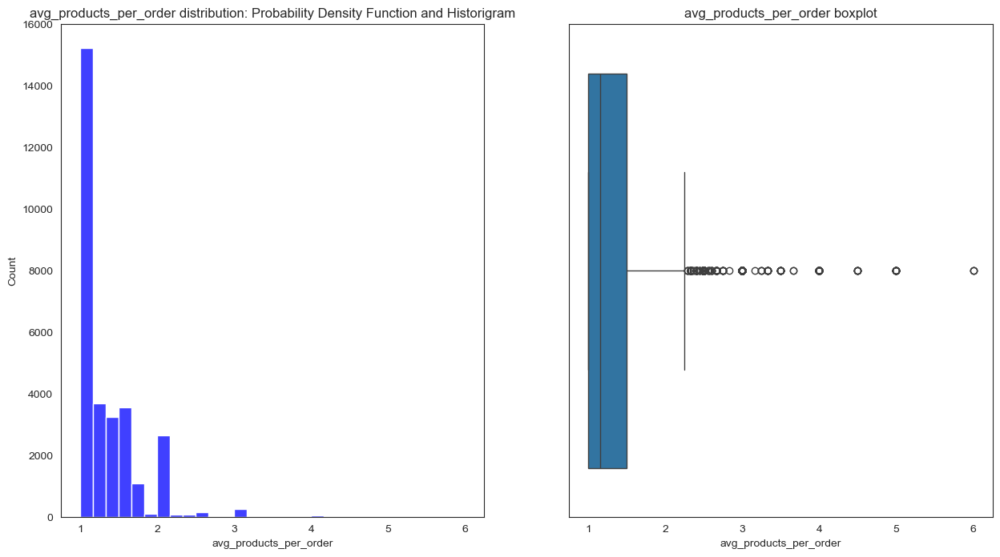

In [184]:
fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df_feature_creation["avg_products_per_order"], kde=False, color="blue", bins=30, ax=axes[0])
axes[0].set_title("avg_products_per_order distribution: Probability Density Function and Historigram")

sns.boxplot(x = df_feature_creation["avg_products_per_order"], ax=axes[1])
axes[1].set_title("avg_products_per_order boxplot")
plt.show()

In [179]:
df_feature_creation["avg_products_per_order"].describe()

count    30417.000000
mean         1.293976
std          0.414841
min          1.000000
25%          1.000000
50%          1.153846
75%          1.500000
max          6.000000
Name: avg_products_per_order, dtype: float64

Notes
> On average, the average amount of products ordered is 1.3

> There are some strange clients that have an avg product count equal close to 0

> Feature is positively distributed (not normally distributed) meaning that clients' average products per orders tends to be lower (close to 1) representing a possobile opportunity for cross selling



b) Strange clients

Clients who, on average, order more than 4 products per order

In [690]:
df_feature_creation.loc[df_feature_creation["avg_products_per_order"] > 4, ["product_count", "tot_orders_per_client","tot_money_spent_per_client" , "avg_products_per_order", "client_behavior_cuisine_preference", "num_unique_cuisines_tried", "avg_money_spent_per_order"]]

,product_count,tot_orders_per_client,tot_money_spent_per_client,avg_products_per_order,client_behavior_cuisine_preference,num_unique_cuisines_tried,avg_money_spent_per_order
customer_id,,,,,,,
2cf5d60183,5,1,23.16,5.0,Noodle Dishes,1,23.160
36fc0b3162,5,1,35.33,5.0,Chicken Dishes,1,35.330
04f5b4ee98,5,1,85.75,5.0,Street Food / Snacks,1,85.750
2c5bc1279f,5,1,66.10,5.0,OTHER,1,66.100
2ea6606383,5,1,30.09,5.0,Chinese,1,30.090
2281ba6873,5,1,83.55,5.0,Street Food / Snacks,1,83.550
d3a4f15281,9,2,141.12,4.5,Street Food / Snacks,2,70.560
e0a8cb011c,9,2,139.98,4.5,Asian,2,69.990
0bcb423612,5,1,30.83,5.0,Noodle Dishes,1,30.830


> Clients who have ordered more than 4 products per order tend to have a higher average money spent per order and a lower number of unique cuisines tried

> Could represent loyalist clients who really have a preference for a specifc cuisine

---

## 2.10 tot_non_chain_orders, client_behaviour_chain_preference, percent_chain_orders

> #### tot_non_chain_orders
Why did we create the feature?
1. Behavioral Insights: This feature highlights the total number of non-chain orders made by each client, helping differentiate clients who favor independent or boutique establishments over chain restaurants.
2. Targeted Marketing: Enables the identification of clients who prefer non-chain restaurants, which is valuable for targeted marketing campaigns or partnerships with local vendors.
3. Improved Segmentation: This feature aids in creating distinct client segments based on their ordering behavior regarding restaurant types.

How did we create the feature?
1. Subtracting the total number of chain orders (tot_chain_orders) from the total number of orders (tot_orders_per_client).


> #### client_behaviour_chain_preference
Why did we create the feature?

1. Behavior Analysis: Understanding whether a client predominantly orders from chain or non-chain restaurants helps uncover their food preferences and purchasing habits.
2. Vendor Strategy: Enables the platform to decide whether to prioritize chain or non-chain partnerships based on client demand.
3. Personalized Recommendations: Helps in tailoring recommendations to clients based on their ordering preferences for chain or non-chain restaurants.

How did we create the feature?
1. If the number of chain orders (tot_chain_orders) is greater than the number of non-chain orders (tot_non_chain_orders), the client is classified as a Chain Preference Client and assigned a value of 1.
2. If the opposite happens, the client is classified as a Non-Chain Preference Client and assigned a value of 0.


> #### percent_chain_orders
Why did we create the feature?

1. Behavioral Quantification: This feature quantifies the proportion of a client’s total orders made at chain restaurants, providing a precise measure of chain restaurant preference.
2. Vendor Performance: Helps assess the reliance on chain restaurant partnerships and understand the client base that sustains chain businesses.
3. Clustering Utility: Serves as an important variable for clustering models, offering insights into client preferences at a more granular level.

How did we create the feature?
1. Dividing the total number of chain orders (tot_chain_orders) by the total number of orders (tot_orders_per_client) and multiplying by 100 to get a percentage.



#### tot_non_chain_orders

In [180]:
df_feature_creation["tot_non_chain_orders"] = df_feature_creation["tot_orders_per_client"] - df_feature_creation["tot_chain_orders"]

In [181]:
df_feature_creation["tot_non_chain_orders"].describe()

count    30417.000000
mean         1.369727
std          1.956440
min          0.000000
25%          0.000000
50%          1.000000
75%          2.000000
max         24.000000
Name: tot_non_chain_orders, dtype: float64

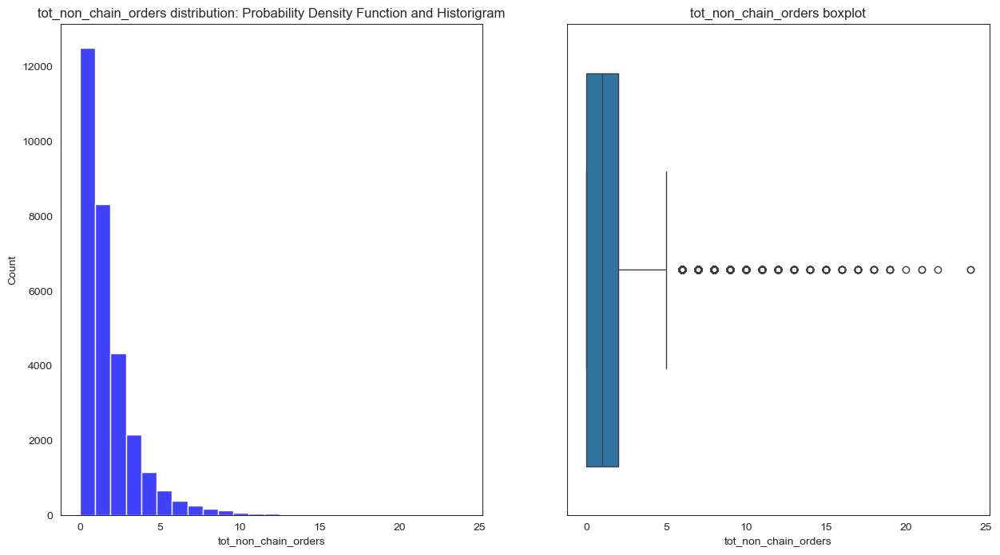

In [183]:
fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df_feature_creation["tot_non_chain_orders"], kde=False, color="blue", bins=25, ax=axes[0])
axes[0].set_title("tot_non_chain_orders distribution: Probability Density Function and Historigram")

sns.boxplot(x = df_feature_creation["tot_non_chain_orders"], ax=axes[1])
axes[1].set_title("tot_non_chain_orders boxplot")
plt.show()

Comparing with tot_chain_orders

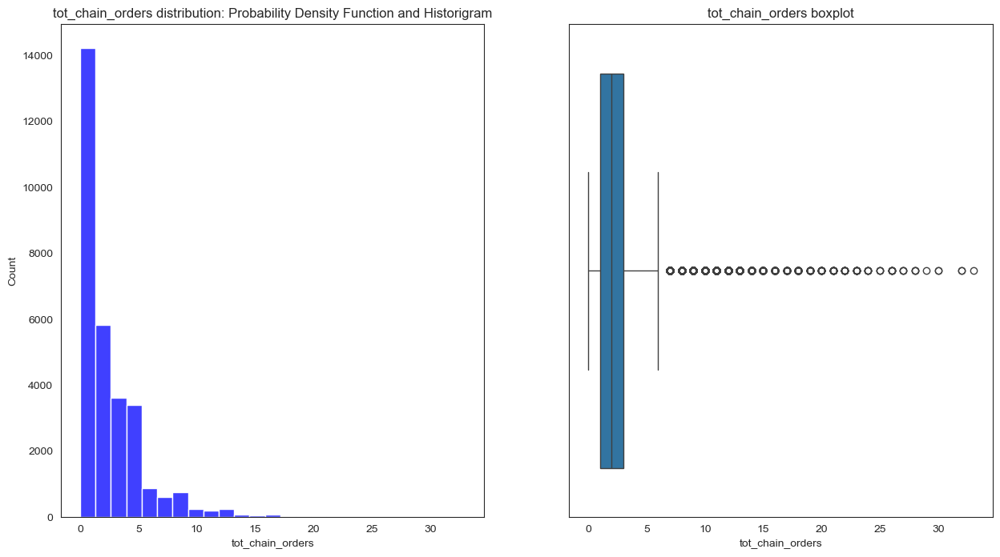

In [185]:
fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df_feature_creation["tot_chain_orders"], kde=False, color="blue", bins=25, ax=axes[0])
axes[0].set_title("tot_chain_orders distribution: Probability Density Function and Historigram")

sns.boxplot(x = df_feature_creation["tot_chain_orders"], ax=axes[1])
axes[1].set_title("tot_chain_orders boxplot")
plt.show()

In [186]:
df_feature_creation["tot_chain_orders"].describe()

count    30417.000000
mean         2.502318
std          2.928439
min          0.000000
25%          1.000000
50%          2.000000
75%          3.000000
max         33.000000
Name: tot_chain_orders, dtype: float64

Notes
> On average, the amout of non chain orders per client (1.3) is lower than the amount of chain orders per client (2.5). This could start to show a general preference towards chain restaurants

> There are some strange clients that have made 24 total non chain orders

> Feature tot_non_chain_orders is positively distributed (not normally distributed) meaning that clients' number of non chain orders tend to be close to 0

b) strange/interesting values

clients that made over 20 non chain orders

In [187]:
df_feature_creation.loc[df_feature_creation["tot_non_chain_orders"] > 20, ["tot_chain_orders", "tot_non_chain_orders", "tot_orders_per_client", "tot_money_spent_per_client", "avg_money_spent_per_order", "client_behavior_cuisine_preference", "num_unique_cuisines_tried"]]

,tot_chain_orders,tot_non_chain_orders,tot_orders_per_client,tot_money_spent_per_client,avg_money_spent_per_order,client_behavior_cuisine_preference,num_unique_cuisines_tried
customer_id,,,,,,,
5c835e730b,6,22,28,177.44,6.337143,Italian,7
f7706ccb45,7,24,31,203.08,6.550968,Italian,5
ad57b12a88,3,24,27,187.21,6.933704,American,3
02dc3c6a40,9,21,30,260.22,8.674000,Italian,8
3cf4cb8a42,1,21,22,143.56,6.525455,Italian,4


Clients that have made only non chain orders

In [188]:
df_feature_creation.loc[ (df_feature_creation["tot_non_chain_orders"] > 0) & (df_feature_creation["tot_chain_orders"] == 0) , ["tot_chain_orders", "tot_non_chain_orders", "tot_orders_per_client", "tot_money_spent_per_client", "avg_money_spent_per_order", "client_behavior_cuisine_preference", "num_unique_cuisines_tried"]]

,tot_chain_orders,tot_non_chain_orders,tot_orders_per_client,tot_money_spent_per_client,avg_money_spent_per_order,client_behavior_cuisine_preference,num_unique_cuisines_tried
customer_id,,,,,,,
4eb37a6705,0,2,2,55.44,27.72,Asian,2
6aef2b6726,0,2,2,24.92,12.46,Asian,1
84775a7237,0,2,2,32.48,16.24,Asian,1
dce8e4700a,0,2,2,23.62,11.81,Asian,1
29786040d4,0,2,2,12.50,6.25,Italian,1
...,...,...,...,...,...,...,...
eeee76a25f,0,1,1,19.06,19.06,Asian,1
f1ab8a54c4,0,1,1,13.53,13.53,OTHER,1
f6b6709018,0,1,1,18.04,18.04,American,1


> Total of 5885 clients that have made only non-chain orders

clients that have made same name of chain orders and non chain orders

In [189]:
df_feature_creation.loc[ df_feature_creation["tot_non_chain_orders"] == df_feature_creation["tot_chain_orders"], ["tot_chain_orders", "tot_non_chain_orders", "tot_orders_per_client", "tot_money_spent_per_client", "avg_money_spent_per_order", "client_behavior_cuisine_preference", "num_unique_cuisines_tried"]]

,tot_chain_orders,tot_non_chain_orders,tot_orders_per_client,tot_money_spent_per_client,avg_money_spent_per_order,client_behavior_cuisine_preference,num_unique_cuisines_tried
customer_id,,,,,,,
1b8f824d5e,1,1,2,28.88,14.440,Indian,1
180c632ed8,1,1,2,31.56,15.780,Indian,2
4eff9f04bf,1,1,2,44.51,22.255,Chinese,2
8733352e37,1,1,2,27.21,13.605,Asian,1
dd27b47fb5,1,1,2,19.33,9.665,Japanese,2
...,...,...,...,...,...,...,...
db0a39a0be,1,1,2,18.56,9.280,Asian,2
79057d5459,1,1,2,37.02,18.510,Japanese,2
96f1fc25e3,1,1,2,17.98,8.990,Asian,1


c) missing values

In [190]:
df_feature_creation["tot_non_chain_orders"].isnull().sum()

0

d) outliers

In [191]:
outlier_detection(df_feature_creation, "tot_non_chain_orders")

tot_non_chain_orders: 
Number of extreme outliers: 401 (38%) 
Number of moderate outliers: 649 (61%) 
Total number of outliers: 1050
Q3 + 1.5*IQR = 5.0 
Q3 + 3*IQR = 8.0
Max: 24 
Min: 0 
95th percentil: 5.0
99th percentil: 9.0 



#### client_behaviour_chain_preference

In [192]:
df_feature_creation["client_behavior_chain_preference"] = df_feature_creation.apply(
    lambda x: 'Chain orders' if x["tot_chain_orders"] > x["tot_non_chain_orders"] else 
              ('Non chain orders' if x["tot_chain_orders"] < x["tot_non_chain_orders"] else 'No preference'),
    axis=1
)

In [193]:
df_feature_creation["client_behavior_chain_preference"].value_counts()

client_behavior_chain_preference
Chain orders        17975
Non chain orders     9283
No preference        3159
Name: count, dtype: int64

In [195]:
df_feature_creation["client_behavior_chain_preference"].value_counts(normalize=True)*100

client_behavior_chain_preference
Chain orders        59.095243
Non chain orders    30.519118
No preference       10.385640
Name: proportion, dtype: float64

a) bar plot

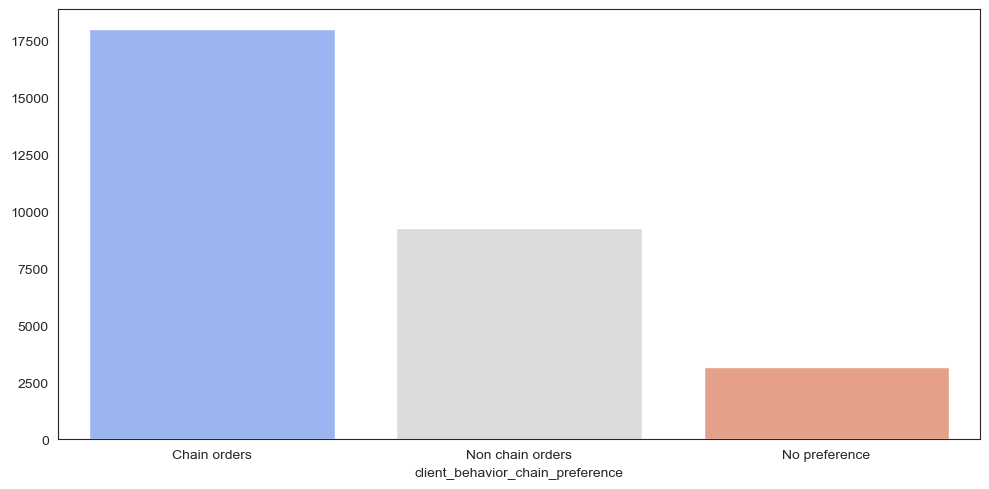

In [194]:
warnings.simplefilter(action='ignore', category=FutureWarning)
columns = purchased_features

fig, axes = plt.subplots(1, 1, figsize=(10, 5))
sns.barplot(
    x=df_feature_creation["client_behavior_chain_preference"].value_counts().index,
    y=df_feature_creation["client_behavior_chain_preference"].value_counts().values,
    ax=axes,
    palette="coolwarm"
)

plt.tight_layout()
plt.show()


Notes

> Clear preference for chain orders with close to 60% of clients prefering chain orders

> Significant value of customers with no preference (around 3k)

b) missing values 

In [196]:
df_feature_creation["client_behavior_chain_preference"].isnull().sum()

0

#### percent_chain_orders

In [197]:
df_feature_creation["percent_chain_orders"] = (df_feature_creation["tot_chain_orders"] / df_feature_creation["tot_orders_per_client"]) * 100

In [198]:
df_feature_creation["percent_chain_orders"].describe()

count    30417.000000
mean        62.800213
std         38.885470
min          0.000000
25%         33.333333
50%         72.727273
75%        100.000000
max        100.000000
Name: percent_chain_orders, dtype: float64

a) histogram and boxplot

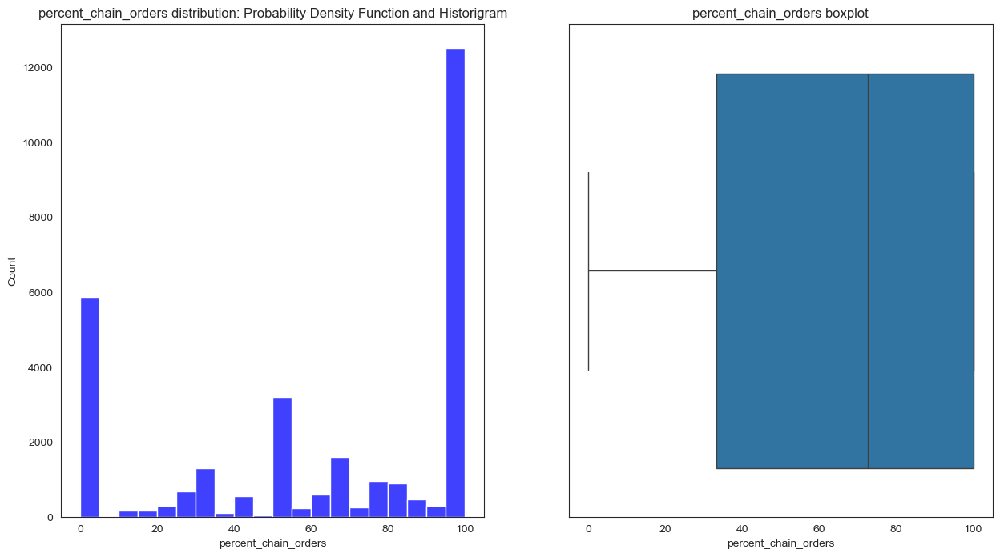

In [199]:
fig, axes = plt.subplots(1, 2, figsize = (15,8))
sns.histplot(df_feature_creation["percent_chain_orders"], kde=False, color="blue", bins=20, ax=axes[0])
axes[0].set_title("percent_chain_orders distribution: Probability Density Function and Historigram")

sns.boxplot(x = df_feature_creation["percent_chain_orders"], ax=axes[1])
axes[1].set_title("percent_chain_orders boxplot")
plt.show()

Notes

> The distribution of the percentage of chain orders is negative-skewed and not normal distribution as expected. This means that most clients tend to make a higher percentage of chain orders.

> With the boxplot analysis there seems to be no outliers in the percentage of chain orders

> Despite being negative skewed, the distribution has some "picks" in the left side and middle of distribution. These are called local modes and it shows that even though most clients tend to prefer chain restaurants, some clients prefer only making non chain orders or spliting their orders 50:50

b) missing values

In [200]:
df_feature_creation["percent_chain_orders"].isnull().sum()

0

c) outliers

In [201]:
outlier_detection(df_feature_creation, "percent_chain_orders")

percent_chain_orders: 
Number of extreme outliers: 0 (%) 
Number of moderate outliers: 0 (%) 
Total number of outliers: 0
Q3 + 1.5*IQR = 200.0 
Q3 + 3*IQR = 300.0
Max: 100.0 
Min: 0.0 
95th percentil: 100.0
99th percentil: 100.0 



> No outliers detected

---

# 3. EDA - Visualisations and Pairwise Analysis
- Purpose: identifying existing trends and explore relationships between features


## 3.1 Numerical Feature Interactions

##### a) Customer Spending Patterns

Total money spent per client and Total orders per client

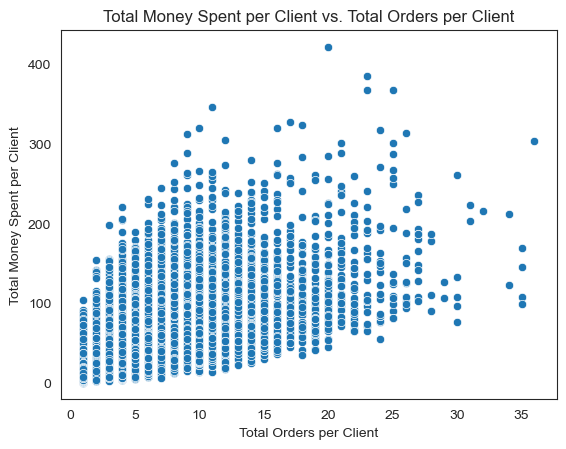

In [202]:
sns.scatterplot(x="tot_orders_per_client", y="tot_money_spent_per_client", data=df_feature_creation)
plt.title("Total Money Spent per Client vs. Total Orders per Client")
plt.xlabel("Total Orders per Client")
plt.ylabel("Total Money Spent per Client")
plt.show()

Key notes

> - Positive Correlation: A general positive trend shows that clients with more orders tend to spend more, though this correlation diminishes with a higher number of orders.
> - High Variability at Lower Order Counts: Clients with up to 20 orders show wide spending variability, possibly due to differences in order sizes or types.
> - Potential Outliers: A few clients with 20–40 orders have exceptionally high spending, suggesting possible outliers or a preference for high-value items.
> - Plateau Effect: Spending appears to stabilize after around 60 orders, indicating a potential limit to client spending patterns.
> - Clusters: The majority of clients are clustered within 0–20 orders and 0–400 in spending, reflecting typical ordering behavior and budget.


Total Money Spent per Client grouped by Number of Unique Cuisines Tried

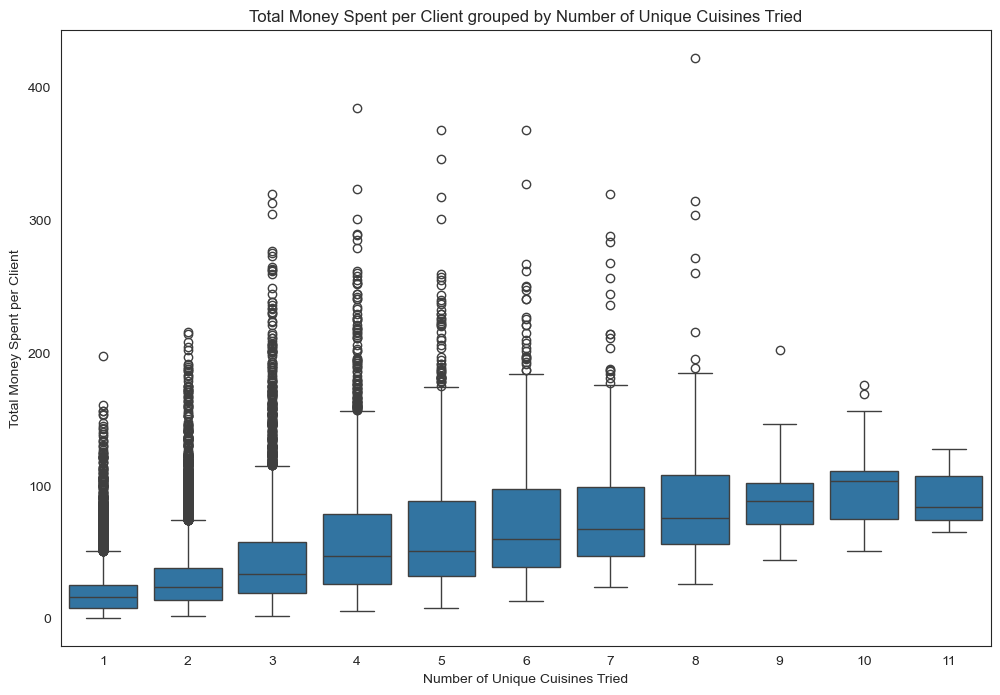

In [204]:
plt.figure(figsize=(12, 8))
sns.boxplot(x="num_unique_cuisines_tried", y="tot_money_spent_per_client", data=df_feature_creation)
plt.title("Total Money Spent per Client grouped by Number of Unique Cuisines Tried")
plt.xlabel("Number of Unique Cuisines Tried")
plt.ylabel("Total Money Spent per Client")
plt.show()

Key notes 

> - Positive Correlation: There seems to be a positive trend between the two features, meaning that as the number of unique cuisines tried increases, the average money spent per client increases.
> - High Variability at Lower Cuisine Counts: Clients who try fewer cuisines show wide spending variability, possibly due to differences in order sizes or types.
> - Potential Outliers: The presence of outliers seems to be higher when the number of cuisines tried is lower. These clients could be classified as high spender loyalists.
> - Clusters: Using both features, we can differentiate high, moderate, and low spending clients, categorizing them as 'Variety Seekers' (clients who try a higher number of cuisines) and 'Loyalists' (clients who try fewer cuisines).

Total Orders per Client grouped by Number of Unique Cuisines Tried boxplots

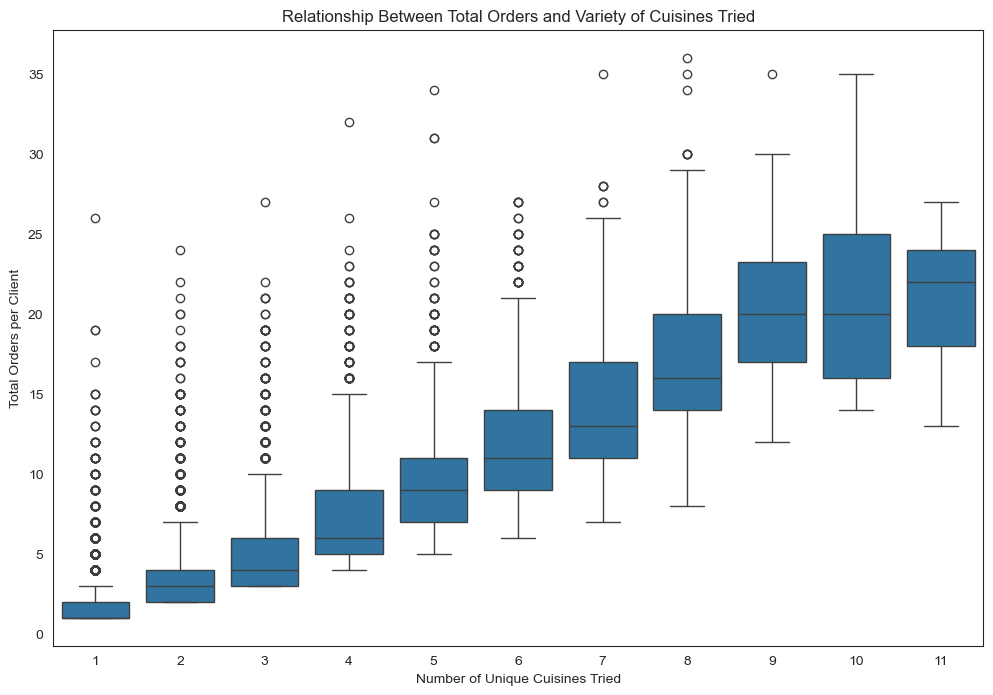

In [205]:
plt.figure(figsize=(12, 8))
sns.boxplot(x="num_unique_cuisines_tried", y="tot_orders_per_client", data=df_feature_creation)
plt.title("Relationship Between Total Orders and Variety of Cuisines Tried")
plt.xlabel("Number of Unique Cuisines Tried")
plt.ylabel("Total Orders per Client")
plt.show()

Key notes

> - Positive Correlation: There seems to be a positive trend between the 2 features meaning that as the number of unique cuisines tried increases, the number of orders tends to increase
> - Potential Outliers: Because of the positve correlation between total money spent and total orders made per client, we also expected the presence of outliers to be higher with lower values of number of cuisines tried. This could indicate that some loyal customers make tend to make a higher number of purchases of their favorite
> - Clusters: Adding the feature total orders per client to the anlysis of the number of unique cuisines tried can help us differentiate "Loyalists" and "Variety Seekers" according to their order volume (High, medium and low volume clients)

##### b) Time-Based and Count Interactions

First Order and Last order

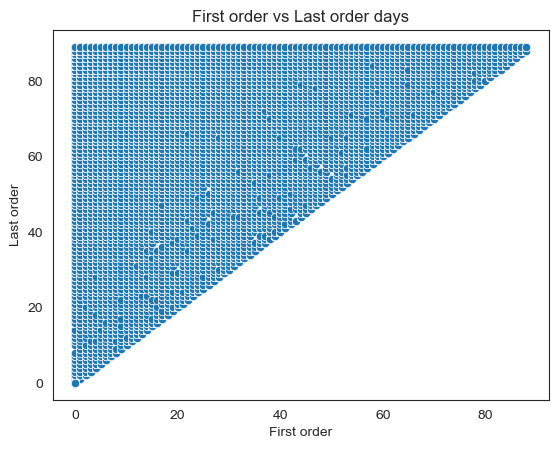

In [206]:
sns.scatterplot(x="first_order", y="last_order", data=df_feature_creation)
plt.title("First order vs Last order days")
plt.xlabel("First order")
plt.ylabel("Last order")
plt.show()


Key notes

> - As expected the relationship between the 2 features a triangular matrix since the number of days it took to make the last order must be equal or higher to make the last_order
> - No linear correlation: Visually there doesn't seem to be a linear correlation between the 2 features
> - High Variability: At any first_order value, there is a wide range that the last_order value can take. This means that it might be hard to predict the number of days it took to make the last_order solely based on the number of days it took to make the first_order and vice-versa

Pairwise Relationship of Time-Based newly created features (morning_num_orders, afternoon_num_orders, evening_num_orders, night_num_orders)

Text(0.5, 0.98, 'Pairwise Relationship of Time-Based newly created features')

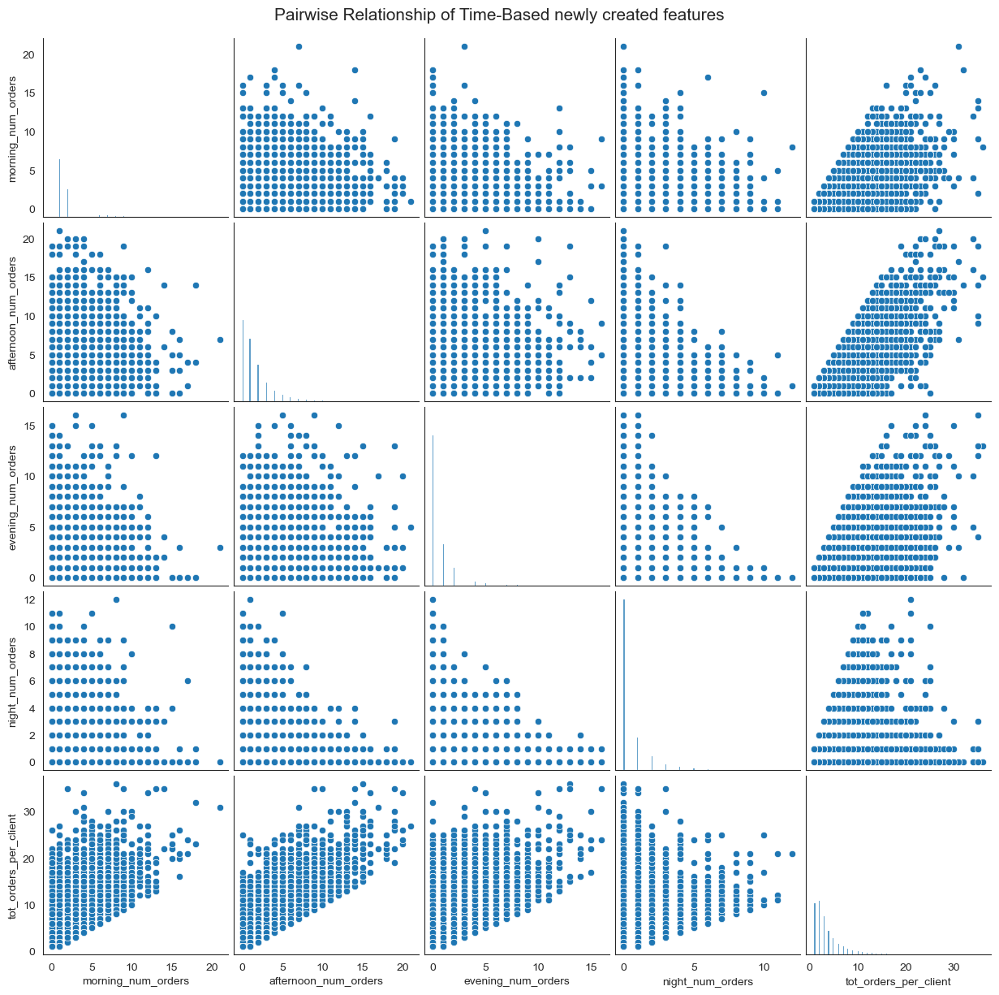

In [207]:
columns = ["morning_num_orders", "afternoon_num_orders", "evening_num_orders", "night_num_orders", "tot_orders_per_client"]

sns.pairplot(df_feature_creation[columns], diag_kind="hist")

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Time-Based newly created features", fontsize=15)

Vendor_count vs Product Count

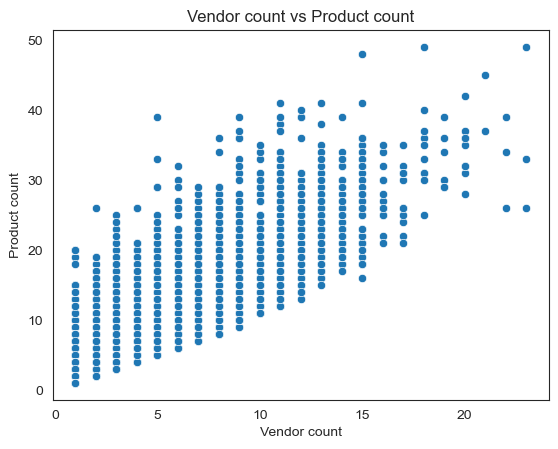

In [208]:
sns.scatterplot(x="vendor_count", y="product_count", data=df_feature_creation)
plt.title("Vendor count vs Product count")
plt.xlabel("Vendor count")
plt.ylabel("Product count")
plt.show()

Product count grouped by number of unique vendors (product_count vs vendor_count)

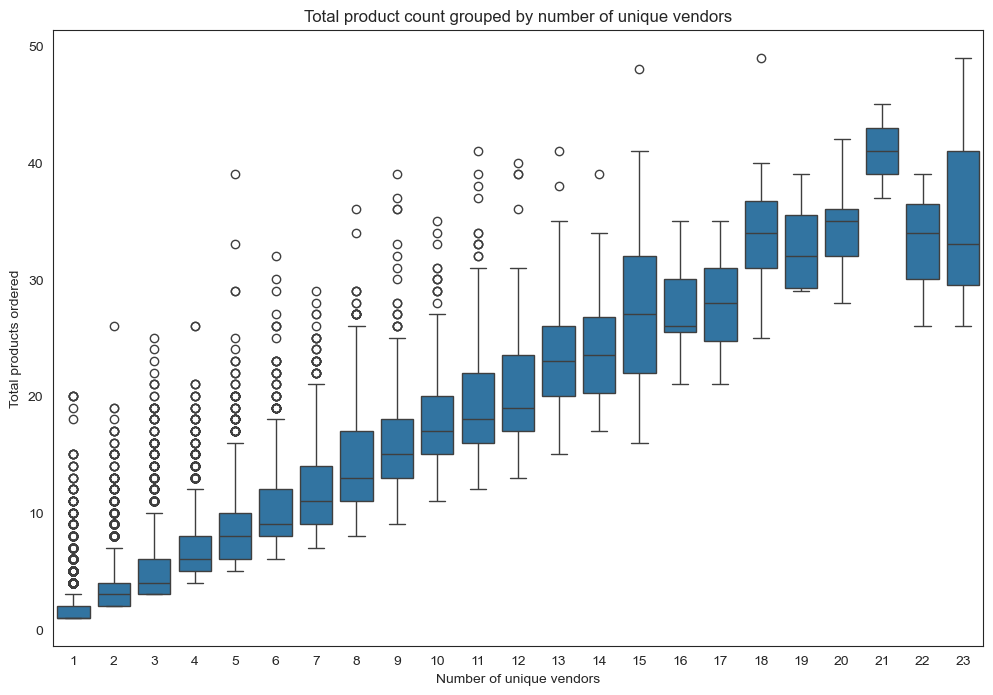

In [209]:
plt.figure(figsize=(12, 8))
sns.boxplot(x="vendor_count", y="product_count", data=df_feature_creation)
plt.title("Total product count grouped by number of unique vendors")
plt.xlabel("Number of unique vendors")
plt.ylabel("Total products ordered")
plt.show()

Total money spent per client grouped by peak days number of orders or off peak days number of orders boxplot

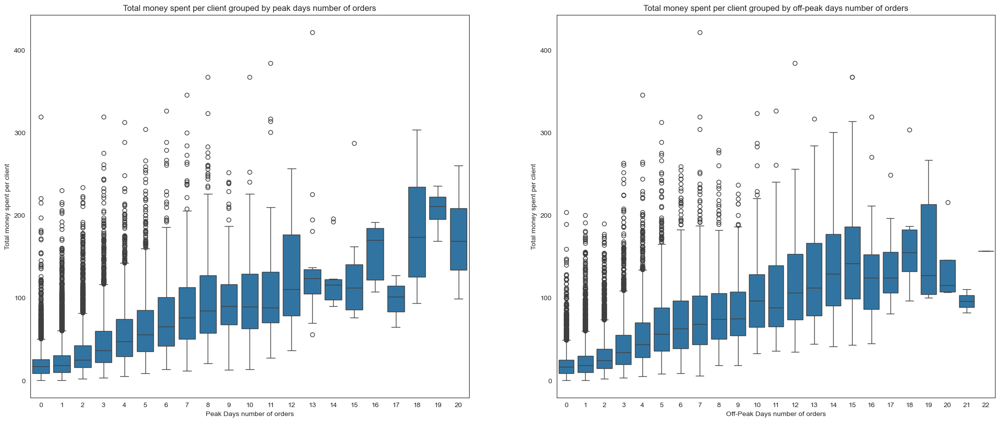

In [213]:
fig, ax = plt.subplots(1, 2, figsize=(25, 10))

# Total money spent per client grouped by peak days number of orders boxplot
sns.boxplot(x="peak_days_num_orders", y="tot_money_spent_per_client", data=df_feature_creation, ax=ax[0])
ax[0].set_title("Total money spent per client grouped by peak days number of orders")
ax[0].set_xlabel("Peak Days number of orders")
ax[0].set_ylabel("Total money spent per client")

# Total money spent per client grouped by off-peak days number of orders boxplot
sns.boxplot(x="off_peak_days_num_orders", y="tot_money_spent_per_client", data=df_feature_creation, ax=ax[1])
ax[1].set_title("Total money spent per client grouped by off-peak days number of orders")
ax[1].set_xlabel("Off-Peak Days number of orders")
ax[1].set_ylabel("Total money spent per client")

plt.show()


Key notes

> - Positive Correlation: In both cases, there seems to be a positive correlation between peaks days number of orders and off-peak days numebr of orders with total_money_spent_per_client
> - Potential Outliers: In both cases the outliers seem be present in clients with smaller number of orders during both the off peak days (Monday, tuesday, wednesday and Sunday) and peak days (remaining days)
> - Clusters: Based on the relationship with total_money_spent_per client both features developed show a siimilar behaviour. Hence they might not be crucial features to differentiate different clients. In any case it's still quite early to assume so 

##### c) Order Count and Age

Customer Age vs. Total Orders per Client

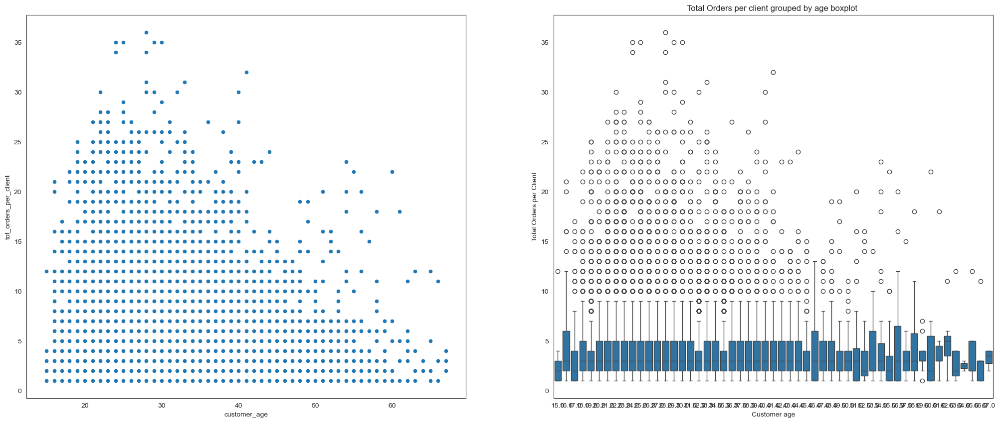

In [214]:
fig, ax = plt.subplots(1, 2, figsize=(25, 10))

sns.scatterplot(x="customer_age", y="tot_orders_per_client", data=df_feature_creation, ax=ax[0])
plt.title("Customer age vs. Total Orders per Client scatter plot")
plt.xlabel("Customer age")
plt.ylabel("Total Orders per Client")


sns.boxplot(x="customer_age", y="tot_orders_per_client", data=df_feature_creation, ax=ax[1])
plt.title("Total Orders per client grouped by age boxplot ")
plt.xlabel("Customer age")
plt.ylabel("Total Orders per Client")


plt.show()


Key notes 
> - Negative Correlation: The scatterplot shows the negative relationship between cuustomer_age and total orders made per client. As the age increases the number of order made also tend to decrease
> - High Variability Among Younger Clients: For clients under 35, there is a significant variability in the number of orders made by each client which is clearly noticable per the boxplots
> - Consistent Lower Order Counts for Older Clients: For clients above 50, the number of outliers decreases showing a more consistent ordering pattern 

##### d) Cuisine Preferences vs age

Relationship Customer age and Variety of Cuisines Tried

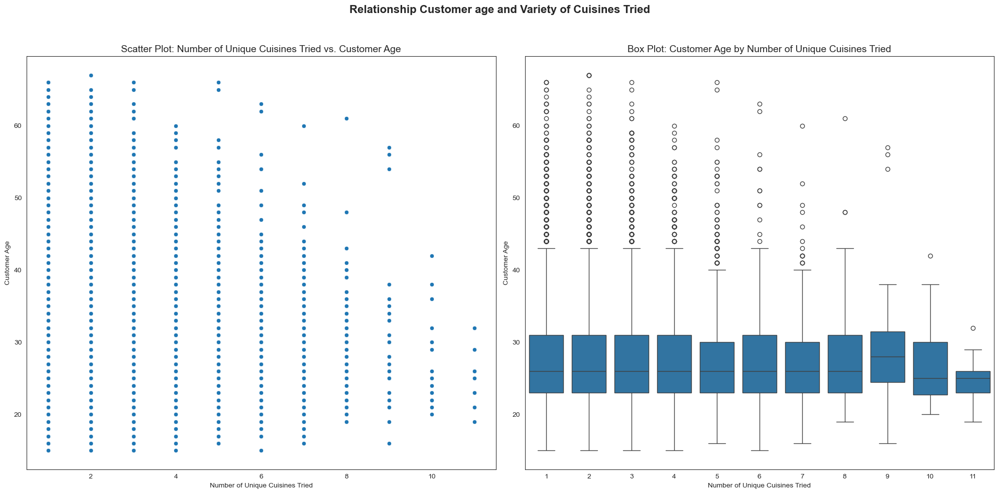

In [215]:
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
fig.suptitle("Relationship Customer age and Variety of Cuisines Tried", fontsize=16, fontweight='bold')  # Main title

# Scatter plot
sns.scatterplot(x="num_unique_cuisines_tried", y="customer_age", data=df_feature_creation, ax=ax[0])
ax[0].set_title("Scatter Plot: Number of Unique Cuisines Tried vs. Customer Age", fontsize=14)
ax[0].set_xlabel("Number of Unique Cuisines Tried")
ax[0].set_ylabel("Customer Age")

# Box plot
sns.boxplot(x="num_unique_cuisines_tried", y="customer_age", data=df_feature_creation, ax=ax[1])
ax[1].set_title("Box Plot: Customer Age by Number of Unique Cuisines Tried", fontsize=14)
ax[1].set_xlabel("Number of Unique Cuisines Tried")
ax[1].set_ylabel("Customer Age")

plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit main title
plt.show()


Key notes

> - Negative Correlation: As the customer age decreases, the number of cuisines tried increases. This means younger clients tend to try more cuisines whereas older clients tend to stick with fewer types.
> - High Variability Among Younger Clients: A the number of unique cuisines increases, interquartile range gets smaller reinforcing the idea that higher cuisine variety is mostly associated with younger clients. 
> - Outliers: There are a few older clients who also try a higher number of cuisines. Investigating these clients could help us understand unique behaviors within the older clients

> Conclusion: younger clients are more inclined to explore a diverse range of cuisines, while older clients display more limited culinary variety.

## 3.2 Categorical Feature Interactions

##### a) Order and Payment Method Analysiss

Payment Method Preferences for Peak and Off-Peak Clients

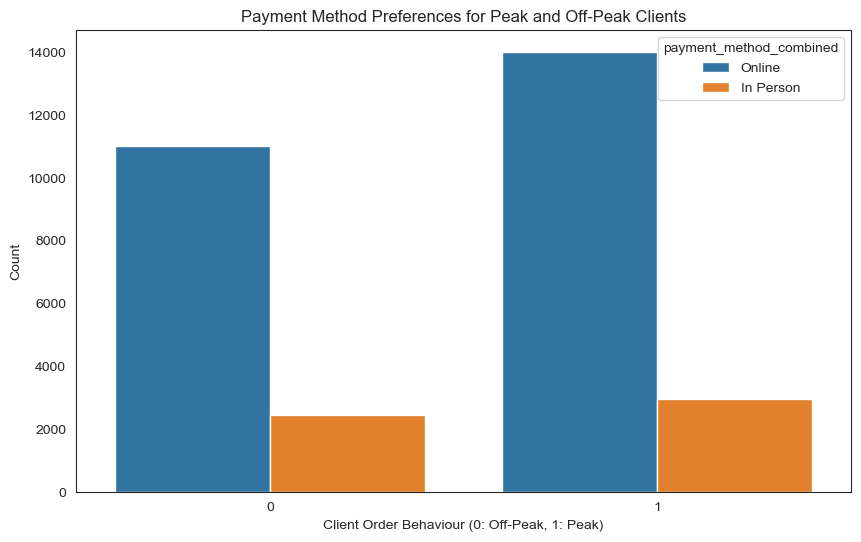

In [216]:
plt.figure(figsize=(10, 6))
sns.countplot(data=df_feature_creation, x="client_behavior_peak_preference", hue="payment_method_combined")

plt.xlabel("Client Order Behaviour (0: Off-Peak, 1: Peak)")
plt.ylabel("Count")
plt.title("Payment Method Preferences for Peak and Off-Peak Clients")

plt.show()

Key notes

> - For both types of client order behaviour, the preferred payment method seems to be in person
> - The proportion of clients using online payments compared to in-person is similar across both categories. This suggests the client's order timing does not significantly impact the choice of payment method.

Relationship between Client Order Behaviour and City

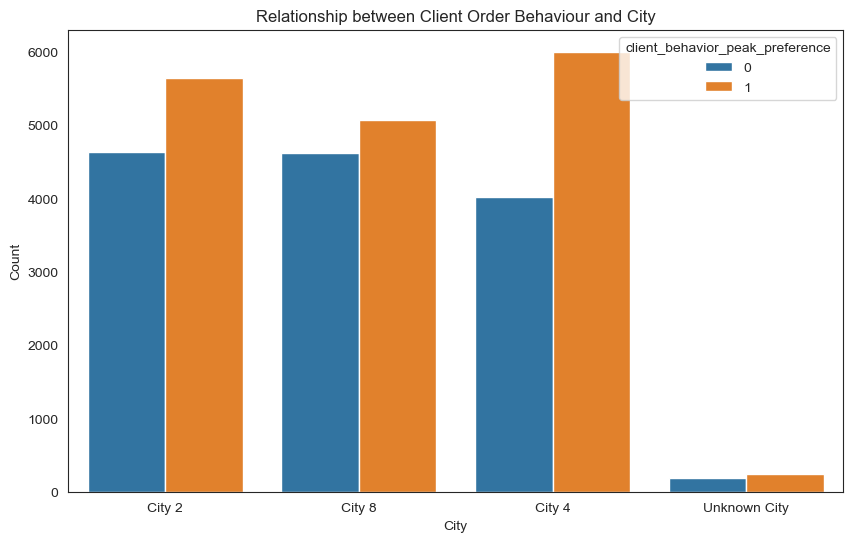

In [217]:
plt.figure(figsize=(10, 6))
sns.countplot(data=df_feature_creation, x="city", hue="client_behavior_peak_preference")

plt.xlabel("City")
plt.ylabel("Count")
plt.title("Relationship between Client Order Behaviour and City")

plt.show()

Key notes

> - In all cities, clients who prefer to order during peak times represent the most common type of clients
> - City 4 represents the city with the highest count of clients with higher preference for peak-times and the least count of clients who prefer to order during off-peak times. Thsi suugests that the city may experience greater demand during busy periods, which could require additional resources during peak times.
> - City 8 and city 2 have a more balanced distribution between the 2 types of clients


##### b) Cuisine Preferences by Demographics

Relationship between Cuisine Preferences and City (Purchased vs City)

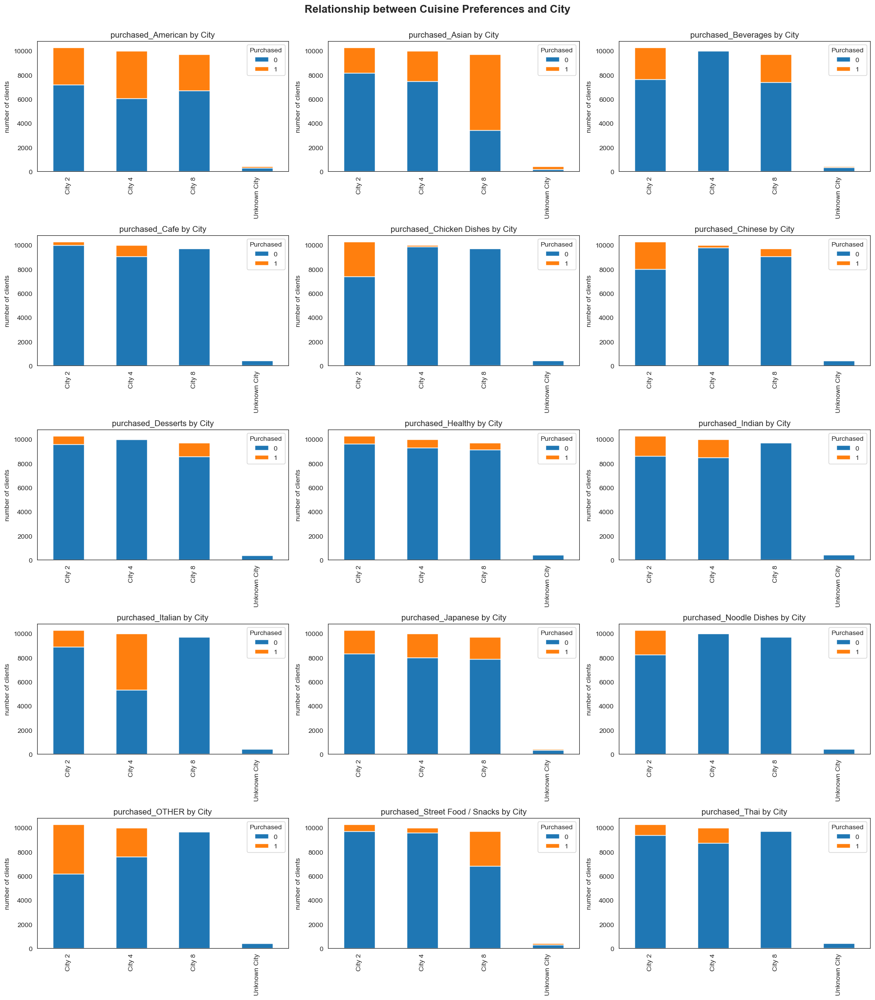

In [218]:
purchased_features = [feature for feature in df_feature_creation.columns if "purchased" in str(feature) ]

# Set up the plot grid
fig, axes = plt.subplots(5, 3, figsize=(18, 20))
axes = axes.flatten()

for i, feature in enumerate(purchased_features):
    # Calculate counts for each client_behavior_peak_preference (0 and 1)
    data_counts = df_feature_creation.groupby(['city', feature]).size().unstack()
    
    # Plot the stacked bar chart
    data_counts.plot(kind='bar', stacked=True, ax=axes[i], color=['#1f77b4', '#ff7f0e'])
    axes[i].set_title(f"{feature} by City")
    axes[i].set_ylabel("number of clients")
    axes[i].legend(title="Purchased")
    axes[i].set_xlabel("")

# Adjust layout
plt.tight_layout()
plt.suptitle("Relationship between Cuisine Preferences and City", fontsize=16, fontweight='bold', y=1.02)
plt.show()


Key notes

> - Based on the following stacked bar chart and supportive code cell, we tried to compare cities purchasing behaviour’s and classify them accordingly. 
> - City 8 can be classified has the “Loyalists client’s hub” and “Asian Hub”. Has the highest total of cuisine types without any purchasing clients, suggesting the existence of more loyal customers. Additionally, the majority of clients prefer Asian cuisine, making it the city with the highest number of Asian cuisine purchases. 
> - City 4 could be classified has the “Healthy" City with an "Italian" Cuisine Hub. Has the lowest number of dessert-purchasing clients, no clients purchasing beverages, and the highest number of clients for healthy cuisine. On the other hand, olds the highest number of clients purchasing Italian cuisine. 
> - City 2 could be classified has the “Variety Seekers" and “Noodle Dishes" Hub. It is the only city where every cuisine type has purchasing clients, and the only city with clients who have purchased noodle dishes


In [219]:
#Number of purchasing clients per cuisine type to support plot above

columns_purchased = [element for element in df_feature_creation.columns if 'purchased' in str(element)]
city_8 = df_feature_creation.loc[df_feature_creation["city"] == "City 8"]
print(f"City 8:\n{city_8[columns_purchased].sum()} \n")

city_4 = df_feature_creation.loc[df_feature_creation["city"] == "City 4"]
print(f"City 4:\n{city_4[columns_purchased].sum()} \n")

city_2 = df_feature_creation.loc[df_feature_creation["city"] == "City 2"]
print(f"City 2:\n{city_2[columns_purchased].sum()}")


City 8:
purchased_American                2966
purchased_Asian                   6282
purchased_Beverages               2299
purchased_Cafe                       0
purchased_Chicken Dishes             0
purchased_Chinese                  650
purchased_Desserts                1112
purchased_Healthy                  553
purchased_Indian                     0
purchased_Italian                    0
purchased_Japanese                1792
purchased_Noodle Dishes              0
purchased_OTHER                     41
purchased_Street Food / Snacks    2866
purchased_Thai                       0
dtype: int64 

City 4:
purchased_American                3950
purchased_Asian                   2520
purchased_Beverages                  0
purchased_Cafe                     935
purchased_Chicken Dishes           129
purchased_Chinese                  225
purchased_Desserts                   2
purchased_Healthy                  724
purchased_Indian                  1498
purchased_Italian                

##### c) Regional and Promotional Effects

Last promo used by clients in different cities

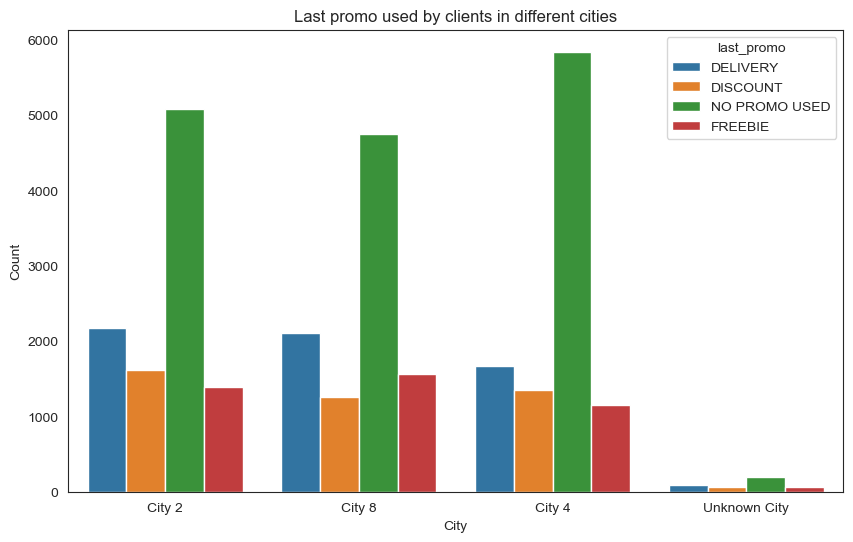

In [220]:
plt.figure(figsize=(10, 6))
sns.countplot(data=df_feature_creation, x="city", hue="last_promo")

plt.xlabel("City")
plt.ylabel("Count")
plt.title("Last promo used by clients in different cities")

plt.show()

Payment method used by clients in different cities

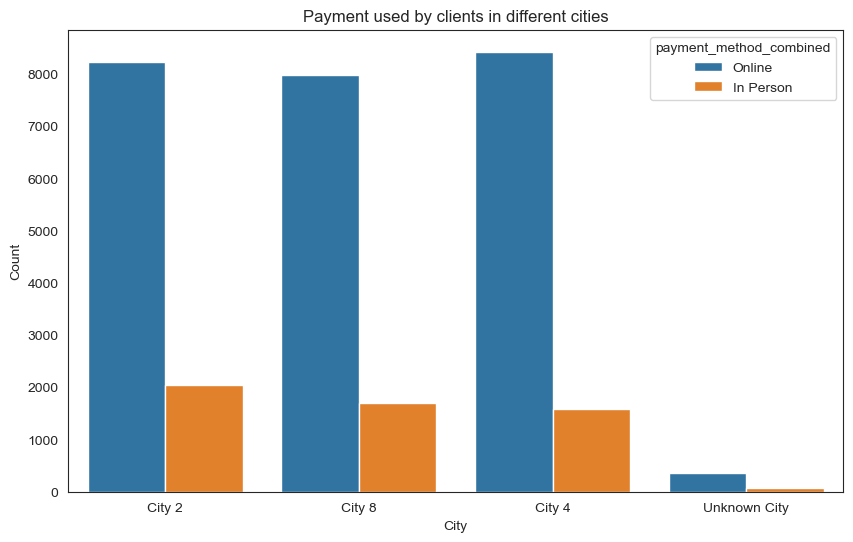

In [221]:
plt.figure(figsize=(10, 6))
sns.countplot(data=df_feature_creation, x="city", hue="payment_method_combined")

plt.xlabel("City")
plt.ylabel("Count")
plt.title("Payment used by clients in different cities")

plt.show()

##### d) Behavioral Insights

Payment method used by clients according to Client Order Behaviour

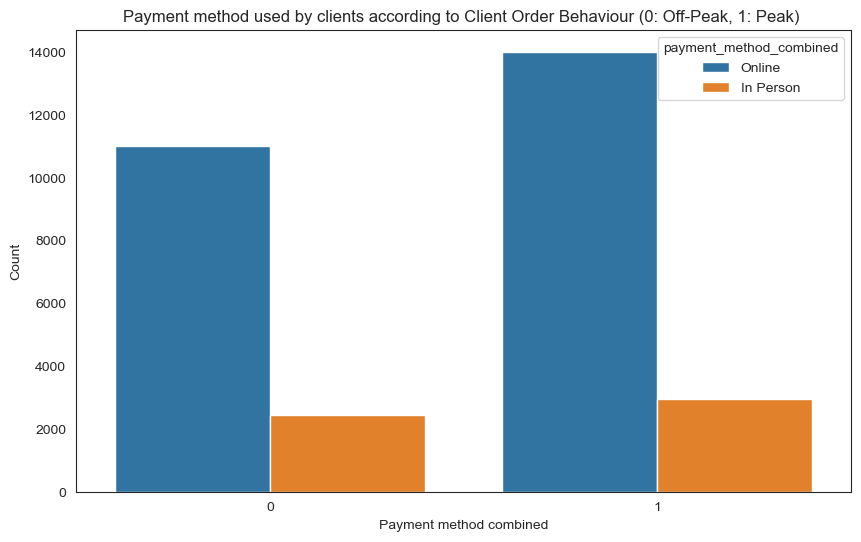

In [222]:
plt.figure(figsize=(10, 6))
sns.countplot(data=df_feature_creation, x="client_behavior_peak_preference", hue="payment_method_combined")

plt.xlabel("Payment method combined")
plt.ylabel("Count")
plt.title("Payment method used by clients according to Client Order Behaviour (0: Off-Peak, 1: Peak) ")

plt.show()


Client order behaviour per time of day slot

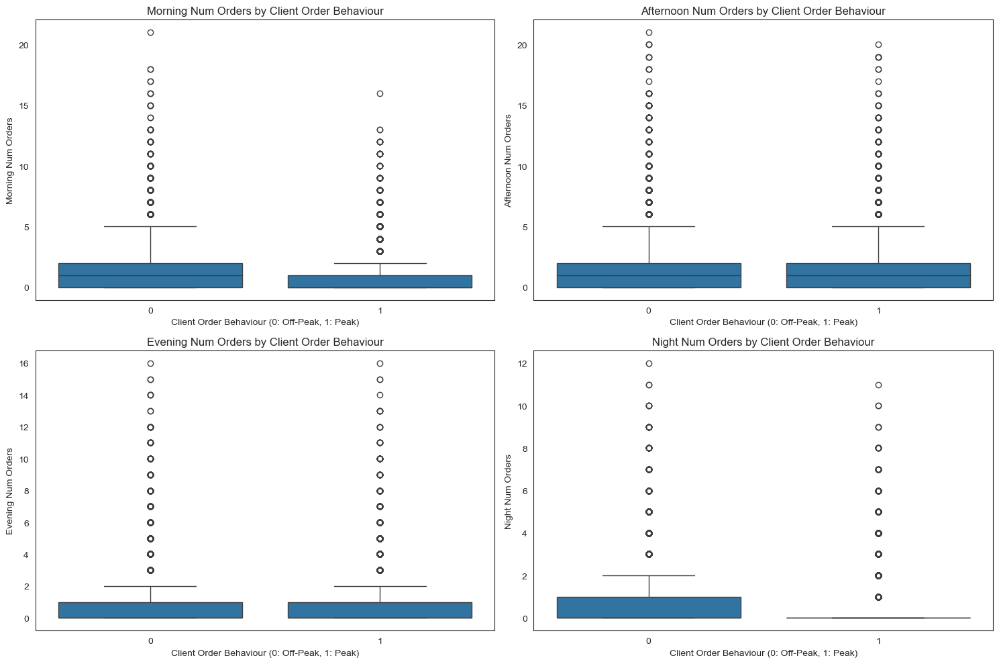

In [223]:
# Define the columns for time periods and the client behavior feature
time_periods = ["morning_num_orders", "afternoon_num_orders", "evening_num_orders", "night_num_orders"]

fig, axes = plt.subplots(2, 2, figsize=(15, 10))  # Creates a 2x2 grid for the four time periods

for i, period in enumerate(time_periods):
    row, col = divmod(i, 2)
    
    # Create a box plot for each time period, with 'client_behavior_peak_preference' as the category
    sns.boxplot(x="client_behavior_peak_preference", y=period, data=df_feature_creation, ax=axes[row, col])
    axes[row, col].set_title(f"{period.replace('_', ' ').title()} by Client Order Behaviour")
    axes[row, col].set_xlabel("Client Order Behaviour (0: Off-Peak, 1: Peak)")
    axes[row, col].set_ylabel(f"{period.replace('_', ' ').title()}")

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


## 3.3 Numerical and Categorical Feature Interactions

##### a) Spending and Order Patterns by Region

Regional Variations in regards to total money spent, total orders made, and number of unique cuisines


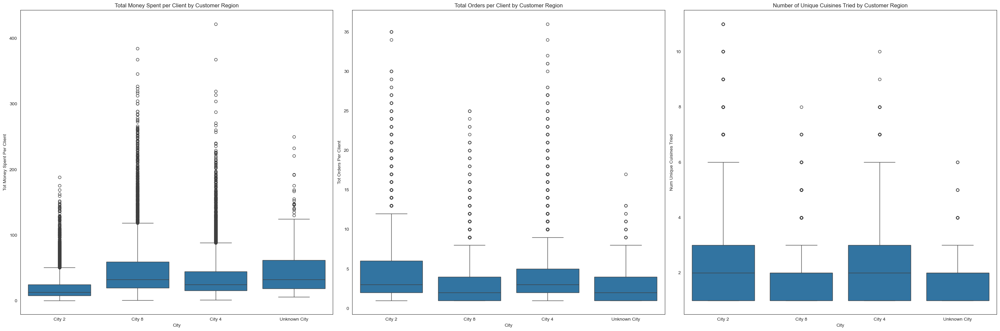

In [224]:
columns = ["tot_money_spent_per_client", "tot_orders_per_client", "num_unique_cuisines_tried"]
titles = [
    "Total Money Spent per Client by Customer Region",
    "Total Orders per Client by Customer Region",
    "Number of Unique Cuisines Tried by Customer Region"
]

fig, axes = plt.subplots(1, 3, figsize=(30, 10))

for i, feature in enumerate(columns):
    sns.boxplot(x="city", y=feature, data=df_feature_creation, ax=axes[i])
    axes[i].set_title(titles[i])
    axes[i].set_xlabel("City")
    axes[i].set_ylabel(feature.replace("_", " ").title())

plt.tight_layout()
plt.show()


Age Distribution by City

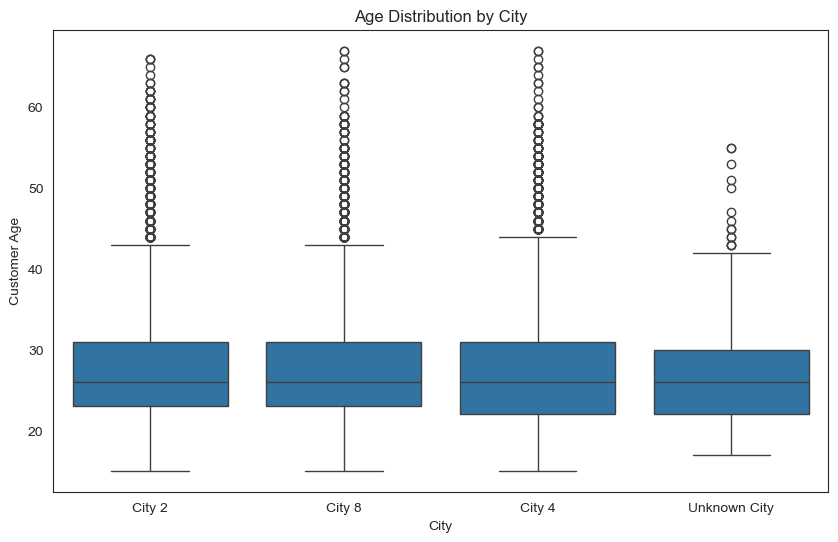

In [225]:
plt.figure(figsize=(10, 6))
sns.boxplot(x="city", y="customer_age", data=df_feature_creation)
plt.title("Age Distribution by City")
plt.xlabel("City")
plt.ylabel("Customer Age")
plt.show()

## 3.4 Droping no longer required features

> - After creating morning_num_orders, afternoon_num_orders, evening_num_orders and night_num_orders we will drop all the HR original features
> - After crating the peak days number of orders and off-peak days number of orders we will drop the DOW original features
> - After creating total money spent per client and purchased features we will drop all the CUI original features
> - After creating city and payment_method_combined we will drop customer_region and payment_method

In [226]:
df_feature_creation = df_feature_creation.drop(columns=HR_columns + CUI_columns + DOW_columns + ["payment_method", "customer_region"])

In [227]:
df_feature_creation.columns

Index(['customer_age', 'vendor_count', 'product_count', 'tot_chain_orders',
       'first_order', 'last_order', 'last_promo', 'payment_method_combined',
       'city', 'tot_orders_per_client', 'tot_money_spent_per_client',
       'purchased_American', 'purchased_Asian', 'purchased_Beverages',
       'purchased_Cafe', 'purchased_Chicken Dishes', 'purchased_Chinese',
       'purchased_Desserts', 'purchased_Healthy', 'purchased_Indian',
       'purchased_Italian', 'purchased_Japanese', 'purchased_Noodle Dishes',
       'purchased_OTHER', 'purchased_Street Food / Snacks', 'purchased_Thai',
       'num_unique_cuisines_tried', 'client_behavior_cuisine_preference',
       'peak_days_num_orders', 'off_peak_days_num_orders',
       'client_behavior_peak_preference', 'morning_num_orders',
       'afternoon_num_orders', 'evening_num_orders', 'night_num_orders',
       'avg_money_spent_per_order', 'avg_products_per_order',
       'tot_non_chain_orders', 'client_behavior_chain_preference',
       '

In [228]:
df_feature_creation.dtypes

customer_age                          float64
vendor_count                            int64
product_count                           int64
tot_chain_orders                        int64
first_order                             int64
last_order                              int64
last_promo                             object
payment_method_combined                object
city                                   object
tot_orders_per_client                   int64
tot_money_spent_per_client            float64
purchased_American                      int32
purchased_Asian                         int32
purchased_Beverages                     int32
purchased_Cafe                          int32
purchased_Chicken Dishes                int32
purchased_Chinese                       int32
purchased_Desserts                      int32
purchased_Healthy                       int32
purchased_Indian                        int32
purchased_Italian                       int32
purchased_Japanese                

Spliting data into numerical and categorical features

In [229]:
numeric_features = df_feature_creation.select_dtypes(include=['int64', 'float64']).columns
categorical_features = df_feature_creation.select_dtypes(include=['object', 'int32']).columns
numeric_features

Index(['customer_age', 'vendor_count', 'product_count', 'tot_chain_orders',
       'first_order', 'last_order', 'tot_orders_per_client',
       'tot_money_spent_per_client', 'num_unique_cuisines_tried',
       'peak_days_num_orders', 'off_peak_days_num_orders',
       'morning_num_orders', 'afternoon_num_orders', 'evening_num_orders',
       'night_num_orders', 'avg_money_spent_per_order',
       'avg_products_per_order', 'tot_non_chain_orders',
       'percent_chain_orders'],
      dtype='object')

# 4. Feature Transformation

In [231]:
df_features_transformed = df_feature_creation.copy()

### Introdutory notes

### 1. Goal of Feature Transformation
- **Objective**: Adjust numerical feature distributions to enhance data quality for modeling.
- **Purpose**:
> 1. Feature transformation techniques are useful for improving model performance, especially for distance-based methods like K-means and hierarchical clustering, as they rely on metrics sensitive to feature scale and distribution. Transformations help reduce skewness, minimize the influence of outliers, and ensure fair weighting among features, which is crucial for accurate clustering.
> 2. Additionally, transformed features often make patterns and relationships more interpretable, which can aid in visualizing clusters and analyzing results. While not strictly required, feature transformation can enhance clustering quality and robustness, particularly when dealing with skewed or unevenly scaled data.
  

### 2. Approach followed

Feature transformation is a critical process in data preparation that facilitates better performance of machine learning models. Although clustering algorithms, such as k-means or hierarchical clustering, are non-parametric, transforming features can enhance their interpretability and stability, particularly when dealing with skewed distributions as mentioned by Osboarne: "Additionally, authors such as Zimmerman (e.g., 1995, 1998) have pointed out that non-parametric tests (where no explicitassumption of normality is made) can suffer as much, or more, than parametric tests when normality assumptions are violated, confirming the importance of normality in all statistical analyses, not just parametric analyses

We used the metric skewness as an indicator to identify highly skewed features, leveraging a threshold of |skewness| ≥ 1 to classify distributions as highly skewed. This threshold, while not explicitly mentioned in Osborne's work, it aligns with practical recommendations for distinguishing non-normal distributions.

Based on Osborne's 2002 work on data transformation, methods like logarithmic, square root, and inverse transformations were applied to adjust the distributions. For features with a minimum value of zero, a constant of 1 was added before transformation to optimize the transformation's efficacy, as supported by Osborne's findings. This adjustment ensures the transformations are more effective at reducing skewness and compressing extreme values. For negatively skewed variables, the distribution was reflected, adjusted, and subsequently restored to maintain the original order, adhering to best practices outlined in the literature. This approach highlights the importance of thoughtful transformation in improving the quality of data and the resulting analytical insights.


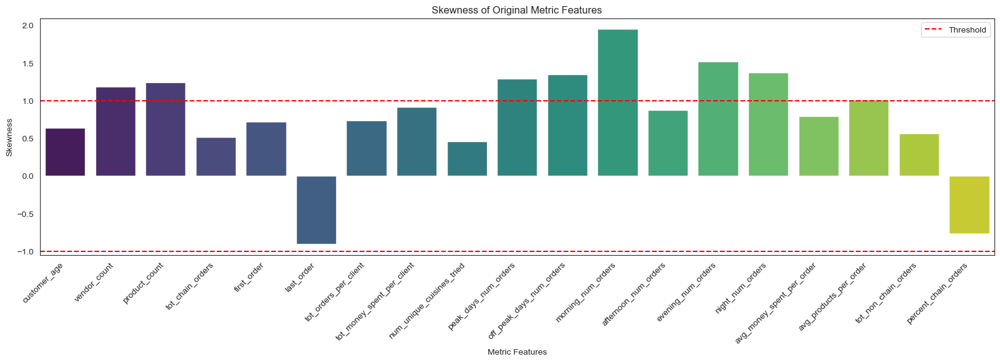

In [232]:
#metric_features = [element for element in df_feature_creation.columns 
                   #if element not in ["customer_region", "customer_age", "last_promo", "payment_method", "payment_method_combined", "city", "client_behavior_peak_preference"] and element not in purchased_features]

#skewness = df_feature_creation[metric_features].skew(axis=0)
#skewness = 3 * (df_feature_creation[metric_features].mean() - df_feature_creation[metric_features].median()) / df_feature_creation[metric_features].std()
skewness = 3 * (df_features_transformed[numeric_features].mean() - df_features_transformed[numeric_features].median()) / df_features_transformed[numeric_features].std()

threshold = 1.0  

mask = np.abs(skewness) > threshold

colors = np.where(mask, 'orange', 'gray')

plt.figure(figsize=(20, 5))
sns.barplot(x=skewness.index, y=skewness, palette='viridis')
plt.axhline(y=threshold, color='red', linestyle='--', label='Threshold')
plt.axhline(y=-threshold, color='red', linestyle='--')
plt.xticks(rotation=45, ha='right')
plt.title('Skewness of Original Metric Features')
plt.xlabel('Metric Features')
plt.ylabel('Skewness')
plt.legend()
plt.show()

In [233]:
def get_transformation(skewness):
    transformations = []

    for skew in skewness:
        if abs(skew) < 1:
            transformations.append("No Transformation")
        elif skew >= -1:
            transformations.append("Square Root or Log transformation(s) or Inverse Transformation")
        elif skew <= 1:
            transformations.append("reflect the distribution, apply one of the already mentioned and reflect again to restore the original order of the variable")

    return transformations

def get_type_skewness(skewness):
    type_skewness = []
    for skew in skewness:
        if skew == 0:
            type_skewness.append("Asymmetry")
        elif skew > 0:
            type_skewness.append("Positive skewed")

        elif skew < 0:
            type_skewness.append ("Negative skewed")
    
    return type_skewness


# Assuming df is your DataFrame and metric_features is the list of metric features
skew_values = 3 * (df_features_transformed[numeric_features].mean() - df_features_transformed[numeric_features].median()) / df_features_transformed[numeric_features].std()
transformation_table = pd.DataFrame({
    'Skewness': skew_values,
    'Type Skewness': get_type_skewness(skew_values),
    'Recommended Transformation': get_transformation(skew_values)
})

# Print a more concise output
#transformation_table[['Feature', 'Skewness', 'Recommended Transformation']]
transformation_table

,Skewness,Type Skewness,Recommended Transformation
customer_age,0.632998,Positive skewed,No Transformation
vendor_count,1.183794,Positive skewed,Square Root or Log transformation(s) or Invers...
product_count,1.243434,Positive skewed,Square Root or Log transformation(s) or Invers...
tot_chain_orders,0.514593,Positive skewed,No Transformation
first_order,0.722132,Positive skewed,No Transformation
last_order,-0.905678,Negative skewed,No Transformation
tot_orders_per_client,0.733926,Positive skewed,No Transformation
tot_money_spent_per_client,0.911231,Positive skewed,No Transformation
num_unique_cuisines_tried,0.460005,Positive skewed,No Transformation
peak_days_num_orders,1.290276,Positive skewed,Square Root or Log transformation(s) or Invers...


Based on table above, we defined features that need transformation and applied the transformation to the dataset.

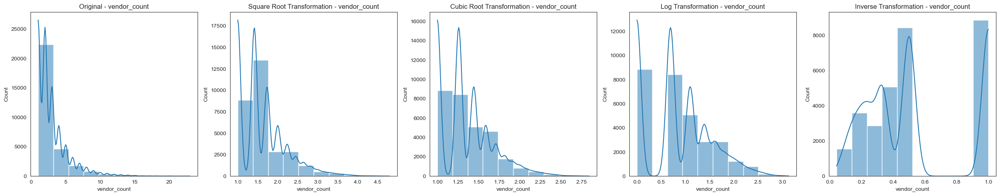

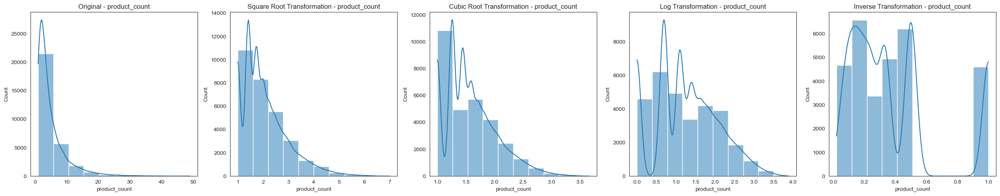

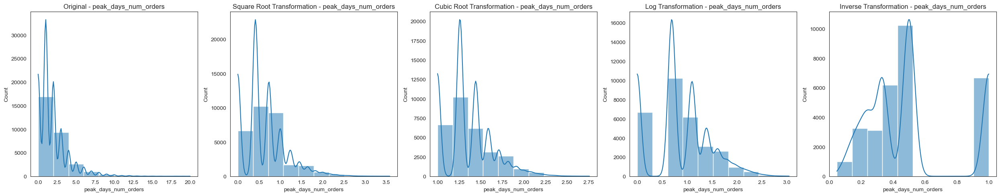

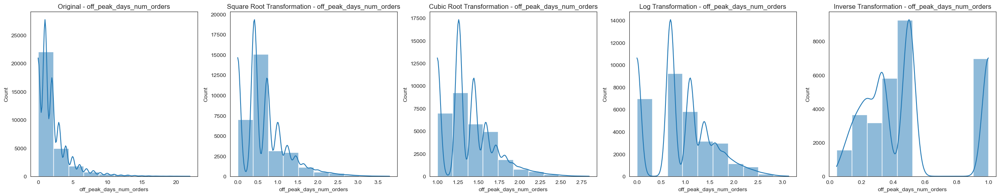

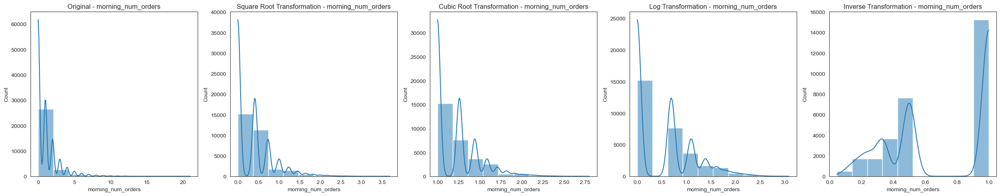

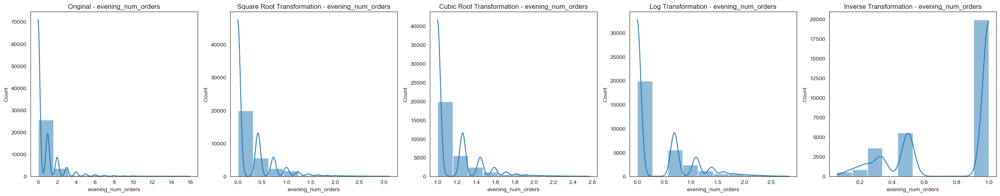

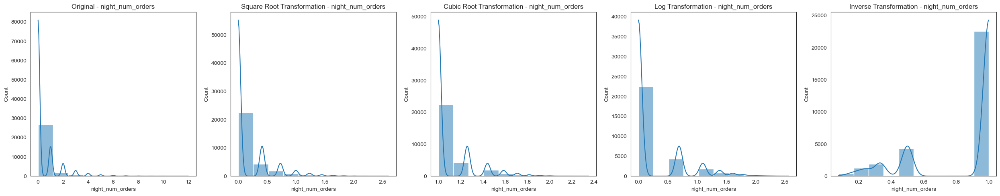

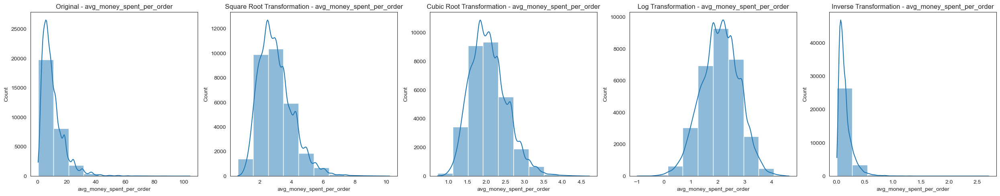

In [234]:
#columns = [element for element in metric_features if element not in ["tot_chain_orders", "first_order", "last_order", "tot_orders_per_client", "tot_money_spent_per_client", "num_unique_cuisines_tried", "afternoon_num_orders"]]
columns_to_transform = [element for element in numeric_features if element in ["vendor_count", "product_count", "peak_days_num_orders", "off_peak_days_num_orders", "morning_num_orders", "evening_num_orders", "night_num_orders", "avg_money_spent_per_order"]]

# Loop through each feature and plot barplots
for feature in columns_to_transform:
    fig, axes = plt.subplots(1, 5, figsize=(25, 5))

    # Original
    sns.histplot(df_features_transformed[feature], bins=10, kde=True, ax=axes[0])
    axes[0].set_title(f'Original - {feature}')

    # Square Root Transformation
    if df_features_transformed[feature].min() == 0:
        df_features_transformed[feature] = df_features_transformed[feature] + 1
        transformed_feature = np.sqrt(df_features_transformed[feature]) - np.sqrt(1)  # Adjust by sqrt(1) to shift back
        sns.histplot(transformed_feature, bins=10, kde=True, ax=axes[1])
    else:
        sns.histplot(np.sqrt(df_features_transformed[feature]), bins=10, kde=True, ax=axes[1])
    axes[1].set_title(f'Square Root Transformation - {feature}')

    # Cubic Root Transformation
    if df_features_transformed[feature].min() == 0:
        df_features_transformed[feature] = df_features_transformed[feature] + 1
        transformed_feature = np.cbrt(df_features_transformed[feature]) - np.cbrt(1)  # Adjust by cbrt(1) to shift back
        sns.histplot(transformed_feature, bins=10, kde=True, ax=axes[2])
    else:
        sns.histplot(np.cbrt(df_features_transformed[feature]), bins=10, kde=True, ax=axes[2])
    axes[2].set_title(f'Cubic Root Transformation - {feature}')

    # Log Transformation
    if df_features_transformed[feature].min() == 0:
        df_features_transformed[feature] = df_features_transformed[feature] + 1
        sns.histplot(np.log(df_features_transformed[feature]) - 1, bins=10, kde=True, ax=axes[3])
    else:
        sns.histplot(np.log(df_features_transformed[feature]), bins=10, kde=True, ax=axes[3])
    axes[3].set_title(f'Log Transformation - {feature}')

    # Inverse Transformation
    if df_features_transformed[feature].min() == 0:
        df_features_transformed[feature] = df_features_transformed[feature] + 1
        sns.histplot((1 / df_features_transformed[feature]) - 1, bins=10, kde=True, ax=axes[4])
    else:
        sns.histplot(1 / df_features_transformed[feature], bins=10, kde=True, ax=axes[4])
    axes[4].set_title(f'Inverse Transformation - {feature}')

    plt.tight_layout()
    plt.show()

With same x-axis

In [235]:
#columns_to_transform = [element for element in metric_features if element not in ["tot_chain_orders", "first_order", "last_order", "tot_orders_per_client", "tot_money_spent_per_client", "num_unique_cuisines_tried", "afternoon_num_orders"]]
"""
# Loop through each feature and plot histograms
for feature in columns_to_transform:
    fig, axes = plt.subplots(1, 5, figsize=(25, 5))

    # Get x-axis limits from the original 
    # Original
    sns.histplot(df_feature_creation[feature], bins= 10, kde=False, ax=axes[0])
    axes[0].set_title(f'Original - {feature}')

    # Square Root Transformation
    if df_feature_creation[feature].min() == 0:
        transformed_feature = np.sqrt(df_feature_creation[feature] + 1) - np.sqrt(1)
        x_min, x_max = 0, transformed_feature.max()

    else:
        transformed_feature = np.sqrt(df_feature_creation[feature])
        sns.histplot(transformed_feature, bins=10, kde=False, ax=axes[1])
    axes[1].set_xlim(x_min, x_max)  # Set consistent x-axis limits
    axes[1].set_title(f'Square Root Transformation - {feature}')

    # Cubic Root Transformation
    if df_feature_creation[feature].min() == 0:
        transformed_feature = np.cbrt(df_feature_creation[feature] + 1) - np.cbrt(1)
    else:
        transformed_feature = np.cbrt(df_feature_creation[feature])
        sns.histplot(transformed_feature, bins=10, kde=False, ax=axes[2])
    axes[2].set_xlim(x_min, x_max)  # Set consistent x-axis limits
    axes[2].set_title(f'Cubic Root Transformation - {feature}')

    # Log Transformation
    if df_feature_creation[feature].min() == 0:
        transformed_feature = np.log(df_feature_creation[feature] + 1) - 1
    else:
        transformed_feature = np.log(df_feature_creation[feature])
        sns.histplot(transformed_feature, bins=10, kde=False, ax=axes[3])
    axes[3].set_xlim(x_min, x_max)  # Set consistent x-axis limits
    axes[3].set_title(f'Log Transformation - {feature}')

    # Inverse Transformation
    if df_feature_creation[feature].min() == 0:
        transformed_feature = (1 / (df_feature_creation[feature] + 1)) - 1
    else:
        transformed_feature = 1 / df_feature_creation[feature]
        sns.histplot(transformed_feature, bins=10, kde=False, ax=axes[4])
    axes[4].set_xlim(x_min, x_max)  # Set consistent x-axis limits
    axes[4].set_title(f'Inverse Transformation - {feature}')

    plt.tight_layout()
    plt.show()
"""

"\n# Loop through each feature and plot histograms\nfor feature in columns_to_transform:\n    fig, axes = plt.subplots(1, 5, figsize=(25, 5))\n\n    # Get x-axis limits from the original \n    # Original\n    sns.histplot(df_feature_creation[feature], bins= 10, kde=False, ax=axes[0])\n    axes[0].set_title(f'Original - {feature}')\n\n    # Square Root Transformation\n    if df_feature_creation[feature].min() == 0:\n        transformed_feature = np.sqrt(df_feature_creation[feature] + 1) - np.sqrt(1)\n        x_min, x_max = 0, transformed_feature.max()\n\n    else:\n        transformed_feature = np.sqrt(df_feature_creation[feature])\n        sns.histplot(transformed_feature, bins=10, kde=False, ax=axes[1])\n    axes[1].set_xlim(x_min, x_max)  # Set consistent x-axis limits\n    axes[1].set_title(f'Square Root Transformation - {feature}')\n\n    # Cubic Root Transformation\n    if df_feature_creation[feature].min() == 0:\n        transformed_feature = np.cbrt(df_feature_creation[feature] 

How to select which trasnformation to apply to the data ?

> The criteria to select the optimal trasnformation was based on how close to a Normal distribution the distribution of the feature became. 

Why do we want the features to be more normally distributed ?

> Transforming features closer to a normal distribution improves clustering by ensuring balanced distance metrics, reducing skewness, and minimizing outlier influence. This leads to better-defined clusters and more accurate results, especially in algorithms like K-Means 

Final selection

> Ended up selecting the log transformation for all features since it represents the transformation that resulted in the best visual approximation to a Normal distribution


In [236]:
# Apply log transformation to all features
#transformed_columns = df_feature_creation[columns_to_transform].apply(lambda x: np.log1p(x))
for column in columns_to_transform:
    df_features_transformed[column+"_log"] = np.log1p(df_features_transformed[column])

In [237]:
transformed_columns = [element for element in df_features_transformed.columns if "_log" in str(element)]
other_numeric_features = [element for element in numeric_features if element not in columns_to_transform]
transformed_and_other_numeric_features = transformed_columns + other_numeric_features
transformed_and_other_numeric_features

['vendor_count_log',
 'product_count_log',
 'peak_days_num_orders_log',
 'off_peak_days_num_orders_log',
 'morning_num_orders_log',
 'evening_num_orders_log',
 'night_num_orders_log',
 'avg_money_spent_per_order_log',
 'customer_age',
 'tot_chain_orders',
 'first_order',
 'last_order',
 'tot_orders_per_client',
 'tot_money_spent_per_client',
 'num_unique_cuisines_tried',
 'afternoon_num_orders',
 'avg_products_per_order',
 'tot_non_chain_orders',
 'percent_chain_orders']

Checking the skewness values after applying the transformations

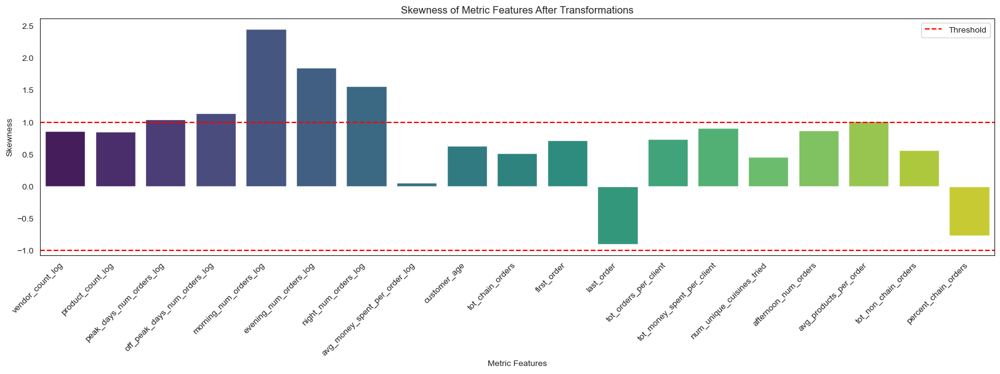

In [238]:
#metric_features = [element for element in df_feature_creation.columns 
                   #if element not in ["customer_region", "customer_age", "last_promo", "payment_method", "payment_method_combined", "city", "client_behavior_peak_preference"] and element not in purchased_features]

#skewness = df_feature_creation[metric_features].skew(axis=0)
#skewness = 3 * (df_feature_creation[metric_features].mean() - df_feature_creation[metric_features].median()) / df_feature_creation[metric_features].std()

skewness = 3 * (df_features_transformed[transformed_and_other_numeric_features].mean() - df_features_transformed[transformed_and_other_numeric_features].median()) / df_features_transformed[transformed_and_other_numeric_features].std()

threshold = 1.0  

mask = np.abs(skewness) > threshold

colors = np.where(mask, 'orange', 'gray')

plt.figure(figsize=(20, 5))
sns.barplot(x=skewness.index, y=skewness, palette='viridis')
plt.axhline(y=threshold, color='red', linestyle='--', label='Threshold')
plt.axhline(y=-threshold, color='red', linestyle='--')
plt.xticks(rotation=45, ha='right')
plt.title('Skewness of Metric Features After Transformations')
plt.xlabel('Metric Features')
plt.ylabel('Skewness')
plt.legend()
plt.show()

Notes
> We can see that after applying the transformation we reduced the number of features with a Skeweness level above or equal to one from eight features to just four

> vendor_count, product_count, peak_days_num_orders and off_peak_days_num_orders which previously had skewness levels above or equal to one after the transformations no longer have it

> Despite trasnformation, morning_num_orders, evening_num_orders, night_num_orders and avg_products_per_order still have a skewness level equal or above to one after transformations

Histogram for the newly transformed features

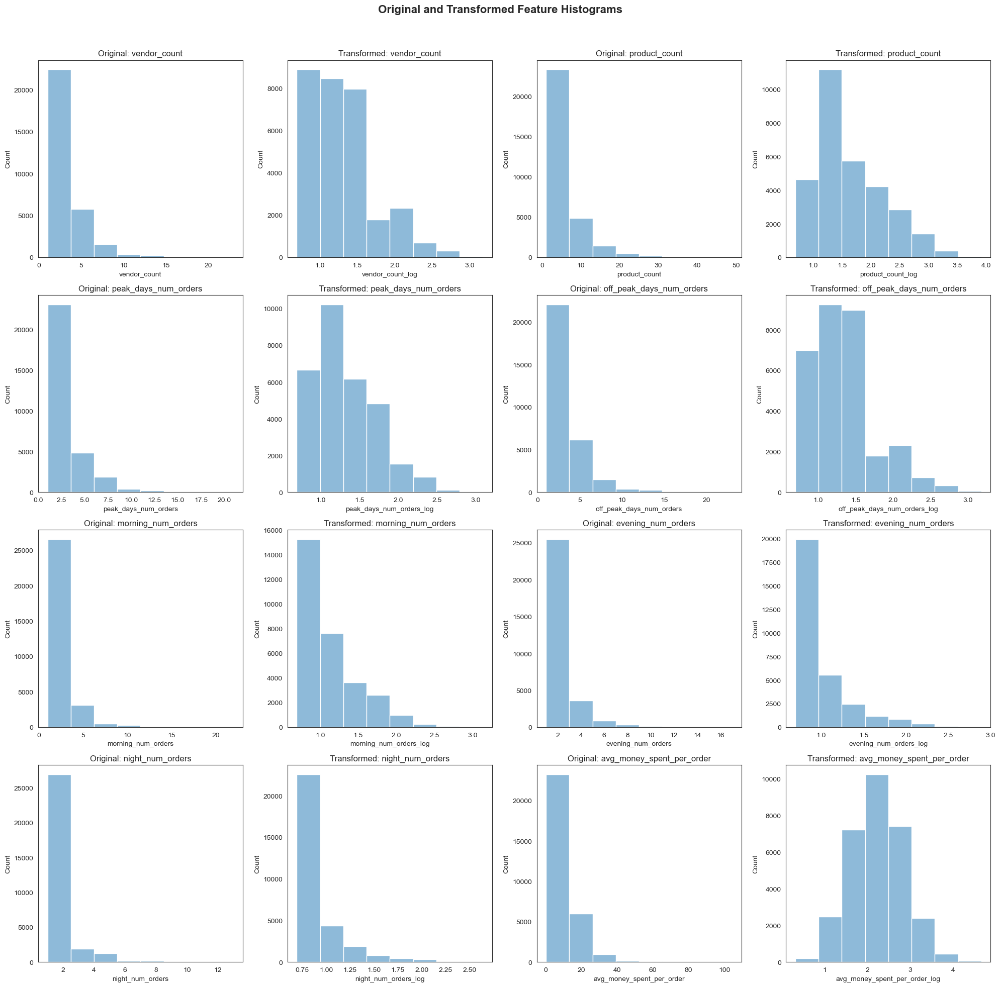

In [239]:
# Define the number of features and layout
num_features = len(columns_to_transform)
plots_per_row = 4  # Two features per row, original + transformed for each
rows = (num_features + 1) // 2  # Each row has histograms for 2 features (4 plots)

fig, axes = plt.subplots(rows, plots_per_row, figsize=(20, 5 * rows))

# Flatten axes for easy indexing
axes = axes.flatten()

# Iterate over features in pairs (original + transformed)
for i, feature in enumerate(columns_to_transform):
    # Original feature histogram
    sns.histplot(df_features_transformed[feature], kde=False, ax=axes[i * 2], alpha=0.5, bins=8)
    axes[i * 2].set_title(f"Original: {feature}")

    # Transformed feature histogram
    sns.histplot(df_features_transformed[feature+"_log"], kde=False, ax=axes[i * 2 + 1], alpha=0.5, bins=8)
    axes[i * 2 + 1].set_title(f"Transformed: {feature}")

# Remove unused subplots
for j in range(num_features * 2, len(axes)):
    fig.delaxes(axes[j])

# Adding an overall title
plt.suptitle("Original and Transformed Feature Histograms", fontsize=16, fontweight='bold')

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Save the figure
output_dir = 'figures/Notebook_1'
os.makedirs(output_dir, exist_ok=True)
plt.savefig(os.path.join(output_dir, 'CUI_features_histograms.png'), dpi=200)

# Show the plot
plt.show()


Boxplot for newly transformed features

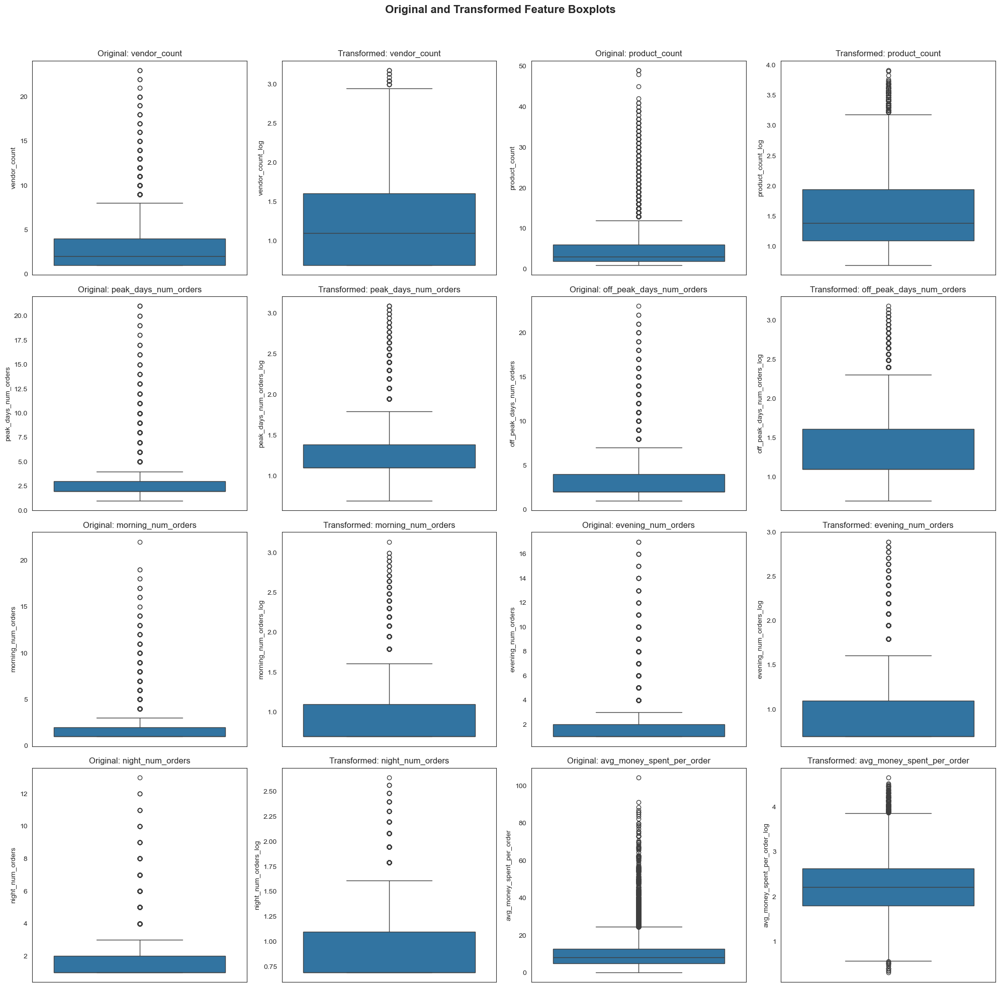

In [240]:
# Define the number of features and layout
num_features = len(columns_to_transform)
plots_per_row = 4  # Two features per row, original + transformed for each
rows = (num_features + 1) // 2  # Each row has boxplot for 2 features (4 plots)

fig, axes = plt.subplots(rows, plots_per_row, figsize=(20, 5 * rows))

# Flatten axes for easy indexing
axes = axes.flatten()

# Iterate over features in pairs (original + transformed)
for i, feature in enumerate(columns_to_transform):
    # Original feature histogram
    sns.boxplot(df_features_transformed[feature], ax=axes[i * 2])
    axes[i * 2].set_title(f"Original: {feature.replace('_transformed', '')}")

    # Transformed feature histogram
    sns.boxplot(df_features_transformed[feature+"_log"], ax=axes[i * 2 + 1])
    axes[i * 2 + 1].set_title(f"Transformed: {feature}")

# Remove unused subplots
for j in range(num_features * 2, len(axes)):
    fig.delaxes(axes[j])

# Adding an overall title
plt.suptitle("Original and Transformed Feature Boxplots", fontsize=16, fontweight='bold')

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Save the figure
output_dir = 'figures/Notebook_2'
os.makedirs(output_dir, exist_ok=True)
plt.savefig(os.path.join(output_dir, 'CUI_features_boxplots.png'), dpi=200)

# Show the plot
plt.show()


Missing values for transformed features

In [241]:
df_features_transformed[transformed_columns].isnull().sum()

vendor_count_log                 0
product_count_log                0
peak_days_num_orders_log         0
off_peak_days_num_orders_log     0
morning_num_orders_log           0
evening_num_orders_log           0
night_num_orders_log             0
avg_money_spent_per_order_log    0
dtype: int64

Outliers for transformed features

In [242]:
outlier_detection(df_features_transformed, transformed_columns)

vendor_count_log: 
Number of extreme outliers: 0 (%) 
Number of moderate outliers: 23 (%) 
Total number of outliers: 23
Q3 + 1.5*IQR = 2.98 
Q3 + 3*IQR = 4.36
Max: 3.1780538303479458 
Min: 0.6931471805599453 
95th percentil: 2.2
99th percentil: 2.56 

product_count_log: 
Number of extreme outliers: 0 (%) 
Number of moderate outliers: 317 (%) 
Total number of outliers: 317
Q3 + 1.5*IQR = 3.22 
Q3 + 3*IQR = 4.49
Max: 3.912023005428146 
Min: 0.6931471805599453 
95th percentil: 2.77
99th percentil: 3.22 

peak_days_num_orders_log: 
Number of extreme outliers: 640 (25%) 
Number of moderate outliers: 1895 (74%) 
Total number of outliers: 2535
Q3 + 1.5*IQR = 1.82 
Q3 + 3*IQR = 2.25
Max: 3.091042453358316 
Min: 0.6931471805599453 
95th percentil: 2.08
99th percentil: 2.4 

off_peak_days_num_orders_log: 
Number of extreme outliers: 1 (0%) 
Number of moderate outliers: 775 (99%) 
Total number of outliers: 776
Q3 + 1.5*IQR = 2.38 
Q3 + 3*IQR = 3.14
Max: 3.1780538303479458 
Min: 0.6931471805599453

Replacing original features present in transformed columns with the transformed columns

In [243]:
for column in transformed_columns:
    df_features_transformed[column.replace("_log", "")] = df_features_transformed[column]

In [244]:
df_features_transformed[numeric_features].columns

Index(['customer_age', 'vendor_count', 'product_count', 'tot_chain_orders',
       'first_order', 'last_order', 'tot_orders_per_client',
       'tot_money_spent_per_client', 'num_unique_cuisines_tried',
       'peak_days_num_orders', 'off_peak_days_num_orders',
       'morning_num_orders', 'afternoon_num_orders', 'evening_num_orders',
       'night_num_orders', 'avg_money_spent_per_order',
       'avg_products_per_order', 'tot_non_chain_orders',
       'percent_chain_orders'],
      dtype='object')

# 5. Feature Scaling

### 1. Why we perform feature scaling

> Feature scaling is crucial as it ensures all features contribute equally to analyses and models by standardizing their ranges

> It is particularly important during feature selection to ensure that methods like Spearman Correlation are applied to features on comparable scales, as well as during clustering 


### 2. StandardScaler() vs MinMax Scaler()

> StandardScaler
- Centers the data around zero and normalizes it using the standard deviation
- Does not guarantee a fixed range and instead the features are scaled relative to their mean and variance
- Since it doesn't compress the data into a fixed range it's more suited to deal with outliers
- However, it will result it features having negative values which considering the scope of our work it doesn't make sense. It would result in having features like customer_age with negative values

> MinMax Scaler
- Maintains the relative shape and distribution of the data by simply rescaling the values into a fixed range ([0,1]).
- Because it compresses data into a fixed range, it's more sensitive to outliers hence the features shouldn't have extreme outliers or have them removed before hand 
- No negative values


> Final choice **StandardScaler**
- We will use the StandardScaler() because it retains the original distribution's broader range, which can be beneficial for algorithms that aren't affected by specific value ranges but are sensitive to feature variance.
- Additionally, since the removal of multivariate outliers using DBSCAN will occur after feature scaling, using the StandardScaler can be better due to its superior ability to handle outliers effectively.
- In contrast, MinMaxScaler squeezes the data into a [0, 1] range, which can cause the values to lose their scale relative to one another and lead to the extreme compression of large or small ranges




In [245]:
df_scaled = df_features_transformed.copy()

In [246]:
standard_scaler = StandardScaler()
scaled_data = standard_scaler.fit_transform(df_scaled[numeric_features])
df_scaled[numeric_features] = scaled_data
df_scaled[numeric_features].describe()

,customer_age,vendor_count,product_count,tot_chain_orders,first_order,last_order,tot_orders_per_client,tot_money_spent_per_client,num_unique_cuisines_tried,peak_days_num_orders,off_peak_days_num_orders,morning_num_orders,afternoon_num_orders,evening_num_orders,night_num_orders,avg_money_spent_per_order,avg_products_per_order,tot_non_chain_orders,percent_chain_orders
count,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04,3.041700e+04
mean,-2.132773e-16,6.727695e-16,3.139591e-16,-2.990087e-17,-1.196035e-16,8.970260e-17,2.990087e-17,1.495043e-16,-1.644548e-16,3.737608e-16,8.671252e-16,3.064839e-16,-1.495043e-17,1.719300e-16,1.083906e-16,-2.691078e-16,-1.980933e-16,7.475217e-18,-1.121283e-17
std,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00,1.000016e+00
min,-1.797494e+00,-1.130809e+00,-1.379235e+00,-8.545028e-01,-1.204971e+00,-2.711672e+00,-8.057317e-01,-9.933668e-01,-8.771218e-01,-1.308366e+00,-1.253019e+00,-8.169563e-01,-7.639584e-01,-6.177016e-01,-5.219542e-01,-3.140663e+00,-7.086583e-01,-7.001236e-01,-1.615031e+00
25%,-6.436823e-01,-1.130809e+00,-7.378005e-01,-5.130183e-01,-8.695777e-01,-6.452242e-01,-5.251889e-01,-6.290903e-01,-8.771218e-01,-3.488011e-01,-3.816562e-01,-8.169563e-01,-7.639584e-01,-6.177016e-01,-5.219542e-01,-7.042447e-01,-7.086583e-01,-7.001236e-01,-7.577988e-01
50%,-2.110030e-01,-2.867127e-01,-2.826958e-01,-1.715337e-01,-2.407145e-01,3.018976e-01,-2.446460e-01,-3.037487e-01,-1.533375e-01,-3.488011e-01,-3.816562e-01,-8.169563e-01,-2.920004e-01,-6.177016e-01,-5.219542e-01,-2.040732e-02,-3.377966e-01,-1.889828e-01,2.552939e-01
75%,5.101293e-01,7.767231e-01,6.026002e-01,1.699508e-01,6.816182e-01,8.615605e-01,3.164396e-01,2.560866e-01,5.704469e-01,3.320210e-01,7.161315e-01,1.867792e-01,1.799575e-01,5.022054e-01,8.158597e-01,6.511358e-01,4.966422e-01,3.221580e-01,9.566658e-01
max,5.702281e+00,4.042265e+00,3.712934e+00,1.041449e+01,2.484359e+00,1.119866e+00,9.013267e+00,1.144276e+01,6.360722e+00,4.366440e+00,4.087159e+00,5.229114e+00,9.147158e+00,5.451100e+00,5.898489e+00,3.971781e+00,1.134435e+01,1.156726e+01,9.566658e-01


# 6. Removing multivariate outliers using DBSCAN

>#### What is DBSCAN?

1. DBSCAN is a density-based clustering algorithm that groups together points that are closely packed together. The algorithm works by defining two parameters: epsilon (ε) and min_samples. 
2. Epsilon is the radius around a point defining the maximum distance between two points for them to be considered as part of the same cluster,
3. Min_samples is the minimum number of points present in the radius of an observation for it to be considered a core point. 
4. If a point has the minimum number of points within its radius, it is considered a core point.
5. If a point is not a core point and it is not within the radius of another core point, it is considered an outlier.
6. If a point is within the radius of a core point but is not a core point itself, it is considered a border point.

>#### Why we are using DBSCAN to detect multivariate outliers ?

1. Since DBSCAN differentiates between core points, border points, and outliers, it is a good choice for detecting multivariate outliers.
2. DBSCAN can identify outliers that are not part of any cluster in n dimensions, which is useful for detecting anomalies in the data.
    
>#### How to define the min_samples parameter?

1. Based on the practical class, we will use the following rule of thumb to define min_samples: min_samples = Two times the number of numeric features used
2. However, it may be necessary to choose larger values for very large data, for noisy data or for data that contains many duplicates.
    
>#### How to define the epsilon parameter?

1. Plot the furthest distance to the k nearest neighbour for each observation with k = min_samples defined and choose the elbow point as the epsilon value.


Defining the epsilon and min_samples values for DBSCAN

In [247]:
df_scaled[numeric_features].columns

Index(['customer_age', 'vendor_count', 'product_count', 'tot_chain_orders',
       'first_order', 'last_order', 'tot_orders_per_client',
       'tot_money_spent_per_client', 'num_unique_cuisines_tried',
       'peak_days_num_orders', 'off_peak_days_num_orders',
       'morning_num_orders', 'afternoon_num_orders', 'evening_num_orders',
       'night_num_orders', 'avg_money_spent_per_order',
       'avg_products_per_order', 'tot_non_chain_orders',
       'percent_chain_orders'],
      dtype='object')

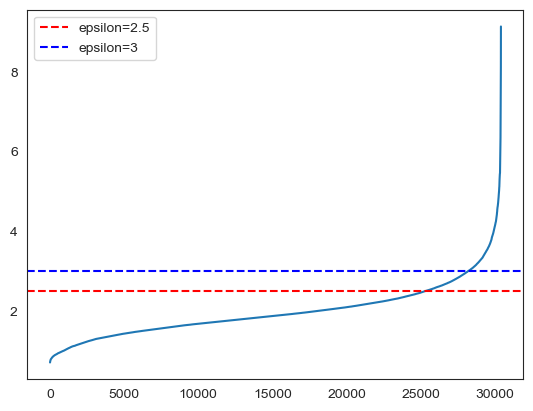

In [248]:
# Defining min number of samples to become a core point
min_samples = 2*len(numeric_features)

# Using KNN to obtain optimal epsilon
neigh = NearestNeighbors(n_neighbors=min_samples)
neigh.fit(df_scaled[numeric_features])
distances, _ = neigh.kneighbors(df_scaled[numeric_features])
distances = np.sort(distances[:, -1])
plt.plot(distances)

# Adding horizontal lines for y = 2 and y = 3
plt.axhline(y=2.5, color='red', linestyle='--', label='epsilon=2.5')
plt.axhline(y=3, color='blue', linestyle='--', label='epsilon=3')

plt.legend()
plt.show()

> Visually, the elbow point seems to be between 0.4 and 0.5 meaning that the optimal epsilon value will be between these values. We will select the higher range value for the epsilon parameter, which is 0.5 to minimize number of observations removed

Applying the DBSCAN with the determined parameters

In [249]:
dbscan = DBSCAN(eps=3, min_samples=min_samples, n_jobs=4)
dbscan_clusters = dbscan.fit_predict(df_scaled[numeric_features])
print("Clusters created: " + str(list(set(dbscan_clusters))))

Clusters created: [0, -1]


Number of observations identified as outliers

In [250]:
df_scaled[dbscan_clusters == -1]

,customer_age,vendor_count,product_count,tot_chain_orders,first_order,last_order,last_promo,payment_method_combined,city,tot_orders_per_client,...,client_behavior_chain_preference,percent_chain_orders,vendor_count_log,product_count_log,peak_days_num_orders_log,off_peak_days_num_orders_log,morning_num_orders_log,evening_num_orders_log,night_num_orders_log,avg_money_spent_per_order_log
customer_id,,,,,,,,,,,,,,,,,,,,,
543b4d9746,-0.066777,1.156280,2.096711,3.243311,-1.204971,-1.678448,DISCOUNT,Online,City 2,2.280239,...,Chain orders,0.956666,1.791759,2.890372,1.791759,2.302585,2.397895,1.098612,0.693147,2.141242
508e4b40d5,-0.643682,2.599272,2.006288,2.901827,-1.204971,-0.946581,NO PROMO USED,Online,City 2,2.280239,...,Chain orders,0.742358,2.484907,2.833213,2.197225,1.945910,1.609438,2.397895,0.693147,1.550926
7b0661a6ba,0.365903,-1.130809,2.263388,3.926280,-1.204971,-0.860479,FREEBIE,Online,City 2,2.841325,...,Chain orders,0.956666,0.693147,2.995732,1.791759,2.484907,2.397895,1.098612,0.693147,1.533174
d6e5be6382,1.231262,2.000376,2.678441,1.194404,-1.204971,-0.602173,NO PROMO USED,Online,City 4,4.805125,...,Non chain orders,-0.880261,2.197225,3.258097,2.397895,2.639057,1.098612,2.397895,1.386294,1.787146
928baa4e96,-0.643682,2.765905,2.551816,2.560342,-1.204971,-0.386918,NO PROMO USED,Online,City 4,2.841325,...,Chain orders,0.221895,2.564949,3.178054,2.197225,2.197225,1.098612,2.197225,1.098612,2.552120
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29ed012886,1.952394,-1.130809,0.358738,-0.854503,1.729723,0.301898,DISCOUNT,In Person,City 8,-0.805732,...,Non chain orders,-1.615031,0.693147,1.791759,1.098612,0.693147,1.098612,0.693147,0.693147,4.392224
832cb16e47,-1.509041,-0.286713,1.166850,-0.171534,1.897420,0.560204,DELIVERY,Online,City 4,-0.525189,...,Chain orders,0.956666,1.098612,2.302585,1.098612,1.098612,1.386294,0.693147,0.693147,4.004055
6abcefede6,1.375488,2.765905,2.484488,3.926280,1.939345,1.076815,FREEBIE,Online,City 2,3.121868,...,Chain orders,0.785219,2.564949,3.135494,2.197225,2.302585,1.791759,0.693147,0.693147,1.848035


Removing multivariate otuleirs detected using DBSCAN

In [754]:
df_scaled_mo = df_scaled[dbscan_clusters ==-1]
df_scaled_no_mo = df_scaled[dbscan_clusters != -1]

Percentage of data kept after multivariate outliers removed using DBSCAN 

In [755]:
data_kept = df_scaled_no_mo.shape[0] / df_scaled.shape[0]
print(f'Percentage of total data kept after removing outliers using DBSCAN:  {data_kept:.2%}')

Percentage of total data kept after removing outliers using DBSCAN:  97.95%


In [756]:
df_scaled[numeric_features].columns

Index(['customer_age', 'vendor_count', 'product_count', 'tot_chain_orders',
       'first_order', 'last_order', 'tot_orders_per_client',
       'tot_money_spent_per_client', 'num_unique_cuisines_tried',
       'peak_days_num_orders', 'off_peak_days_num_orders',
       'morning_num_orders', 'afternoon_num_orders', 'evening_num_orders',
       'night_num_orders', 'avg_money_spent_per_order',
       'avg_products_per_order', 'tot_non_chain_orders',
       'percent_chain_orders'],
      dtype='object')

In [757]:
len(df_scaled[numeric_features].columns)

19

# 7. Segmentation perspectives

In [758]:
df_clustering = df_scaled_no_mo[numeric_features].copy()

Important note

> Since customer age is motly related with the demographic perspective, it was the only feature that was not considered in the clustering process.

#### We will proceed with the following segmentation perspectives:

>#### Activity and Engagement perspective

1. first_order
2. last_order
3. tot_orders_per_client
4. peak_days_num_orders
5. off_peak_days_num_orders
6. morning_num_orders
7. afternoon_num_orders
8. evening_num_orders
9. night_num_orders

>#### Value & Preference Perspective

1. tot_money_spent_per_client
2. avg_money_spent_per_order
3. avg_products_per_order
4. product_count
5. tot_chain_orders
6. tot_non_chain_orders
7. percent_chain_orders
8. num_unique_cuisines_tried
9. vendor_count

## 7.1 Analyze final clustering solution for each perspective

In [759]:
df_value_preference_perspective = df_clustering[["tot_money_spent_per_client","avg_money_spent_per_order", "avg_products_per_order", "product_count", "tot_chain_orders", "tot_non_chain_orders", "percent_chain_orders", "num_unique_cuisines_tried", "vendor_count"]]

### 7.1.1 Feature Selection

Using the Spearman Correlation coefficient

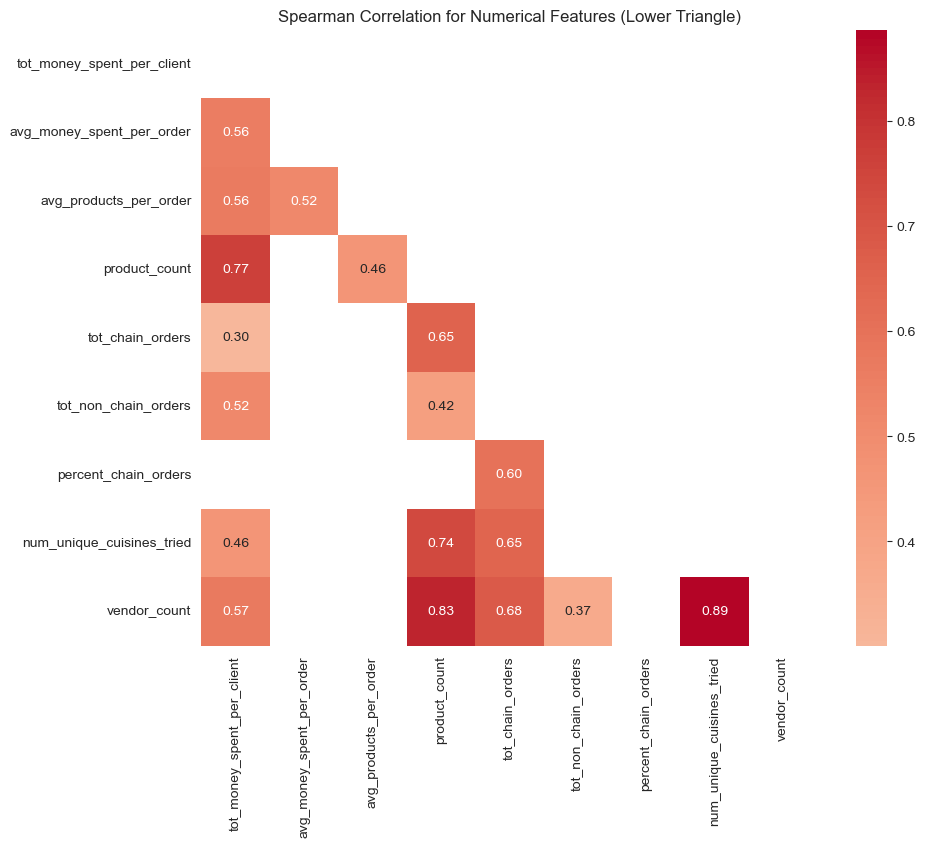

In [760]:
# Calculate Spearman correlation
cor_spearman = df_value_preference_perspective.corr(method='spearman')

# Mask the upper triangle
mask = np.triu(np.ones_like(cor_spearman, dtype=bool))

# Mask values below or equal to 0.3
cor_masked = cor_spearman.where(cor_spearman > 0.3)

# Apply the upper triangle mask
plt.figure(figsize=(10, 8))
sns.heatmap(
    cor_masked, 
    annot=True, 
    cmap='coolwarm', 
    center=0, 
    cbar=True, 
    fmt=".2f", 
    square=True, 
    mask=mask
)
plt.title("Spearman Correlation for Numerical Features (Lower Triangle)")
plt.show()


> Based on the Spearman correlation the following features are candidates to being removed:
1. tot_money_spent_per_client is moderately to highly correlated with other features specially with product_count
2. product_count, vendor_count and num_unique_cuisines are highly correlated with each other
3. tot_chain_orders is moderately high correlated with percent chain orders and with num_unique_cuisines tried


> Important feature criteria to refer in report
1. none of the features included can be calculated obtained by the remaining features

<br>

> vendor_count, product_count and num_unique_cuisines_tried
1. However product_count, vendor_count and num_unique_cuisines tried are highly correlated with each other 
2. Vendor_count has a correlation coeficient of 0.83 and 0.89 with product_count and num_unique_cuisines_tried respectively
3. Product_count has a correlation coeficient of 0.83 and 0.74 with vendor_count and num_unique_cuisines_tried respectively 
4. Num_unique_cuisines_tried has a correlation coefficient of 0.74 and 0.89 with product_count and vendor_count --> keep only num_unique_cuisines_tried
5. Based on these results, it seems like only keeping vendor_count will be suficient to preserve the variability provided by the three features. However, considering the business context, we determined that despite not preserving as much variability as vendor_count, num_unique_cuisines_tried provides more business insights. Instead of knowing the total the number of unique vendors it seemed more insightful knowing not the total number of unique vendors but the different types of unique cuisines tried  

> tot_chain_orders 

1. Regarding tot_chain_orders and percent_chain_orders, since percent_chathe last is only moderately correlated with tot_chain_orders and tot_chain_orders is higly correlated with num_unique_cuisines_tried, we decided to drop  tot_chain_orders and keep percent_chain_orders

> tot_money_spent_per_client

1. Since we are going to drop product_count feature and considering that tot_money_spent_per_client is an important feature for the business and can't be fully explained by any of the features that remain, we decided to keep it

<br>

> Features droped
1. vendor_count 
2. product_count
3. tot_chain_orders


Using the component planes of SOM with small gridsize

> Highlight potentially important features by trying to idnetify features able to differentiate different regions

> Uncover potentially redundant features by trying to identify uniformly colored planes which indicates low variability and suggest redundancy.

In [761]:
# Number of features
# input_len = df_spending_perspective.shape[1]  
input_len = df_value_preference_perspective.shape[1]  


# Grid size (29x29)
grid_size = (15, 15)

# Initialize the SOM
som_activity_engage_fe = MiniSom(x=grid_size[0], y=grid_size[1], input_len=input_len, 
                   sigma=1.5, learning_rate=0.3, neighborhood_function='gaussian',
                   activation_distance='euclidean', random_seed=42)

som_data = df_value_preference_perspective.values

# Initialize weights and start training
som_activity_engage_fe.random_weights_init(som_data)

# Rough Training Phase
som_activity_engage_fe.train_random(som_data, num_iteration=5 * len(som_data))  # 5 epochs

# Fine-Tuning Phase
som_activity_engage_fe.sigma = 0.7  # Reduced neighborhood size
som_activity_engage_fe.learning_rate = 0.1  # Reduced learning rate
som_activity_engage_fe.train_random(som_data, num_iteration=12 * len(som_data))  # 12 epochs


In [762]:
# --------------------------------- Common Helper Function ---------------------------------
def plot_hexagons(som, ax, matrix_vals, colornorm, label, cmap, annot=False):
    """
    Helper function to plot hexagonal grid values for a trained SOM.

    Parameters:
    - som: Trained MiniSom object.
    - ax: Matplotlib axis to plot on.
    - matrix_vals: Matrix values to display on the hexagonal grid.
    - colornorm: Matplotlib color normalization object.
    - label: Title for the plot.
    - cmap: Colormap for the hexagonal grid.
    - annot: Boolean flag to annotate grid cells with their values (default: False).
    """
    for i in range(matrix_vals.shape[0]):
        for j in range(matrix_vals.shape[1]):
            wx, wy = som.convert_map_to_euclidean((i, j))
            hexagon = RegularPolygon((wx, wy), 
                                     numVertices=6, 
                                     radius=np.sqrt(1/3),
                                     facecolor=cmap(colornorm(matrix_vals[i, j])),
                                     edgecolor='white',
                                     linewidth=0.5)
            ax.add_patch(hexagon)
            if annot:
                annot_val = np.round(matrix_vals[i, j], 2)
                ax.text(wx, wy, annot_val, ha='center', va='center', fontsize='x-small')
    ax.margins(0.05)
    ax.set_aspect('equal')
    ax.axis("off")
    ax.set_title(label, fontsize=12)

Component planes

In [763]:
# --------------------------------- Component Planes ---------------------------------
def plot_component_planes(som, df, cmap=cm.Purples, figsize=(12, 12), col_sz=4):
    """
    Plots the component planes of a trained SOM using numerical features of a DataFrame.

    Parameters:
    - som: Trained MiniSom object.
    - df: Pandas DataFrame containing the numerical features.
    - cmap: Colormap to use (default: Purples).
    - figsize: Tuple for figure size (default: (12, 12)).
    - col_sz: Number of columns in the grid layout (default: 4).
    """
    # Ensure DataFrame has only numerical features
    df_numeric = df.select_dtypes(include=[np.number])
    metric_features = df_numeric.columns.tolist()

    # Retrieve SOM weights
    weights = som.get_weights()
    n_features = weights.shape[2]

    # Determine rows and columns for subplots
    n_rows = int(np.ceil(n_features / col_sz))

    # Setup figure
    fig, axes = plt.subplots(n_rows, col_sz, figsize=figsize, constrained_layout=True, dpi=128)
    axes = axes.flatten()

    for idx, feature in enumerate(metric_features):
        matrix_vals = weights[:, :, idx]
        colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))

        # Plot each component plane
        plot_hexagons(som, axes[idx], matrix_vals, colornorm, label=feature, cmap=cmap)

        # Add colorbar
        divider = make_axes_locatable(axes[idx])
        ax_cb = divider.append_axes("right", size="5%", pad="2%")
        cmap_sm = plt.cm.ScalarMappable(cmap=cmap, norm=colornorm)
        plt.colorbar(cmap_sm, cax=ax_cb)

    # Turn off unused axes
    for ax in axes[len(metric_features):]:
        ax.axis("off")

    plt.suptitle("Component Planes", fontsize=20)
    plt.show()

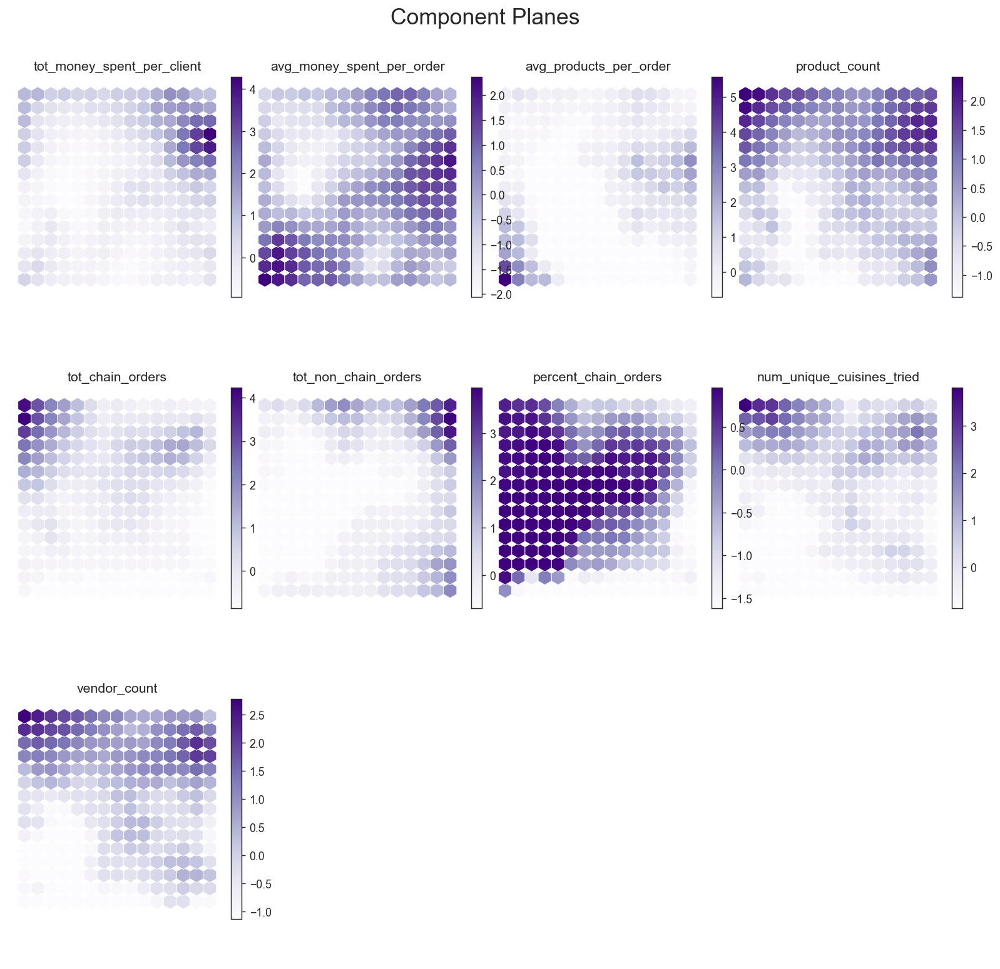

In [764]:
plot_component_planes(som_activity_engage_fe, df_value_preference_perspective)

The analysis on the SOM component planes reinforces the previous analysis on the Spearman correlation matrix.

> tot_chain_orders

1. We can see that tot_chain_orders is highly correlated with the number of unique cuisines tried, vendor_count, and percent_chain_orders, especially with the number of unique cuisines tried.
2. Visually, we can see that all the high-volume total chain order clients are mostly located in the top left corner of the map, coinciding exactly with the clients with a high number of unique cuisines tried.
3. Moreover, we can see that clients with moderate to high total chain orders are located at the top of the map, following the same trend as the clients with a high to medium number of unique cuisines tried.

> num_unique_cuisines_tried, vendor_count, and product_count

1. We can see that these three features are highly correlated with the top part of the map, corresponding to the high values for all three features. This means that clients with a high number of unique cuisines tried, a high vendor count, and a high number of products ordered are located in the top part of the map.
2. We can also see that vendor_count is the best feature to capture the most information of the three features, but as explained before, we selected num_unique_cuisines_tried based on the provided business insights.

> tot_chain_orders

1. We can see that tot_chain_orders is highly correlated with the number of unique cuisines tried and percent_chain_orders.
2. We can see that clients with high total chain orders are located in the top left corner of the map, coinciding exactly with the clients with a high number of unique cuisines tried.

In [765]:
df_value_preference_perspective_fs = df_value_preference_perspective.copy()
df_value_preference_perspective_fs = df_value_preference_perspective_fs.drop(columns=["tot_chain_orders", "product_count", "vendor_count"])
df_value_preference_perspective_fs.columns

Index(['tot_money_spent_per_client', 'avg_money_spent_per_order',
       'avg_products_per_order', 'tot_non_chain_orders',
       'percent_chain_orders', 'num_unique_cuisines_tried'],
      dtype='object')

### 7.1.2 K-Means Clustering

Auxiliary functions

In [766]:
 # ------------------- Inertia -------------------
def get_kmeans_inertia (df, max_nclus, min_nclus=1):
    # range_clusters = range(1, 21)
    inertia = []
    range_clusters = range (min_nclus, max_nclus+1)
    for n_clus in range_clusters:  # iterate over desired ncluster range
        kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=2024)
        kmclust.fit(df)
        inertia.append(kmclust.inertia_)  # save the inertia of the given cluster solution
    return inertia


def plot_kmeans_inertia(inertia, max_nclus, min_nclus=1):
    fig, ax = plt.subplots(figsize=(9,5))
    range_clusters = range(min_nclus, max_nclus + 1)
    ax.plot(range_clusters, inertia)
    ax.set_xticks(range_clusters)
    ax.set_ylabel("Inertia: SSw")
    ax.set_xlabel("Number of clusters")
    ax.set_title("Inertia plot over clusters KMeans", size=15)
    plt.show()

# ------------------- Silhoette score -------------------

def get_avg_silhouette_score(df, max_nclus, min_nclus=1):
    avg_silhouette = []
    range_clusters = range(min_nclus, max_nclus + 1)
    
    for nclus in range_clusters:
        if nclus == 1:  # Skip silhouette score calculation for n_clusters = 1
            continue  # Do not append anything for nclus=1
        
        # Initialize and fit KMeans
        kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=2024)
        cluster_labels = kmclust.fit_predict(df)
        
        # Compute and append silhouette score
        silhouette_avg = silhouette_score(df, cluster_labels)
        avg_silhouette.append(silhouette_avg)
    
    return avg_silhouette


def plot_avg_silhouette_score(silhouette_scores, max_nclus, min_nclus=1):
    range_clusters = range(min_nclus, max_nclus + 1)
    range_clusters = [nclus for nclus in range_clusters if nclus > 1]  # Exclude n_clusters = 1
    fig, ax = plt.subplots(figsize=(9, 5))
    ax.plot(range_clusters, silhouette_scores, marker='o', linestyle='-', color='g')
    ax.set_xticks(range_clusters)
    ax.set_ylabel("Silhouette Score")
    ax.set_xlabel("Number of clusters")
    ax.set_title("Silhouette Score plot over clusters KMeans", size=15)
    plt.show()


# ------------------- R^2 -------------------

def get_sst(df):
  """
    Calculates the sum of squared distances of each point to the mean of the points

  """
  return np.sum(df.var() * (df.count() - 1))

def get_r2(df, labels):
  """
    Calculates r2 given a dataframe and the clustering solution
  """
  sst = get_sst(df)
  ssw = np.sum(df.groupby(labels).apply(get_sst))
  ssb = sst - ssw
  return ssb / sst

def get_r2_kmeans(df, max_nclus, min_nclus=2):
    """
    Compute the R² (explained variance) values for K-means clustering solutions.

    Parameters:
    - df: pandas DataFrame containing the numeric dataset.
    - max_nclus: maximum number of clusters to evaluate.
    - min_nclus: minimum number of clusters to evaluate (default=2).

    Returns:
    - A list of R² values for each number of clusters.
    """
    r2_values = []  # List to store R² values
    
    for nclus in range(min_nclus, max_nclus + 1):
        # Fit K-means clustering
        kmeans = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
        labels = kmeans.fit_predict(df)
        
        # Calculate R² using the provided get_r2 function
        r2 = get_r2(df, labels)
        r2_values.append(r2)
    
    return r2_values


def plot_r2_kmeans(r2_values, max_nclus, min_nclus=2):
    """
    Plot R² values for different numbers of clusters.

    Parameters:
    - r2_values: List of R² values.
    - max_nclus: Maximum number of clusters.
    - min_nclus: Minimum number of clusters.
    """
    plt.figure(figsize=(9, 5))  # Create a fresh figure
    range_clusters = range(min_nclus, max_nclus + 1)
    
    # Plot a single line with R² values
    plt.plot(range_clusters, r2_values, marker='o', linestyle='-', color='b', linewidth=2)
    plt.xlabel("Number of Clusters")
    plt.ylabel("R² (Explained Variance)")
    plt.title("R² Plot for K-means Clustering")
    plt.grid(True)
    plt.show()
    

# -------------------  Calinski and Harabasz score -------------------

def get_calinski_harabasz_scores(df, max_nclus, min_nclus=2):
    ch_scores = []
    for nclus in range(min_nclus, max_nclus + 1):
        kmeans = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
        labels = kmeans.fit_predict(df)
        score = calinski_harabasz_score(df, labels)
        ch_scores.append(score)
    return ch_scores


def plot_ch_index(ch_scores, max_nclus, min_nclus=2):
    plt.figure(figsize=(9, 5))
    range_clusters = range(min_nclus, max_nclus + 1)
    plt.plot(range_clusters, ch_scores, marker='o', linestyle='-', color='g', linewidth=2)
    plt.xlabel("Number of Clusters")
    plt.ylabel("Calinski-Harabasz Index")
    plt.title("Calinski-Harabasz Index for K-means Clustering")
    plt.grid(True)
    plt.show()

Notes

> During the DBSCAN, we only obtained a single cluster. This could indicate that obtaining more than 5 or 6 clusters might be difficult since our data is very close together.

> Because of that, during the determination of the best K for the K-means clustering solution, we try values between 1 and 10.

Determining the best K using Inertia

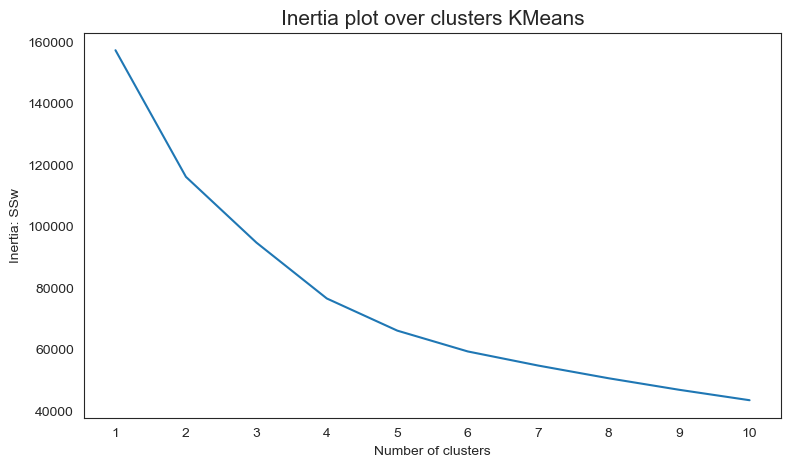

In [767]:
inertia_values = get_kmeans_inertia(df_value_preference_perspective_fs, 10, 1)
plot_kmeans_inertia(inertia_values, 10,1)

output_path = "figures/Notebook_2/2_perspectives/K_means_inertia.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 


> Based on the Inertia plot and the elbow method, the optimal number of clusters is between 2 and 4. 

> Considering the business context and the indications provided by the DBSCAN algorithm, we will choose 3 clusters for the K Means algorithm using the inertia plot

Determine the best K using the silhouette score

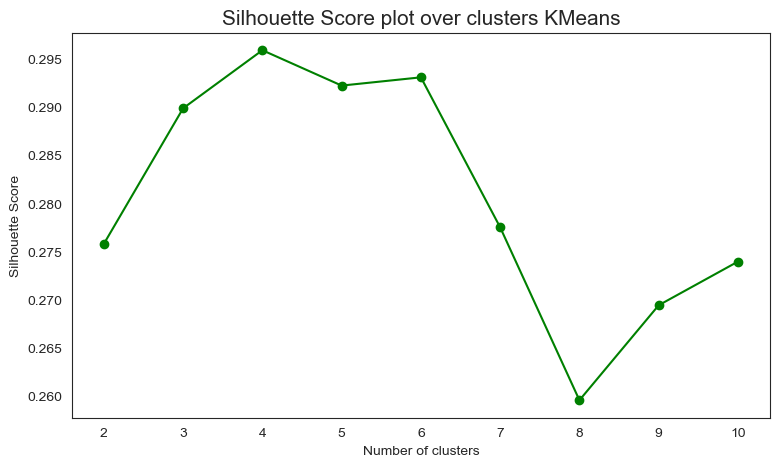

In [768]:
silhouette_scores = get_avg_silhouette_score(df_value_preference_perspective_fs, 10, 1)

plot_avg_silhouette_score(silhouette_scores, 10, 1)
output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/K_means_silhouette_scores.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 

> Based on the Silhouette Score plot, the optimal number of clusters for the K-means algorithm is 4, achieving the highest average silhouette score.

Determine the best K using the R^2

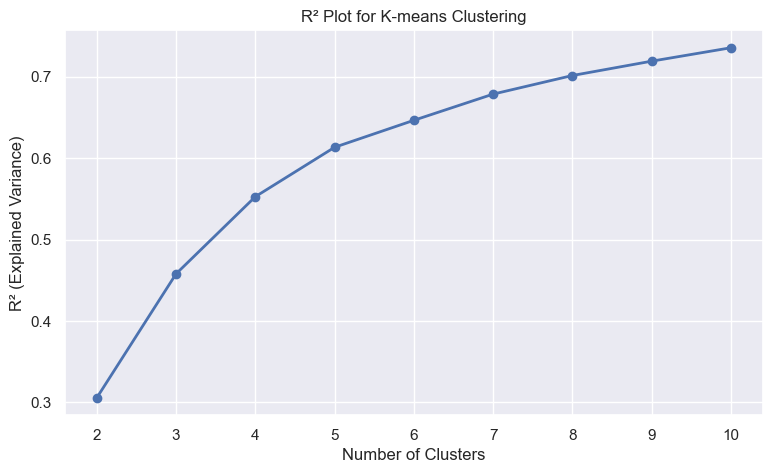

In [410]:
r2_values = get_r2_kmeans(df_value_preference_perspective_fs, max_nclus=10, min_nclus=2)
plot_r2_kmeans(r2_values, max_nclus=10, min_nclus=2)

output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/K_means_R^2.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 


In [770]:
r2_values

[0.26208465091792577,
 0.39815006235377404,
 0.5139142402414207,
 0.5804413065065203,
 0.623521215112028,
 0.6528636657182557,
 0.6792197543064451,
 0.7028773364931048,
 0.7244907824733212]

> Based on the R^2 plot, the optimal number of clusters is between 3 and 4.

Determine the best K using the Calinski and Harabasz score

Source and example used from https://scikit-learn.org/stable/modules/generated/sklearn.metrics.calinski_harabasz_score.html

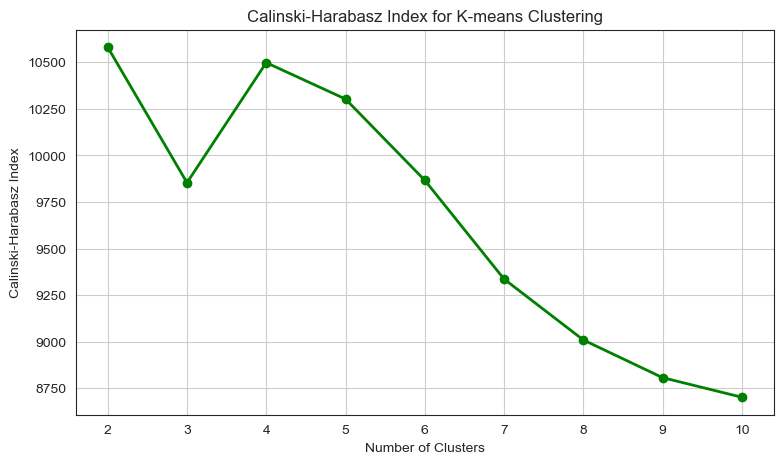

In [771]:
ch_scores = get_calinski_harabasz_scores(df_value_preference_perspective_fs, max_nclus=10, min_nclus=2)
plot_ch_index(ch_scores, max_nclus=10, min_nclus=2)

# output_path = "/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/figures/Notebook_2/2_perspectives/value_pref_perspective/K_means_calinski_harabasz_scores.png"
# plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
# plt.close() 

In [772]:
ch_scores

[10580.484279880224,
 9853.363326614974,
 10497.789111615251,
 10302.256552562503,
 9866.267985780267,
 9336.170625706507,
 9009.23003201854,
 8806.882764216349,
 8701.779634461987]

> Based on the Calinski-Habarasz index, the optimal number of clusters is 2 as it has the highest value with the score with 4 clusters being really close

> Since the Calinski-Harabasz index is a measure of the ratio of between-cluster dispersion to within-cluster dispersion, a higher value indicates better clustering.

Deciding on the optimal K value for K means

| **Method**        | **Optimal K (Inertia)** | **Optimal K (Silhouette)** | **Optimal K (R²)** | **Optimal K (Calinski-Harabasz)** | **Final Decision** |
|--------------------|-------------------------|----------------------------|-------------------|----------------------------------|--------------------|
| K-Means            |            2-4       |            4           |    3-4               |                2 or 4            |          4        |


1. Based on the results, any options between 2, 3, and 4 clusters could have been supported.
2. The solution with four clusters seems to result in the optimal value for the silhouette score and is present as one of the possible solutions in all the other metrics.
3. The solution with two clusters seems to be present as a viable solution in 2 out of the four methods, also offering the least complexity and a more pragmatic approach for the marketing team.
4. The solution with three clusters seems to offer the best trade-off between the best results and implementation in actual marketing campaigns.


### 7.1.3 Hierarchical Clustering

Auxiliary functions

In [773]:
# ------------------- Silhoette score -------------------

def get_avg_silhouette_score_hierarchical(df, max_nclus, min_nclus=2, linkages=['ward', 'complete', 'average', 'single']):
    """
    Calculate average silhouette scores for Hierarchical Clustering solutions with different linkage methods.

    Parameters:
    - df: pandas DataFrame containing the numeric dataset.
    - max_nclus: Maximum number of clusters to evaluate.
    - min_nclus: Minimum number of clusters to evaluate (default=2).
    - linkages: List of linkage methods to evaluate (default=['ward', 'complete', 'average', 'single']).

    Returns:
    - A dictionary where keys are linkage methods and values are lists of silhouette scores for each number of clusters.
    """
    results = {}
    
    for linkage in linkages:
        avg_silhouette = []
        for nclus in range(min_nclus, max_nclus + 1):
            model = AgglomerativeClustering(n_clusters=nclus, linkage=linkage)
            labels = model.fit_predict(df)
            silhouette_avg = silhouette_score(df, labels)
            avg_silhouette.append(silhouette_avg)
        results[linkage] = avg_silhouette
    
    return results


def plot_avg_silhouette_score_hierarchical(silhouette_scores, max_nclus, min_nclus=2):
    """
    Plot silhouette scores for Hierarchical Clustering solutions with different linkage methods.

    Parameters:
    - silhouette_scores: Dictionary of silhouette scores for each linkage method.
    - max_nclus: Maximum number of clusters.
    - min_nclus: Minimum number of clusters.
    """
    range_clusters = range(min_nclus, max_nclus + 1)
    fig, ax = plt.subplots(figsize=(9, 5))

    for linkage, scores in silhouette_scores.items():
        ax.plot(range_clusters, scores, marker='o', linestyle='-', label=f'{linkage}')

    ax.set_xticks(range_clusters)
    ax.set_ylabel("Silhouette Score")
    ax.set_xlabel("Number of clusters")
    ax.set_title("Silhouette Score Plot for Different Linkages", size=15)
    ax.legend(title="Linkage Methods")
    plt.show()



# -------------------  R^2-------------------

def get_r2_hierarchical(df, max_nclus, min_nclus=2, linkages=['ward', 'complete', 'average', 'single']):
    """
    Compute R² values for Hierarchical Clustering solutions with different linkage methods.

    Parameters:
    - df: pandas DataFrame containing the numeric dataset.
    - max_nclus: Maximum number of clusters to evaluate.
    - min_nclus: Minimum number of clusters to evaluate (default=2).
    - linkages: List of linkage methods to evaluate (default=['ward', 'complete', 'average', 'single']).

    Returns:
    - A dictionary where keys are linkage methods and values are lists of R² values for each number of clusters.
    """
    results = {}
    
    for linkage in linkages:
        r2_values = []
        for nclus in range(min_nclus, max_nclus + 1):
            model = AgglomerativeClustering(n_clusters=nclus, linkage=linkage)
            labels = model.fit_predict(df)
            r2 = get_r2(df, labels)
            r2_values.append(r2)
        results[linkage] = r2_values
    
    return results

def plot_r2_hierarchical(r2_values, max_nclus, min_nclus=2):
    """
    Plot R² values for Hierarchical Clustering solutions with different linkage methods.

    Parameters:
    - r2_values: Dictionary of R² values for each linkage method.
    - max_nclus: Maximum number of clusters.
    - min_nclus: Minimum number of clusters.
    """
    range_clusters = range(min_nclus, max_nclus + 1)
    plt.figure(figsize=(9, 5))

    for linkage, values in r2_values.items():
        plt.plot(range_clusters, values, marker='o', linestyle='-', label=f'{linkage}')

    plt.xlabel("Number of Clusters")
    plt.ylabel("R² (Explained Variance)")
    plt.title("R² Plot for Different Linkages")
    plt.legend(title="Linkage Methods")
    plt.grid(True)
    plt.show()


# -------------------  Calinski and Harabasz score -------------------

def get_calinski_harabasz_scores_hierarchical(df, max_nclus, min_nclus=2, linkages=['ward', 'complete', 'average', 'single']):
    """
    Compute Calinski-Harabasz scores for Hierarchical Clustering solutions with different linkage methods.

    Parameters:
    - df: pandas DataFrame containing the numeric dataset.
    - max_nclus: Maximum number of clusters to evaluate.
    - min_nclus: Minimum number of clusters to evaluate (default=2).
    - linkages: List of linkage methods to evaluate (default=['ward', 'complete', 'average', 'single']).

    Returns:
    - A dictionary where keys are linkage methods and values are lists of Calinski-Harabasz scores for each number of clusters.
    """
    results = {}
    
    for linkage in linkages:
        ch_scores = []
        for nclus in range(min_nclus, max_nclus + 1):
            model = AgglomerativeClustering(n_clusters=nclus, linkage=linkage)
            labels = model.fit_predict(df)
            score = calinski_harabasz_score(df, labels)
            ch_scores.append(score)
        results[linkage] = ch_scores
    
    return results


def plot_ch_index_hierarchical(ch_scores, max_nclus, min_nclus=2):
    """
    Plot Calinski-Harabasz scores for Hierarchical Clustering solutions with different linkage methods.

    Parameters:
    - ch_scores: Dictionary of Calinski-Harabasz scores for each linkage method.
    - max_nclus: Maximum number of clusters.
    - min_nclus: Minimum number of clusters.
    """
    range_clusters = range(min_nclus, max_nclus + 1)
    plt.figure(figsize=(9, 5))

    for linkage, scores in ch_scores.items():
        plt.plot(range_clusters, scores, marker='o', linestyle='-', label=f'{linkage}')

    plt.xlabel("Number of Clusters")
    plt.ylabel("Calinski-Harabasz Index")
    plt.title("Calinski-Harabasz Index for Different Linkages")
    plt.legend(title="Linkage Methods")
    plt.grid(True)
    plt.show()



# -------------------  Dendogram -------------------

def plot_hierarchical_dendrogram(df, method='ward', metric='euclidean', y_threshold=100, p=5):
    """
    Plots a dendrogram for hierarchical clustering.

    Parameters:
    - df: pandas DataFrame containing the numeric dataset.
    - method: Linkage method for hierarchical clustering (default: 'ward').
    - metric: Distance metric to compute pairwise distances (default: 'euclidean').
    - y_threshold: Threshold for drawing a horizontal line in the dendrogram (default: 100).
    - p: Number of levels to truncate in the dendrogram (default: 5).

    Output:
    - A dendrogram plot showing the hierarchical clustering structure.
    """
    # Compute the linkage matrix
    linkage_matrix = linkage(df, method=method, metric=metric)

    # Set plot style
    sns.set()
    fig = plt.figure(figsize=(11, 5))

    # Plot the dendrogram
    dendrogram(linkage_matrix, 
               truncate_mode='level',  # Limit the depth of the dendrogram
               p=p,  # Number of levels to display
               color_threshold=y_threshold,  # Set the threshold for coloring branches
               above_threshold_color='k')  # Set color for branches above the threshold

    # Add horizontal threshold line
    plt.hlines(y_threshold, 0, plt.gca().get_xlim()[1], colors="r", linestyles="dashed")

    # Customize plot appearance
    plt.title(f'Hierarchical Clustering Dendrogram: {method.title()} Linkage', fontsize=21)
    plt.xlabel('Number of points in node (or index of point if no parenthesis)', fontsize=12)
    plt.ylabel(f'{metric.title()} Distance', fontsize=13)

    # Show the plot
    plt.show()



Determine the best linkage method and optimal number of clusters using the Silhoette score 

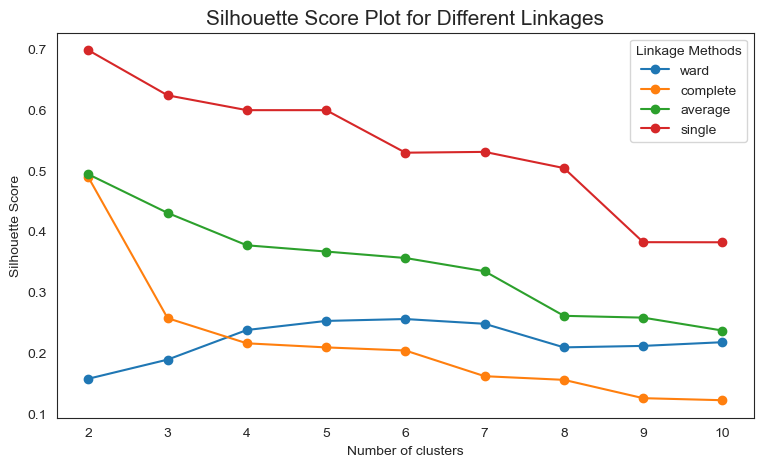

In [774]:
silhouette_scores = get_avg_silhouette_score_hierarchical(df_value_preference_perspective_fs, max_nclus=10, min_nclus=2)
plot_avg_silhouette_score_hierarchical(silhouette_scores, max_nclus=10, min_nclus=2)

output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/Hierarchical_clus_silhouette_score.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 

# Time to run: 13m 33.5 sec

In [775]:
pd.DataFrame(silhouette_scores, index=range(2, 11))

,ward,complete,average,single
2,0.157348,0.488696,0.493635,0.697715
3,0.188830,0.256967,0.430102,0.623518
4,0.237534,0.215621,0.376828,0.599127
5,0.252455,0.208895,0.366579,0.599139
6,0.255562,0.203800,0.355961,0.529172
7,0.247745,0.161527,0.334146,0.530490
8,0.208965,0.155527,0.260840,0.503880
9,0.211377,0.125390,0.257864,0.381979
10,0.217444,0.122020,0.236611,0.381824


> Based on the silhouette scores, the 'single' linkage method seems to perform the best for the given dataset and number of clusters. This indicates that the 'single' linkage method produces more cohesive and well-separated clusters. However, due to the nature of this linkage method, as we increase the number of clusters, this score tends to reduce as the normally elongated clusters are poorly separated.

> Based on the single linkage method, the optimal number of clusters is 2, which has the highest silhouette score (0.7).

Determine the best linkage method using the R^2 

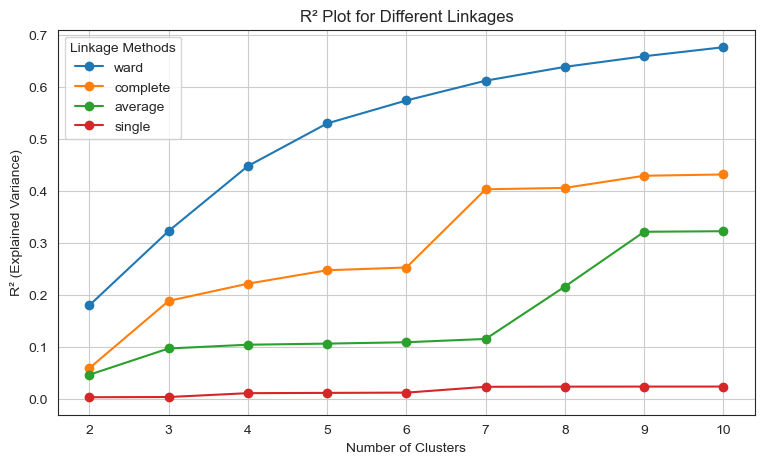

In [776]:
r2_values_hierarchical = get_r2_hierarchical(df_value_preference_perspective_fs, max_nclus=10, min_nclus=2)
plot_r2_hierarchical(r2_values_hierarchical, max_nclus=10, min_nclus=2)

# output_path = "/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/figures/Notebook_2/2_perspectives/value_pref_perspective/Hierarchical_clus_r2.png"
# plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
# plt.close() 

# Time to run: 9m 40.5s


In [777]:
pd.DataFrame(r2_values_hierarchical, index=range(2, 11))

,ward,complete,average,single
2,0.180273,0.059577,0.046967,0.003767
3,0.322932,0.188733,0.097389,0.004168
4,0.447755,0.221855,0.104620,0.011559
5,0.529649,0.247634,0.106741,0.012101
6,0.573764,0.252918,0.109354,0.012599
7,0.611721,0.403179,0.115704,0.023777
8,0.638283,0.405804,0.216307,0.024076
9,0.658635,0.429113,0.321553,0.024212
10,0.675998,0.431636,0.322612,0.024226


> As expected the best linkage method is ward as it is the linkage method used by default in the AglomreativeClustering class 

> Considering the ward as the best linkage method, the elbow point for the R^2 seems to be between 3-4 clusters

Determine the best linkage method using the Calinski and Harabasz score

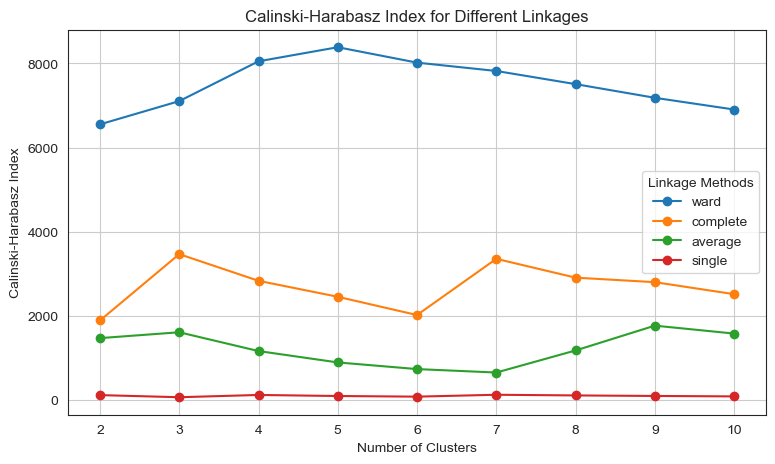

In [778]:
ch_scores_hierarchical = get_calinski_harabasz_scores_hierarchical(df_value_preference_perspective_fs, max_nclus=10, min_nclus=2)
plot_ch_index_hierarchical(ch_scores_hierarchical, max_nclus=10, min_nclus=2)

output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/Hierarchical_calinski_harabasz_scores.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 

# Time to run: 7m 40.6s


In [779]:
pd.DataFrame(ch_scores_hierarchical, index=range(2, 11))

,ward,complete,average,single
2,6551.345645,1887.218461,1468.109447,112.641203
3,7104.033363,3465.059791,1607.072954,62.344041
4,8050.617633,2830.919652,1160.188327,116.113309
5,8385.583232,2451.019457,889.858604,91.218490
6,8019.086063,2016.760599,731.425816,76.014333
7,7820.878541,3353.507430,649.528600,120.909929
8,7508.101943,2905.834932,1174.382298,104.967264
9,7182.975843,2798.331546,1764.474337,92.376469
10,6904.118904,2513.056520,1575.995956,82.157897


> Based on the Calinski-Habarasz index, the optimal linkage method is the ward method since it provides the highest scores for any number of clusters.

> Calinski-Habarasz index has the highest score for five clusers (8385) with four clusters having the second highest score (8050). Considering the trade off between complexity and interpretability and the small diference between the two, we will select 4 clusters based on the Calinski-Habarasz index

Based on the methods above, we will make the final decision on the best linkage method

| **Method**        | **Optimal linkage method and number of clusters (Silhouette) ** | **Optimal linkage method and number of clusters (R^2)** | **Optimal linkage method and number of clusters (Calinski-Harabasz)** | **Final Decision** |
|--------------------|-------------------------|----------------------------|-------------------|--------------------------------------------------------------------------------------------|
| Hierarchical CLustering     |            Single linkage,         |          Ward linkage         |    Ward Linkage,           |  Ward linkage |         

<br>

> We can conclude that the best linkage method is the ward linkage 

Deciding on the best number of clusters based on 4 different metrics:
1. Silhouette score
2. R^2
3. Calinski and Harabasz score
4. Dendrogram

Since we have already plotted the first three metrics above, we just need to plot the dendrogram.

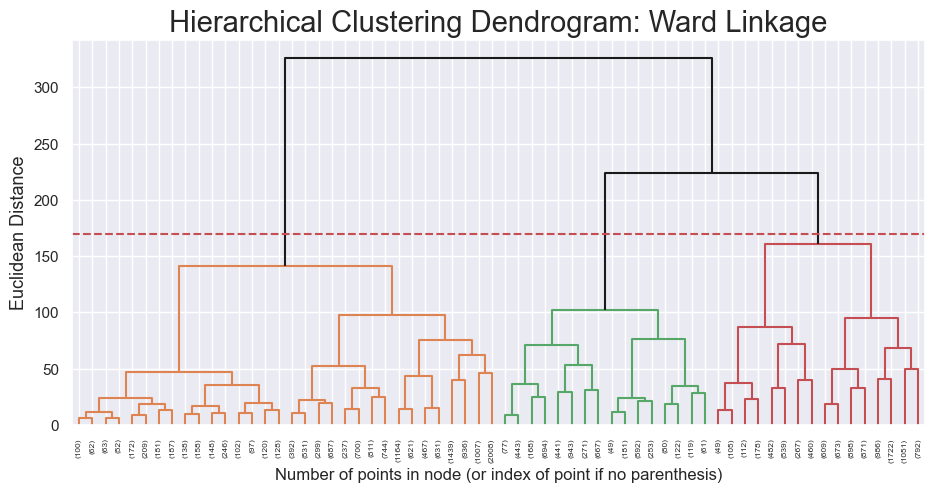

In [411]:
plot_hierarchical_dendrogram(df_value_preference_perspective_fs, method='ward', metric='euclidean', y_threshold=170, p=5)

> For the dendrogram, the final number of clusters is decided based on the following criteria: Avoid combining clusters if there’s a large "jump" in the height between successive merges.

> Based on that, we decided that the best trade-off was obtained with a final solution of four clusters and a Euclidean distance threshold defined at 130.

> Obtaining a solution with only three clusters would involve clustering clusters 3 and 4, which have a height difference of around 50 measurement units in Euclidean distance.

| **Method**        | **Optimal linkage method and number of clusters (Silhouette) ** | **Optimal linkage method and number of clusters (R^2)** | **Optimal linkage method and number of clusters (Calinski-Harabasz)** |  **Optimal linkage method and number of clusters (Dendogram)**  |**Final Decision** |
|--------------------|-------------------------|----------------------------|-------------------|--------------------------------------------------------------------------------------------|-------- |
| Hierarchical CLustering     |          3- 4 clusters           |         3-5 clusters               |    4 clusters            |  4 clusters     | 4   clusters 

> FInal decision is hierarhcical clustering with 4 clusters using Ward linkage

### 7.1.4 Two level approach - SOM + hierarchical clustering

> In Vesanto et al (2000), the following approach is proposed:

"The approach used in this paper (clustering of the SOM ratherthan clustering the data directly) is depicted in Fig. 2. First, a large set of prototypes—much larger than the expected number of clusters is formed using the SOM or some vector quantization algorithm. The prototypes can be interpreted as “protoclusters,” which are in the next step combined to form the actual clusters."

Following this approach we will start by build a SOM algorithm and reduce the 30k remaining observation to some number of Units. Then we will apply the Hierarchical clustering to cluster these BMU

> How to determine the grid size to create for SOM?

In (Rojas et al.), an empirical heuristic to determine size of grid is by doing 5* np.sqrt(N) with N being the total number of observations


#### **First level**: Selecting SOM map parameters to use before hierarhcical clustering/K means

> Based on the following two papers, we defined our stretegy to decide on what SOM parameters to define:
1. Clustering of the Self-Organizing Map  https://ieeexplore.ieee.org/stamp/stamp.jsp?tp=&arnumber=846731  ----> (Vesanto et al., 2000); In Vesanto et al (2000), 
2. A Survey and Implementation of Performance Metrics for Self-Organized Maps https://arxiv.org/pdf/2011.05847 -----> (Forest et al. 2020); In Forest et al (2020)

In Vesanto et al (2000), a two stage approached is suggested: Inital Rough training stage that quickly organizes the map to reflect the overall structure of the data by using a large neighborhood width and a high learning rate.Fine-Tunning stage where the details of the map are refined by using a small neighborhood width and a low learning rate, allowing the map to better fit local variations.

In Forest et al (2020) different performance metrics are suggested to measure the maps performance. From the different metrics suggested we will focus on internal indexes both on Clustering and topographic metrics also including some of the metrics used in our practical labs. Please find the metrics goign to be used to make final SOM parameters selection below
- **Quantization Error**: "Quantization error is the average error made by projecting data on the SOM, as measured by euclidean distance, i.e. the mean euclidean distance between a data sample and its best-matching unit:"
<br>

- **Topographic Error**: "assesses the self-organization of a SOM model. It is calculated as the fraction of samples whose best and second-best matching units are not neighbors on the map. In other words, this error
quantifies the smoothness of projections on the self-organized map."
<br>

<br>

> Based on the two stage approached and comparison metrics suggested we will do the following:

1. Try two variations of the 2-Phase SOM Training approach

| **Variation** | **Topology** | **Grid Size** | **Neighbourhood Function** | **Activation Distance** | **Phase 1 Parameters** | **Phase 2 Parameters** |
|---------------|--------------|---------------|----------------------------|-------------------------|------------------------|------------------------|
| **Variation 1** | Rectangular | 29x29 | Gaussian | Euclidean | - **Learning Rate**: 0.5 <br> - **Sigma**: 1.0 <br> - **Epochs**: 3 | - **Learning Rate**: 0.05 <br> - **Sigma**: 0.5 <br> - **Epochs**: 10 |
| **Variation 2** | Hexagonal | 29x29 | Gaussian | Euclidean | - **Learning Rate**: 0.3 <br> - **Sigma**: 1.5 (wider influence) <br> - **Epochs**: 5 | - **Learning Rate**: 0.1 <br> - **Sigma**: 0.7 <br> - **Epochs**: 12 |

<br>

2. Make final selection using the metrics defined above
 
| **Variation**     | **Quantization Error** | **Topographic Error** | 
|-------------------|------------------------|-----------------------|
| **Variation 1**   |                        |                       |              
| **Variation 2**   |                        |                       |                                          


Selection of grid size

As explained above we will use the empirical heuristic defined in Rojas et al. --> 5* np.sqrt(N) with N being the total number of observations

In [781]:
grid_size = 5*np.sqrt(df_value_preference_perspective_fs.shape[0])

M = int(np.sqrt(grid_size))
M

29

> As we can see, our grid size using the heuristic will be 29 by 29

Variation 1

| **Variation** | **Topology** | **Grid Size** | **Neighbourhood Function** | **Activation Distance** | **Phase 1 Parameters** | **Phase 2 Parameters** |
|---------------|--------------|---------------|----------------------------|-------------------------|------------------------|------------------------|
| **Variation 1** | Rectangular | 29x29 | Gaussian | Euclidean | - **Learning Rate**: 0.5 <br> - **Sigma**: 1.0 <br> - **Epochs**: 3 | - **Learning Rate**: 0.05 <br> - **Sigma**: 0.5 <br> - **Epochs**: 10 |

Training 

In [782]:
# Number of features
#input_len = df_spending_perspective.shape[1]  
input_len = df_value_preference_perspective_fs.shape[1]

# Grid size
grid_size = (29, 29)

# Initialize the SOM
som_var1 = MiniSom(x=grid_size[0], y=grid_size[1], input_len=input_len, sigma=1.0, 
              learning_rate=0.5, neighborhood_function='gaussian', 
              activation_distance='euclidean', random_seed=42)

# som_data = df_spending_perspective.values
som_data = df_value_preference_perspective_fs.values

# Initialize weights and start training
som_var1.random_weights_init(som_data)

# Rough Training Phase
som_var1.train_random(som_data, num_iteration=3 * len(som_data))  # 3 epochs

# Fine-Tuning Phase
som_var1.sigma, som_var1.learning_rate = 0.5, 0.05
som_var1.train_random(som_data, num_iteration=10 * len(som_data))  # 10 epochs


Variation 2
| **Variation** | **Topology** | **Grid Size** | **Neighbourhood Function** | **Activation Distance** | **Phase 1 Parameters** | **Phase 2 Parameters** |
|---------------|--------------|---------------|----------------------------|-------------------------|------------------------|------------------------|
| **Variation 2** | Hexagonal | 29x29 | Gaussian | Euclidean | - **Learning Rate**: 0.3 <br> - **Sigma**: 1.5 (wider influence) <br> - **Epochs**: 5 | - **Learning Rate**: 0.1 <br> - **Sigma**: 0.7 <br> - **Epochs**: 12 |

Training

In [783]:
# Number of features
# input_len = df_spending_perspective.shape[1]  
input_len = df_value_preference_perspective_fs.shape[1]  


# Grid size (29x29)
grid_size = (29, 29)

# Initialize the SOM
som_var2 = MiniSom(x=grid_size[0], y=grid_size[1], input_len=input_len, 
                   sigma=1.5, learning_rate=0.3, neighborhood_function='gaussian',
                   activation_distance='euclidean', random_seed=42)


# Initialize weights and start training
som_var2.random_weights_init(som_data)

# Rough Training Phase
som_var2.train_random(som_data, num_iteration=5 * len(som_data))  # 5 epochs

# Fine-Tuning Phase
som_var2.sigma = 0.7  # Reduced neighborhood size
som_var2.learning_rate = 0.1  # Reduced learning rate
som_var2.train_random(som_data, num_iteration=12 * len(som_data))  # 12 epochs

Compare the two variations and obtain final SOM paramaters

Obtaining metrics for the two SOM variations

In [784]:
# Metrics for Variation 1
qe_som_var1 = som_var1.quantization_error(som_data)
te_som_var1 = som_var1.topographic_error(som_data)

# Metrics for Variation 2
qe_som_var2 = som_var2.quantization_error(som_data)
te_som_var2 = som_var2.topographic_error(som_data)

# Create a DataFrame
results_df = pd.DataFrame({
    "Variation": ["Variation 1", "Variation 2"],
    "Quantization Error": [qe_som_var1, qe_som_var2],
    "Topographic Error": [te_som_var1, te_som_var2]
})
results_df

,Variation,Quantization Error,Topographic Error
0,Variation 1,0.198166,0.232311
1,Variation 2,0.232352,0.093716


> Topographic error 

1. Represents the ratio of data points for which the two best matching units are not neighbors on the map.
2. A low error indicates that the input space's neighborhood relationships are being well-preserved in the SOM hence indicating a better unfolding of the grid in a Self-Organizing Map
3. Focuses on evaluating the quality of grid unfolding (topology)

<br>

> Quantization error
1. Represents the average error made by projecting data on the SOM, as measured by euclidean distance,
2. Measures how well the neurons approximate the input data
3. Focuses on evaluating the quality of representation (accuracy)

<br>

> Final selection - variation 2

1. Based on the results, **Variation 2** seems better overall because it has a significantly lower Topographic Error (close to less 14p.p). This suggests a better unfolding of the SOM grid.
2. The slight increase in Quantization Error for Variation 2 (around 0.03) is acceptable, given the improved grid quality.
3. With this final selection for the SOM to use we can conclude thae following:
    - TE of around 0.09 means that 9% of the input data points have their two closest neurons not being neighbors on the SOM grid
    - QE of 0.23 means that, on average, each data point is 0.23 units away (in Euclidean distance) from its closest neuron on the SOM grid.

Analyzing SOM variation 2

Auxiliary functions

In [785]:
# --------------------------------- Common Helper Function ---------------------------------
def plot_hexagons(som, ax, matrix_vals, colornorm, label, cmap, annot=False):
    """
    Helper function to plot hexagonal grid values for a trained SOM.

    Parameters:
    - som: Trained MiniSom object.
    - ax: Matplotlib axis to plot on.
    - matrix_vals: Matrix values to display on the hexagonal grid.
    - colornorm: Matplotlib color normalization object.
    - label: Title for the plot.
    - cmap: Colormap for the hexagonal grid.
    - annot: Boolean flag to annotate grid cells with their values (default: False).
    """
    for i in range(matrix_vals.shape[0]):
        for j in range(matrix_vals.shape[1]):
            wx, wy = som.convert_map_to_euclidean((i, j))
            hexagon = RegularPolygon((wx, wy), 
                                     numVertices=6, 
                                     radius=np.sqrt(1/3),
                                     facecolor=cmap(colornorm(matrix_vals[i, j])),
                                     edgecolor='white',
                                     linewidth=0.5)
            ax.add_patch(hexagon)
            if annot:
                annot_val = np.round(matrix_vals[i, j], 2)
                ax.text(wx, wy, annot_val, ha='center', va='center', fontsize='x-small')
    ax.margins(0.05)
    ax.set_aspect('equal')
    ax.axis("off")
    ax.set_title(label, fontsize=12)


# --------------------------------- Component Planes ---------------------------------
def plot_component_planes(som, df, cmap=cm.Purples, figsize=(12, 12), col_sz=4):
    """
    Plots the component planes of a trained SOM using numerical features of a DataFrame.

    Parameters:
    - som: Trained MiniSom object.
    - df: Pandas DataFrame containing the numerical features.
    - cmap: Colormap to use (default: Purples).
    - figsize: Tuple for figure size (default: (12, 12)).
    - col_sz: Number of columns in the grid layout (default: 4).
    """
    # Ensure DataFrame has only numerical features
    df_numeric = df.select_dtypes(include=[np.number])
    metric_features = df_numeric.columns.tolist()

    # Retrieve SOM weights
    weights = som.get_weights()
    n_features = weights.shape[2]

    # Determine rows and columns for subplots
    n_rows = int(np.ceil(n_features / col_sz))

    # Setup figure
    fig, axes = plt.subplots(n_rows, col_sz, figsize=figsize, constrained_layout=True, dpi=128)
    axes = axes.flatten()

    for idx, feature in enumerate(metric_features):
        matrix_vals = weights[:, :, idx]
        colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))

        # Plot each component plane
        plot_hexagons(som, axes[idx], matrix_vals, colornorm, label=feature, cmap=cmap)

        # Add colorbar
        divider = make_axes_locatable(axes[idx])
        ax_cb = divider.append_axes("right", size="5%", pad="2%")
        cmap_sm = plt.cm.ScalarMappable(cmap=cmap, norm=colornorm)
        plt.colorbar(cmap_sm, cax=ax_cb)

    # Turn off unused axes
    for ax in axes[len(metric_features):]:
        ax.axis("off")

    plt.suptitle("Component Planes", fontsize=20)
    plt.show()


# --------------------------------- U-Matrix ---------------------------------
def plot_umatrix(som, figsize=(8, 8), cmap=cm.RdYlBu_r, annot=False):
    """
    Plots the U-Matrix (Unified Distance Matrix) of a trained SOM.
    """
    umatrix = som.distance_map(scaling='mean')
    fig, ax = plt.subplots(figsize=figsize, constrained_layout=True, dpi=128)
    colornorm = mpl_colors.Normalize(vmin=np.min(umatrix), vmax=np.max(umatrix))
    plot_hexagons(som, ax, umatrix, colornorm, label="U-Matrix", cmap=cmap, annot=annot)
    
    # Add colorbar
    divider = make_axes_locatable(ax)
    ax_cb = divider.append_axes("right", size="5%", pad="2%")
    cmap_sm = plt.cm.ScalarMappable(cmap=cmap, norm=colornorm)
    plt.colorbar(cmap_sm, cax=ax_cb)
    plt.show()


# --------------------------------- Hit-Map ---------------------------------
def plot_hit_map(som, df, cmap=cm.Greens, figsize=(8, 6), annot=True):
    """
    Plots the Hit-Map (Activation Response) of a trained SOM using the input DataFrame.

    Parameters:
    - som: Trained MiniSom object.
    - df: Pandas DataFrame containing input data (numerical features only).
    - cmap: Colormap to use for visualization (default: Greens).
    - figsize: Tuple for figure size (default: (8, 6)).
    - annot: Boolean flag to annotate hit counts (default: True).
    """
    # Ensure DataFrame has only numerical features
    df_numeric = df.select_dtypes(include=[np.number])
    data = df_numeric.values
    
    # Compute hit matrix (activation response)
    hits_matrix = som.activation_response(data)
    
    # Round hit counts to integers
    hits_matrix = np.round(hits_matrix).astype(int)
    
    # Normalize color scale
    colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hits_matrix))
    
    # Setup plot
    fig, ax = plt.subplots(figsize=figsize, constrained_layout=True, dpi=128)
    
    # Plot hexagons
    plot_hexagons(
        som, 
        ax, 
        hits_matrix, 
        colornorm, 
        label="SOM Hits Map", 
        cmap=cmap, 
        annot=annot
    )
    
    # Add colorbar
    divider = make_axes_locatable(ax)
    ax_cb = divider.append_axes("right", size="5%", pad="2%")
    cmap_sm = plt.cm.ScalarMappable(cmap=cmap, norm=colornorm)
    plt.colorbar(cmap_sm, cax=ax_cb)
    plt.show()


Component Planes

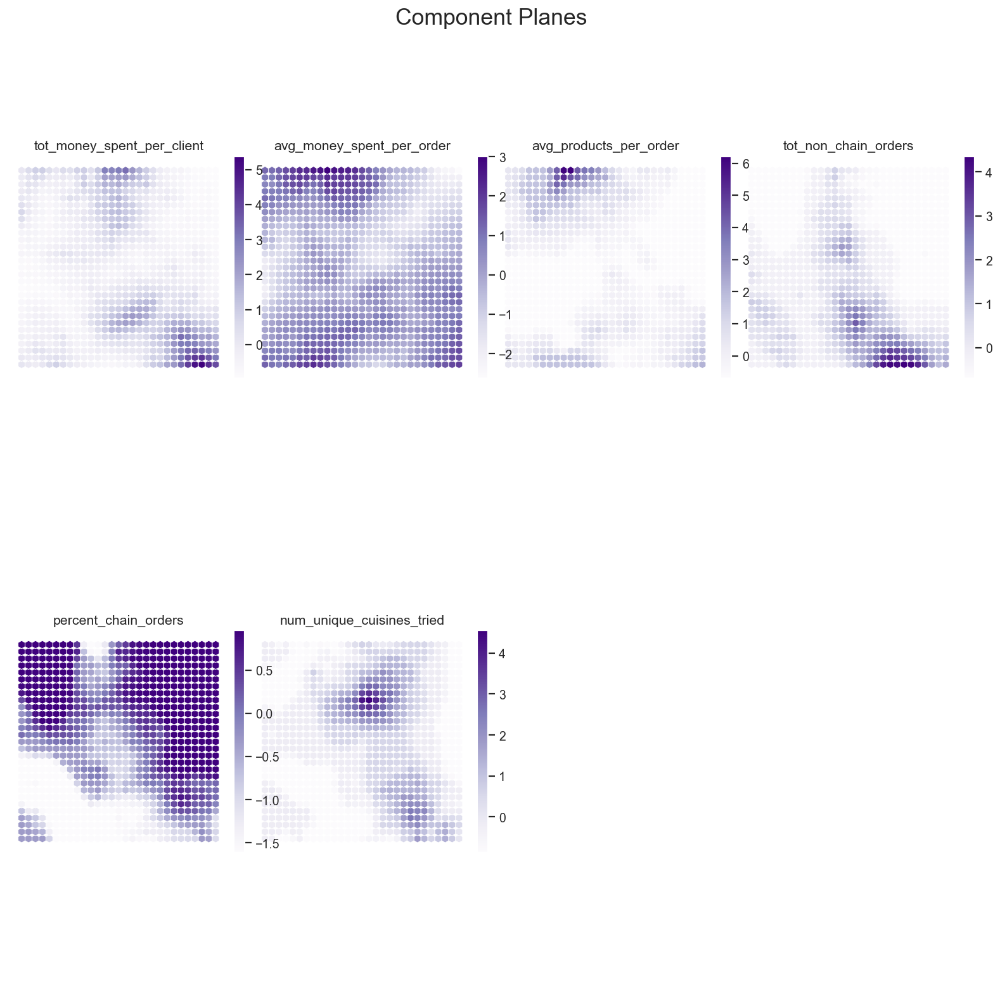

In [786]:
# plot_component_planes(som_var2, df_spending_perspective)
plot_component_planes(som_var2, df_value_preference_perspective_fs)

Key takeaways

> First remarks

1. Since we have scaled the features using Standard Scaler, we can only pay attention to the magnitude and not the values themselves.

> Feature Importance

1. To understand feature importance based on the component planes, we can attempt to identify features that are able to separate different regions of units.
2. Percent_chain_orders seems to be an important feature in separating the observations since it highlights three different regions: two of these regions with moderate to high values in percent chain orders in the top left and top right-hand corners, highlighting groups of clients that have a preference towards chain restaurants, and a region in the bottom left-hand corner where clients prefer non-chain orders.
3. Avg_money_spent_per_order also seems to be able to highlight different regions successfully with three (top left-hand corner, right bottom corner, and bottom left-hand corner) regions having clients with high average money spent per order and then two regions with lower average money spent per order (middle left and top right-hand corner).
4. num_unique_cuisines_tried, tot_money_spent_per_client, and tot_non_chain_orders seem to be less successful in separating different regions, only being able to differentiate 2-3 smaller unique regions.
5. avg_products_per_order seems to be the least important feature based on component planes as it seems to have a big region with clients that order an average small amount of products per order and then a group of clients in the top middle that order a higher amount.

> Analyze distributions and relationships between features

1. Clients with higher total money spent seem to correspond to clients that have a higher average money spent per order. Then, depending on the region of higher money spent per client, they can have a preference for non-chain or chain restaurants and a lower or higher average number of products purchased in each order. Moreover, all correspond with clients with a lower number of unique cuisines tried.
2. Most clients with higher average money spent per order have a low average number of products purchased in each order.
3. Clients with a higher preference for chain orders vary in regards to the average money spent per order. Some tend to spend more on average while others do not.

> Analyze outliers

1. Analyzing the outliers using the component planes involves identifying regions that deviate significantly from the surrounding neurons.
2. Percent_chain_orders seem to have some outliers in the bottom left-hand corner.
3. tot_money_spent, avg_products_per_order, and tot_non_chain_orders also seem to have some outliers.
4. To confirm the existence of outliers, we will use the Hit-Map.

U-matrix

1. Each neuron is assigned a value that represents the average distance to its neighboring neurons in the output space (grid)

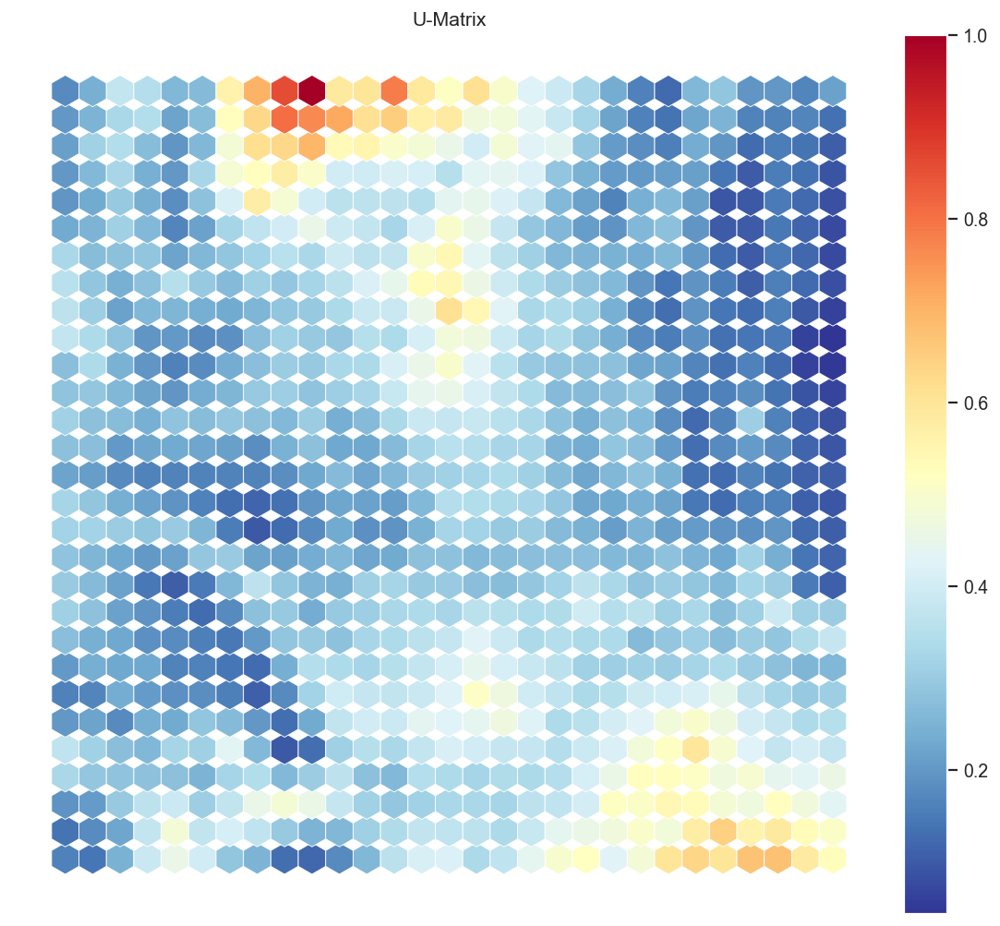

In [787]:
plot_umatrix(som_var2)

> Based on the U-Matrix, we will analyze the existence of possible outliers and clusters in the data.

1. Regarding the clustering, it seems we can identify 2 clear regions: one in the top right-hand corner and another in the top to middle left-hand corner separated by lighter units.
2. Regarding the outliers, we seem to have two regions that might represent outliers: bottom right-hand corner and top middle center to top middle left. These will need to be analyzed further using the hit map.

<br>

> Key notes

1. Based on the U-Matrix, it's clear that creating a final solution with more than 3 to 4 clusters will be very hard due to the lack of clear separation between the clusters.
2. Some outliers may still remain even after the outlier detection and removal process already implemented in the data preprocessing.


Hit-map
1. Represents the number of observations assigned to each neuron (or unit) in the SOM grid
2. Dense areas → Many data points are similar and map to the same neuron (regions of high concentration).
3. Sparse areas → Few or no data points map there, indicating outliers


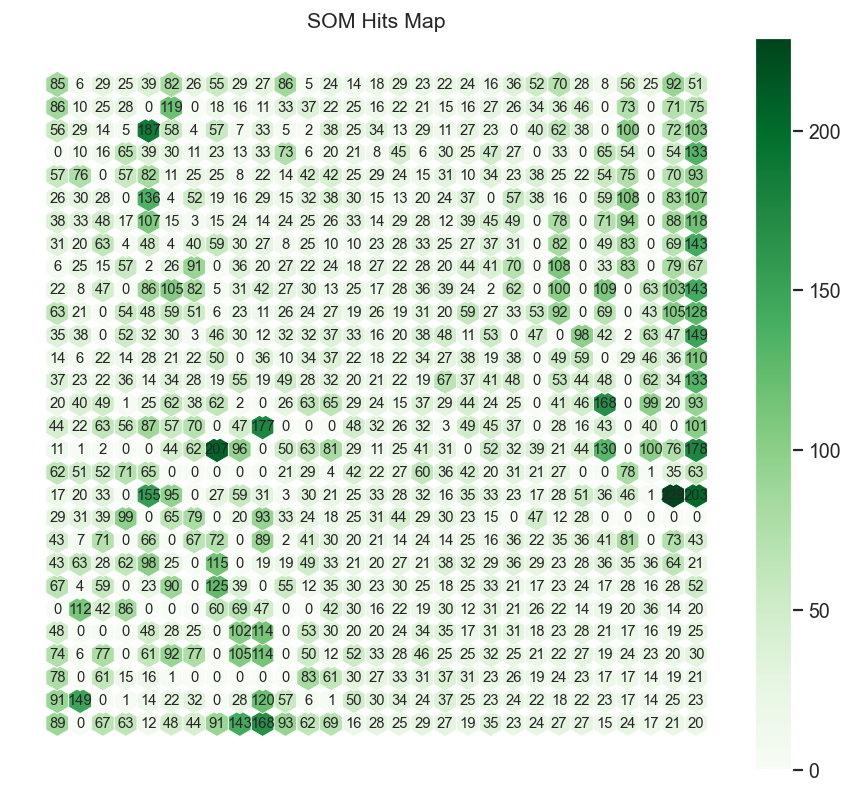

In [788]:
plot_hit_map(som_var2, df_value_preference_perspective_fs)

Notes: Based on the hit map, we will try to identify different clusters based on the density of each region and identify potential existing outliers.

> Density-based analysis

1. When analyzing the density of different regions, we can identify that the top and middle right regions have a higher density of points, potentially forming a cluster.
2. The left bottom side of the map also represents a high-density region, potentially forming another cluster.
3. The bottom right side of the map represents a low-density region.

> Cluster analysis

1. Based on the density of the regions and the U-matrix analysis, we can identify 2 potential outlier regions:
    - The bottom right-hand corner and top middle center to top middle left regions, besides having higher average distances to their neighboring units, also have lower densities.
    - In any case, after having applied our outlier removal strategy, we will not do any additional outlier treatment and will consider them a relevant part of the data variability.

#### **Second level with Hierachical Clustering**: Combining the prototypes obtained using the som_var2

1. After making final selection on the paramaters to build the SOM, now we will apply the second stage and combine prototype sinto the final clusters using **Hierarchical Clustering**

In [789]:
prototypes_var2 = som_var2.get_weights().reshape(M*M, input_len)
prototypes_var2.shape

(841, 6)

In [790]:
feature_names = [f"feature_{i}" for i in range(prototypes_var2.shape[1])]
prototypes_var2 = pd.DataFrame(prototypes_var2, columns=feature_names)

Determine the best linkage method and optimal number of clusters using the Silhoette score 

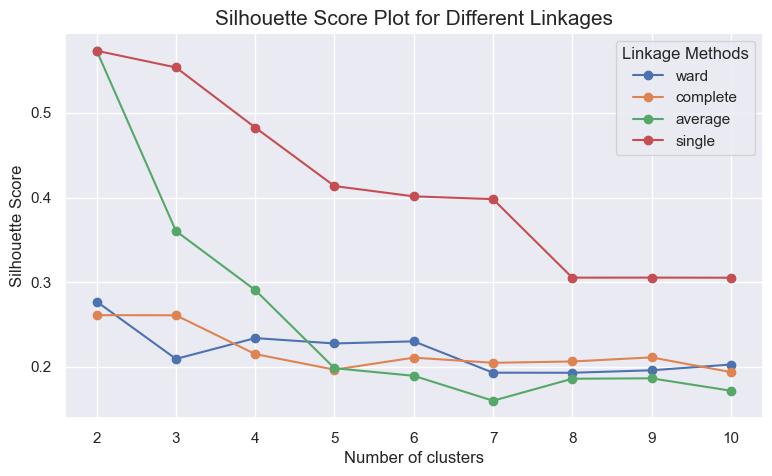

In [791]:
silhouette_scores_som_hierarchical = get_avg_silhouette_score_hierarchical(prototypes_var2, max_nclus=10, min_nclus=2)
plot_avg_silhouette_score_hierarchical(silhouette_scores_som_hierarchical, max_nclus=10, min_nclus=2)

# output_path = "/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/figures/Notebook_2/2_perspectives/value_pref_perspective/Hierarchical_SOM_clus_silhouette_score.png"
# plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
# plt.close() 


> As expected, the single linkage is the best for the silhouette score.

> However, since we are expecting the ward linkage to be the best overall, we will analyze the optimal number of clusters for this linkage method.

> For the ward linkage, the optimal number of clusters is 2, with the second best being 4.

Determine the best linkage method using the R^2 

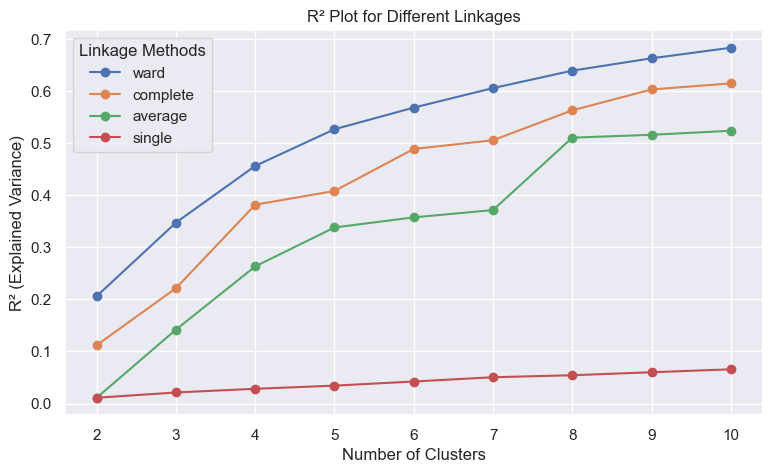

In [792]:
r2_values_SOM_hierarchical = get_r2_hierarchical(prototypes_var2, max_nclus=10, min_nclus=2)
plot_r2_hierarchical(r2_values_SOM_hierarchical, max_nclus=10, min_nclus=2)

output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_Hierarchical_clus_r2.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 

# Time to run: 9m 40.5s


> For the R^2 metric, the ward linkage as the best performance.

> COnsidering the elbow point the optimal number of clusters seems to be between 3 and 4

Determine the best linkage method using the Calinski and Harabasz score

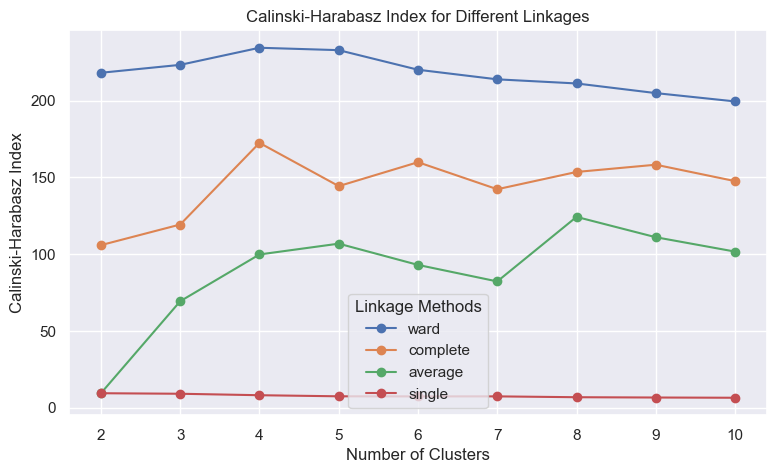

In [793]:
ch_scores_som_hierarchical = get_calinski_harabasz_scores_hierarchical(prototypes_var2, max_nclus=10, min_nclus=2)
plot_ch_index_hierarchical(ch_scores_som_hierarchical, max_nclus=10, min_nclus=2)

# output_path = "/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_Hierarchical_calinski_harabasz_scores.png"
# plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
# plt.close() 


> Considering the initial obtained values for the Calinski Harabasz index for the K means and hierachical clustering without SOM these values should be concerning

> We will investigate them further

> In any case the highest score is obtained with 4 clusters for the ward linkage method

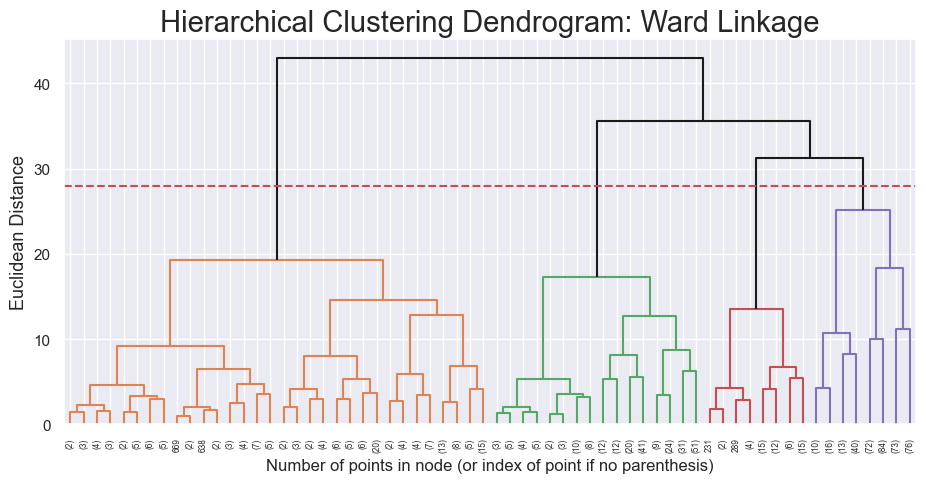

In [794]:
plot_hierarchical_dendrogram(prototypes_var2, method='ward', metric='euclidean', y_threshold=28, p=5)

> Based on the dendogram we will select 4 clusters

| **Method**        | **Optimal linkage method and number of clusters (Silhouette) ** | **Optimal linkage method and number of clusters (R^2)** | **Optimal linkage method and number of clusters (Calinski-Harabasz)** |  **Optimal linkage method and number of clusters (Dendogram)**  |**Final Decision** |
|--------------------|-------------------------|----------------------------|-------------------|--------------------------------------------------------------------------------------------|-------- |
| Hierarchical CLustering     |          2 or 4 clusters           |         3-4 clusters               |    4 clusters            |  4 clusters     | 4   clusters 

#### **Second level with K Means**: 


Determining the best K using Inertia

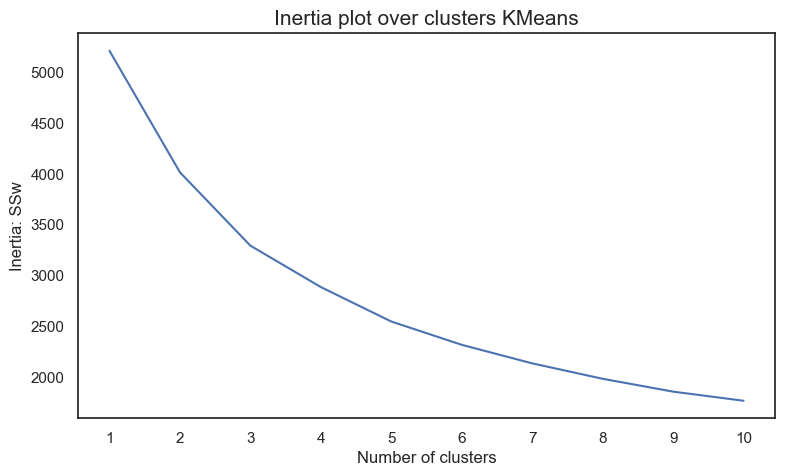

In [398]:
inertia_values_som_kmeans = get_kmeans_inertia(prototypes_var2, 10, 1)
plot_kmeans_inertia(inertia_values_som_kmeans, 10,1)

output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_K_means_inertia.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 

Based on the inertia plot and the elbow method, the optimal number of clusters is 2 or 4

Determine the best K using the silhouette score

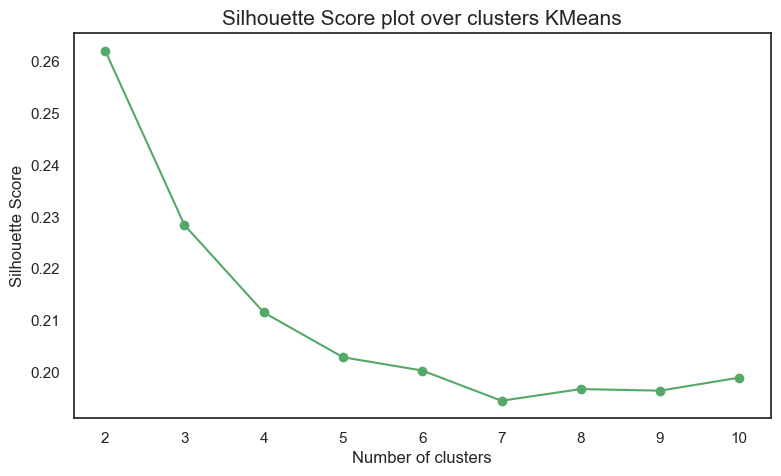

In [395]:
silhouette_scores_som_kmeans = get_avg_silhouette_score(prototypes_var2, 10, 1)

plot_avg_silhouette_score(silhouette_scores_som_kmeans, 10, 1)
# output_path = "/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_K_means_silhouette_scores.png"
# plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
# plt.close() 

Based on the silhouette score, the optimal number of clusters is either 3, 4, or 5, obtaining almost equal highest silhouette scores.

In [797]:
silhouette_scores_som_kmeans

[0.2663018746551459,
 0.2773117519503208,
 0.2775739883928083,
 0.276704040625745,
 0.2581007513233382,
 0.25739823920261695,
 0.24562563946533394,
 0.24808977057147835,
 0.24181028386695513]

Determine the best K using the R^2

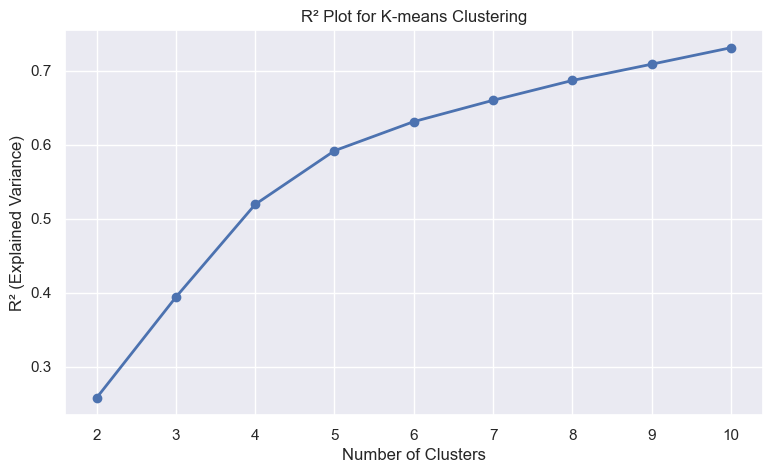

In [798]:
r2_values_som_kmeans = get_r2_kmeans(prototypes_var2, max_nclus=10, min_nclus=2)
plot_r2_kmeans(r2_values_som_kmeans, max_nclus=10, min_nclus=2)

output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_K_means_R^2.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 


Based on the R2 elbow point method, the optimall number of clusters is 4.

In [799]:
r2_values_som_kmeans

[0.25801953745857403,
 0.39408095109198477,
 0.5192985437528226,
 0.591774080032105,
 0.6310904060177985,
 0.659900047677828,
 0.6866627199853687,
 0.7086352486731715,
 0.7309011137512235]

Determine the best K using the Calinski and Harabasz score

Source and example used from https://scikit-learn.org/stable/modules/generated/sklearn.metrics.calinski_harabasz_score.html

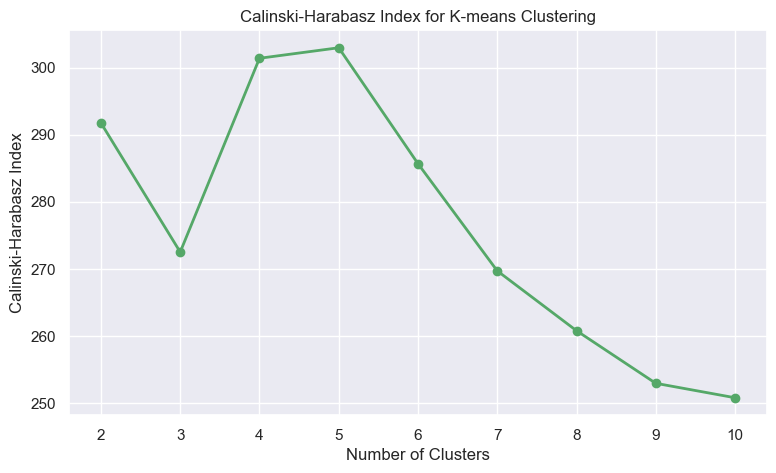

In [800]:
ch_scores_som_kmeans = get_calinski_harabasz_scores(prototypes_var2, max_nclus=10, min_nclus=2)
plot_ch_index(ch_scores_som_kmeans, max_nclus=10, min_nclus=2)

# output_path = "/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_K_means_calinski_harabasz_scores.png"
# plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
# plt.close() 

> Based on the calinski_harabasz_score, the best number of clusters is 5 followed by 4. 

> Considering the tradeoff between the increase in score and complexity resulted with increase of clusters we woudl select four clusters based on this metric

Deciding on the optimal K value for SOM +K means

| **Method**        | **Optimal K (Inertia)** | **Optimal K (Silhouette)** | **Optimal K (R²)** | **Optimal K (Calinski-Harabasz)** | **Final Decision** |
|--------------------|-------------------------|----------------------------|-------------------|----------------------------------|--------------------|
| K-Means            |            2 or 4       |            3-5          |    4               |        4 or 5                 |          4         |


### 7.1.5 Final model selection

> So far we have trained and evaluated individually four algorithms/approaches:

1. Kmeans
2. Hierarchical Clustering
3. SOM + Hierarchical Clustering
4. SOM + Kmeans

> We will now compare the results of the four approaches and select the best one based on the following metrics:

1. Silhouette Score
2. R^2
3. Calinski-Harabasz Index


Auxiliary function

In [801]:
def compare_clustering_algorithms(metrics, algorithms = ['KMeans', 'Hierarchical', 'SOM + Hierarchical', 'SOM + KMeans'], metric_names = ['Silhouette Score', 'R^2', 'Calinski-Harabasz Index']):
    """
    Creates a DataFrame comparing clustering algorithms based on metrics.

    Parameters:
    - metrics: A list of lists containing the metric values for each algorithm.
               Each inner list should have the values in the same order as `metric_names`.
    - algorithms: A list of names for the algorithms being compared (e.g., 'KMeans', 'Hierarchical').
    - metric_names: A list of names for the metrics (e.g., 'Silhouette Score', 'R^2', 'Calinski-Harabasz Index').

    Returns:
    - A pandas DataFrame comparing the clustering algorithms based on the metrics.
    """
    comparison_df = pd.DataFrame(metrics, columns=metric_names, index=algorithms)
    return comparison_df

Training K means with 3 clusters

In [802]:
kmeans_3 = KMeans(n_clusters=3, init='k-means++', n_init=20, random_state=2024)
kmeans_3_labels_value_preference_perspective = kmeans_3.fit_predict(df_value_preference_perspective_fs)

# Metrics for K means with 3 clusters
k_means_3_silhouette_value_preference_perspective = silhouette_score(df_value_preference_perspective_fs, kmeans_3_labels_value_preference_perspective)
k_means_3_r2_value_preference_perspective = get_r2(df_value_preference_perspective_fs, kmeans_3_labels_value_preference_perspective)
k_means_3_calinski_value_preference_perspective = calinski_harabasz_score(df_value_preference_perspective_fs, kmeans_3_labels_value_preference_perspective)



In [803]:
k_means_3_metrics_value_preference_perspective = [k_means_3_silhouette_value_preference_perspective, k_means_3_r2_value_preference_perspective, k_means_3_calinski_value_preference_perspective]

Training Hierarchical clustering with four clusters and ward linkage

In [804]:
hclust_4= AgglomerativeClustering(n_clusters=4, linkage='ward', metric='euclidean')
hc_4_labels_value_preference_perspective = hclust_4.fit_predict(df_value_preference_perspective_fs)


# Metrics for Hierarchical clustering with 4 clusters
hc_silhouette_4_value_preference_perspective = silhouette_score(df_value_preference_perspective_fs, hc_4_labels_value_preference_perspective)
hc_r2_4_value_preference_perspective = get_r2(df_value_preference_perspective_fs, hc_4_labels_value_preference_perspective)
hc_calinski_4_value_preference_perspective = calinski_harabasz_score(df_value_preference_perspective_fs, hc_4_labels_value_preference_perspective)



In [805]:
hc_4_metrics_value_preference_perspective = [hc_silhouette_4_value_preference_perspective, hc_r2_4_value_preference_perspective, hc_calinski_4_value_preference_perspective]

Training the SOM + Kmeans (3 clusters)

In [806]:
kmeans_3_som_labels_value_preference_perspective = kmeans_3.fit_predict(prototypes_var2)

#Metrics for SOM + K means with 3 clusters
k_means_3_som_silhouette_value_preference_perspective  = silhouette_score(prototypes_var2, kmeans_3_som_labels_value_preference_perspective)
k_means_3_som_r2_value_preference_perspective  = get_r2(prototypes_var2, kmeans_3_som_labels_value_preference_perspective)
k_means_3_som_calinski_value_preference_perspective = calinski_harabasz_score(prototypes_var2, kmeans_3_som_labels_value_preference_perspective)


In [807]:
k_means_3_som_metrics_value_preference_perspective = [k_means_3_som_silhouette_value_preference_perspective, k_means_3_som_r2_value_preference_perspective, k_means_3_som_calinski_value_preference_perspective]


Training the SOM + Hierarchical Clustering (4 clusters)

In [808]:
hc_4_som_labels_value_preference_perspective = hclust_4.fit_predict(prototypes_var2)

#Metrics for SOM + Hierarchical clustering with 4 clusters
hc_4_som_silhouette_value_preference_perspective = silhouette_score(prototypes_var2, hc_4_som_labels_value_preference_perspective)
hc_4_som_r2_value_preference_perspective = get_r2(prototypes_var2, hc_4_som_labels_value_preference_perspective)
hc_4_som_calinski_value_preference_perspective = calinski_harabasz_score(prototypes_var2, hc_4_som_labels_value_preference_perspective)




In [809]:
hc_4_som_metrics_value_preference_perspective = [hc_4_som_silhouette_value_preference_perspective, hc_4_som_r2_value_preference_perspective, hc_4_som_calinski_value_preference_perspective]

Final comparison

In [810]:
final_metrics = [k_means_3_metrics_value_preference_perspective, k_means_3_som_metrics_value_preference_perspective, hc_4_metrics_value_preference_perspective, hc_4_som_metrics_value_preference_perspective]
algorithms = ['KMeans (3 clust)', 'SOM + KMeans (3 clust)', 'Hierarchical (4 clust)', 'SOM + Hierarchical (4 clust)']
metric_names = ['Silhouette Score', 'R^2', 'Calinski-Harabasz Index']

final_comparison_df = compare_clustering_algorithms(final_metrics, algorithms, metric_names)
final_comparison_df

,Silhouette Score,R^2,Calinski-Harabasz Index
KMeans (3 clust),0.289893,0.398149,9853.331639
SOM + KMeans (3 clust),0.277312,0.394209,272.657789
Hierarchical (4 clust),0.237534,0.447755,8050.617633
SOM + Hierarchical (4 clust),0.233969,0.456557,234.393722


Key notes

> Based on these results we should choose K means with 3 clusters


---

## 7.2 Activity and Engagement Perspective

In [814]:
df_clustering.columns

Index(['customer_age', 'vendor_count', 'product_count', 'tot_chain_orders',
       'first_order', 'last_order', 'tot_orders_per_client',
       'tot_money_spent_per_client', 'num_unique_cuisines_tried',
       'peak_days_num_orders', 'off_peak_days_num_orders',
       'morning_num_orders', 'afternoon_num_orders', 'evening_num_orders',
       'night_num_orders', 'avg_money_spent_per_order',
       'avg_products_per_order', 'tot_non_chain_orders',
       'percent_chain_orders'],
      dtype='object')

In [815]:
df_activity_engagement_perspective = df_clustering[["first_order", "last_order", "tot_orders_per_client", "peak_days_num_orders", "off_peak_days_num_orders", "morning_num_orders", "afternoon_num_orders", "evening_num_orders", "night_num_orders"]]

### 7.2.1 Feature Selection

Using the Spearman Correlation coefficient

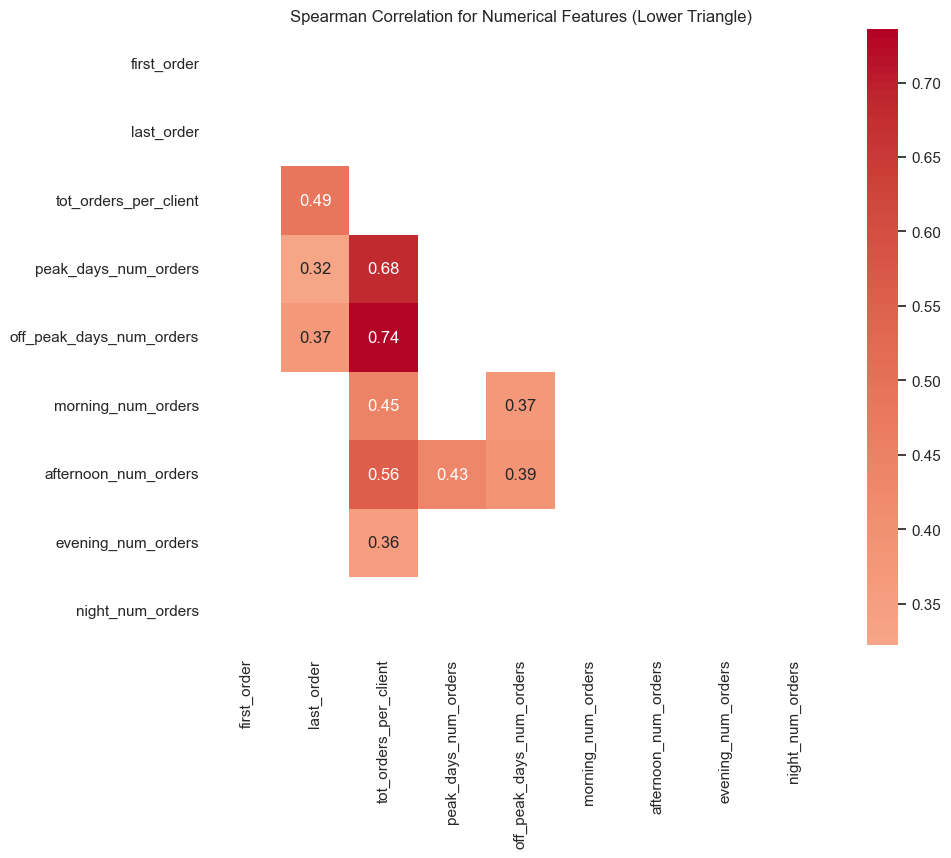

In [393]:
# Calculate Spearman correlation
cor_spearman = df_activity_engagement_perspective.corr(method='spearman')

# Mask the upper triangle
mask = np.triu(np.ones_like(cor_spearman, dtype=bool))

# Mask values below or equal to 0.3
cor_masked = cor_spearman.where(cor_spearman > 0.3)

# Apply the upper triangle mask
plt.figure(figsize=(10, 8))
sns.heatmap(
    cor_masked, 
    annot=True, 
    cmap='coolwarm', 
    center=0, 
    cbar=True, 
    fmt=".2f", 
    square=True, 
    mask=mask
)
plt.title("Spearman Correlation for Numerical Features (Lower Triangle)")
plt.show()


Key notes

> Total orders per client

1. Total orders per client is highly correlated with the number of orders made on peak days and off-peak days. This is expected as the total number of orders per client is the sum of the orders made on peak and off-peak days.
2. Total orders per client is also moderately correlated with the number of orders made in the morning, afternoon, evening, and night. This is also expected as the total number of orders per client is the sum of the orders made at different times of the day.
3. Hence, we should consider dropping this feature.



Using the component planes of SOM with small gridsize

> Highlight potentially important features by trying to idnetify features able to differentiate different regions

> Uncover potentially redundant features by trying to identify uniformly colored planes which indicates low variability and suggest redundancy.

In [817]:
# Number of features
# input_len = df_spending_perspective.shape[1]  
input_len = df_activity_engagement_perspective.shape[1]  


# Grid size (29x29)
grid_size = (15, 15)

# Initialize the SOM
som_activity_engage_fe = MiniSom(x=grid_size[0], y=grid_size[1], input_len=input_len, 
                   sigma=1.5, learning_rate=0.3, neighborhood_function='gaussian',
                   activation_distance='euclidean', random_seed=42)

som_data = df_activity_engagement_perspective.values

# Initialize weights and start training
som_activity_engage_fe.random_weights_init(som_data)

# Rough Training Phase
som_activity_engage_fe.train_random(som_data, num_iteration=5 * len(som_data))  # 5 epochs

# Fine-Tuning Phase
som_activity_engage_fe.sigma = 0.7  # Reduced neighborhood size
som_activity_engage_fe.learning_rate = 0.1  # Reduced learning rate
som_activity_engage_fe.train_random(som_data, num_iteration=12 * len(som_data))  # 12 epochs


Component planes

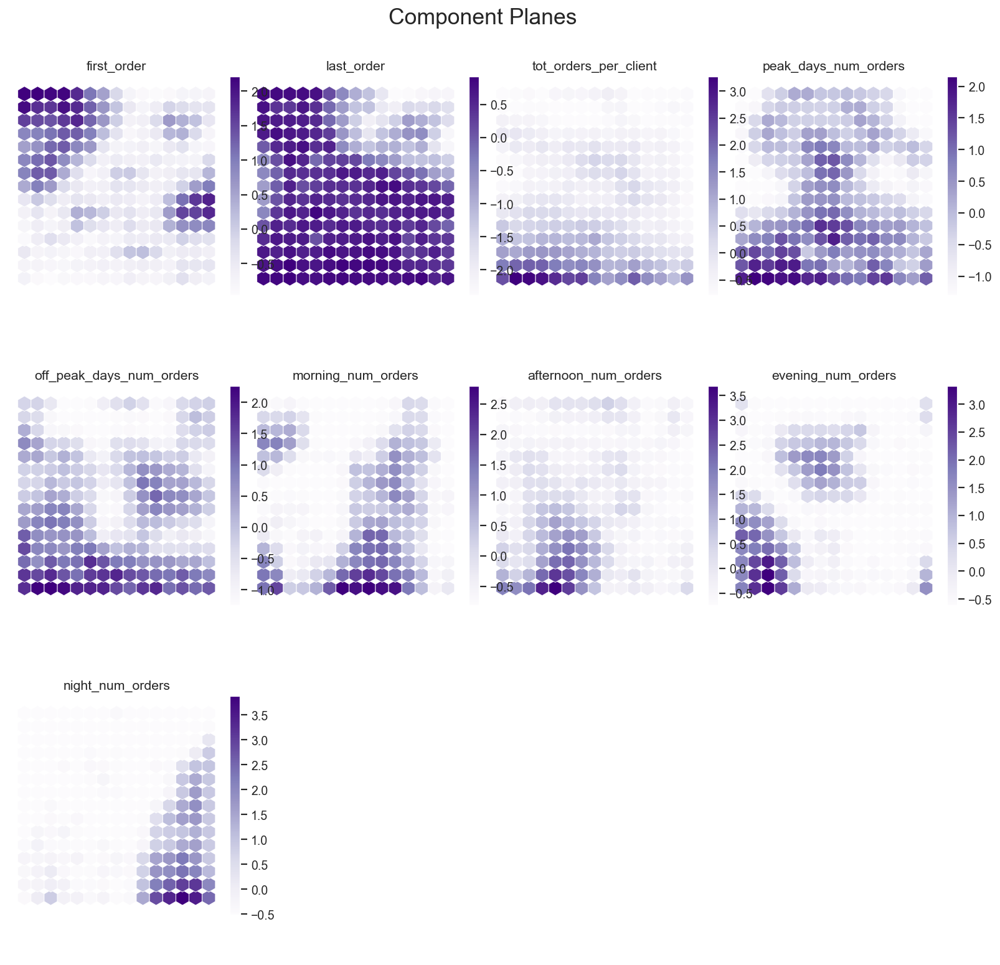

In [818]:
plot_component_planes(som_activity_engage_fe, df_activity_engagement_perspective)

Key notes

> Redudant features

1. last_order and tot_order_per_client seem to be redudant features by having uniformly coloured planes and having highly spearman correlation with other features
2. For last order high values are prevalent across all matching units and for tot_orders_per_client low values are prevalent across all matching units
3. Regarding first_order, we decided to also drop it. Firstly, the feature's corresponding plane has mostly has a uniformly coloured plane with the execption of the top left hand corner and middle right area having higher values. Secondly, its business insight provided is low as it only indicates the timing of a client’s first purchase, offering limited value for actionable insights

> Conclusion

Based on the analysis of the Spearman and component planes we will drop the following features:
- tot_orders_per_client
- last_order
- first_order


In [819]:
df_activity_engagement_perspective_fs = df_activity_engagement_perspective[["first_order", "peak_days_num_orders", "off_peak_days_num_orders", "morning_num_orders", "afternoon_num_orders", "evening_num_orders", "night_num_orders"]]

In [833]:
df_activity_engagement_perspective_fs = df_activity_engagement_perspective_fs.drop(columns=["first_order"])

In [834]:
df_activity_engagement_perspective_fs.columns

Index(['peak_days_num_orders', 'off_peak_days_num_orders',
       'morning_num_orders', 'afternoon_num_orders', 'evening_num_orders',
       'night_num_orders'],
      dtype='object')

---

### 7.2.2 K-Means Clustering

Determining the best K using Inertia

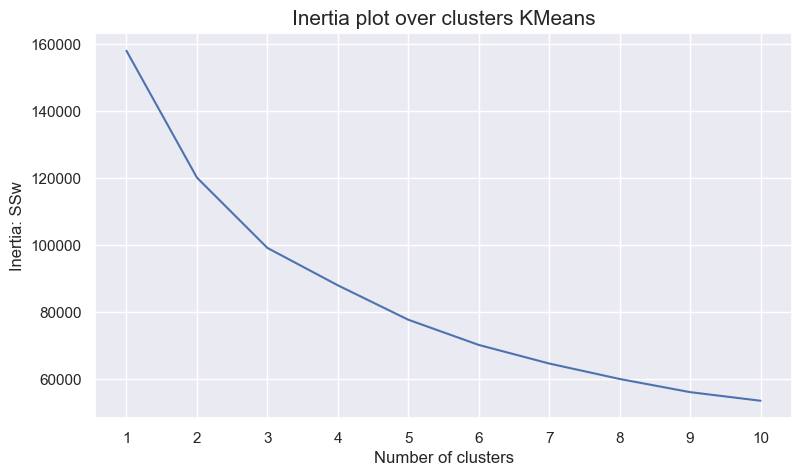

In [835]:
inertia_values = get_kmeans_inertia(df_activity_engagement_perspective_fs, 10, 1)
plot_kmeans_inertia(inertia_values, 10,1)

output_path = "figures/Notebook_2/2_perspectives/activity_engag_perspective/K_means_inertia.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 


> Based on the Inertia plot and the elbow method, the optimal number of clusters is 3.

Determine the best K using the silhouette score

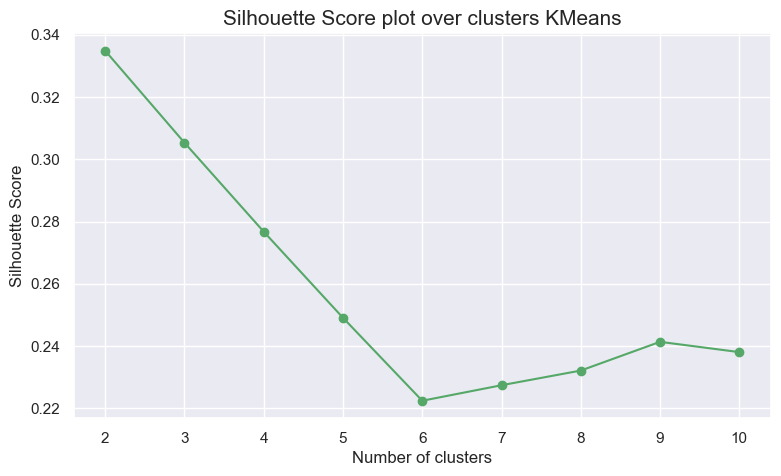

In [836]:
silhouette_scores = get_avg_silhouette_score(df_activity_engagement_perspective_fs, 10, 1)
plot_avg_silhouette_score(silhouette_scores, 10, 1)

# output_path = "/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/figures/Notebook_2/2_perspectives/activity_engag_perspective/K_means_silhouette_scores.png"
# plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
# plt.close() 

Key notes

> Silhouette score decreasing as the number of clusters increases

1. As we can see, adding more clusters to the K-means algorithm from 2-6 clusters always reduces the silhouette score. This is a very notable result.
2. If data is well separated, as we increase the number of clusters, the distances between points within a cluster (a) tend to decrease, while the distances between points in different clusters (b) tend to increase.
3. However, if the data is not well separated, as the number of clusters increases, the distances between points in different clusters (b) might decrease due to overlapping, causing the silhouette score to decrease as the number of clusters increases.

> Optimal number of clusters

1. The optimal number of clusters is 2 since it has the highest silhouette score, followed by 3 clusters.

Determine the best K using the R^2

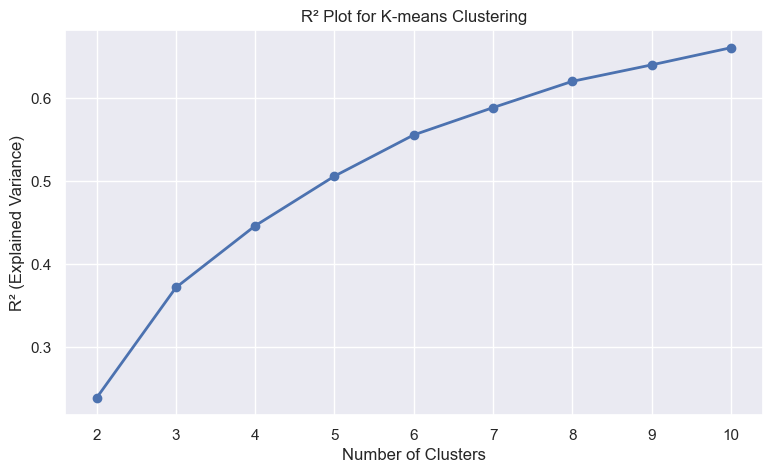

In [837]:
r2_values = get_r2_kmeans(df_activity_engagement_perspective_fs, max_nclus=10, min_nclus=2)
plot_r2_kmeans(r2_values, max_nclus=10, min_nclus=2)

output_path = "figures/Notebook_2/2_perspectives/activity_engag_perspective/K_means_R^2.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 


> Based on the R^2 score, the **optimal number of clusters is 3** being the elbow point in the plot.

> The R^2 measures the total variance in the dataset explained by the clustering solution and increases as the number of clusters increases.

> In this case, we need to consider the tradeoff between increasing the explained variance by the clustering solution and the increase in complexity.

> A clustering solution of 2 clusters would result in a simpler model only being able to explain less than 20% of the variance in the dataset. A clustering solution of 4 adds more complexity while not increasing sufficiently the explained variance.

Determine the best K using the Calinski and Harabasz score

Source and example used from https://scikit-learn.org/stable/modules/generated/sklearn.metrics.calinski_harabasz_score.html

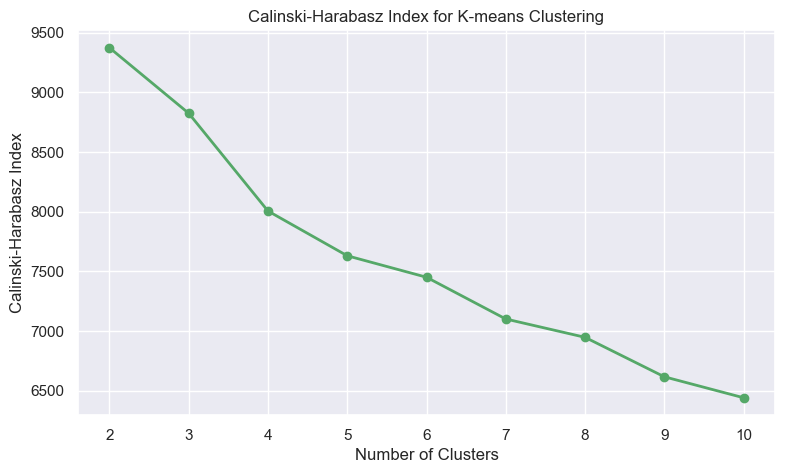

In [838]:
ch_scores = get_calinski_harabasz_scores(df_activity_engagement_perspective_fs, max_nclus=10, min_nclus=2)
plot_ch_index(ch_scores, max_nclus=10, min_nclus=2)

# output_path = "/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/figures/Notebook_2/2_perspectives/activity_engag_perspective/K_means_calinski_harabasz_scores.png"
# plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
# plt.close() 

> Based on the calinski_harabasz_score the **optimal number of clusters is 2** achieving the highest score followed by 3 clusters.

> Important to highlitght that instead of the score increasing as the number of clusters increases, the score reduces. This means that instead of the clusters becoming more compact and well-separated as the number of clusters increases, the opoosite is happneing

> This means that as we increase the number of clusters they tend to overlap

Deciding on the optimal K value for K means

| **Method**        | **Optimal K (Inertia)** | **Optimal K (Silhouette)** | **Optimal K (R²)** | **Optimal K (Calinski-Harabasz)** | **Final Decision** |
|--------------------|-------------------------|----------------------------|-------------------|----------------------------------|--------------------|
| K-Means            |            2-3      |            2          |    3               |                2         |          3     |


Despite the optimal number of clusters being 2 for both the silheote and Calinski-Harabasz scores and being part of the potential elbow point for inertia, a solution with 3 clusters for Kmeans was prefereed. This decision was made considering the very low value for R^2 with only 2 clusters.


### 7.2.3 Hierarchical Clustering

Determine the best linkage method and optimal number of clusters using the Silhoette score 

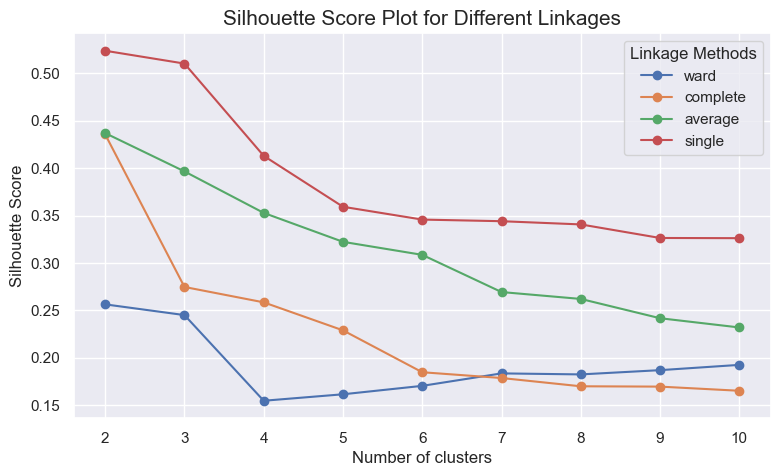

In [839]:
silhouette_scores = get_avg_silhouette_score_hierarchical(df_activity_engagement_perspective_fs, max_nclus=10, min_nclus=2)
plot_avg_silhouette_score_hierarchical(silhouette_scores, max_nclus=10, min_nclus=2)

output_path = "figures/Notebook_2/2_perspectives/activity_engag_perspective/Hierarchical_clus_silhouette_score.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 

# Time to run: 

> Despite single linkage being the best linkage method for achieving a higher silhouette_score, the analysis focus will be on the ward linkage since we know from the previous analysis that this will be the best overall linkage method

> The **optimal number of clusters is 2** achieving the highest silhouette_score followed by 3 clusters

> Important to note that the difference in silheote score between 2 and 3 clusters is not significant

Determine the best linkage method using the R^2 

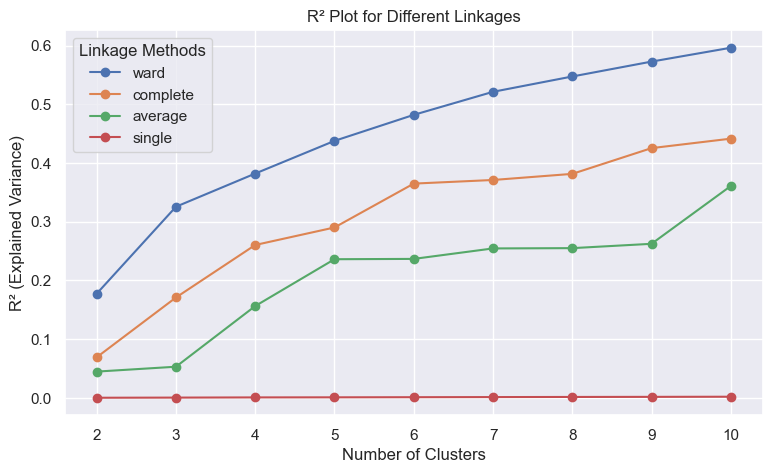

In [840]:
r2_values_hierarchical = get_r2_hierarchical(df_activity_engagement_perspective_fs, max_nclus=10, min_nclus=2)
plot_r2_hierarchical(r2_values_hierarchical, max_nclus=10, min_nclus=2)

# output_path = "/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/figures/Notebook_2/2_perspectives/activity_engag_perspective/Hierarchical_clus_r2.png"
# plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
# plt.close() 

# Time to run: 9m 40.5s


> Based on the results the elbow point is at 3 clusters. 

> This would mean that our best solution considering the tradeoff between complexity and explained variance is around 30%

Determine the best linkage method using the Calinski and Harabasz score

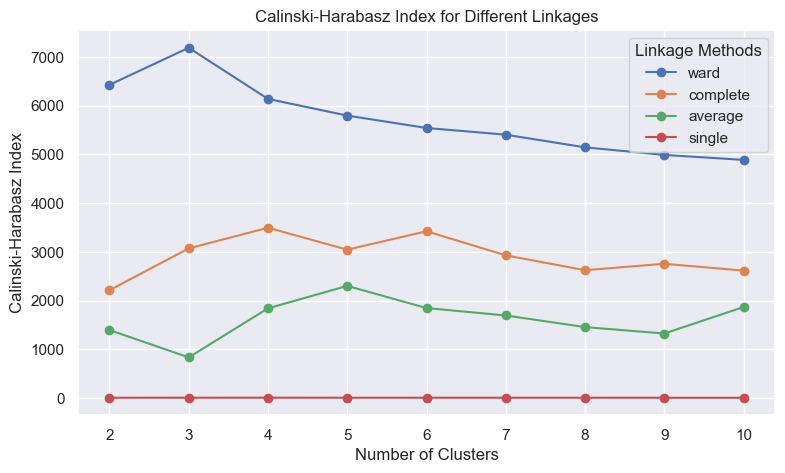

In [841]:
ch_scores_hierarchical = get_calinski_harabasz_scores_hierarchical(df_activity_engagement_perspective_fs, max_nclus=10, min_nclus=2)
plot_ch_index_hierarchical(ch_scores_hierarchical, max_nclus=10, min_nclus=2)

output_path = "figures/Notebook_2/2_perspectives/activity_engag_perspective/Hierarchical_calinski_harabasz_scores.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 

# Time to run: 7m 40.6s


> Based on the Calinski-Harabasz Index, the optimal number of clusters is 3.

> This means that the best solution between compactness and separation of clusters is achieved with 3 clusters.

Deciding on the best number of clusters based on 4 different metrics:
1. Silhouette score
2. R²
3. Calinski and Harabasz score
4. Dendrogram

Since we have already plotted the first three metrics above, we just need to plot the dendrogram.

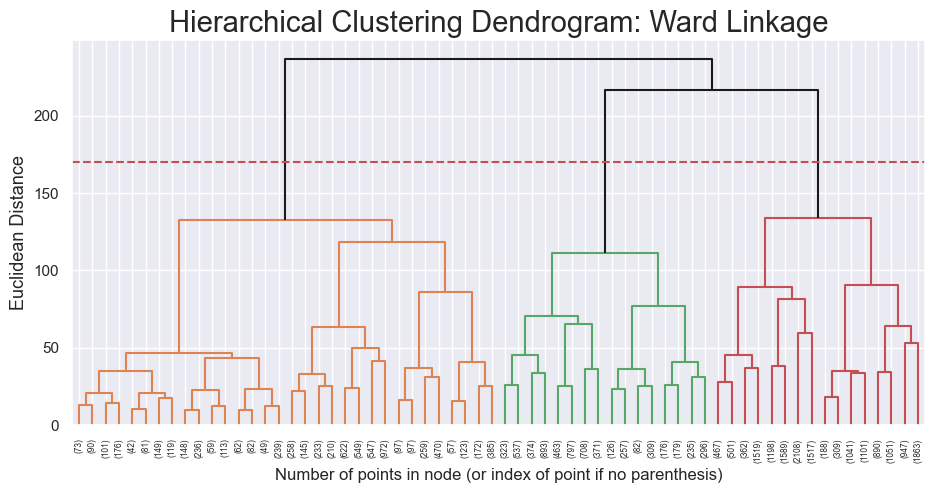

In [842]:
plot_hierarchical_dendrogram(df_activity_engagement_perspective_fs, method='ward', metric='euclidean', y_threshold=170, p=5)

> Based on the dendogram, it's clear that the optimal number of clusters is 3. 

> This can be seen since the distance/dissimilariy between cluster 2 and 3 and joining into cluster 2 is quite large

| **Method**        | **Optimal linkage method and number of clusters (Silhouette) ** | **Optimal linkage method and number of clusters (R^2)** | **Optimal linkage method and number of clusters (Calinski-Harabasz)** |  **Optimal linkage method and number of clusters (Dendogram)**  |**Final Decision** |
|--------------------|-------------------------|----------------------------|-------------------|--------------------------------------------------------------------------------------------|-------- |
| Hierarchical CLustering     |          2 clusters           |         3 clusters               |    3 clusters            |  3 clusters     | 3  clusters 


<br>


> Final decision for hierarchical clustering is clearly using ward linkage method with 3 clusters.

> The only metric that supported using 2 clusters only is the silheote score and even then the score with clusters was very similar

---

### 7.2.4 Two level approach - SOM + hierarchical clustering


#### **First level**: Selecting SOM map parameters to use before hierarhcical clustering/K means

> Based on the following two papers, we defined our stretegy to decide on what SOM parameters to define:
1. Clustering of the Self-Organizing Map  https://ieeexplore.ieee.org/stamp/stamp.jsp?tp=&arnumber=846731  ----> (Vesanto et al., 2000); In Vesanto et al (2000), 
2. A Survey and Implementation of Performance Metrics for Self-Organized Maps https://arxiv.org/pdf/2011.05847 -----> (Forest et al. 2020); In Forest et al (2020)

In Vesanto et al (2000), a two stage approached is suggested: Inital Rough training stage that quickly organizes the map to reflect the overall structure of the data by using a large neighborhood width and a high learning rate.Fine-Tunning stage where the details of the map are refined by using a small neighborhood width and a low learning rate, allowing the map to better fit local variations.

In Forest et al (2020) different performance metrics are suggested to measure the maps performance. From the different metrics suggested we will focus on internal indexes both on Clustering and topographic metrics also including some of the metrics used in our practical labs. Please find the metrics goign to be used to make final SOM parameters selection below
- **Quantization Error**: "Quantization error is the average error made by projecting data on the SOM, as measured by euclidean distance, i.e. the mean euclidean distance between a data sample and its best-matching unit:"
<br>

- **Topographic Error**: "assesses the self-organization of a SOM model. It is calculated as the fraction of samples whose best and second-best matching units are not neighbors on the map. In other words, this error
quantifies the smoothness of projections on the self-organized map."
<br>

<br>

> Based on the two stage approached and comparison metrics suggested we will do the following:

1. Try two variations of the 2-Phase SOM Training approach

| **Variation** | **Topology** | **Grid Size** | **Neighbourhood Function** | **Activation Distance** | **Phase 1 Parameters** | **Phase 2 Parameters** |
|---------------|--------------|---------------|----------------------------|-------------------------|------------------------|------------------------|
| **Variation 1** | Rectangular | 29x29 | Gaussian | Euclidean | - **Learning Rate**: 0.5 <br> - **Sigma**: 1.0 <br> - **Epochs**: 3 | - **Learning Rate**: 0.05 <br> - **Sigma**: 0.5 <br> - **Epochs**: 10 |
| **Variation 2** | Hexagonal | 29x29 | Gaussian | Euclidean | - **Learning Rate**: 0.3 <br> - **Sigma**: 1.5 (wider influence) <br> - **Epochs**: 5 | - **Learning Rate**: 0.1 <br> - **Sigma**: 0.7 <br> - **Epochs**: 12 |

<br>

2. Make final selection using the metrics defined above
 
| **Variation**     | **Quantization Error** | **Topographic Error** | 
|-------------------|------------------------|-----------------------|
| **Variation 1**   |                        |                       |              
| **Variation 2**   |                        |                       |                                          


Selection of grid size

As explained above we will use the empirical heuristic defined in Rojas et al. --> 5* np.sqrt(N) with N being the total number of observations

In [843]:
grid_size = 5*np.sqrt(df_activity_engagement_perspective_fs.shape[0])

M = int(np.sqrt(grid_size))
M

29

> As we can see, our grid size using the heuristic will be 29 by 29

Variation 1

| **Variation** | **Topology** | **Grid Size** | **Neighbourhood Function** | **Activation Distance** | **Phase 1 Parameters** | **Phase 2 Parameters** |
|---------------|--------------|---------------|----------------------------|-------------------------|------------------------|------------------------|
| **Variation 1** | Rectangular | 29x29 | Gaussian | Euclidean | - **Learning Rate**: 0.5 <br> - **Sigma**: 1.0 <br> - **Epochs**: 3 | - **Learning Rate**: 0.05 <br> - **Sigma**: 0.5 <br> - **Epochs**: 10 |

Training 

In [844]:
# Number of features
#input_len = df_spending_perspective.shape[1]  
input_len = df_activity_engagement_perspective_fs.shape[1]

# Grid size
grid_size = (29, 29)

# Initialize the SOM
som_var1 = MiniSom(x=grid_size[0], y=grid_size[1], input_len=input_len, sigma=1.0, 
              learning_rate=0.5, neighborhood_function='gaussian', 
              activation_distance='euclidean', random_seed=42)

# som_data = df_spending_perspective.values
som_data = df_activity_engagement_perspective_fs.values

# Initialize weights and start training
som_var1.random_weights_init(som_data)

# Rough Training Phase
som_var1.train_random(som_data, num_iteration=3 * len(som_data))  # 3 epochs

# Fine-Tuning Phase
som_var1.sigma, som_var1.learning_rate = 0.5, 0.05
som_var1.train_random(som_data, num_iteration=10 * len(som_data))  # 10 epochs


Variation 2
| **Variation** | **Topology** | **Grid Size** | **Neighbourhood Function** | **Activation Distance** | **Phase 1 Parameters** | **Phase 2 Parameters** |
|---------------|--------------|---------------|----------------------------|-------------------------|------------------------|------------------------|
| **Variation 2** | Hexagonal | 29x29 | Gaussian | Euclidean | - **Learning Rate**: 0.3 <br> - **Sigma**: 1.5 (wider influence) <br> - **Epochs**: 5 | - **Learning Rate**: 0.1 <br> - **Sigma**: 0.7 <br> - **Epochs**: 12 |

Training

In [845]:
# Number of features
# input_len = df_spending_perspective.shape[1]  
input_len = df_activity_engagement_perspective_fs.shape[1]  


# Grid size (29x29)
grid_size = (29, 29)

# Initialize the SOM
som_var2 = MiniSom(x=grid_size[0], y=grid_size[1], input_len=input_len, 
                   sigma=1.5, learning_rate=0.3, neighborhood_function='gaussian',
                   activation_distance='euclidean', random_seed=42)


# Initialize weights and start training
som_var2.random_weights_init(som_data)

# Rough Training Phase
som_var2.train_random(som_data, num_iteration=5 * len(som_data))  # 5 epochs

# Fine-Tuning Phase
som_var2.sigma = 0.7  # Reduced neighborhood size
som_var2.learning_rate = 0.1  # Reduced learning rate
som_var2.train_random(som_data, num_iteration=12 * len(som_data))  # 12 epochs

Compare the two variations and obtain final SOM paramaters

Obtaining metrics for the two SOM variations

In [846]:
# Metrics for Variation 1
qe_som_var1 = som_var1.quantization_error(som_data)
te_som_var1 = som_var1.topographic_error(som_data)

# Metrics for Variation 2
qe_som_var2 = som_var2.quantization_error(som_data)
te_som_var2 = som_var2.topographic_error(som_data)

# Create a DataFrame
results_df = pd.DataFrame({
    "Variation": ["Variation 1", "Variation 2"],
    "Quantization Error": [qe_som_var1, qe_som_var2],
    "Topographic Error": [te_som_var1, te_som_var2]
})
results_df

/opt/anaconda3/lib/python3.12/site-packages/minisom.py:631: RuntimeWarning: invalid value encountered in sqrt
  return sqrt(-2 * cross_term + input_data_sq + weights_flat_sq.T)


,Variation,Quantization Error,Topographic Error
0,Variation 1,0.146090,0.237681
1,Variation 2,0.188792,0.058237


> Topographic error 

1. Represents the ratio of data points for which the two best matching units are not neighbors on the map.
2. A low error indicates that the input space's neighborhood relationships are being well-preserved in the SOM hence indicating a better unfolding of the grid in a Self-Organizing Map
3. Focuses on evaluating the quality of grid unfolding (topology)

<br>

> Quantization error
1. Represents the average error made by projecting data on the SOM, as measured by euclidean distance,
2. Measures how well the neurons approximate the input data
3. Focuses on evaluating the quality of representation (accuracy)

<br>

> Final selection - variation 2

1. Based on the results, **Variation 2** seems better overall because it has a significantly lower Topographic Error (close to less 20p.p). This suggests a better unfolding of the SOM grid.
2. The slight increase in Quantization Error for Variation 2 (around 0.04) is acceptable, given the improved grid quality.
3. With this final selection for the SOM to use we can conclude thae following:
    - TE of around 0.06 means that 6% of the input data points have their two closest neurons not being neighbors on the SOM grid
    - QE of 0.19 means that, on average, each data point is 0.19 units away (in Euclidean distance) from its closest neuron on the SOM grid.

Analyzing SOM variation 2 (variation winner)

Component Planes

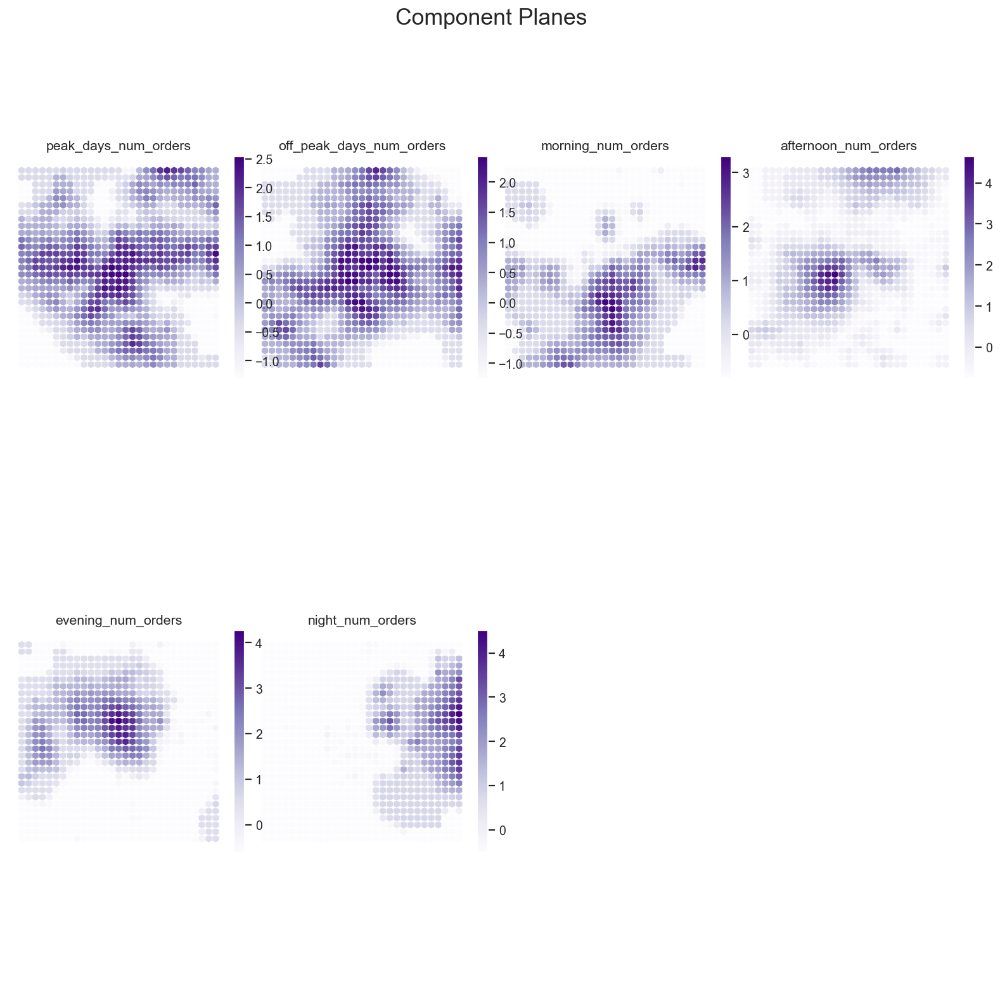

In [847]:
# plot_component_planes(som_var2, df_spending_perspective)
plot_component_planes(som_var2, df_activity_engagement_perspective_fs)

Key takeaways

> First remarks

1. Since we have scaled the features using Standard Scaler, we can only pay attention to the magnitude and not the values themselves.

> Feature Importance

1. Features related to the time of day of orders seem to be the most important for the clustering of the customers in the activity and engagement perspective, being able to better separate different regions of the component planes.

2. Features related to the preference for the type of restaurant seem to be less important for the clustering of the customers since they both seem to have dense unique regions of customers with high values for both.

3. Regarding the features related to the time of day number of orders, morning_num_orders seem to highlight 3 different regions: 1) Middle region with clients that make a lot of orders in the mornings, a region of clients that tend to make a middle tier amount of orders in the top left-hand side, and a region of clients in the top middle to top right and bottom right-hand corner that tend to make very few orders in the morning.

4. Regarding afternoon number of orders, there seem to be 3 regions: in the middle, a region with clients with a bigger amount of orders made during the afternoon. A top region where clients with a medium volume of afternoon orders and then a bottom region with clients that tend to make very few orders during the afternoon.

5. Regarding the number of orders made during the evening and the number of orders made during the night, there seem to be 2 clear distinct regions: one for clients with high volume orders and another for low volumes of orders. Despite not being as clear, we can also identify regions for medium volume clients surrounding the higher volume clients.

> Analyze distributions and relationships between features 

1. Relationship between morning_num_orders and afternoon number of orders:
- It seems like most clients with a high volume of morning orders correspond to low volume afternoon orders.
- This could be related to some clients preferring to have lunch sooner, ending up making fewer afternoon orders.

2. Relationship between afternoon number of orders and night number of orders:
- Clients with a high volume of afternoon orders tend to have low volume night orders.

3. Relationship between evening number of orders and night number of orders:
- Clients with high volume night orders tend to have a low volume of evening orders, which makes sense. Clients who order in the evening have perhaps made their last order of the day and won't make another order during the night.

4. Relationship between the number of orders made during off-peak days of the week and night number of orders:
- Clients with high volume night orders tend to also be high volume for off-peak days purchasing (Monday, Tuesday, Wednesday, and Sunday).


U-matrix

1. Each neuron is assigned a value that represents the average distance to its neighboring neurons in the output space (grid)

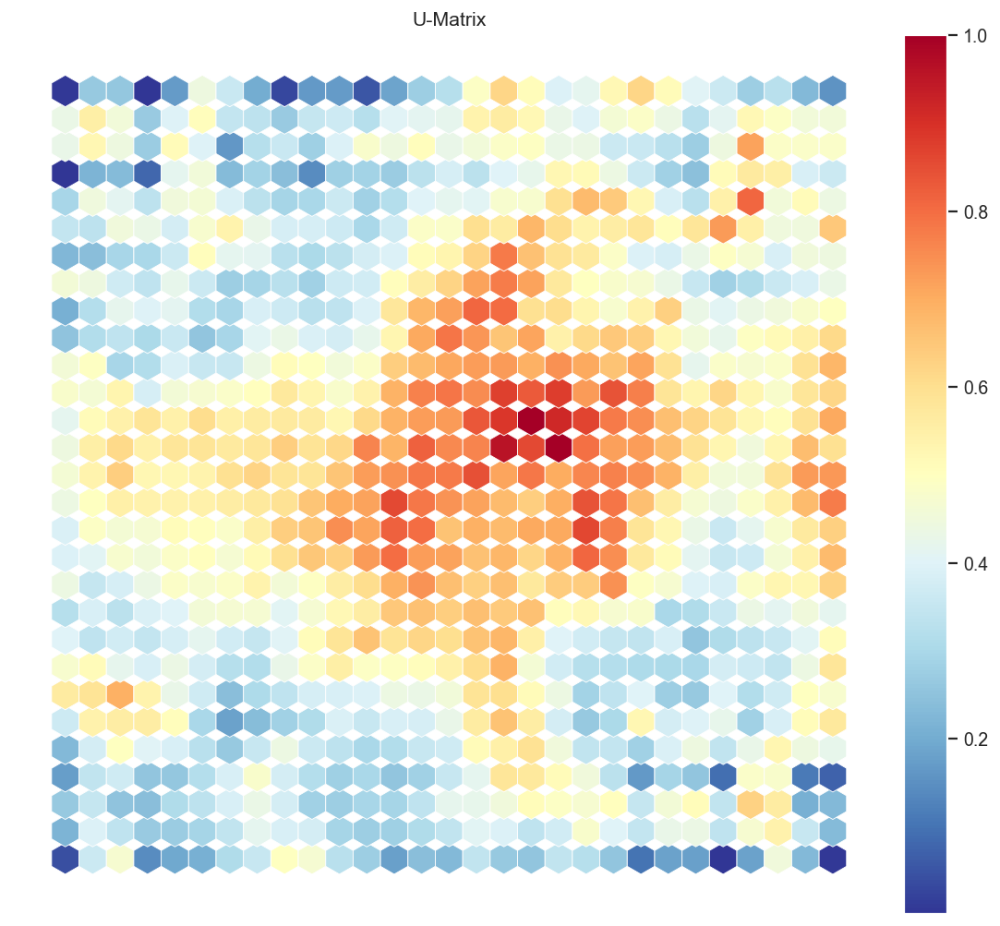

In [848]:
plot_umatrix(som_var2)

Hit-map
1. Represents the number of observations assigned to each neuron (or unit) in the SOM grid
2. Dense areas → Many data points are similar and map to the same neuron (regions of high concentration).
3. Sparse areas → Few or no data points map there, indicating outliers


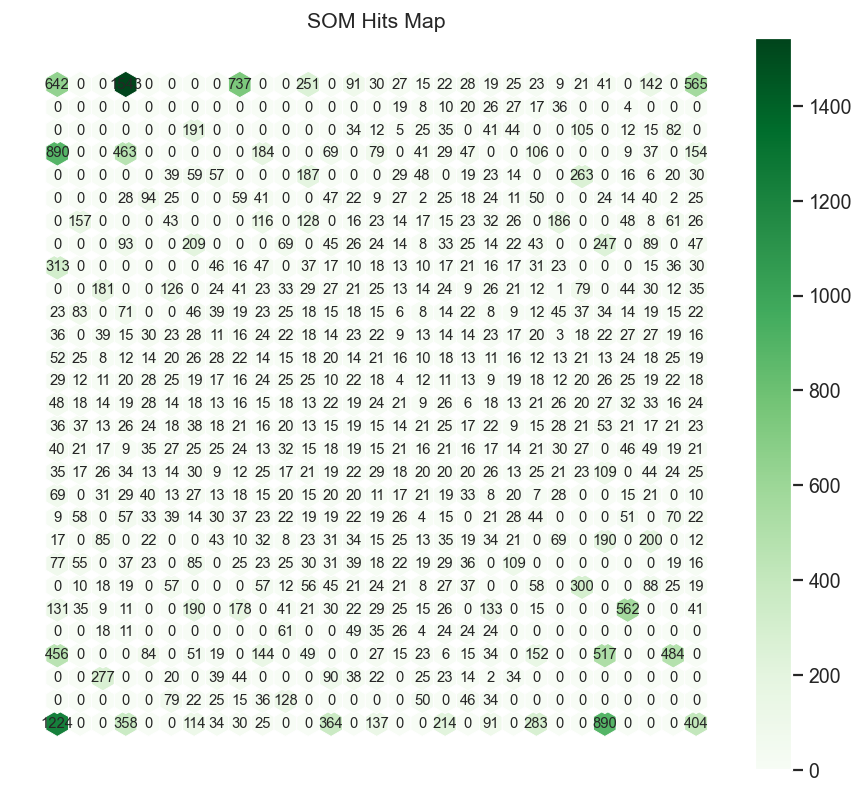

In [849]:
plot_hit_map(som_var2, df_activity_engagement_perspective_fs)

Based on the U-matrix and Hit-map we can conclude the following:

- Denser regions seems to be in the boarders of the map being seprated by a big  middle "transsition zone" where the units are quite far apart from their neighbors.
- In the hitmap we can wee that the middle units of the map tend to have a very samll number of observaitons assigned to them, which is a sign of the transition zone.



#### **Second level with Hierachical Clustering**: Combining the prototypes obtained using the som_var2

1. After making final selection on the paramaters to build the SOM, now we will apply the second stage and combine prototype sinto the final clusters using **Hierarchical Clustering**

In [850]:
prototypes_var2 = som_var2.get_weights().reshape(M*M, input_len)
prototypes_var2.shape

(841, 6)

In [851]:
feature_names = [f"feature_{i}" for i in range(prototypes_var2.shape[1])]
prototypes_var2 = pd.DataFrame(prototypes_var2, columns=feature_names)

Determine the best linkage method and optimal number of clusters using the Silhoette score 

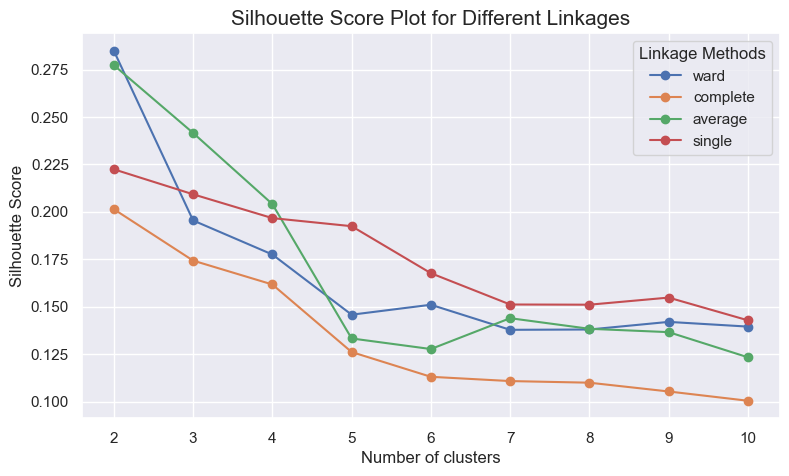

In [409]:
silhouette_scores_som_hierarchical = get_avg_silhouette_score_hierarchical(prototypes_var2, max_nclus=10, min_nclus=2)
plot_avg_silhouette_score_hierarchical(silhouette_scores_som_hierarchical, max_nclus=10, min_nclus=2)

# output_path = "/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/figures/Notebook_2/2_perspectives/value_pref_perspective/Hierarchical_SOM_clus_silhouette_score.png"
# plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
# plt.close() 


> Simple linkage (nearest neighbor) tends to prioritize smaller, chain connected clusters and can sometimes cproduce long chains. On the other hand, ward linkage minimizes the variance within clusters, leading to more compact and non chain like clusters.

> in the first perspective the simple linkage was the best for the silhoete score. In the second perspective the ward linkage was the best for the silhouette score potentially indicating a sifht of clustering structure when the num clusters selected is 2.

> Instead of chain like structure we might have more compact clusters in the second perspective for 2 clusters

> Optimal value is obtained with the wrad linkage method with 2 clusters

Determine the best linkage method using the R^2 

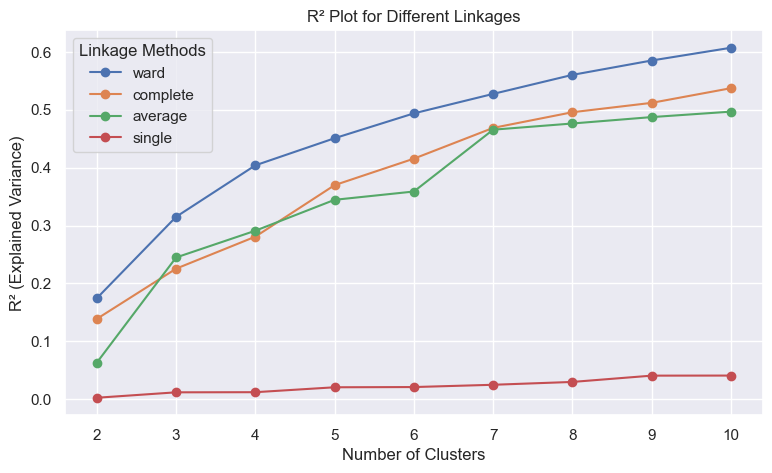

In [408]:
r2_values_SOM_hierarchical = get_r2_hierarchical(prototypes_var2, max_nclus=10, min_nclus=2)
plot_r2_hierarchical(r2_values_SOM_hierarchical, max_nclus=10, min_nclus=2)

output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_Hierarchical_clus_r2.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 

# Time to run: 9m 40.5s


> For the R^2 metrics, the elobow points seems to be at 3 clusters considerign the trade-off between increase in vaiance explained and the increased complexity

Determine the best linkage method using the Calinski and Harabasz score

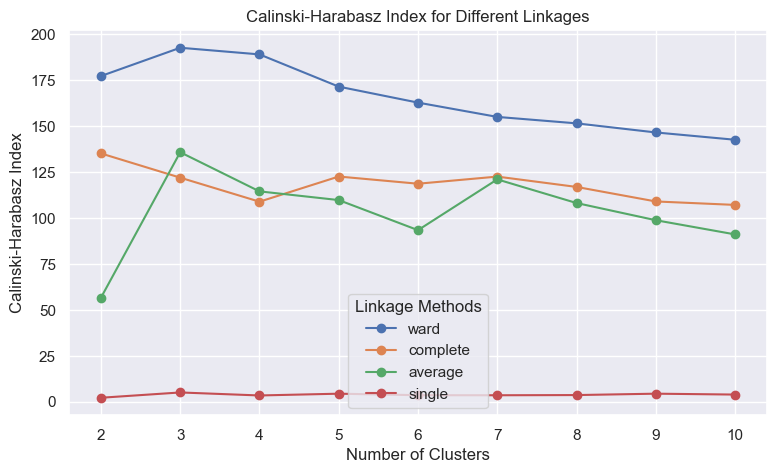

In [854]:
ch_scores_som_hierarchical = get_calinski_harabasz_scores_hierarchical(prototypes_var2, max_nclus=10, min_nclus=2)
plot_ch_index_hierarchical(ch_scores_som_hierarchical, max_nclus=10, min_nclus=2)

# output_path = "/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_Hierarchical_calinski_harabasz_scores.png"
# plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
# plt.close() 


> Considering the Calinsky Habarasz Index, the best number of clusters is 3 since it has the highest value.

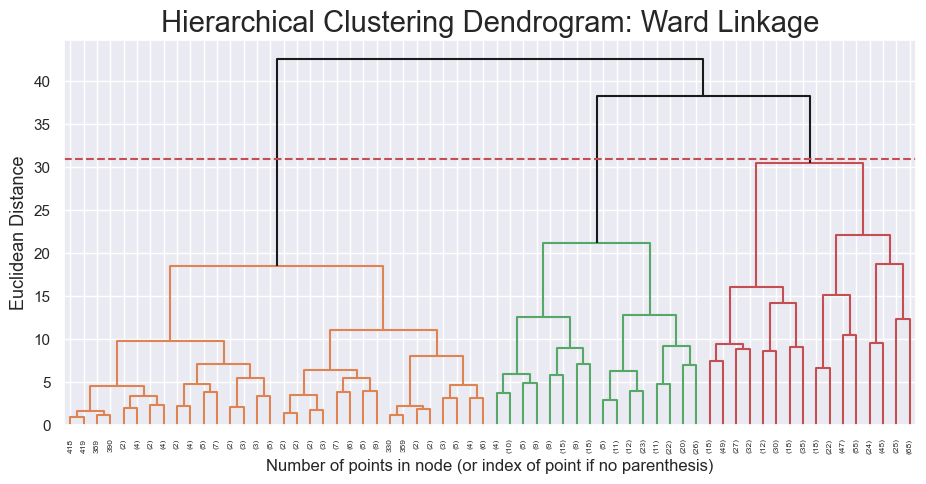

In [407]:
plot_hierarchical_dendrogram(prototypes_var2, method='ward', metric='euclidean', y_threshold=31, p=5)

Based on the dendogram we will choose 3 clusters

| **Method**        | **Optimal linkage method and number of clusters (Silhouette) ** | **Optimal linkage method and number of clusters (R^2)** | **Optimal linkage method and number of clusters (Calinski-Harabasz)** |  **Optimal linkage method and number of clusters (Dendogram)**  |**Final Decision** |
|--------------------|-------------------------|----------------------------|-------------------|--------------------------------------------------------------------------------------------|-------- |
| Hierarchical CLustering     |          2 clusters           |         3 clusters               |    3 clusters            |  3 clusters     | 3  clusters 

<br>

> Based on this our final decision for the Hierarchical clustering paramaters in the SOM + hierarhcical clustering is using the ward linkage method with 3 clusters

#### **Second level with K Means**: 


Determining the best K using Inertia

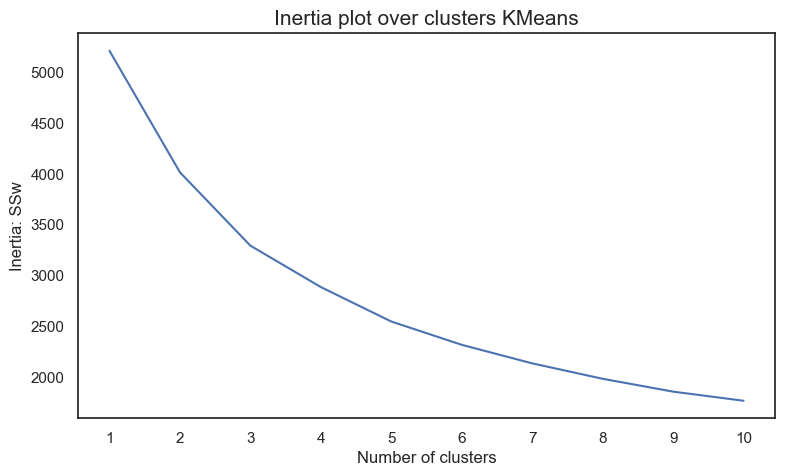

In [406]:
inertia_values_som_kmeans = get_kmeans_inertia(prototypes_var2, 10, 1)
plot_kmeans_inertia(inertia_values_som_kmeans, 10,1)

output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_K_means_inertia.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 

Based on the inertia plot and the elbow method, the optimal number of clusters is 2 or 3

Determine the best K using the silhouette score

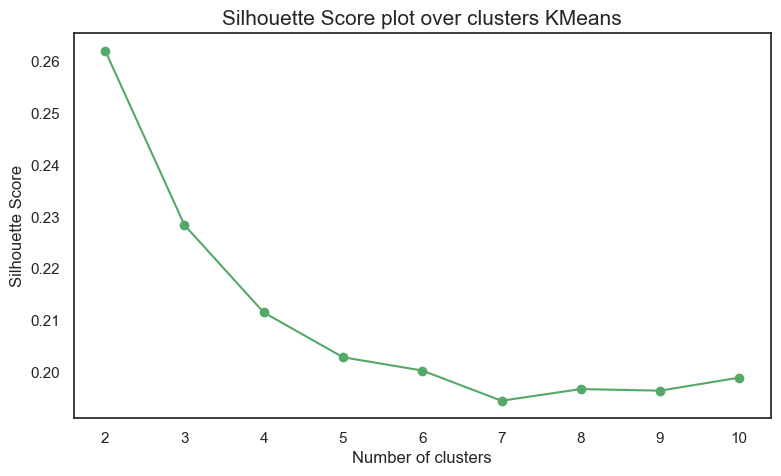

In [405]:
silhouette_scores_som_kmeans = get_avg_silhouette_score(prototypes_var2, 10, 1)

plot_avg_silhouette_score(silhouette_scores_som_kmeans, 10, 1)
output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_K_means_silhouette_scores.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 

> Based on the silhouette score, the optimal number of clusters is two followed by 3 clusters

Determine the best K using the R^2

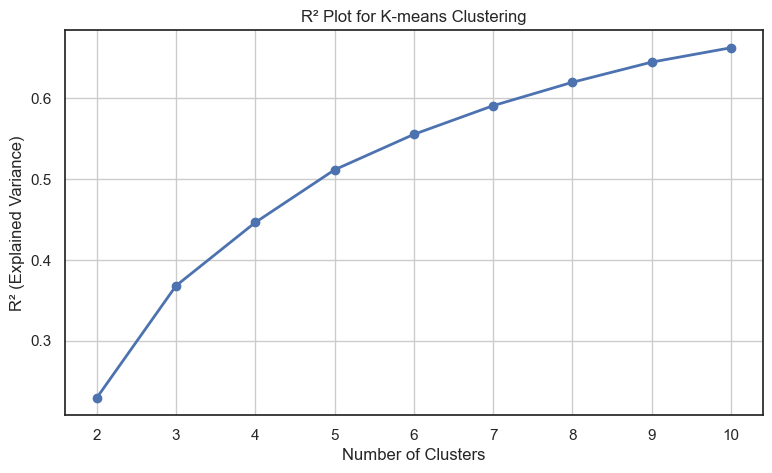

In [404]:
r2_values_som_kmeans = get_r2_kmeans(prototypes_var2, max_nclus=10, min_nclus=2)
plot_r2_kmeans(r2_values_som_kmeans, max_nclus=10, min_nclus=2)

output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_K_means_R^2.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 


> Based on the R^2 plot and the elbow method the best optimal number of clusters is between 3 and 4

Determine the best K using the Calinski and Harabasz score

Source and example used from https://scikit-learn.org/stable/modules/generated/sklearn.metrics.calinski_harabasz_score.html

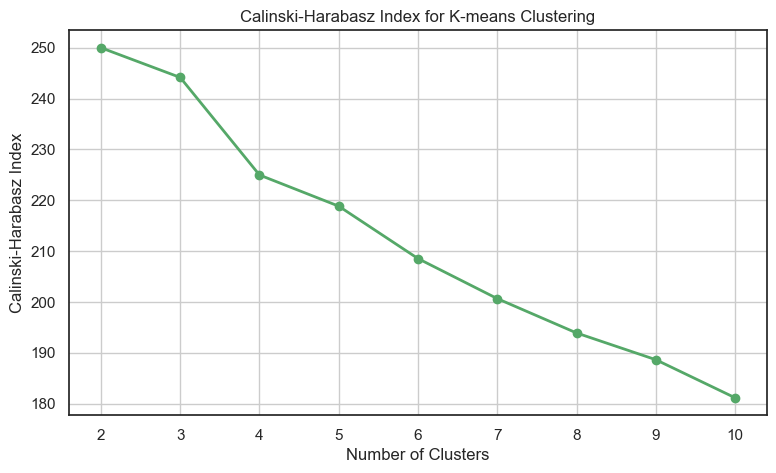

In [403]:
ch_scores_som_kmeans = get_calinski_harabasz_scores(prototypes_var2, max_nclus=10, min_nclus=2)
plot_ch_index(ch_scores_som_kmeans, max_nclus=10, min_nclus=2)

output_path = "figures/Notebook_2/2_perspectives/value_pref_perspective/SOM_K_means_calinski_harabasz_scores.png"
plt.savefig(output_path, format='png', dpi=300, bbox_inches='tight')
plt.close() 

Based on the Calinski-Harabasz Index, the optimal number of clusters for the SOM + KMeans algorithm is 2 clusters with  3 clusters being the second best option.

Deciding on the optimal K value for SOM +K means

| **Method**        | **Optimal K (Inertia)** | **Optimal K (Silhouette)** | **Optimal K (R²)** | **Optimal K (Calinski-Harabasz)** | **Final Decision** |
|--------------------|-------------------------|----------------------------|-------------------|----------------------------------|--------------------|
| K-Means            |            2 or 3     |         2   |    3 - 4         |       2-3             |          3        |

<br>

> Final decision: 3 clusters
1. Considering that there is a tie between optimal number of clusters between 2 and 3 considering that both options are part of best solution for 3/4 metrics we will select solution with 3 clusters based ont eh R^2. Once again with only 2 clusters explained variance of the clustering soluiton is very small

### 7.2.5 Final model selection

> So far we have trained and evaluated individually four algorithms/approaches:

1. Kmeans
2. Hierarchical Clustering
3. SOM + Hierarchical Clustering
4. SOM + Kmeans

> We will now compare the results of the four approaches and select the best one based on the following metrics:

1. Silhouette Score
2. R^2
3. Calinski-Harabasz Index


Training K means with 3 clusters

In [860]:
kmeans_3_activity_engagement_perspective = KMeans(n_clusters=3, init='k-means++', n_init=20, random_state=2024)
kmeans_3_activity_engagement_perspective_labels = kmeans_3.fit_predict(df_activity_engagement_perspective_fs)

# Metrics for K means with 3 clusters
k_means_3_silhouette = silhouette_score(df_activity_engagement_perspective_fs, kmeans_3_activity_engagement_perspective_labels)
k_means_3_r2 = get_r2(df_activity_engagement_perspective_fs, kmeans_3_activity_engagement_perspective_labels)
k_means_3_calinski = calinski_harabasz_score(df_activity_engagement_perspective_fs, kmeans_3_activity_engagement_perspective_labels)

In [861]:
k_means_3_metrics = [k_means_3_silhouette, k_means_3_r2, k_means_3_calinski]

Training Hierarchical clustering with three clusters and ward linkage

In [862]:
hclust_3 = AgglomerativeClustering(n_clusters=3, linkage='ward', metric='euclidean')
hc_3_activity_engagement_perspective_labels = hclust_3.fit_predict(df_activity_engagement_perspective_fs)

# Metrics for Hierarchical clustering with 3 clusters
hc_silhouette_3 = silhouette_score(df_activity_engagement_perspective_fs, hc_3_activity_engagement_perspective_labels)
hc_r2_3 = get_r2(df_activity_engagement_perspective_fs, hc_3_activity_engagement_perspective_labels)
hc_calinski_3 = calinski_harabasz_score(df_activity_engagement_perspective_fs, hc_3_activity_engagement_perspective_labels)


In [863]:
hc_3_metrics = [hc_silhouette_3, hc_r2_3, hc_calinski_3]

Training the SOM + Kmeans (3 clusters)

In [864]:
kmeans_3_som_labels = kmeans_3.fit_predict(prototypes_var2)

#Metrics for SOM + K means with 3 clusters
k_means_3_som_silhouette = silhouette_score(prototypes_var2, kmeans_3_som_labels)
k_means_3_som_r2 = get_r2(prototypes_var2, kmeans_3_som_labels)
k_means_3_som_calinski = calinski_harabasz_score(prototypes_var2, kmeans_3_som_labels)

In [865]:
k_means_3_som_metrics = [k_means_3_som_silhouette, k_means_3_som_r2, k_means_3_som_calinski]

Training the SOM + Hierarchical Clustering (3 clusters)

In [866]:
hc_3_som_labels = hclust_3.fit_predict(prototypes_var2)

#Metrics for SOM + Hierarchical clustering with 3 clusters
hc_3_som_silhouette = silhouette_score(prototypes_var2, hc_3_som_labels)
hc_3_som_r2 = get_r2(prototypes_var2, hc_3_som_labels)
hc_3_som_calinski = calinski_harabasz_score(prototypes_var2, hc_3_som_labels)

In [867]:
hc_3_som_metrics = [hc_3_som_silhouette, hc_3_som_r2, hc_3_som_calinski]

Final comparison

In [868]:
metrics_3_clust = [k_means_3_metrics, hc_3_metrics, k_means_3_som_metrics, hc_3_som_metrics]
algorithms_3_clust = ['KMeans (3 clust)', 'Hierarchical (3 clust)', 'SOM (var2) + KMeans (3 clust)', 'SOM (var2) + Hierarchical(3 clust)']

comparison_df_3_clust = compare_clustering_algorithms(metrics_3_clust, algorithms_3_clust, metric_names)
comparison_df_3_clust

,Silhouette Score,R^2,Calinski-Harabasz Index
KMeans (3 clust),0.305329,0.372052,8824.831360
Hierarchical (3 clust),0.245061,0.325551,7189.440632
SOM (var2) + KMeans (3 clust),0.228432,0.368167,244.150298
SOM (var2) + Hierarchical(3 clust),0.195463,0.315098,192.766091


> Final Decision: Kmeans with 3 clusters

# 8 Cluster Profiling

In [869]:
# Obtaining list of cols used for the clustering approach in the 2 perspectives
activity_engagement_perspective_cols = df_activity_engagement_perspective_fs.columns.tolist()
value_preference_perspective_cols = df_value_preference_perspective_fs.columns.tolist()

df_real_values = df_feature_creation[dbscan_clusters != -1]

In [870]:
df_value_preference_perspective_real_values = df_real_values[value_preference_perspective_cols]
df_activity_engagement_perspective_real_values = df_real_values[activity_engagement_perspective_cols]

## 8.1 Analyze final clustering solution for each perspective

> Here we will analyze each cluster obtained in each perspective. As a reminder, we are analyzing transformed and scaled data

Obtaining the cluster label for each perspective

In [871]:
labels_activatiy_engagement_perspective = kmeans_3.fit_predict(df_activity_engagement_perspective_fs)
labels_value_preference_perspective = kmeans_3.fit_predict(df_value_preference_perspective_fs)

### 8.1.1 Analyze Value and Preference perspective

#### Numerical features

Auxiliary functions

In [872]:
# ------------------- Cluster Profiling -------------------

def cluster_profiles(df, label_columns, figsize, 
                     cmap="tab10",
                     compare_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    
    if compare_titles == None:
        compare_titles = [""]*len(label_columns)
        
    fig, axes = plt.subplots(nrows=len(label_columns), 
                             ncols=2, 
                             figsize=figsize, 
                             constrained_layout=True,
                             squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compare_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, 
                                            label, 
                                            color = sns.color_palette(cmap),
                                            ax=ax[0])



        sns.barplot(x=label, 
                    hue=label,
                    y="counts", 
                    data=counts, 
                    ax=ax[1], 
                    palette=sns.color_palette(cmap),
                    legend=False
                    )

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), 
                              rotation=40,
                              ha='right'
                              )
        
        ax[0].legend(handles, cluster_labels,
                     loc='center left', bbox_to_anchor=(1, 0.5), title=label
                     ) # Adaptable to number of clusters
        
        ax[1].set_xticks([i for i in range(len(handles))])
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
        
        
    
    # plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profiling", fontsize=23)
    plt.show()



# ------------------- Descriptive Analysis of the Clusters -------------------

def descriptive_stats_by_cluster(df, label_column):
    """
    Display descriptive statistics grouped by cluster labels.
    
    Parameters:
    - df: DataFrame containing features and cluster labels.
    - label_column: Column with cluster labels.
    """
    print("Descriptive Statistics by Cluster:")
    cluster_stats = df.groupby(label_column).describe()
    display(cluster_stats)
    return cluster_stats



# ------------------- Histograms for Feature Distributions by Cluster -------------------
def histograms_by_cluster(df, label_column, figsize=(18, 6), bins=10, cmap="tab10"):
    """
    Plot histograms for each feature grouped by cluster labels.

    Parameters:
    - df: DataFrame containing features and cluster labels.
    - label_column: Column with cluster labels.
    - figsize: Size of the figure for plotting.
    - cmap: Color palette for the plots.
    """
    import matplotlib.pyplot as plt
    import seaborn as sns

    # Separate features from label column
    features = [col for col in df.columns if col != label_column]
    n_clusters = df[label_column].nunique()

    # Create a color palette for clusters
    palette = sns.color_palette(cmap, n_clusters)

    # Create subplots
    fig, axes = plt.subplots(nrows=len(features), ncols=n_clusters, 
                             figsize=(figsize[0], len(features) * figsize[1] / 6), 
                             constrained_layout=True)
    axes = axes if len(features) > 1 else [axes]  # Ensure axes is iterable when there's one feature

    for i, feature in enumerate(features):
        for j, cluster in enumerate(sorted(df[label_column].unique())):
            ax = axes[i][j]
            cluster_data = df[df[label_column] == cluster][feature]
            sns.histplot(cluster_data, kde=False, bins=bins, color=palette[j], ax=ax)

            ax.set_title(f"Cluster {cluster}: {feature}", fontsize=10)
            ax.set_xlabel(feature if i == len(features) - 1 else "")
            ax.set_ylabel("Count" if j == 0 else "")

    plt.suptitle("Histograms of Feature Distributions by Cluster", fontsize=20)
    plt.show()



# ------------------- Boxplots for Feature Distributions by Cluster -------------------

def boxplots_by_cluster(df, label_column, figsize=(15, 10), cmap="tab10"):
    """
    Plot boxplots for each feature grouped by cluster labels.
    
    Parameters:
    - df: DataFrame containing features and cluster labels.
    - label_column: Column with cluster labels.
    - figsize: Size of the figure for plotting.
    - cmap: Color palette for the plots.
    """
    features = [col for col in df.columns if col != label_column]
    fig, axes = plt.subplots(nrows=len(features)//3 + 1, ncols=3, figsize=figsize, constrained_layout=True)
    axes = axes.flatten()
    
    for ax, feature in zip(axes, features):
        sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
        ax.set_title(f"Boxplot of {feature}")
    for ax in axes[len(features):]:  # Turn off unused subplots
        ax.axis("off")
    plt.show()



# ------------------- Pairplot of features colored by Clusters -------------------
def pairplot_by_cluster(df, label_column, cmap="tab10"):
    """
    Plot a pairplot of features with points colored by cluster labels.
    
    Parameters:
    - df: DataFrame containing features and cluster labels.
    - label_column: Column with cluster labels.
    - cmap: Color palette for the plots.
    """
    sns.pairplot(df, hue=label_column, palette=sns.color_palette(cmap), diag_kind="kde", corner=True)
    plt.suptitle("Pairplot of Features by Cluster", y=1.02, fontsize=16)
    plt.show()





In [873]:
df_value_preference_perspective_fs["value_preference_perspective"] = labels_value_preference_perspective
df_value_preference_perspective_real_values["value_preference_perspective"] = labels_value_preference_perspective
df_real_values["value_preference_perspective"] = labels_value_preference_perspective

In [874]:
df_value_preference_perspective_fs.columns

Index(['tot_money_spent_per_client', 'avg_money_spent_per_order',
       'avg_products_per_order', 'tot_non_chain_orders',
       'percent_chain_orders', 'num_unique_cuisines_tried',
       'value_preference_perspective'],
      dtype='object')

In [875]:
df_value_preference_perspective_real_values.columns

Index(['tot_money_spent_per_client', 'avg_money_spent_per_order',
       'avg_products_per_order', 'tot_non_chain_orders',
       'percent_chain_orders', 'num_unique_cuisines_tried',
       'value_preference_perspective'],
      dtype='object')

Analyzing the Average Variation of Features in Each Cluster

- Here, we are using the transformed and scaled values of the data.
- This means the values can be used for comparison to determine whether the means are higher in certain clusters, but we cannot focus on the actual values themselves.


/var/folders/ls/ymvgl5s56rs19sp6mvzp6w1c0000gn/T/ipykernel_82250/3550129269.py:37: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.barplot(x=label,


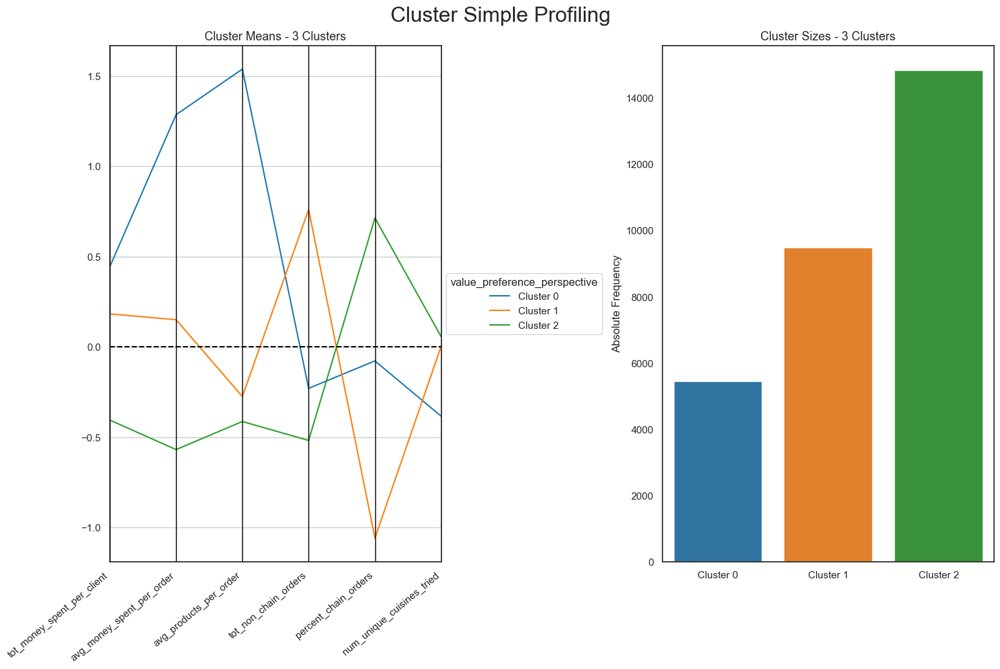

In [402]:
# For the scaled and transformed data
cluster_profiles(df_value_preference_perspective_fs, ["value_preference_perspective"], figsize=(15, 10))

Descriptive statistics for each cluster using the real values instead of transformed and scaled ones

In [877]:
# Set display options to show more rows and columns
pd.set_option('display.max_rows', None)  # None removes the row limit
pd.set_option('display.max_columns', None)  # None removes the column limit
pd.set_option('display.width', 1000)  # Adjust the width for better horizontal readability

# Run your descriptive stats function
cluster_stats = descriptive_stats_by_cluster(df_value_preference_perspective_real_values, "value_preference_perspective")

# Reset options to default after displaying
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')
pd.reset_option('display.width')

Descriptive Statistics by Cluster:


tot_money_spent_per_client                                                           avg_money_spent_per_order                                                                         avg_products_per_order                                                          tot_non_chain_orders                                               percent_chain_orders                                                                      num_unique_cuisines_tried                                              
                                                  count       mean        std   min    25%    50%     75%     max                     count       mean       std       min        25%        50%     75%        max                  count      mean       std  min       25%  50%       75%    max                count      mean       std  min  25%  50%  75%   max                count       mean        std  min        25%         50%    75%         max                     count      mean       std  min  25%  50%  75%   max
value_preference_perspective                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            
0                                                5457.0  49.067141  36.769888  6.59  24.72  36.94  62.200  272.85                    5457.0  21.194551  9.691508  6.076667  14.894286  19.090000  25.040  88.590000                 5457.0  1.931809  0.448512  1.2  1.571429  2.0  2.000000  5.000               5457.0  0.920103  1.009773  0.0  0.0  1.0  1.0   8.0               5457.0  59.766547  39.181032  0.0  33.333333   66.666667  100.0  100.000000                    5457.0  1.680960  0.894504  1.0  1.0  1.0  2.0   7.0
1                                                9495.0  40.226555  32.702788  1.06  18.08  30.18  53.995  252.16                    9495.0  10.059030  4.268279  1.060000   6.752250   9.481429  12.525  25.224286                 9495.0  1.179886  0.210460  1.0  1.000000  1.1  1.333333  2.125               9495.0  2.857188  1.866865  1.0  2.0  2.0  4.0  12.0               9495.0  21.613877  23.876370  0.0   0.000000   15.384615   40.0   88.235294                    9495.0  2.217799  1.296866  1.0  1.0  2.0  3.0  10.0
2                                               14840.0  20.294885  16.010075  0.37   8.92  16.60  25.660  122.89                   14840.0   6.376425  3.681900  0.370000   3.676188   5.640000   8.240  24.390000                14840.0  1.122420  0.189607  1.0  1.000000  1.0  1.250000  2.000              14840.0  0.355593  0.589947  0.0  0.0  0.0  1.0   4.0              14840.0  90.548816  16.328293  0.0  83.333333  100.000000  100.0  100.000000                   14840.0  2.288342  1.371177  1.0  1.0  2.0  3.0  11.0

Histograms for Feature Distributions by Cluster

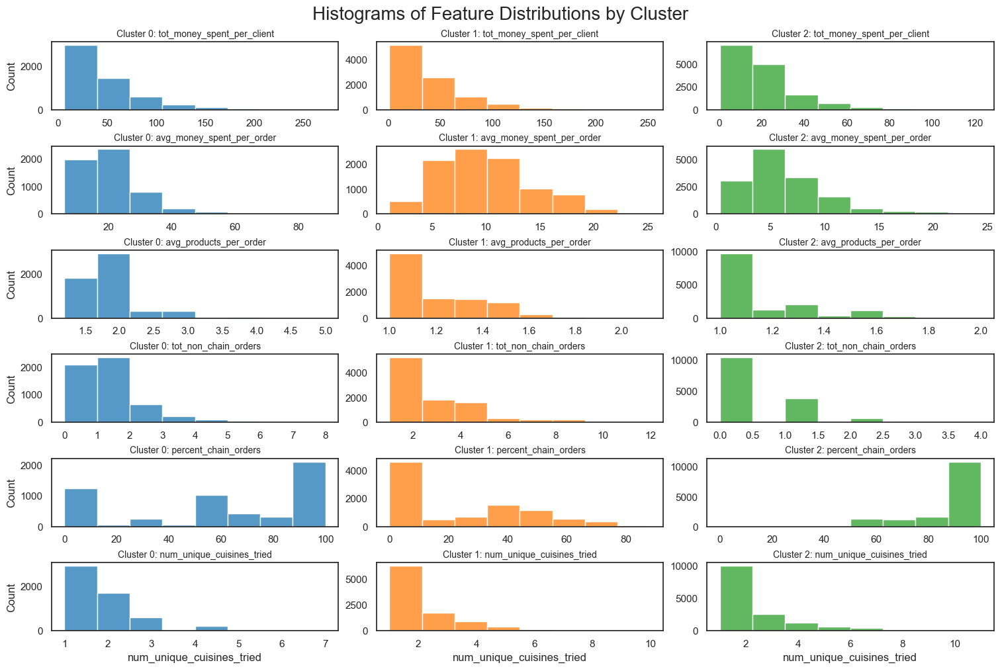

In [401]:
histograms_by_cluster(df_value_preference_perspective_real_values, "value_preference_perspective", bins=8, figsize=(15, 10))

> The profiling of the clusters from the two perspectives was done on the final report.

Boxplots for Feature Distributions by Cluster

/var/folders/ls/ymvgl5s56rs19sp6mvzp6w1c0000gn/T/ipykernel_82250/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/ls/ymvgl5s56rs19sp6mvzp6w1c0000gn/T/ipykernel_82250/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/ls/ymvgl5s56rs19sp6mvzp6w1c0000gn/T/ipykernel_82250/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/ls/ymvgl5s56rs19sp6mvzp6w1c0000gn/T/ipykernel_82250/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(

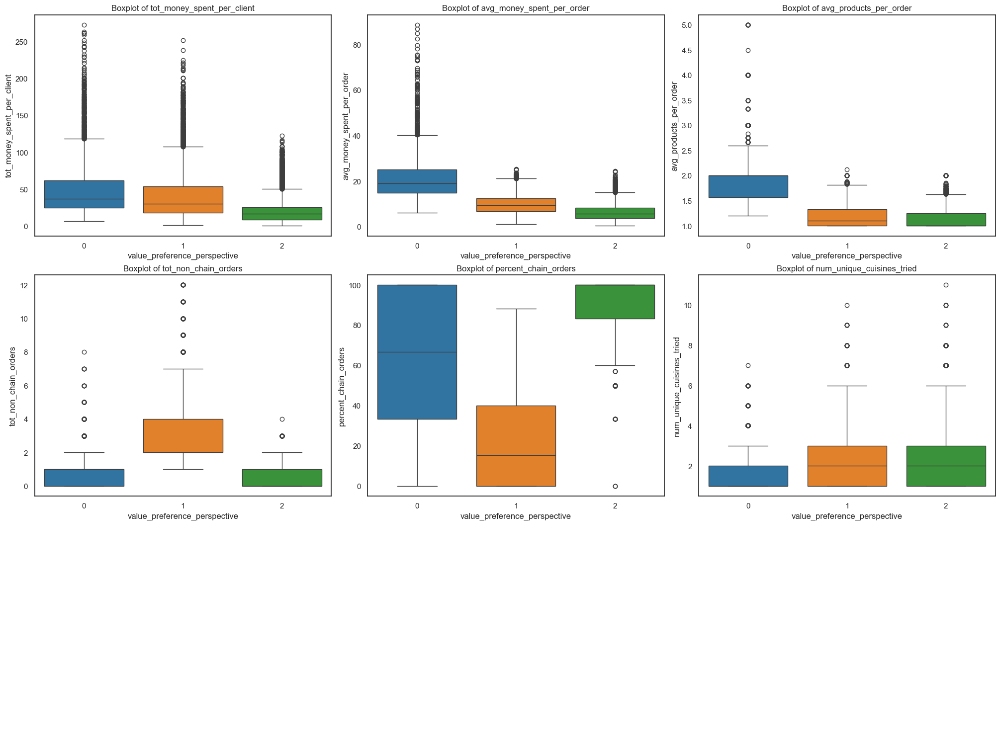

In [400]:
boxplots_by_cluster(df_value_preference_perspective_real_values, "value_preference_perspective", figsize=(20, 15))


> The existance of outliers and extreme values was also incorporated in the cluster profiling which can be found on the report.

#### Categorical features

auxiliary functions

In [881]:
# ------------------- Bar charts showing the percentage composition -------------------

"""
def cluster_composition_categorical(df, categorical_features, label_column, figsize=(12, 6), cmap="tab10"):
    Plot bar charts showing the percentage composition of categorical features for each cluster.

    Parameters:
    - df: DataFrame containing categorical features and cluster labels.
    - categorical_features: List of categorical feature columns.
    - label_column: Column with cluster labels.
    - figsize: Size of the figure.
    - cmap: Color palette for the plots.
    for feature in categorical_features:
        plt.figure(figsize=figsize)
        cluster_comp = pd.crosstab(df[label_column], df[feature], normalize="index") * 100
        cluster_comp.plot(kind="bar", stacked=True, cmap=cmap, ax=plt.gca())
        plt.title(f"Cluster Composition by {feature}")
        plt.xlabel("Cluster")
        plt.ylabel("Percentage (%)")
        plt.legend(title=feature, bbox_to_anchor=(1.05, 1), loc="upper left")
        plt.tight_layout()
        plt.show()




# ------------------- Bar charts showing absolute count -------------------

def count_distribution_categorical(df, categorical_features, label_column, figsize=(12, 6), cmap="tab10"):
    Plot bar charts showing the count distribution of categorical features per cluster.

    Parameters:
    - df: DataFrame containing categorical features and cluster labels.
    - categorical_features: List of categorical feature columns.
    - label_column: Column with cluster labels.
    - figsize: Size of the figure.
    - cmap: Color palette for the plots.
    for feature in categorical_features:
        plt.figure(figsize=figsize)
        cluster_counts = pd.crosstab(df[label_column], df[feature])
        cluster_counts.plot(kind="bar", stacked=False, cmap=cmap, ax=plt.gca())
        plt.title(f"Count Distribution by {feature} in Clusters")
        plt.xlabel("Cluster")
        plt.ylabel("Count")
        plt.legend(title=feature, bbox_to_anchor=(1.05, 1), loc="upper left")
        plt.tight_layout()
        plt.show()
"""

# ------------------- Combined Bar Charts for Count and Percentage Composition -------------------
def cluster_composition_and_count_categorical(df, categorical_features, label_column, figsize=(16, 8), cmap="tab10"):
    """
    Plot bar charts showing both the absolute count and percentage composition of categorical features for each cluster.

    Parameters:
    - df: DataFrame containing categorical features and cluster labels.
    - categorical_features: List of categorical feature columns.
    - label_column: Column with cluster labels.
    - figsize: Size of the figure.
    - cmap: Color palette for the plots.
    """
    for feature in categorical_features:
        fig, axes = plt.subplots(1, 2, figsize=figsize, constrained_layout=True)

        # Absolute count
        cluster_counts = pd.crosstab(df[label_column], df[feature])
        cluster_counts.plot(kind="bar", stacked=False, cmap=cmap, ax=axes[0])
        axes[0].set_title(f"Count Distribution by {feature} in Clusters")
        axes[0].set_xlabel("Cluster")
        axes[0].set_ylabel("Count")
        axes[0].legend(title=feature, bbox_to_anchor=(1.05, 1), loc="upper left")

        # Percentage composition
        cluster_comp = pd.crosstab(df[label_column], df[feature], normalize="index") * 100
        cluster_comp.plot(kind="bar", stacked=True, cmap=cmap, ax=axes[1])
        axes[1].set_title(f"Cluster Composition by {feature}")
        axes[1].set_xlabel("Cluster")
        axes[1].set_ylabel("Percentage (%)")
        axes[1].legend(title=feature, bbox_to_anchor=(1.05, 1), loc="upper left")

        # Adjust layout and show the plot
        plt.suptitle(f"Analysis of {feature}", fontsize=16)
        plt.show()



In [882]:
# Determining categorical features
categorical_features = [element for element in df_real_values.columns if element not in df_value_preference_perspective.columns and element not in df_activity_engagement_perspective.columns]

# Removing Customer Age from the categorical features ---> Needs to be anaylzed separately
categorical_features = [element for element in categorical_features if element not in ["customer_age", "value_preference_perspective"]]


In [883]:
categorical_features

['last_promo',
 'payment_method_combined',
 'city',
 'purchased_American',
 'purchased_Asian',
 'purchased_Beverages',
 'purchased_Cafe',
 'purchased_Chicken Dishes',
 'purchased_Chinese',
 'purchased_Desserts',
 'purchased_Healthy',
 'purchased_Indian',
 'purchased_Italian',
 'purchased_Japanese',
 'purchased_Noodle Dishes',
 'purchased_OTHER',
 'purchased_Street Food / Snacks',
 'purchased_Thai',
 'client_behavior_cuisine_preference',
 'client_behavior_peak_preference',
 'client_behavior_chain_preference']

Bar chart with absolute count and percentages

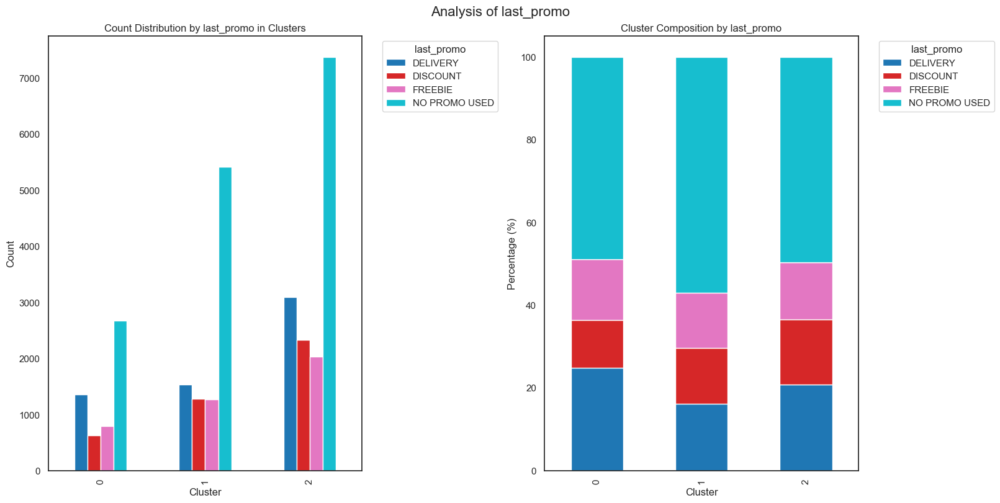

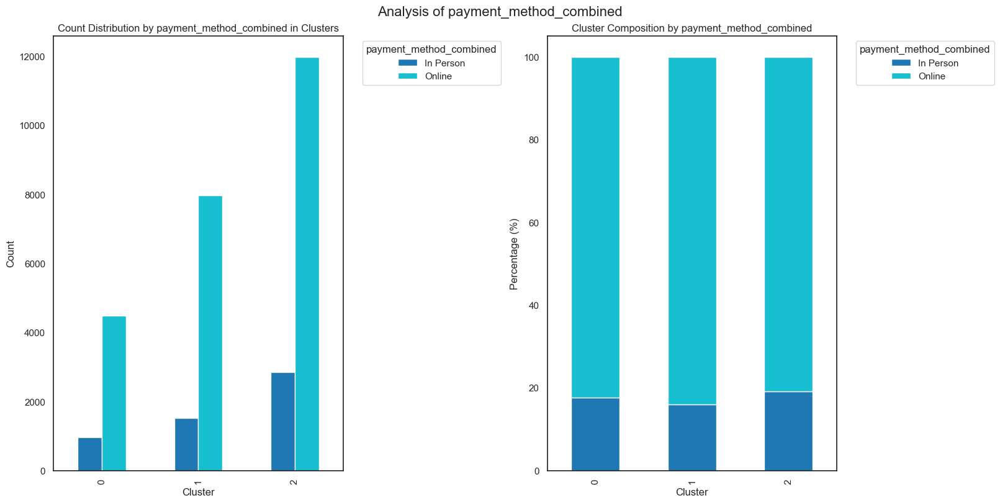

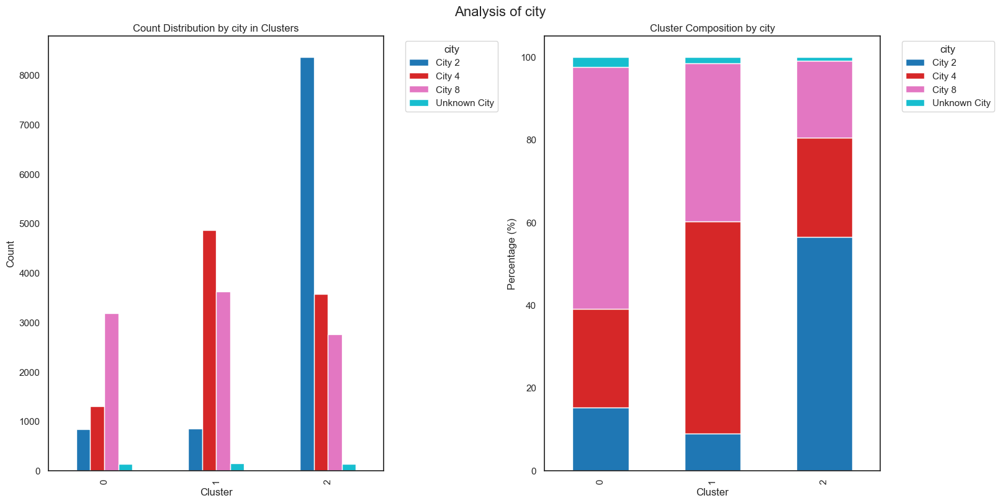

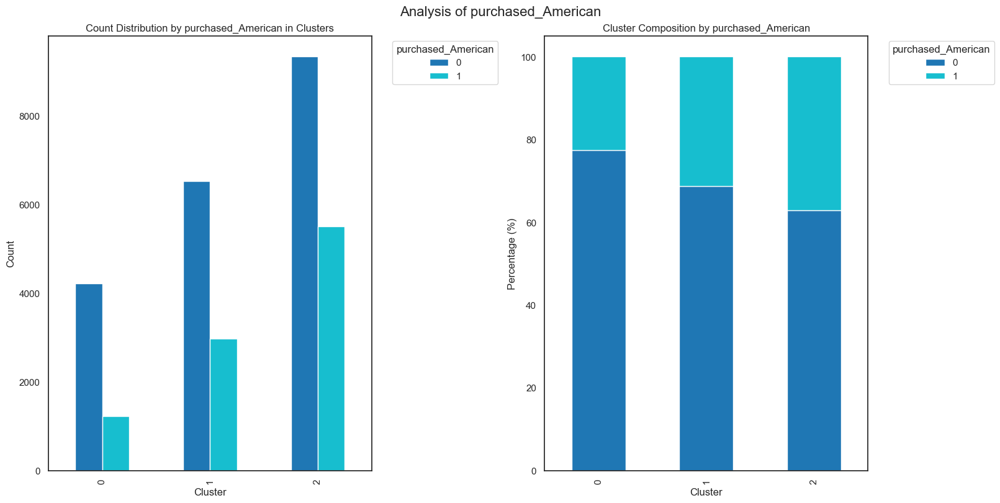

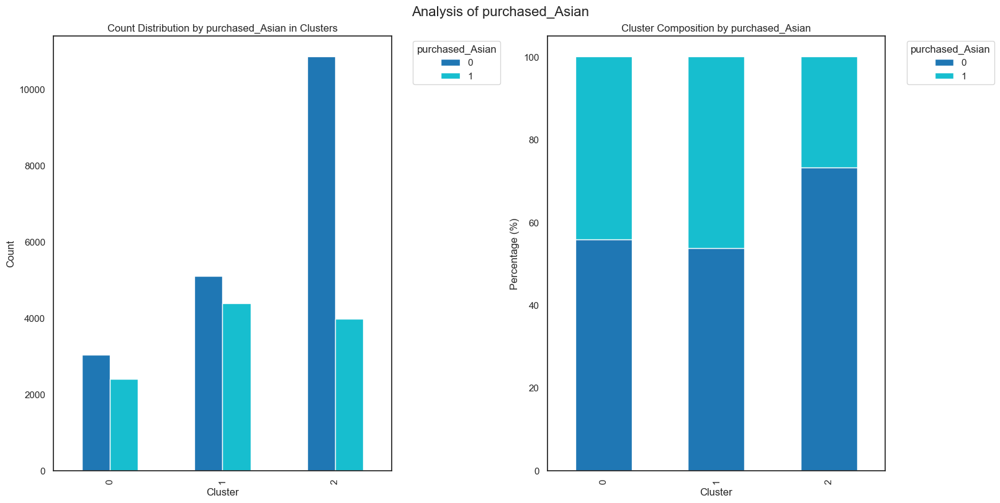

...

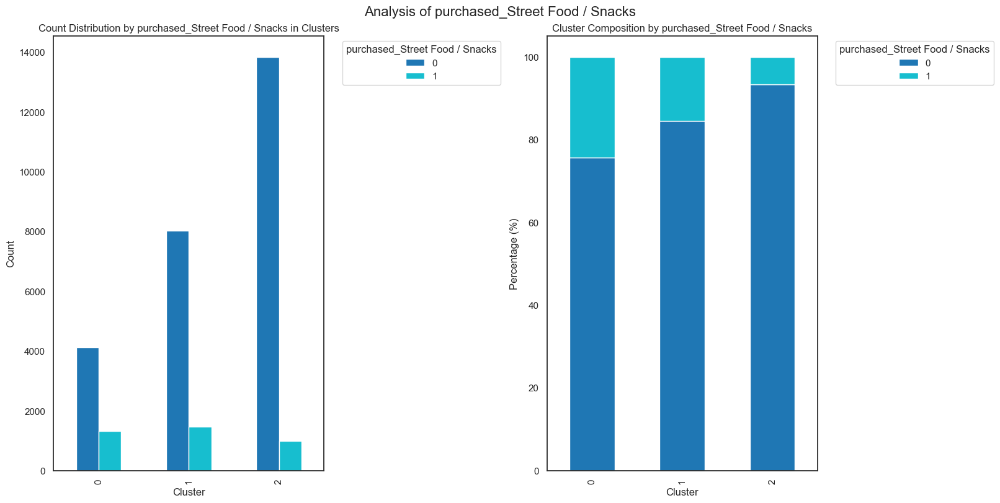

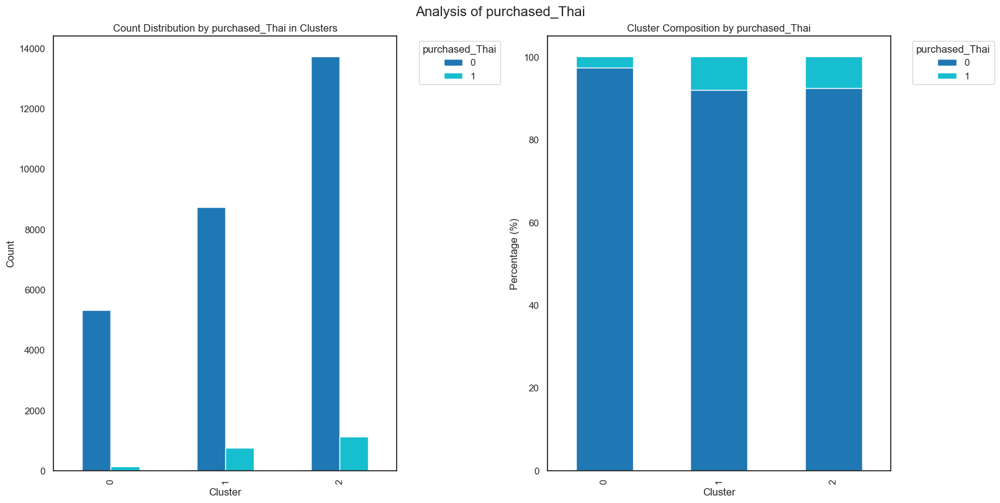

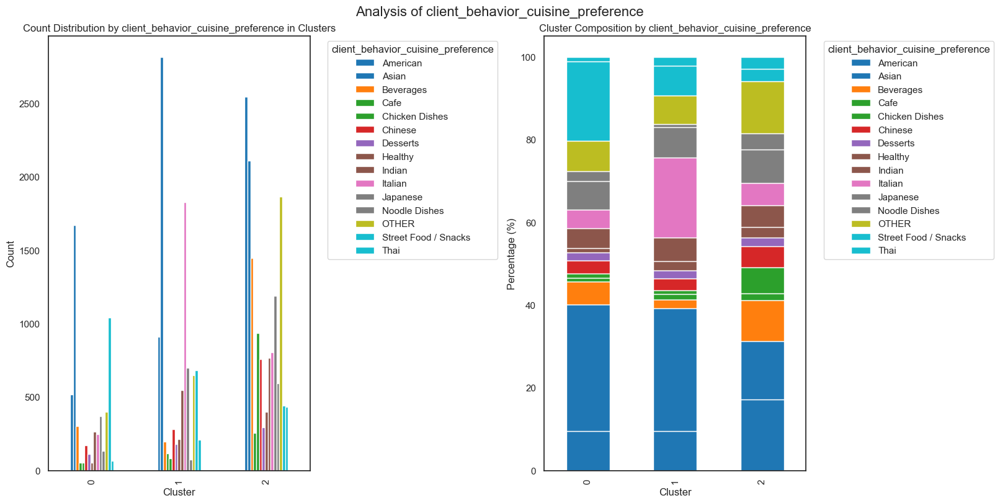

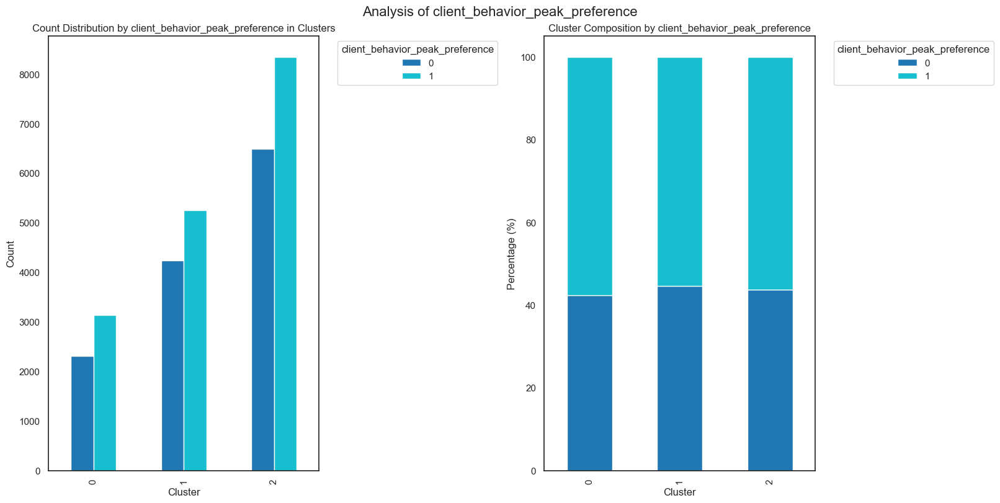

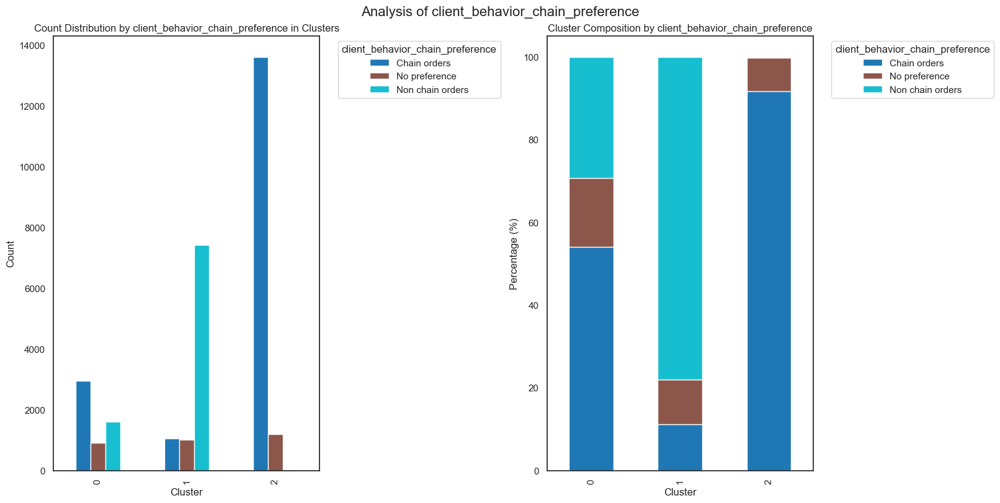

In [399]:
cluster_composition_and_count_categorical(df_real_values, categorical_features, "value_preference_perspective", figsize=(16, 8))

> The analysis of categorical features was also incorporated into the cluster profiling in the final report

### 8.1.2 Analyze Activity and Engament perspective 

In [885]:
df_activity_engagement_perspective_fs["activity_engagement_perspective"] = labels_activatiy_engagement_perspective
df_activity_engagement_perspective_real_values["activity_engagement_perspective"] = labels_activatiy_engagement_perspective
df_real_values["activity_engagement_perspective"] = labels_activatiy_engagement_perspective

In [886]:
df_real_values.columns

Index(['customer_age', 'vendor_count', 'product_count', 'tot_chain_orders',
       'first_order', 'last_order', 'last_promo', 'payment_method_combined',
       'city', 'tot_orders_per_client', 'tot_money_spent_per_client',
       'purchased_American', 'purchased_Asian', 'purchased_Beverages',
       'purchased_Cafe', 'purchased_Chicken Dishes', 'purchased_Chinese',
       'purchased_Desserts', 'purchased_Healthy', 'purchased_Indian',
       'purchased_Italian', 'purchased_Japanese', 'purchased_Noodle Dishes',
       'purchased_OTHER', 'purchased_Street Food / Snacks', 'purchased_Thai',
       'num_unique_cuisines_tried', 'client_behavior_cuisine_preference',
       'peak_days_num_orders', 'off_peak_days_num_orders',
       'client_behavior_peak_preference', 'morning_num_orders',
       'afternoon_num_orders', 'evening_num_orders', 'night_num_orders',
       'avg_money_spent_per_order', 'avg_products_per_order',
       'tot_non_chain_orders', 'client_behavior_chain_preference',
       '

In [887]:
df_activity_engagement_perspective_fs.columns

Index(['peak_days_num_orders', 'off_peak_days_num_orders',
       'morning_num_orders', 'afternoon_num_orders', 'evening_num_orders',
       'night_num_orders', 'activity_engagement_perspective'],
      dtype='object')

In [888]:
df_activity_engagement_perspective_real_values.columns

Index(['peak_days_num_orders', 'off_peak_days_num_orders',
       'morning_num_orders', 'afternoon_num_orders', 'evening_num_orders',
       'night_num_orders', 'activity_engagement_perspective'],
      dtype='object')

Analyzing the average variation of the features in each cluster

/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:37: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.barplot(x=label,


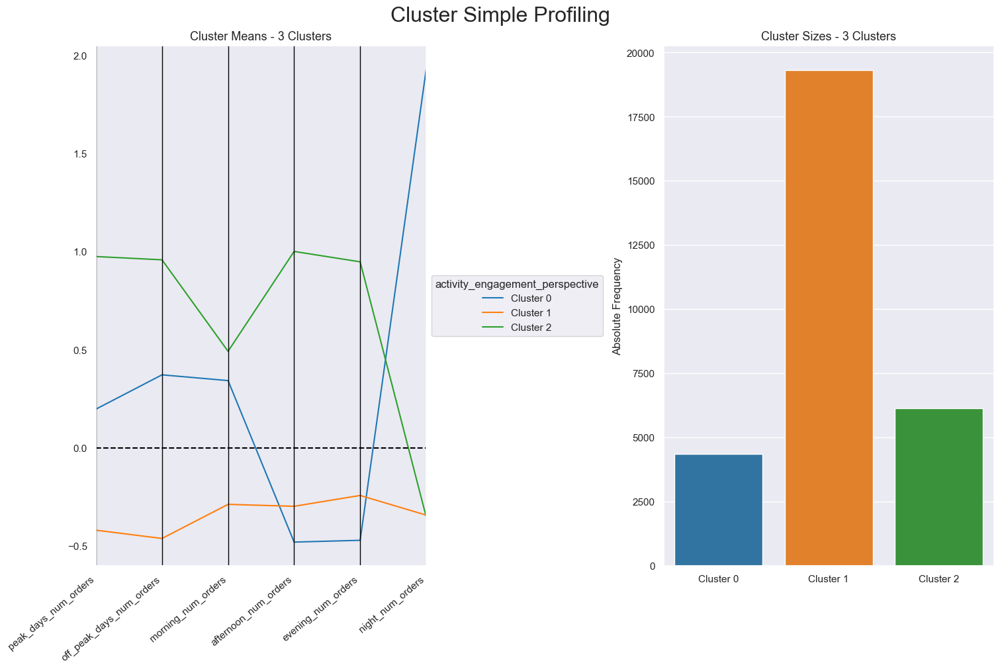

In [889]:
# For the scaled and transformed data
cluster_profiles(df_activity_engagement_perspective_fs, ["activity_engagement_perspective"], figsize=(15, 10))

Descriptive statistics for each cluster

In [890]:
# Set display options to show more rows and columns
pd.set_option('display.max_rows', None)  # None removes the row limit
pd.set_option('display.max_columns', None)  # None removes the column limit
pd.set_option('display.width', 1000)  # Adjust the width for better horizontal readability

cluster_stats = descriptive_stats_by_cluster(df_activity_engagement_perspective_real_values, "activity_engagement_perspective")

# Reset options to default after displaying
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')
pd.reset_option('display.width')

Descriptive Statistics by Cluster:


peak_days_num_orders                                               off_peak_days_num_orders                                               morning_num_orders                                               afternoon_num_orders                                               evening_num_orders                                               night_num_orders                                              
                                               count      mean       std  min  25%  50%  75%   max                    count      mean       std  min  25%  50%  75%   max              count      mean       std  min  25%  50%  75%   max                count      mean       std  min  25%  50%  75%   max              count      mean       std  min  25%  50%  75%   max            count      mean       std  min  25%  50%  75%   max
activity_engagement_perspective                                                                                                                                                                                                                                                                                                                                                                                                              
0                                             4364.0  2.051100  1.570383  0.0  1.0  2.0  3.0  11.0                   4364.0  2.583410  1.803595  0.0  1.0  2.0  3.0  11.0             4364.0  1.506187  1.637070  0.0  0.0  1.0  2.0  13.0               4364.0  0.600825  0.965202  0.0  0.0  0.0  1.0   7.0             4364.0  0.148488  0.523082  0.0  0.0  0.0  0.0   6.0           4364.0  2.379010  1.352506  1.0  1.0  2.0  3.0  11.0
1                                            19303.0  1.045433  0.941429  0.0  0.0  1.0  2.0   6.0                  19303.0  1.035176  0.990241  0.0  0.0  1.0  2.0   7.0            19303.0  0.597109  0.903307  0.0  0.0  0.0  1.0   7.0              19303.0  0.987463  1.031344  0.0  0.0  1.0  2.0   5.0            19303.0  0.362223  0.657695  0.0  0.0  0.0  1.0   4.0          19303.0  0.133813  0.340461  0.0  0.0  0.0  0.0   1.0
2                                             6125.0  3.607673  2.079033  0.0  2.0  3.0  5.0  13.0                   6125.0  4.059265  2.445603  0.0  2.0  4.0  5.0  14.0             6125.0  1.834939  2.077928  0.0  0.0  1.0  3.0  16.0               6125.0  3.739592  2.430808  0.0  2.0  3.0  5.0  14.0             6125.0  1.955592  2.043131  0.0  0.0  1.0  3.0  15.0           6125.0  0.136816  0.437719  0.0  0.0  0.0  0.0   5.0

Histograms for Feature Distributions by Cluster

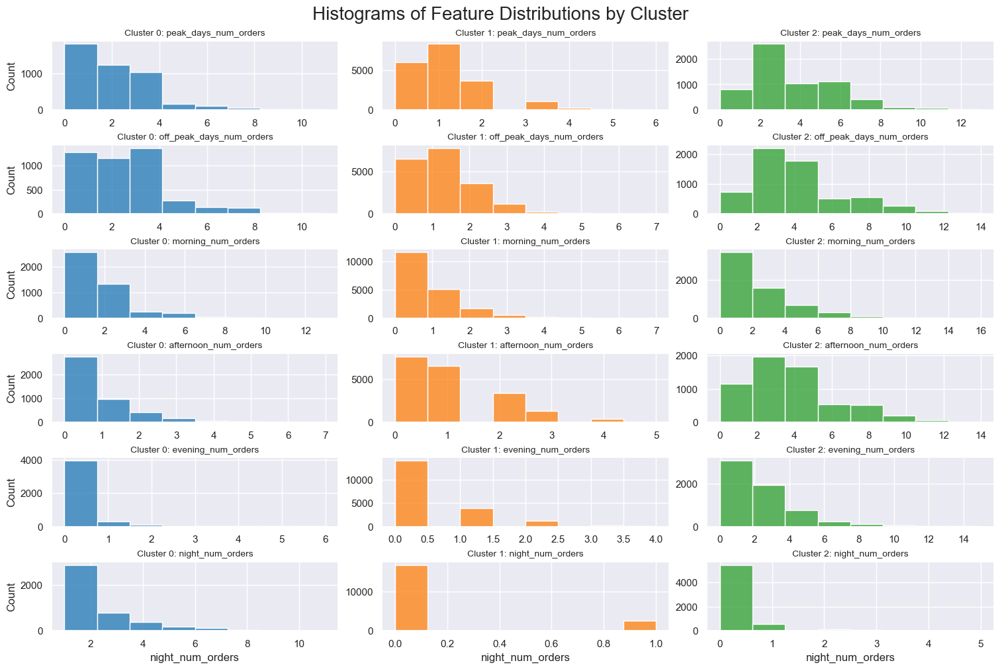

In [891]:
histograms_by_cluster(df_activity_engagement_perspective_real_values, "activity_engagement_perspective", bins=8, figsize=(15, 10))

> Once again, this was intepreted in the cluster profiling section of the final report.

Boxplots for Feature Distributions by Cluster

/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(

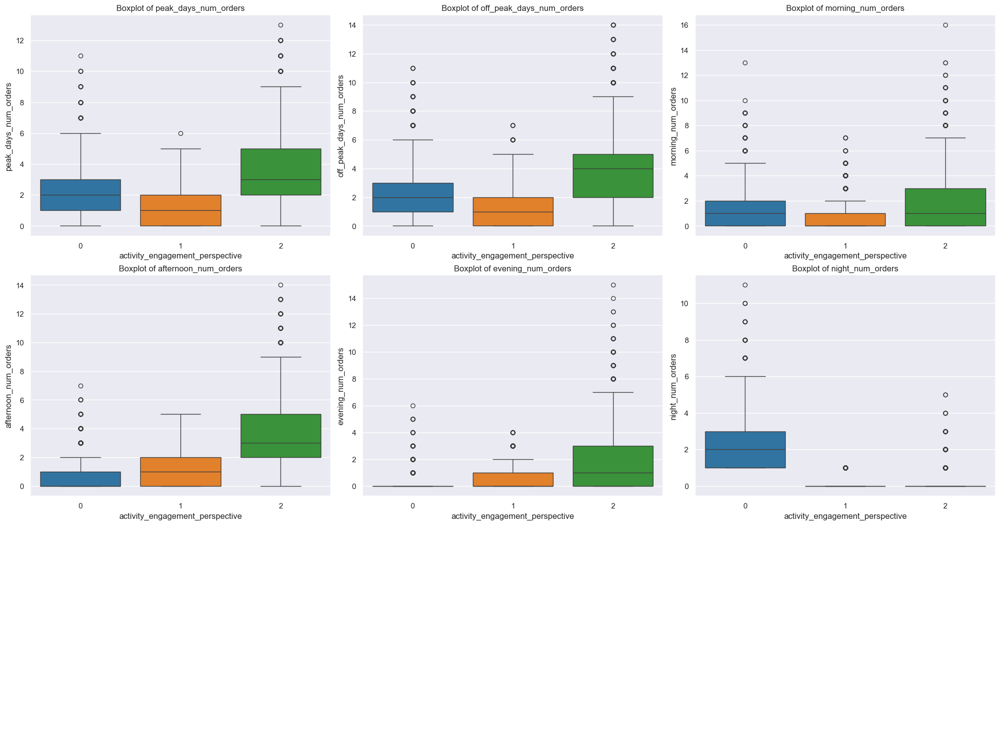

In [892]:

boxplots_by_cluster(df_activity_engagement_perspective_real_values, "activity_engagement_perspective", figsize=(20, 15))


> Once again, this was intepreted in the cluster profiling section of the final report.

#### Categorical features

Bar chart with absolute count and percentages

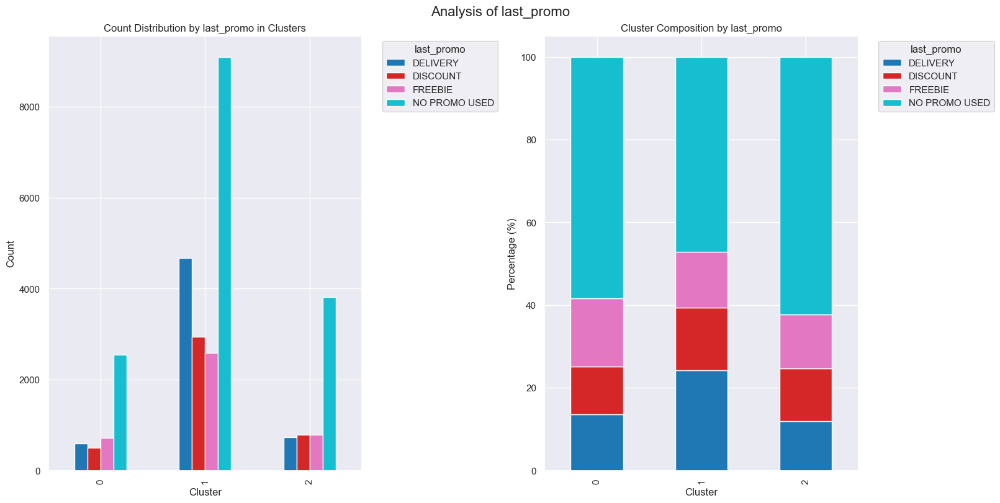

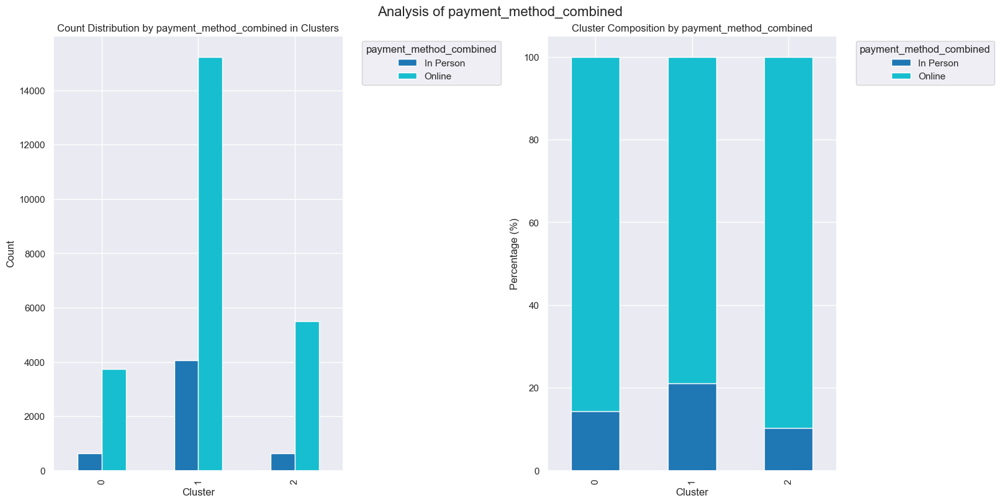

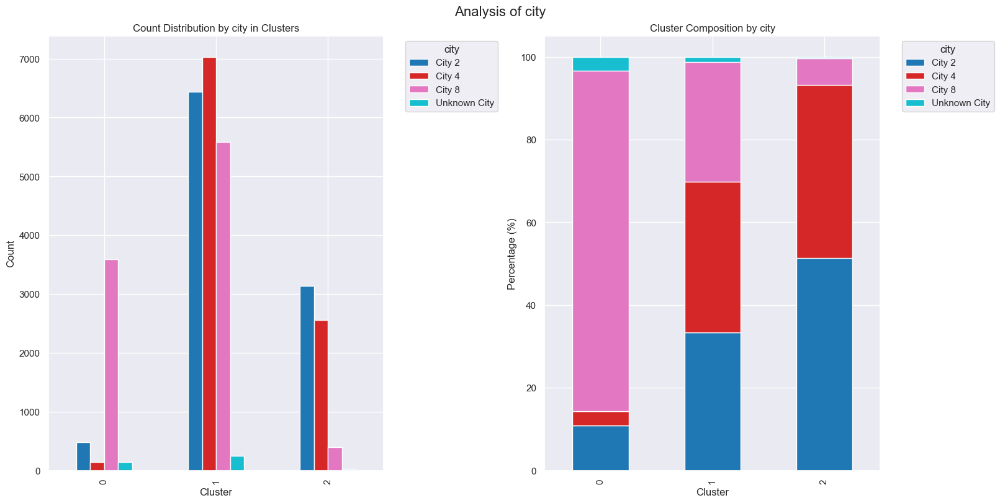

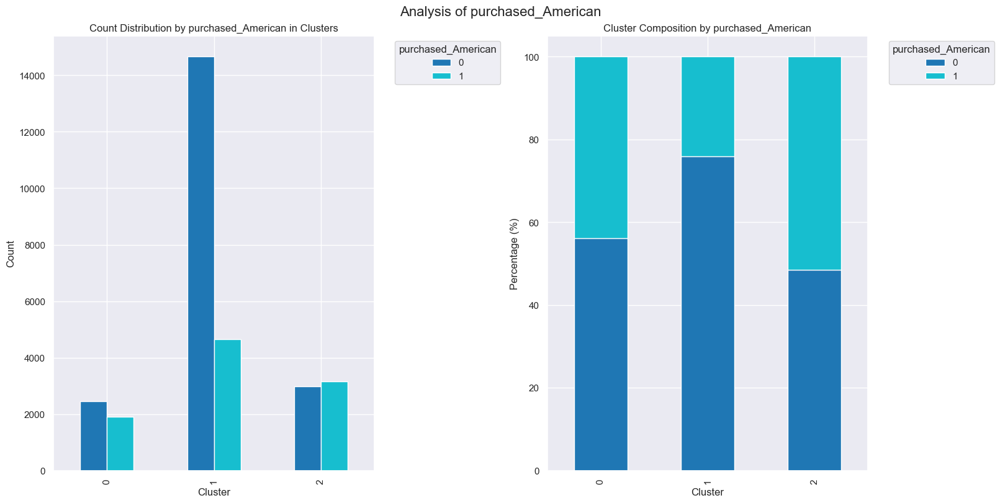

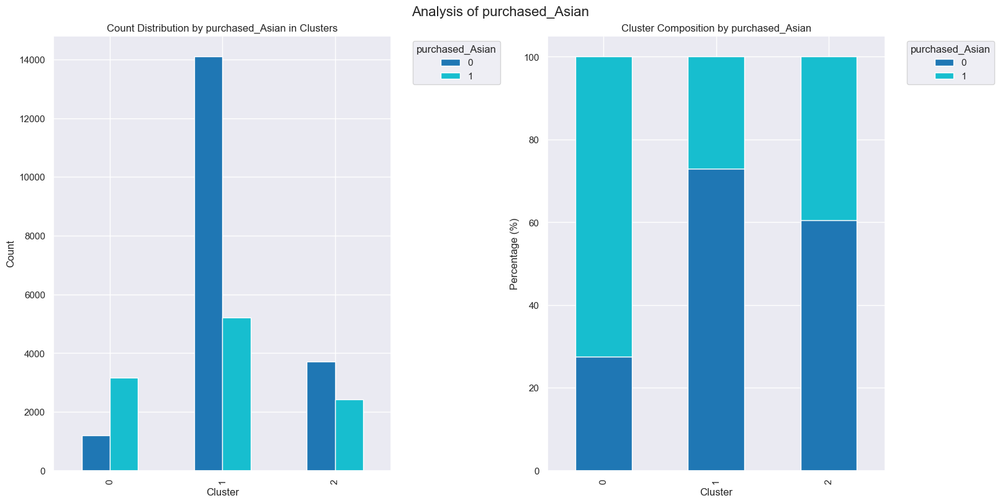

...

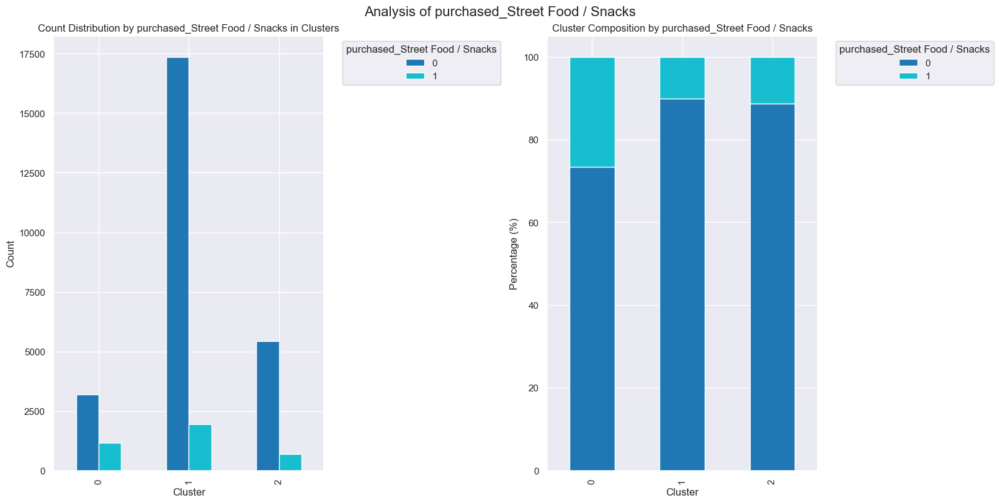

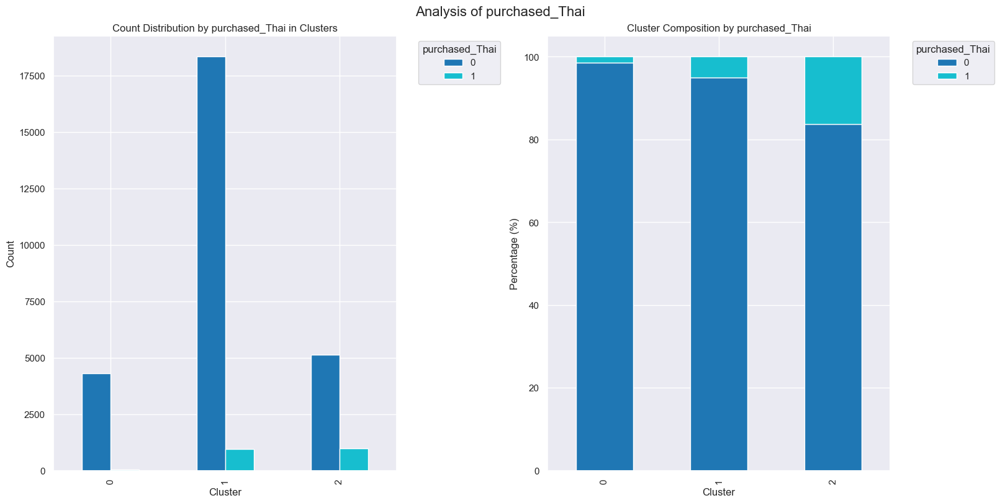

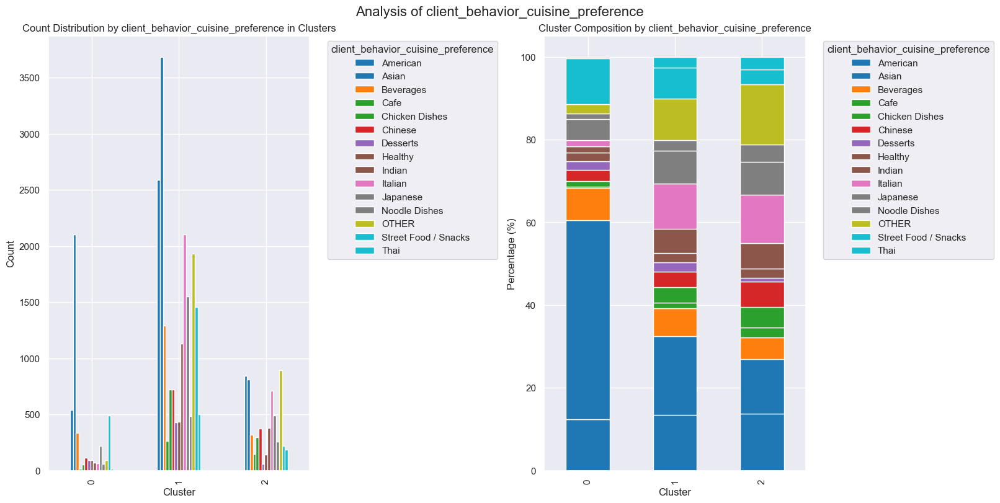

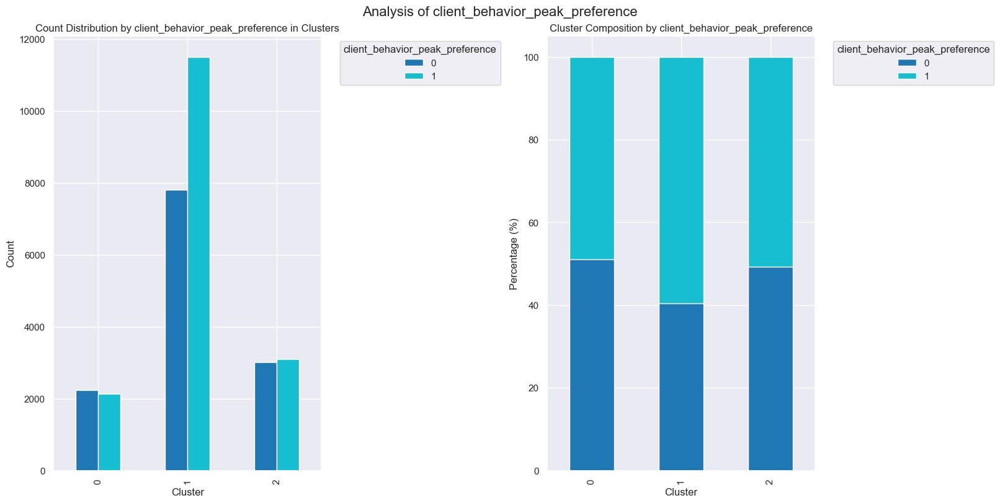

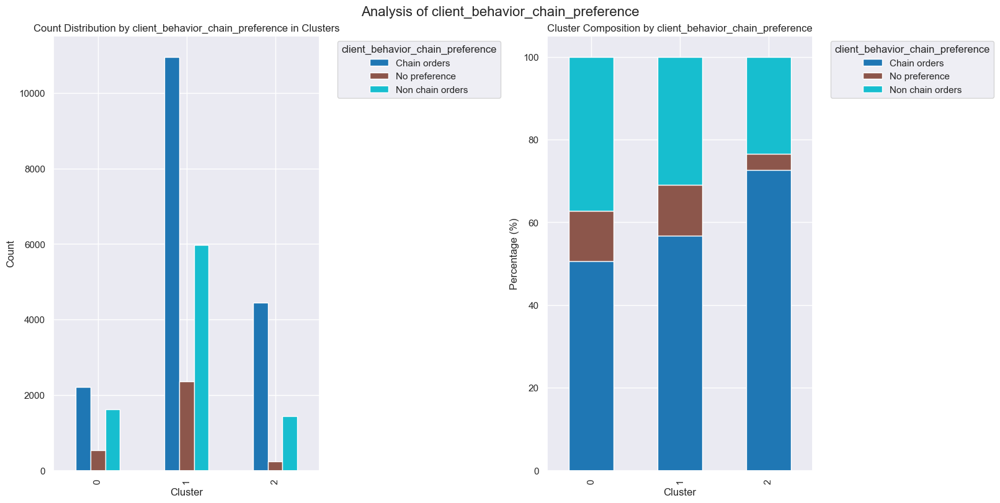

In [894]:
cluster_composition_and_count_categorical(df_real_values, categorical_features, "activity_engagement_perspective", figsize=(16, 8))

> Once again, this was intepreted in the cluster profiling section of the final report.

## 8.2 Merging both perspectives



In [895]:
df_profiling = df_clustering.copy()
df_profiling["value_preference_perspective"] = labels_value_preference_perspective
df_profiling["activity_engagement_perspective"] = labels_activatiy_engagement_perspective

df_profiling_real_values = df_real_values.copy()
df_profiling_real_values["value_preference_perspective"] = labels_value_preference_perspective
df_profiling_real_values["activity_engagement_perspective"] = labels_activatiy_engagement_perspective

In [896]:
pd.crosstab(df_profiling_real_values["activity_engagement_perspective"],df_profiling_real_values["value_preference_perspective"])

value_preference_perspective,0,1,2
activity_engagement_perspective,,,
0,1101,1916,1347
1,4034,5244,10025
2,322,2335,3468


> Based on what we have at the moment, merging the two perspectives would result in the 9 different clusters we can see above, with some having a much lower frequency than others.
>
> To tackle these issues (clusters with low frequency and a high number of clusters), we will try to merge the clusters in a way that makes sense and is interpretable.
>
> To merge the nine clusters, we will try the following approaches:
>
> 1. Merge the lowest frequency clusters with the closest cluster by comparing differences between cluster centroids.
> 2. Merge clusters based on a hierarchical clustering dendrogram.
>
> The results of both approaches will be compared, we will select the best one, and, following that, our final clusters will be selected.

### 8.2.1 Merging Clusters using Manual approach

The manual merging approach consists of the following steps:

1. Identifying the lowest frequency clusters in the merged approach based on a defined threshold. In this case, we use a threshold of 15% of total observations (0.15*30k), meaning that all clusters with less than 4500 observations will be merged.
2. Merging the lowest frequency clusters into the closest cluster based on the Euclidean distance between the cluster centroids.

In [897]:
df_profiling_ma = df_profiling.copy()
df_profiling_ma_real_values = df_profiling_real_values.copy()

#### First Iteration

Clusters with less than 4.5k observations

In [898]:
# (activity_engagement_perspective, value_preference_perspective)
#to_merge = [(2,0), (0,0), (0,1), (2,1), (0,2)]
to_merge = [(0,0), (0,1), (0,2), (1,0), (2,0), (2,1), (2,2)]

Centroids of clusters

In [899]:
df_centroids = df_profiling_ma.groupby(["activity_engagement_perspective", "value_preference_perspective"]).mean()
df_centroids

customer_age  \
activity_engagement_perspective value_preference_perspective                 
0                               0                                 0.010118   
                                1                                 0.004960   
                                2                                -0.001784   
1                               0                                -0.009179   
                                1                                 0.002559   
                                2                                -0.012870   
2                               0                                -0.014819   
                                1                                -0.035152   
                                2                                -0.011382   

                                                              vendor_count  \
activity_engagement_perspective value_preference_perspective                 
0                               0                                 0.469888   
                                1                                 0.720674   
                                2                                 0.368293   
1                               0                                -0.694258   
                                1                                -0.532913   
                                2                                -0.437541   
2                               0                                 0.830569   
                                1                                 0.973956   
                                2                                 1.103360   

                                                              product_count  \
activity_engagement_perspective value_preference_perspective                  
0                               0                                  0.718750   
                                1                                  0.564205   
                                2                                  0.139167   
1                               0                                 -0.264282   
                                1                                 -0.609721   
                                2                                 -0.637848   
2                               0                                  1.484387   
                                1                                  1.227887   
                                2                                  1.079804   

                                                              tot_chain_orders  \
activity_engagement_perspective value_preference_perspective                     
0                               0                                     0.049609   
                                1                                    -0.213596   
                                2                                     0.352481   
1                               0                                    -0.501252   
                                1                                    -0.742498   
                                2                                    -0.189894   
2                               0                                     0.860343   
                                1                                     0.288118   
                                2                                     1.490397   

                                                              first_order  \
activity_engagement_perspective value_preference_perspective                
0                               0                               -0.176743   
                                1                               -0.254237   
                                2                               -0.209808   
1                               0                                0.412260   
                                1                                0.285849   
                                

In [900]:
# Computing the euclidean distance matrix between the centroids
centroid_dists = pairwise_distances(df_centroids)

df_dists = pd.DataFrame(
    centroid_dists, 
    columns=df_centroids.index, 
    index=df_centroids.index
)

df_dists

activity_engagement_perspective                                      0  \
value_preference_perspective                                         0   
activity_engagement_perspective value_preference_perspective             
0                               0                             0.000000   
                                1                             2.132356   
                                2                             2.885262   
1                               0                             3.666769   
                                1                             4.386752   
                                2                             4.606336   
2                               0                             3.449515   
                                1                             4.518948   
                                2                             5.004769   

activity_engagement_perspective                                         \
value_preference_perspective                                         1   
activity_engagement_perspective value_preference_perspective             
0                               0                             2.132356   
                                1                             0.000000   
                                2                             2.610392   
1                               0                             4.586138   
                                1                             3.958072   
                                2                             4.573497   
2                               0                             4.058875   
                                1                             3.706993   
                                2                             4.705764   

activity_engagement_perspective                                         \
value_preference_perspective                                         2   
activity_engagement_perspective value_preference_perspective             
0                               0                             2.885262   
                                1                             2.610392   
                                2                             0.000000   
1                               0                             4.072904   
                                1                             3.655526   
                                2                             2.873276   
2                               0                             4.385957   
                                1                             4.604827   
                                2                             3.890174   

activity_engagement_perspective                                      1  \
value_preference_perspective                                         0   
activity_engagement_perspective value_preference_perspective             
0                               0                             3.666769   
                                1                             4.586138   
                                2                             4.072904   
1                               0                             0.000000   
                                1                             2.873787   
                                2                             3.159451   
2                               0                             4.831082   
                                1                             5.762812   
                                2                             5.914125   

activity_engagement_perspective                                             \
value_preference_perspective                                             1   
activity_engagement_perspective value_preference_perspective                 
0                               0                             4.386752e+00   
                                1                             3.958072e+00   
                                2                     

In [901]:
# Merging each low frequency clustering (source) 
# to the closest cluster (target)

source_target = {}

for clus in to_merge:
    # If cluster to merge (source) has not yet been used as target
    if clus not in source_target.values():
        # Add this cluster to source_target map as key
        # Use the cluster with the smallest distance to it as value
        source_target[clus] = df_dists.loc[clus].sort_values().index[1]

source_target

{(0, 0): (0, 1),
 (0, 2): (0, 1),
 (1, 0): (1, 1),
 (2, 0): (2, 1),
 (2, 2): (2, 1)}

In [902]:
# Changing the behavior_labels and product_labels based on source_target

for source, target in source_target.items():
    # Create the mask for both DataFrames
    mask_profiling = (
        (df_profiling_ma['activity_engagement_perspective'] == source[0]) &
        (df_profiling_ma['value_preference_perspective'] == source[1])
    )
    mask_real_values = (
        (df_profiling_ma_real_values['activity_engagement_perspective'] == source[0]) &
        (df_profiling_ma_real_values['value_preference_perspective'] == source[1])
    )
    
    # Apply changes to df_profiling
    df_profiling_ma.loc[mask_profiling, 'activity_engagement_perspective'] = target[0]
    df_profiling_ma.loc[mask_profiling, 'value_preference_perspective'] = target[1]
    
    # Apply changes to df_profiling_real_values
    df_profiling_ma_real_values.loc[mask_real_values, 'activity_engagement_perspective'] = target[0]
    df_profiling_ma_real_values.loc[mask_real_values, 'value_preference_perspective'] = target[1]


In [903]:
pd.crosstab(df_profiling_ma_real_values["activity_engagement_perspective"],df_profiling_ma_real_values["value_preference_perspective"])

value_preference_perspective,1,2
activity_engagement_perspective,,
0,4364,0
1,9278,10025
2,6125,0


Key notes

> Following the manual approach and a threshold of 15% of the total number of customers, we have merged the clusters (0,0), (0,1), (0,2), (1,0), (2,0), (2,1), (2,2) into their closest cluster.
>
> Reduced the initial 9 clusters to 4 clusters. This allows the marketing team to focus on 4 different customer segments.

---

### 8.2.2 Merging Clusters using Hierarchical Clustering

In [904]:
df_profiling_hc = df_profiling.copy()
df_profiling_hc_real_values = df_profiling_real_values.copy()

Centroids of clusters

In [905]:
df_centroids = df_profiling_hc.groupby(["activity_engagement_perspective", "value_preference_perspective"]).mean()
df_centroids

customer_age  \
activity_engagement_perspective value_preference_perspective                 
0                               0                                 0.010118   
                                1                                 0.004960   
                                2                                -0.001784   
1                               0                                -0.009179   
                                1                                 0.002559   
                                2                                -0.012870   
2                               0                                -0.014819   
                                1                                -0.035152   
                                2                                -0.011382   

                                                              vendor_count  \
activity_engagement_perspective value_preference_perspective                 
0                               0                                 0.469888   
                                1                                 0.720674   
                                2                                 0.368293   
1                               0                                -0.694258   
                                1                                -0.532913   
                                2                                -0.437541   
2                               0                                 0.830569   
                                1                                 0.973956   
                                2                                 1.103360   

                                                              product_count  \
activity_engagement_perspective value_preference_perspective                  
0                               0                                  0.718750   
                                1                                  0.564205   
                                2                                  0.139167   
1                               0                                 -0.264282   
                                1                                 -0.609721   
                                2                                 -0.637848   
2                               0                                  1.484387   
                                1                                  1.227887   
                                2                                  1.079804   

                                                              tot_chain_orders  \
activity_engagement_perspective value_preference_perspective                     
0                               0                                     0.049609   
                                1                                    -0.213596   
                                2                                     0.352481   
1                               0                                    -0.501252   
                                1                                    -0.742498   
                                2                                    -0.189894   
2                               0                                     0.860343   
                                1                                     0.288118   
                                2                                     1.490397   

                                                              first_order  \
activity_engagement_perspective value_preference_perspective                
0                               0                               -0.176743   
                                1                               -0.254237   
                                2                               -0.209808   
1                               0                                0.412260   
                                1                                0.285849   
                                

In [906]:
# Using Hierarchical clustering to merge the concatenated cluster centroids
linkage = 'ward'
hclust = AgglomerativeClustering(
    linkage=linkage, 
    metric='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)

hclust_labels = hclust.fit_predict(df_centroids)

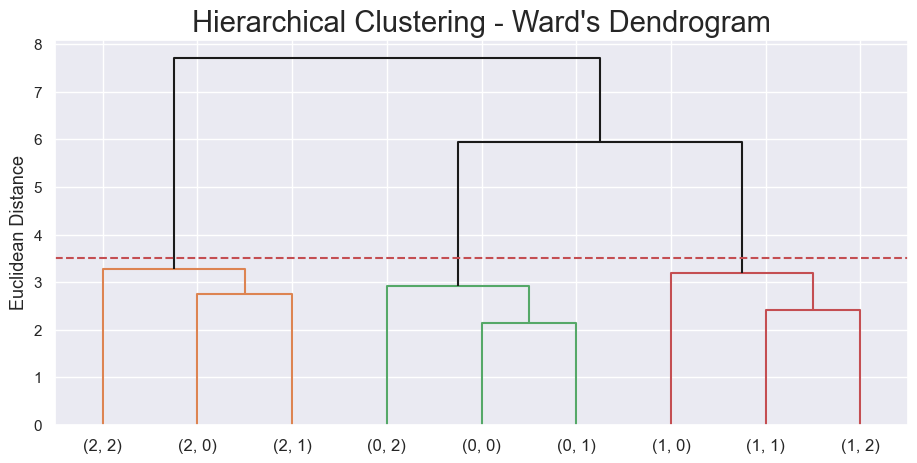

In [907]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py

# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned

y_threshold = 3.5
# y_threshold = 3.3

dendrogram(linkage_matrix, 
           truncate_mode='level', 
           labels=df_centroids.index, p=5, 
           color_threshold=y_threshold, 
           above_threshold_color='k')

plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('')
plt.ylabel(f'Euclidean Distance', fontsize=13)
plt.show()

> Considering the dendrogram, it seems like the optimal number of final clusters is 3 with a threshold of 3.5 for the Euclidean distance.
>
> 3 final clusters seem to be the best trade-off between a reduced number of clusters, considering the smaller budget of the marketing team, and the distance between them.

### 8.2.3 Comparing the Two Final Solutions

> Based on the Manual Approach

1. With a threshold of 15% of total observations, the manual approach resulted in a reduction from an initial 9 clusters to 4 clusters.

2. The aggregation process was as follows:
    - (0, 0) -> (0, 1)
    - (0, 2) -> (0, 1)
    - (1, 0) -> (1, 1)
    - (2, 0) -> (2, 1)
    - (2, 2) -> (2, 1)

3. Final clusters are (0,1), (1,1), (2,1), and (1,2).

> Based on the Hierarchical Clustering Approach

1. The aggregation process was as follows sequentially:
    - (0,0) -> (0,1)
    - (1,1) -> (1,2)
    - (2,0) -> (2,1)
    - (0,2) -> (0,1)
    - (1,0) -> (1,2)
    - (2,1) -> (2,2)

> We will select the clusters obtained using the Hierarchical Clustering process to merge the clusters in their original perspective.
>
> We made this decision considering that the hierarchical clustering process is only concerned with the distances between clusters and not the number of observations in each cluster, and it selects a fewer number of final clusters.

Hirarchical clustering final solution

In [908]:
# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(
    linkage='ward', 
    metric='euclidean', 
    n_clusters=3
)
hclust_labels = hclust.fit_predict(df_centroids)
df_centroids['hclust_labels'] = hclust_labels

df_centroids  # centroid's cluster labels

customer_age  \
activity_engagement_perspective value_preference_perspective                 
0                               0                                 0.010118   
                                1                                 0.004960   
                                2                                -0.001784   
1                               0                                -0.009179   
                                1                                 0.002559   
                                2                                -0.012870   
2                               0                                -0.014819   
                                1                                -0.035152   
                                2                                -0.011382   

                                                              vendor_count  \
activity_engagement_perspective value_preference_perspective                 
0                               0                                 0.469888   
                                1                                 0.720674   
                                2                                 0.368293   
1                               0                                -0.694258   
                                1                                -0.532913   
                                2                                -0.437541   
2                               0                                 0.830569   
                                1                                 0.973956   
                                2                                 1.103360   

                                                              product_count  \
activity_engagement_perspective value_preference_perspective                  
0                               0                                  0.718750   
                                1                                  0.564205   
                                2                                  0.139167   
1                               0                                 -0.264282   
                                1                                 -0.609721   
                                2                                 -0.637848   
2                               0                                  1.484387   
                                1                                  1.227887   
                                2                                  1.079804   

                                                              tot_chain_orders  \
activity_engagement_perspective value_preference_perspective                     
0                               0                                     0.049609   
                                1                                    -0.213596   
                                2                                     0.352481   
1                               0                                    -0.501252   
                                1                                    -0.742498   
                                2                                    -0.189894   
2                               0                                     0.860343   
                                1                                     0.288118   
                                2                                     1.490397   

                                                              first_order  \
activity_engagement_perspective value_preference_perspective                
0                               0                               -0.176743   
                                1                               -0.254237   
                                2                               -0.209808   
1                               0                                0.412260   
                                1                                0.285849   
                                

In [909]:
cluster_mapper_hc = df_centroids['hclust_labels'].to_dict()
cluster_mapper_hc

{(0, 0): 2,
 (0, 1): 2,
 (0, 2): 2,
 (1, 0): 1,
 (1, 1): 1,
 (1, 2): 1,
 (2, 0): 0,
 (2, 1): 0,
 (2, 2): 0}

In [910]:
# Mapping the hierarchical clusters on the centroids to the observations
df_profiling_hc['merged_labels'] = df_profiling_hc.apply(
    lambda row: cluster_mapper_hc[
        (row['activity_engagement_perspective'], row['value_preference_perspective'])
    ], axis=1
)

df_profiling_hc_real_values['merged_labels'] = df_profiling_hc_real_values.apply(
    lambda row: cluster_mapper_hc[
        (row['activity_engagement_perspective'], row['value_preference_perspective'])
    ], axis=1
)

## 8.3 Analyse Final Cluster Solution


In [914]:
df_profiling_final = df_profiling_hc.copy()
df_profiling_final_real_values = df_profiling_hc_real_values.copy()

In [915]:
# Combined features used in both perspectives for clustering

features_used_clustering_both_perspectives = df_value_preference_perspective_fs.columns.tolist() + df_activity_engagement_perspective_fs.columns.tolist()
features_used_clustering_both_perspectives = [element for element in features_used_clustering_both_perspectives if element not in ["value_preference_perspective", "activity_engagement_perspective"]]
features_used_clustering_both_perspectives

['tot_money_spent_per_client',
 'avg_money_spent_per_order',
 'avg_products_per_order',
 'tot_non_chain_orders',
 'percent_chain_orders',
 'num_unique_cuisines_tried',
 'peak_days_num_orders',
 'off_peak_days_num_orders',
 'morning_num_orders',
 'afternoon_num_orders',
 'evening_num_orders',
 'night_num_orders']

Centroids for the merged clusters for features used in the clustering process for both perspectives

- This doesn't include features that were initially considered and then unused after feature selection in each perspective

In [916]:
df_profiling_final.groupby("merged_labels")[features_used_clustering_both_perspectives].mean()

,tot_money_spent_per_client,avg_money_spent_per_order,avg_products_per_order,tot_non_chain_orders,percent_chain_orders,num_unique_cuisines_tried,peak_days_num_orders,off_peak_days_num_orders,morning_num_orders,afternoon_num_orders,evening_num_orders,night_num_orders
merged_labels,,,,,,,,,,,,
0,0.473696,-0.479487,-0.078761,0.444498,0.180040,1.040286,0.974996,0.958269,0.491946,1.000972,0.948062,-0.351562
1,-0.406034,0.051506,-0.009136,-0.309334,-0.011143,-0.438607,-0.419795,-0.461932,-0.288065,-0.297917,-0.242682,-0.342937
2,0.702148,0.444286,0.068919,0.348512,-0.178829,0.197111,0.197356,0.372074,0.342719,-0.480394,-0.471330,1.929288


FInal clustering solution size

In [917]:
# Merge cluster contigency table
# Getting size of each final cluster
df_counts = df_profiling_final.groupby('merged_labels')\
    .size()\
    .to_frame()

df_counts

,0
merged_labels,
0,6125
1,19303
2,4364


### 8.3.1 EDA for features during the clustering process

Analyzing the Average Variation of Features in Each Cluster

- Here, we are using the transformed and scaled values of the data.
- This means the values can be used for comparison to determine whether the means are higher in certain clusters, but we cannot focus on the actual values themselves.

/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:37: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.barplot(x=label,
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:37: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.barplot(x=label,
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:37: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.barplot(x=label,


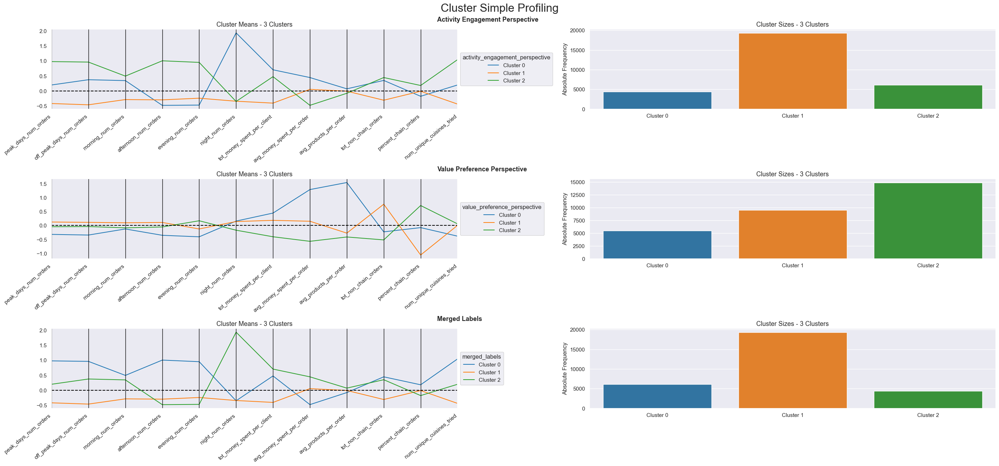

In [918]:
cluster_profiles(
    df=df_profiling_final[df_activity_engagement_perspective_fs.columns.tolist() + df_value_preference_perspective_fs.columns.tolist() + ['merged_labels']],
    label_columns=["activity_engagement_perspective","value_preference_perspective", "merged_labels"],
    figsize=(28, 13),
    compare_titles=["Activity Engagement Perspective","Value Preference Perspective", "Merged Labels"]
)

Notes

> As we can see, the merged clustering solution plot related to the average value for the features used in the clustering process is the same as the plot related to the activity and engagement perspective.
>
> This means that the activity and engagement perspective is the dominant perspective in the clustering process.
>
> When analyzing the average value for the features used in the clustering process for the merged labels, we can see that the variation/differences between clusters in the average values for the features related to the value and preference perspective are quite small.
>
> This situation could be happening for a multitude of reasons, namely:
>
> 1. Clusters in the activity and engagement perspective could be more distinct or more well-separated than the ones in the value preference perspective.
> 2. There could be minimal variation in value and preference features across clusters in the merged solution, leading to their importance being negligible.

Descriptive statistics for each cluster using the real values instead of transformed and scaled ones

In [919]:
# Set display options to show more rows and columns
pd.set_option('display.max_rows', None)  # None removes the row limit
pd.set_option('display.max_columns', None)  # None removes the column limit
pd.set_option('display.width', 1000)  # Adjust the width for better horizontal readability

# Run your descriptive stats function
merged_labels_statistics_activity_engagem_perspective = descriptive_stats_by_cluster(df_profiling_final_real_values[df_activity_engagement_perspective_fs.columns.tolist() + ['merged_labels']] , 
                                             "merged_labels")

merged_labels_statistics_value_pref_perspective = descriptive_stats_by_cluster(df_profiling_final_real_values[df_value_preference_perspective_fs.columns.tolist() + ['merged_labels']] , 
                                             "merged_labels")

# Reset options to default after displaying
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')
pd.reset_option('display.width')

Descriptive Statistics by Cluster:


peak_days_num_orders                                               off_peak_days_num_orders                                               morning_num_orders                                               afternoon_num_orders                                               evening_num_orders                                               night_num_orders                                               activity_engagement_perspective                                   
                             count      mean       std  min  25%  50%  75%   max                    count      mean       std  min  25%  50%  75%   max              count      mean       std  min  25%  50%  75%   max                count      mean       std  min  25%  50%  75%   max              count      mean       std  min  25%  50%  75%   max            count      mean       std  min  25%  50%  75%   max                           count mean  std  min  25%  50%  75%  max
merged_labels                                                                                                                                                                                                                                                                                                                                                                                                                                                                                 
0                           6125.0  3.607673  2.079033  0.0  2.0  3.0  5.0  13.0                   6125.0  4.059265  2.445603  0.0  2.0  4.0  5.0  14.0             6125.0  1.834939  2.077928  0.0  0.0  1.0  3.0  16.0               6125.0  3.739592  2.430808  0.0  2.0  3.0  5.0  14.0             6125.0  1.955592  2.043131  0.0  0.0  1.0  3.0  15.0           6125.0  0.136816  0.437719  0.0  0.0  0.0  0.0   5.0                          6125.0  2.0  0.0  2.0  2.0  2.0  2.0  2.0
1                          19303.0  1.045433  0.941429  0.0  0.0  1.0  2.0   6.0                  19303.0  1.035176  0.990241  0.0  0.0  1.0  2.0   7.0            19303.0  0.597109  0.903307  0.0  0.0  0.0  1.0   7.0              19303.0  0.987463  1.031344  0.0  0.0  1.0  2.0   5.0            19303.0  0.362223  0.657695  0.0  0.0  0.0  1.0   4.0          19303.0  0.133813  0.340461  0.0  0.0  0.0  0.0   1.0                         19303.0  1.0  0.0  1.0  1.0  1.0  1.0  1.0
2                           4364.0  2.051100  1.570383  0.0  1.0  2.0  3.0  11.0                   4364.0  2.583410  1.803595  0.0  1.0  2.0  3.0  11.0             4364.0  1.506187  1.637070  0.0  0.0  1.0  2.0  13.0               4364.0  0.600825  0.965202  0.0  0.0  0.0  1.0   7.0             4364.0  0.148488  0.523082  0.0  0.0  0.0  0.0   6.0           4364.0  2.379010  1.352506  1.0  1.0  2.0  3.0  11.0                          4364.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0

Descriptive Statistics by Cluster:


tot_money_spent_per_client                                                               avg_money_spent_per_order                                                                      avg_products_per_order                                                             tot_non_chain_orders                                               percent_chain_orders                                                                num_unique_cuisines_tried                                               value_preference_perspective                                             
                                   count       mean        std   min      25%     50%      75%     max                     count       mean       std    min       25%      50%        75%        max                  count      mean       std  min       25%       50%  75%       max                count      mean       std  min  25%  50%  75%   max                count       mean        std  min        25%        50%    75%    max                     count      mean       std  min  25%  50%  75%   max                        count      mean       std  min  25%  50%  75%  max
merged_labels                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                    
0                                 6125.0  50.107582  30.948697  3.10  27.1700  42.790  65.1700  229.23                    6125.0   6.692001  3.719995  0.775  3.986667   5.8910   8.425000  33.824000                 6125.0  1.261303  0.227784  1.0  1.111111  1.200000  1.4  3.000000               6125.0  2.239347  2.404584  0.0  0.0  1.0  4.0  12.0               6125.0  69.801041  30.975235  0.0  50.000000  80.000000  100.0  100.0                    6125.0  3.649143  1.526866  1.0  3.0  3.0  5.0  11.0                       6125.0  1.513633  0.595831  0.0  1.0  2.0  2.0  2.0
1                                19303.0  20.282256  15.866417  0.37   9.3250  17.340  25.4200  178.81                   19303.0  10.845223  8.474246  0.370  5.250000   8.5000  13.895000  88.590000                19303.0  1.290186  0.457833  1.0  1.000000  1.000000  1.5  5.000000              19303.0  0.764544  0.944827  0.0  0.0  1.0  1.0   7.0              19303.0  62.366928  42.224895  0.0   0.000000  80.000000  100.0  100.0                   19303.0  1.605864  0.728486  1.0  1.0  1.0  2.0   5.0                      19303.0  1.310366  0.795008  0.0  1.0  2.0  2.0  2.0
2                                 4364.0  57.852729  40.901099  3.38  29.6275  47.275  75.0575  272.85                    4364.0  12.708860  6.451834  1.114  8.315333  12.0155  16.055417  51.546667                 4364.0  1.322566  0.323972  1.0  1.000000  1.258333  1.5  3.333333               4364.0  2.051558  1.842989  0.0  1.0  2.0  3.0  12.0               4364.0  55.846484  32.196599  0.0  33.333333  55.555556   80.0  100.0                    4364.0  2.484189  1.099237  1.0  2.0  2.0  3.0   7.0                       4364.0  1.056370  0.746929  0.0  0.0  1.0  2.0  2.0

Histograms of features used in Value and Preference Perspective considering the merged labels

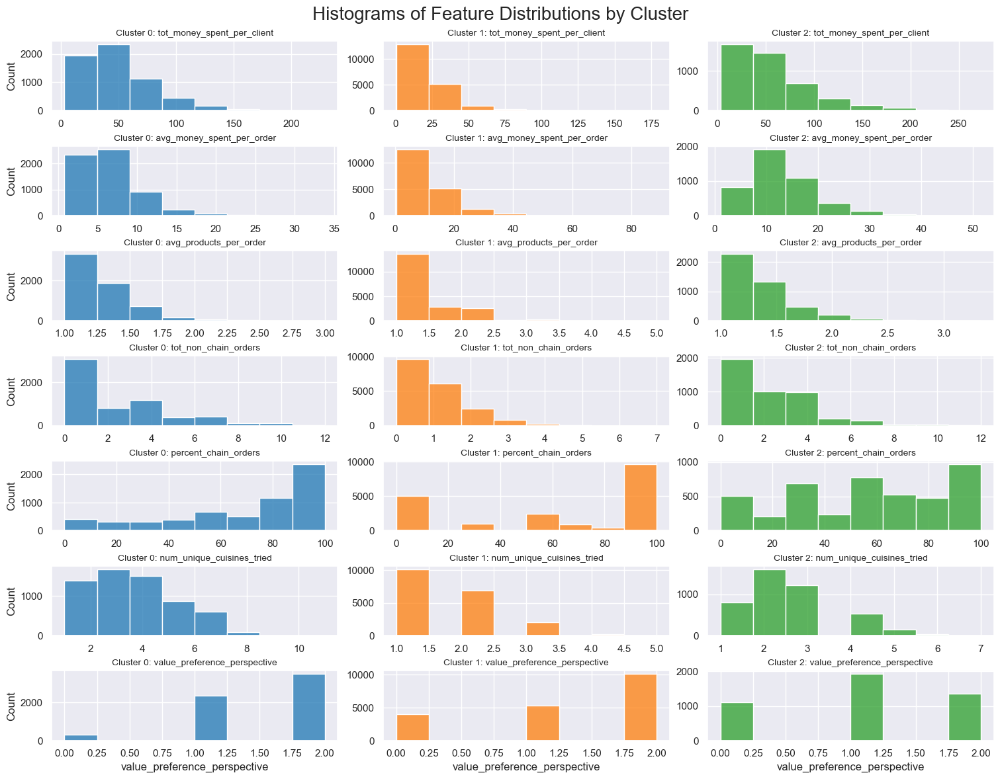

In [920]:
histograms_by_cluster(df_profiling_final_real_values[df_value_preference_perspective_fs.columns.tolist() + ['merged_labels']], "merged_labels", bins=8, figsize=(15, 10))

Histograms of features used in Activity and Engagement Perspective considering the merged labels

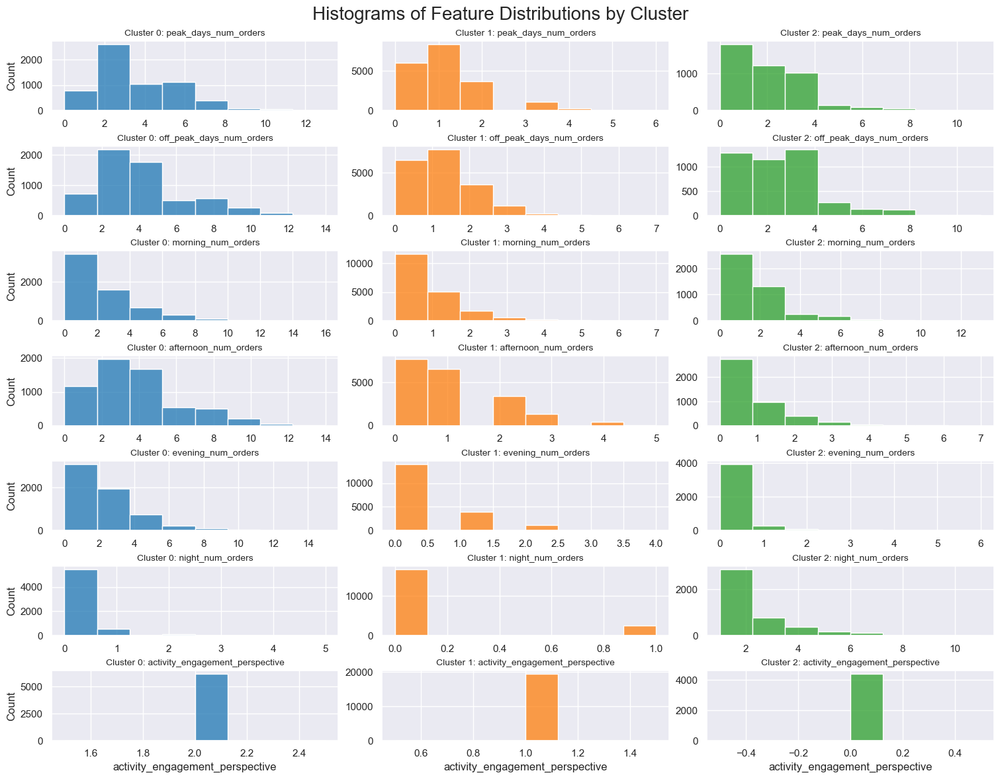

In [921]:
histograms_by_cluster(df_profiling_final_real_values[df_activity_engagement_perspective_fs.columns.tolist() + ['merged_labels']], "merged_labels", bins=8, figsize=(15, 10))

> The cluster profiling was done on the final report.


Boxplots for features used in Value and Preference Perspective considering the merged labels

/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(

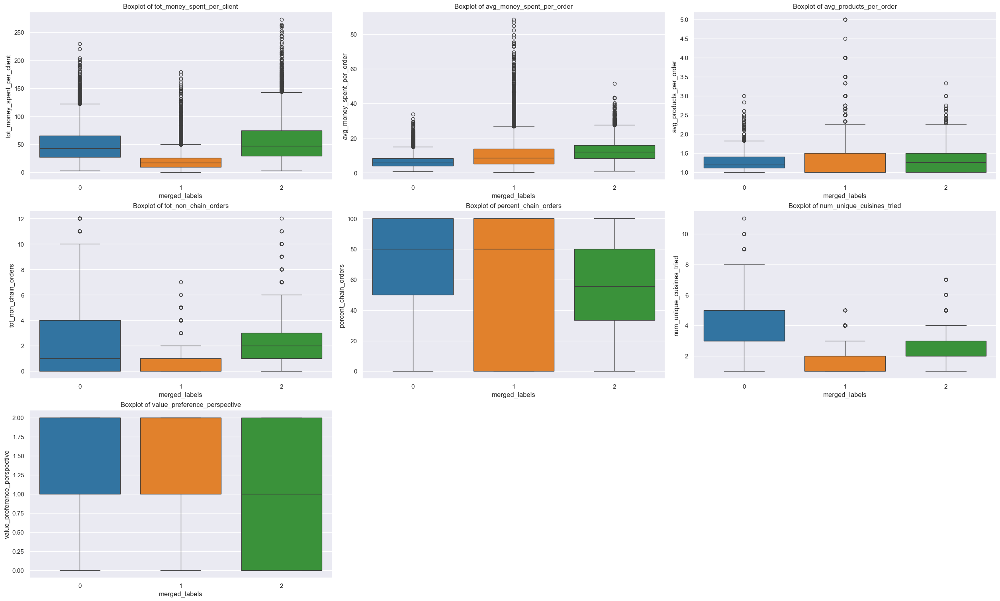

In [922]:
boxplots_by_cluster(df_profiling_final_real_values[df_value_preference_perspective_fs.columns.tolist() + ['merged_labels']], "merged_labels", figsize=(25, 15))

Boxplots for features used in Activity and Engagement Perspective considering the merged labels

/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(

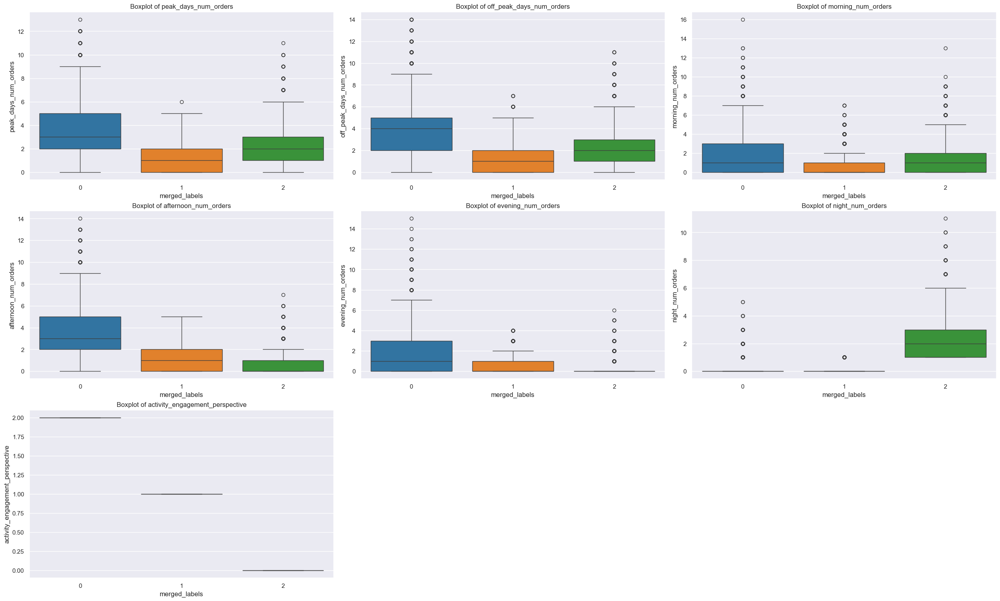

In [923]:
boxplots_by_cluster(df_profiling_final_real_values[df_activity_engagement_perspective_fs.columns.tolist() + ['merged_labels']], "merged_labels", figsize=(25, 15))

> The cluster profiling was done on the final report

### 8.3.2 EDA for unused features

#### Categorical features

Bar chart with absolute count and percentages

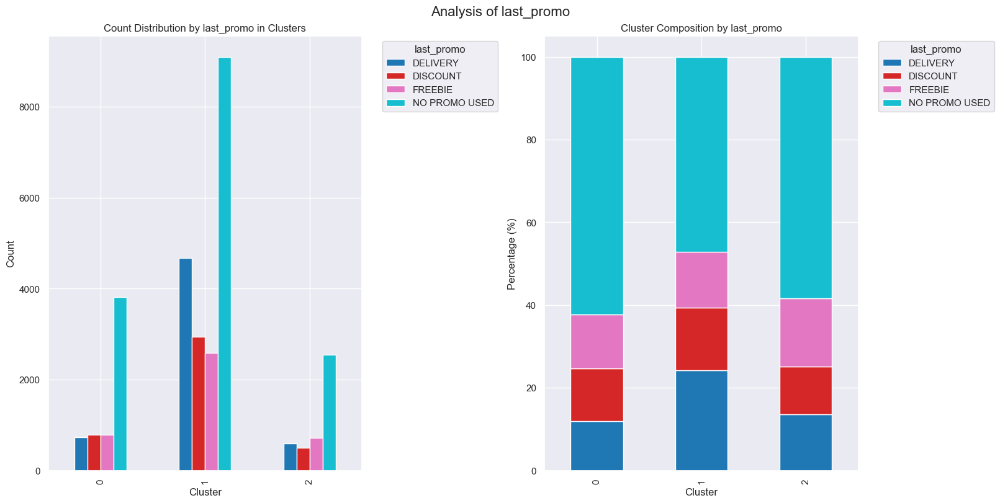

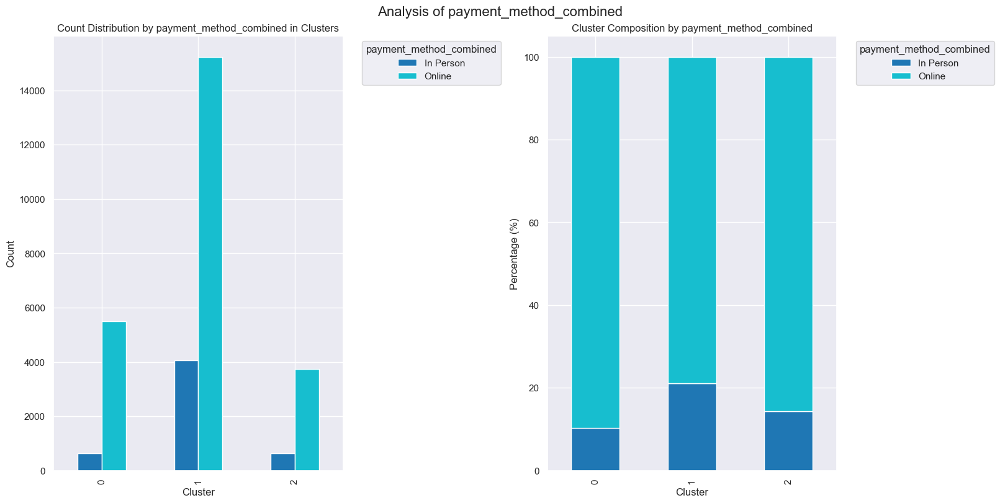

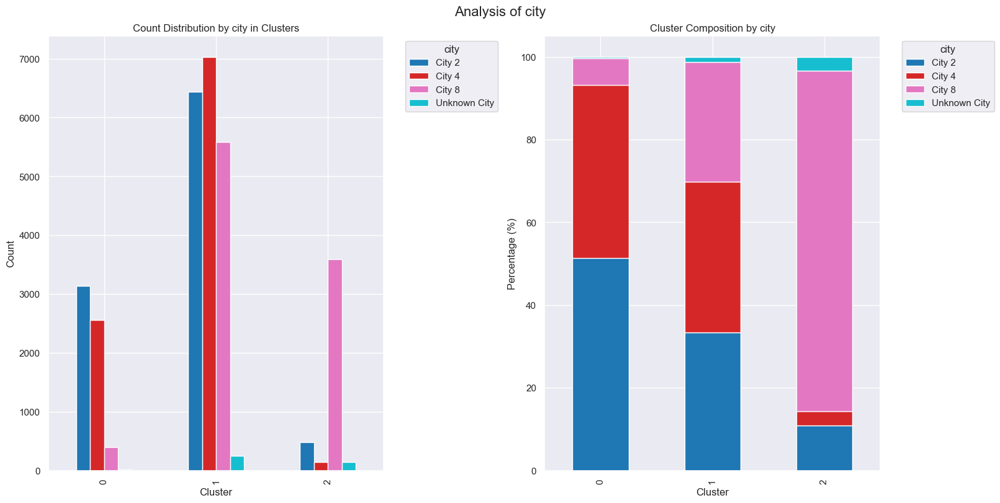

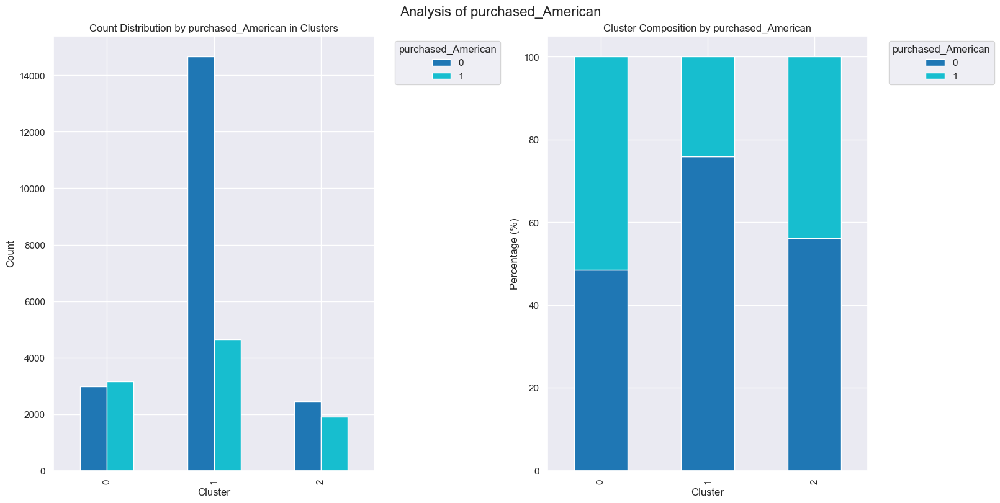

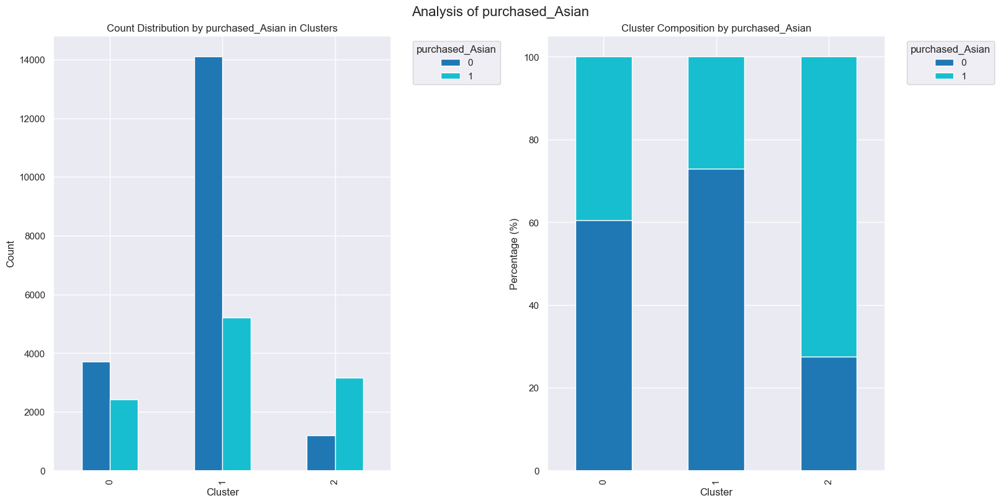

...

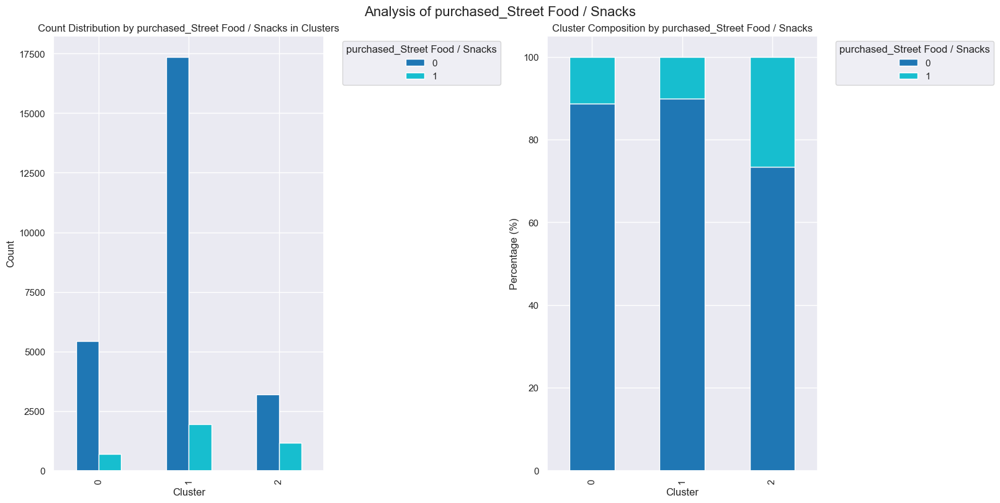

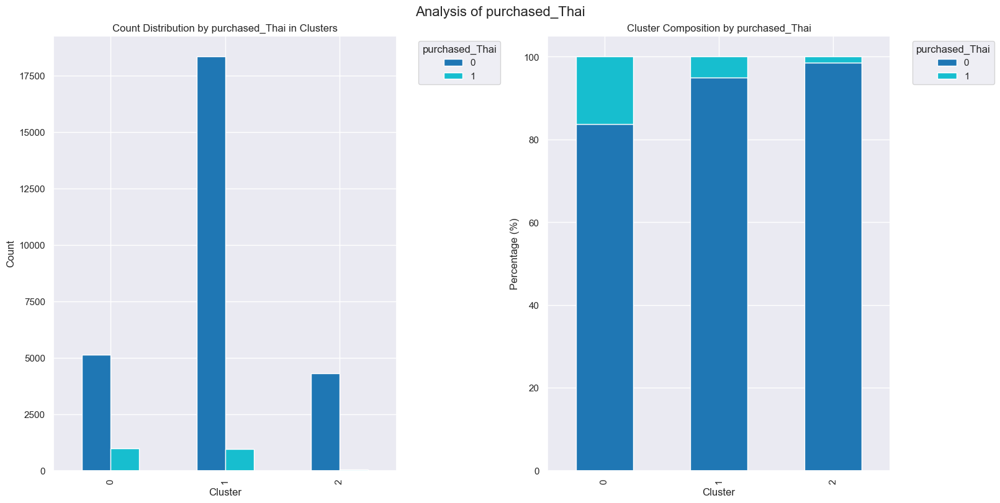

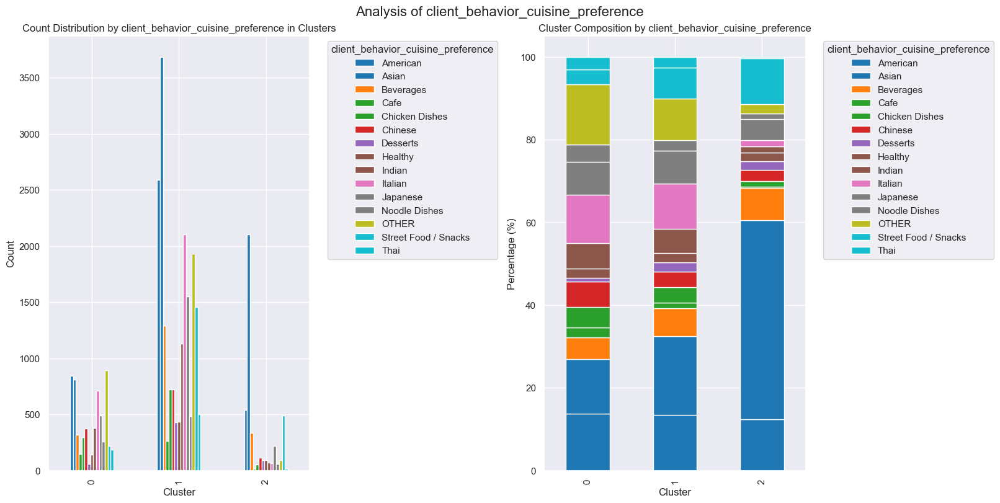

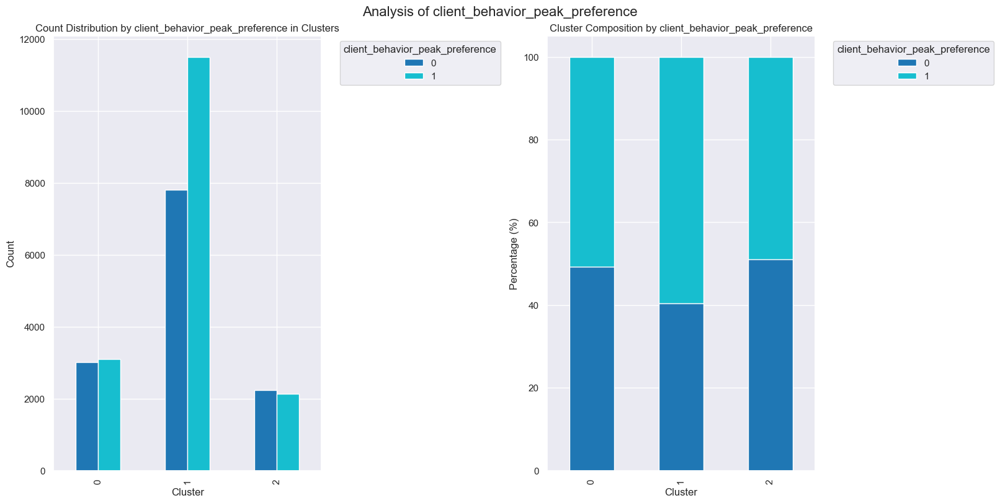

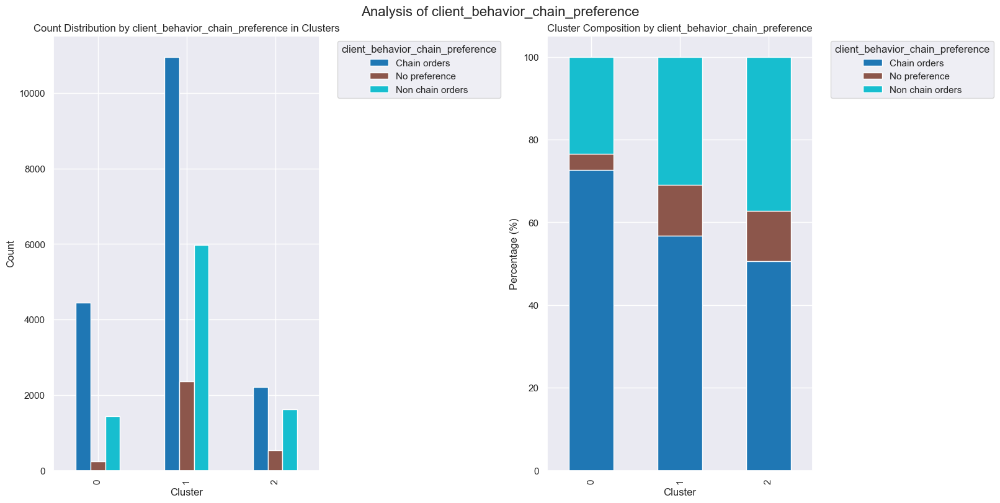

In [924]:
cluster_composition_and_count_categorical(df_profiling_final_real_values, categorical_features, "merged_labels", figsize=(16, 8))

#### Unused numerical features during the clustering process

In [925]:
unused_numerical_features = [element for element in df_profiling_final_real_values.columns if element not in features_used_clustering_both_perspectives and element not in categorical_features and element not in ["merged_labels", "activity_engagement_perspective", "value_preference_perspective"]]
unused_numerical_features

['customer_age',
 'vendor_count',
 'product_count',
 'tot_chain_orders',
 'first_order',
 'last_order',
 'tot_orders_per_client']

Analyzing the average variation of the features in each cluster


/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:37: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.barplot(x=label,
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:37: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.barplot(x=label,
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:37: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.barplot(x=label,


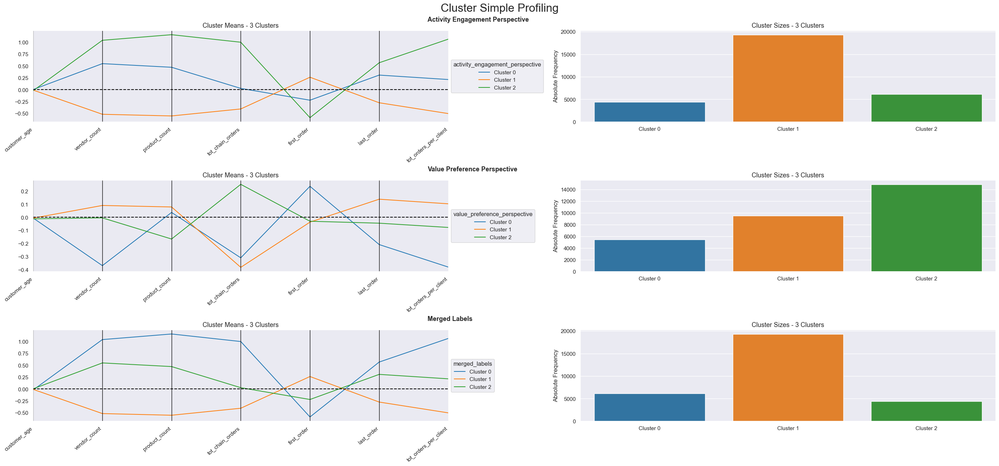

In [926]:
cluster_profiles(
    df=df_profiling_final[unused_numerical_features + ["activity_engagement_perspective","value_preference_perspective","merged_labels"]],
    label_columns=["activity_engagement_perspective","value_preference_perspective", "merged_labels"],
    figsize=(28, 13),
    compare_titles=["Activity Engagement Perspective","Value Preference Perspective", "Merged Labels"]
)

Descriptive statistics for each cluster using the real values instead of transformed and scaled ones

In [927]:
# Set display options to show more rows and columns
pd.set_option('display.max_rows', None)  # None removes the row limit
pd.set_option('display.max_columns', None)  # None removes the column limit
pd.set_option('display.width', 1000)  # Adjust the width for better horizontal readability

# Run your descriptive stats function
merged_labels_statistics_activity_engagem_perspective = descriptive_stats_by_cluster(df_profiling_final[unused_numerical_features + ["activity_engagement_perspective","value_preference_perspective","merged_labels"]], 
                                             "merged_labels")


# Reset options to default after displaying
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')
pd.reset_option('display.width')

Descriptive Statistics by Cluster:


customer_age                                                                       vendor_count                                                                       product_count                                                                       tot_chain_orders                                                                       first_order                                                                       last_order                                                                       tot_orders_per_client                                                                       activity_engagement_perspective                                    value_preference_perspective                                             
                     count      mean       std       min       25%       50%       75%       max        count      mean       std       min       25%       50%       75%       max         count      mean       std       min       25%       50%       75%       max            count      mean       std       min       25%       50%       75%       max       count      mean       std       min       25%       50%       75%       max      count      mean       std       min       25%       50%       75%       max                 count      mean       std       min       25%       50%       75%       max                           count mean  std  min  25%  50%  75%  max                        count      mean       std  min  25%  50%  75%  max
merged_labels                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             
0                   6125.0 -0.020624  0.949006 -1.797494 -0.643682 -0.211003  0.365903  5.125376       6125.0  1.039687  0.825205 -1.130809  0.776723  1.156280  1.477190  3.443369        6125.0  1.157526  0.588564  0.070311  0.602600  1.166850  1.581902  3.102827           6125.0  0.998936  1.183155 -0.854503  0.169951  0.852920  1.535889  6.316672      6125.0 -0.588703  0.624339 -1.204971 -1.037275 -0.785729 -0.324563  2.316662     6125.0  0.566818  0.581429 -2.453366  0.301898  0.775458  0.990713  1.119866                6125.0  1.064630  0.874641  0.035897  0.316440  0.877525  1.438611  5.085668                          6125.0  2.0  0.0  2.0  2.0  2.0  2.0  2.0                       6125.0  1.513633  0.595831  0.0  1.0  2.0  2.0  2.0
1                  19303.0 -0.007907  0.998587 -1.797494 -0.715796 -0.211003  0.510129  5.702281      19303.0 -0.517100  0.605193 -1.130809 -1.130809 -0.286713 -0.286713  1.477190       19303.0 -0.552138  0.607602 -1.379235 -0.737800 -0.737800 -0.282696  1.699139          19303.0 -0.405087  0.379372 -0.854503 -0.854503 -0.513018 -0.171534  1.535889     19303.0  0.262452  1.033836 -1.204971 -0.618032  0.094679  1.058936  2.484359    19303.0 -0.274711  1.049441 -2.711672 -1.032683 -0.042510  0.603255  1.119866               19303.0 -0.502575  0.286643 -0.805732 -0.805732 -0.525189 -0.244646  0.877525                         19303.0  1.0  0.0  1.0  1.0  1.0  1.0  1.0                      19303.0  1.310366  0.795008  0.0  1.0  2.0  2.0  2.0
2                   4364.0  0.004180  0.984165 -1.797494 -0.643682 -0.211003  0.510129  5.558055       4364.0  0.548636  0.797033 -1.130809 -0.286713  0.312183  1.156280  3.063812        4364.0  0.472002  0.714793 -0.737800  0.070311  0.358738  1.000172  2.551816           4364.

Histograms of unused numerical features

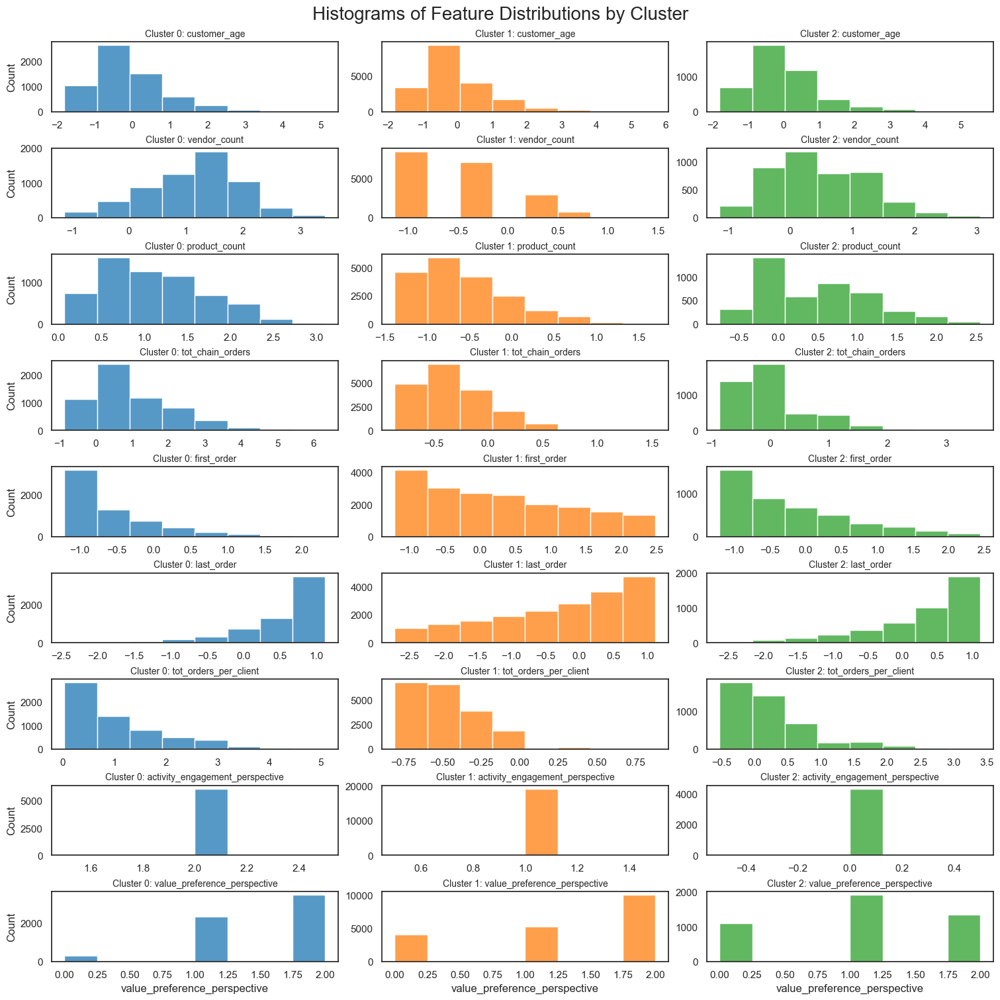

In [394]:
histograms_by_cluster(df_profiling_final[unused_numerical_features + ["activity_engagement_perspective","value_preference_perspective","merged_labels"]], "merged_labels", bins=8, figsize=(15, 10))

> The cluster profiling was done on the final report


Boxplots for unused numerical features

/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(x=label_column, y=feature, data=df, palette=sns.color_palette(cmap), ax=ax)
/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:151: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.boxplot(

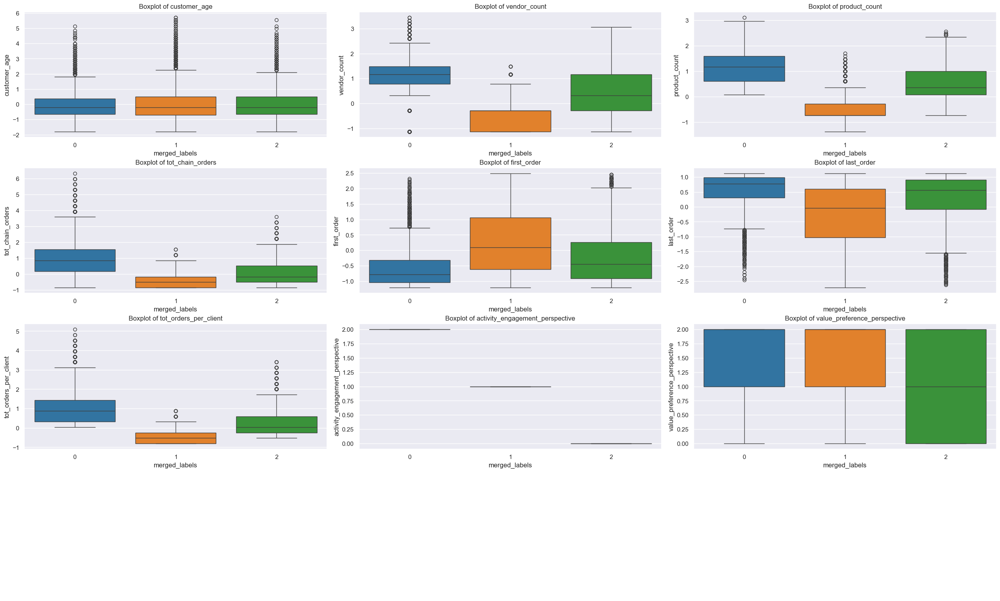

In [929]:
boxplots_by_cluster(df_profiling_final[unused_numerical_features + ["activity_engagement_perspective","value_preference_perspective","merged_labels"]], "merged_labels", figsize=(25, 15))

## 8.4 Visualyzing Final Cluster Solution



### 8.4.1 T-SNE

In [930]:
t_sne_visualization = TSNE(random_state=2024).fit_transform(df_profiling_final[features_used_clustering_both_perspectives])

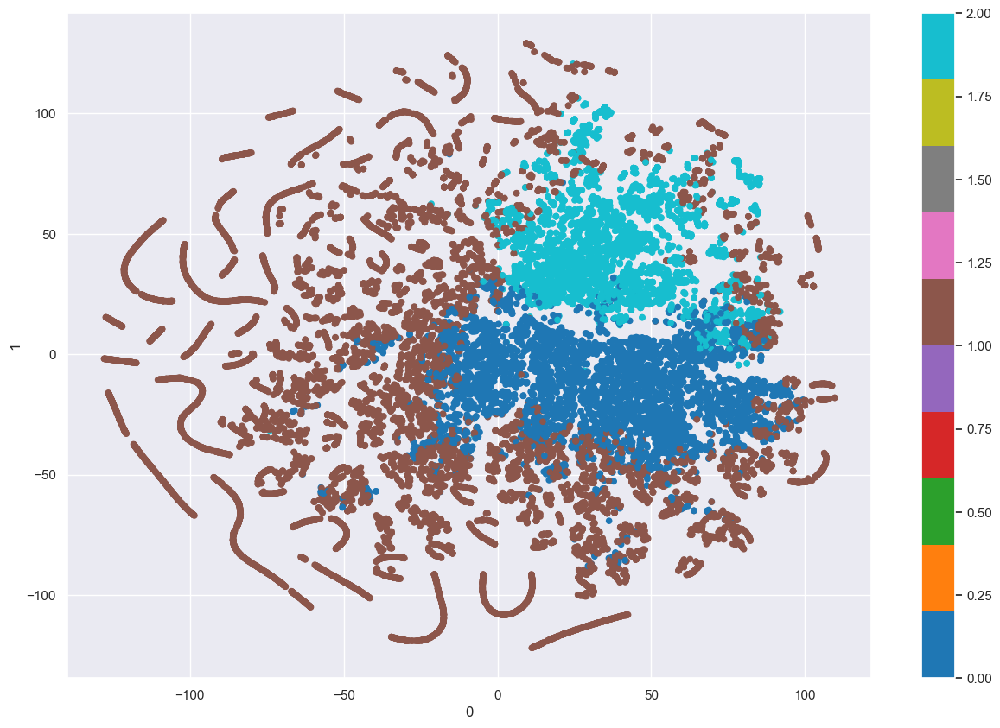

In [931]:
pd.DataFrame(t_sne_visualization).plot.scatter(x=0, y=1, c=df_profiling_final['merged_labels'], colormap='tab10', figsize=(15,10))
plt.show()

> The result was interpreted in the final report.

## 8.5 Feature Importance



In [933]:
df_feature_importance = df_profiling_final.copy()

### 8.5.1 Semi-Supervised Classification - Decision Tree

1. Going to exclusively use numerical features used during the clustering process since we want to determine the most important features used in the clustering process.

Training the model

In [934]:
# Preparing the data for the feature importance analysis
X = df_feature_importance[features_used_clustering_both_perspectives]
y = df_feature_importance['merged_labels']

# Spliting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=2024)

# Fitting the Decision Tree Classifier

dt = DecisionTreeClassifier(random_state=2024, max_depth=4)
dt.fit(X_train, y_train)
score = dt.score(X_test, y_test)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(score*100))

It is estimated that in average, we are able to predict 91.91% of the customers correctly


In [ ]:
#dump(dt, '/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/Web Application/models/decision_tree_model.pkl')

['/Users/joaohenriques/Desktop/Mestrados/Data Science Nova IMS/My docs/Data Mining/Project/DM_Project/Web Application/models/decision_tree_model.pkl']

In [935]:
df_activity_engagement_perspective_fs.columns

Index(['peak_days_num_orders', 'off_peak_days_num_orders',
       'morning_num_orders', 'afternoon_num_orders', 'evening_num_orders',
       'night_num_orders', 'activity_engagement_perspective'],
      dtype='object')

In [936]:
df_value_preference_perspective_fs.columns

Index(['tot_money_spent_per_client', 'avg_money_spent_per_order',
       'avg_products_per_order', 'tot_non_chain_orders',
       'percent_chain_orders', 'num_unique_cuisines_tried',
       'value_preference_perspective'],
      dtype='object')

Assessing feature importance

In [937]:
pd.Series(dt.feature_importances_, index=X_train.columns).sort_values(ascending=False)

off_peak_days_num_orders      0.390110
night_num_orders              0.382605
peak_days_num_orders          0.210806
evening_num_orders            0.011189
afternoon_num_orders          0.005290
tot_money_spent_per_client    0.000000
avg_money_spent_per_order     0.000000
avg_products_per_order        0.000000
tot_non_chain_orders          0.000000
percent_chain_orders          0.000000
num_unique_cuisines_tried     0.000000
morning_num_orders            0.000000
dtype: float64

Notes

> As we can see, only the following five features are relevant for the splitting process. All the others are deemed redundant:
> 1. Number of orders made during off-peak days of the week (off_peak_days_num_orders)
> 2. Number of orders made during the night (night_num_orders)
> 3. Number of orders made during peak days of the week (peak_days_num_orders)
> 4. Number of orders made during the evening (evening_num_orders)
> 5. Number of orders made during the afternoon (afternoon_num_orders)
>
> All relevant features belong to the activity engagement perspective. This is a clear indication that the activity engagement perspective is the most important perspective for the clustering process, indicating a clustering process domination.
>
> This situation might have happened for multiple reasons such as:
>
> 1. Clusters in the activity and engagement perspective could be more distinct or more well-separated than the ones in the value preference perspective.
> 2. There could be minimal variation in value and preference features across clusters in the merged solution, leading to their importance being negligible.


Visualizing the decision tree

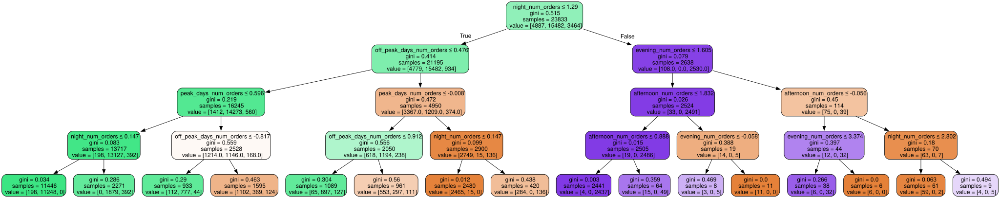

In [938]:
dot_data = export_graphviz(dt, out_file=None, 
                            feature_names=X.columns.to_list(),
                            filled=True,
                            rounded=True,
                           special_characters=True)
g = graphviz.Source(dot_data)
g

## 8.6 Outlier classification prediction



Univariate outliers

In [939]:
"""
clients_in_df_na_removed = set(df_na_removed.index)
clients_in_df_without_outliers = set(df_outliers_999th_percentil.index)
clients_removed = clients_in_df_na_removed - clients_in_df_without_outliers

df_univariate_outliers = df_na_removed[df_na_removed.index.isin(clients_removed)][numeric_features]


# Scaling univariate outliers
df_univariate_outliers_scaled = standard_scaler.fit_transform(df_univariate_outliers)
df_univariate_outliers_scaled
"""

'\nclients_in_df_na_removed = set(df_na_removed.index)\nclients_in_df_without_outliers = set(df_outliers_999th_percentil.index)\nclients_removed = clients_in_df_na_removed - clients_in_df_without_outliers\n\ndf_univariate_outliers = df_na_removed[df_na_removed.index.isin(clients_removed)][numeric_features]\n\n\n# Scaling univariate outliers\ndf_univariate_outliers_scaled = standard_scaler.fit_transform(df_univariate_outliers)\ndf_univariate_outliers_scaled\n'

> Since the univariate outliers were removed before feature creation, they were not present during the feature creation process. Therefore, they don't have the required features for us to predict their clusters.
>
> Hence, we will proceed only with the prediction for the multivariate outliers.

Making prediction for the Multivariate Outliers 

In [940]:
df_multivariate_outliers = df_scaled_mo[features_used_clustering_both_perspectives]
df_multivariate_outliers.describe()

,tot_money_spent_per_client,avg_money_spent_per_order,avg_products_per_order,tot_non_chain_orders,percent_chain_orders,num_unique_cuisines_tried,peak_days_num_orders,off_peak_days_num_orders,morning_num_orders,afternoon_num_orders,evening_num_orders,night_num_orders
count,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000
mean,2.995365,0.006028,0.572813,2.764184,-0.171596,1.975168,2.032312,2.277684,1.682754,2.745898,1.495195,0.565786
std,1.969390,1.056716,1.849001,2.664314,0.820940,1.726556,1.200916,1.106841,1.616869,2.302656,1.802185,1.636220
min,-0.844412,-2.717101,-0.708658,-0.700124,-1.615031,-0.877122,-1.308366,-1.253019,-0.816956,-0.763958,-0.617702,-0.521954
25%,1.556273,-0.717218,-0.283258,0.322158,-0.894956,0.570447,1.291586,1.726191,0.186779,1.123873,-0.617702,-0.521954
50%,2.593650,-0.147202,0.044654,2.366721,-0.114875,2.018016,2.251150,2.597554,1.902676,2.539747,1.296792,-0.521954
75%,4.075827,0.446557,0.549047,4.922426,0.550608,3.465584,2.931973,3.077100,3.167234,4.427579,2.842468,1.765054
max,11.442765,3.971781,11.344347,11.567256,0.956666,6.360722,4.366440,4.087159,5.229114,9.147158,5.451100,5.898489


> As we can see, the multivariate outliers don't seem scaled even though we applied the StandardScaler. This is happening because we applied the scaling process to the entire dataset and then selected a small subset using DBSCAN corresponding to the multivariate outliers.
>
> Considering this, we have two solutions:
> 1. Re-scale the data again, possibly distorting the data since we would apply two scaling operations to the multivariate outliers.
> 2. Determine the index of multivariate outliers in the original dataset and then scale only these observations to ensure consistency.

Obtaining multivariate outliers subset from real values DataFrame

In [941]:
df_multivariate_outliers_real_values = df_feature_creation[dbscan_clusters == -1]
df_multivariate_outliers_real_values = df_multivariate_outliers_real_values[features_used_clustering_both_perspectives]
df_multivariate_outliers_real_values.describe()

,tot_money_spent_per_client,avg_money_spent_per_order,avg_products_per_order,tot_non_chain_orders,percent_chain_orders,num_unique_cuisines_tried,peak_days_num_orders,off_peak_days_num_orders,morning_num_orders,afternoon_num_orders,evening_num_orders,night_num_orders
count,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000,625.00000,625.000000
mean,135.599264,11.226319,1.531598,6.777600,56.127728,4.940800,7.179200,9.507200,4.689600,7.436800,3.32640,1.233600
std,66.767897,13.013018,0.767029,5.212486,31.922122,2.385456,4.017177,4.552792,4.031881,4.878944,3.60631,2.210078
min,5.420000,0.774286,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
25%,86.810000,5.015500,1.176471,2.000000,28.000000,3.000000,4.000000,6.000000,1.000000,4.000000,0.00000,0.000000
50%,121.980000,7.519333,1.312500,6.000000,58.333333,5.000000,7.000000,10.000000,4.000000,7.000000,2.00000,0.000000
75%,172.230000,11.241500,1.521739,11.000000,84.210526,7.000000,10.000000,13.000000,8.000000,11.000000,5.00000,2.000000
max,421.990000,104.320000,6.000000,24.000000,100.000000,11.000000,20.000000,22.000000,21.000000,21.000000,16.00000,12.000000


Obtaining scaled values with only the columns used for clustering 

In [942]:
scaler = StandardScaler()
scaled_multivariate_outliers = scaler.fit_transform(df_multivariate_outliers_real_values)
df_scaled_multivariate_outliers = pd.DataFrame(
    scaled_multivariate_outliers,
    columns=df_multivariate_outliers_real_values.columns,
    index=df_multivariate_outliers_real_values.index
)
df_scaled_multivariate_outliers.describe()

,tot_money_spent_per_client,avg_money_spent_per_order,avg_products_per_order,tot_non_chain_orders,percent_chain_orders,num_unique_cuisines_tried,peak_days_num_orders,off_peak_days_num_orders,morning_num_orders,afternoon_num_orders,evening_num_orders,night_num_orders
count,6.250000e+02,6.250000e+02,6.250000e+02,6.250000e+02,6.250000e+02,6.250000e+02,6.250000e+02,6.250000e+02,6.250000e+02,6.250000e+02,6.250000e+02,6.250000e+02
mean,-8.526513e-17,9.094947e-17,-9.094947e-17,6.821210e-17,-3.410605e-17,-1.477929e-16,4.547474e-17,1.591616e-16,-1.023182e-16,4.547474e-17,1.136868e-17,8.526513e-18
std,1.000801e+00,1.000801e+00,1.000801e+00,1.000801e+00,1.000801e+00,1.000801e+00,1.000801e+00,1.000801e+00,1.000801e+00,1.000801e+00,1.000801e+00,1.000801e+00
min,-1.951290e+00,-8.038416e-01,-6.936165e-01,-1.301304e+00,-1.759679e+00,-1.653334e+00,-1.788557e+00,-2.089886e+00,-1.164061e+00,-1.525485e+00,-9.231221e-01,-5.586173e-01
25%,-7.313147e-01,-4.776597e-01,-4.633619e-01,-9.173025e-01,-8.818417e-01,-8.142487e-01,-7.920355e-01,-7.709575e-01,-9.158394e-01,-7.049790e-01,-9.231221e-01,-5.586173e-01
50%,-2.041426e-01,-2.850957e-01,-2.858740e-01,-1.492997e-01,6.914866e-02,2.483694e-02,-4.464417e-02,1.083280e-01,-1.711738e-01,-8.959928e-02,-3.680944e-01,-5.586173e-01
75%,5.490674e-01,1.167509e-03,-1.286384e-02,8.107038e-01,8.804331e-01,8.639226e-01,7.027471e-01,7.677921e-01,8.217137e-01,7.309070e-01,4.644472e-01,3.470528e-01
max,4.292783e+00,7.159618e+00,5.830263e+00,3.306713e+00,1.375454e+00,2.542094e+00,3.194052e+00,2.746185e+00,4.048598e+00,2.782173e+00,3.517099e+00,4.875403e+00


Predicting the cluster labels of the outliers and analysing them 

In [943]:
df_scaled_multivariate_outliers["merged_labels"] = dt.predict(df_scaled_multivariate_outliers)

/var/folders/gm/vll5hdf55pq69ynclc1r1f0m0000gn/T/ipykernel_96085/3550129269.py:37: UserWarning: The palette list has more values (10) than needed (3), which may not be intended.
  sns.barplot(x=label,


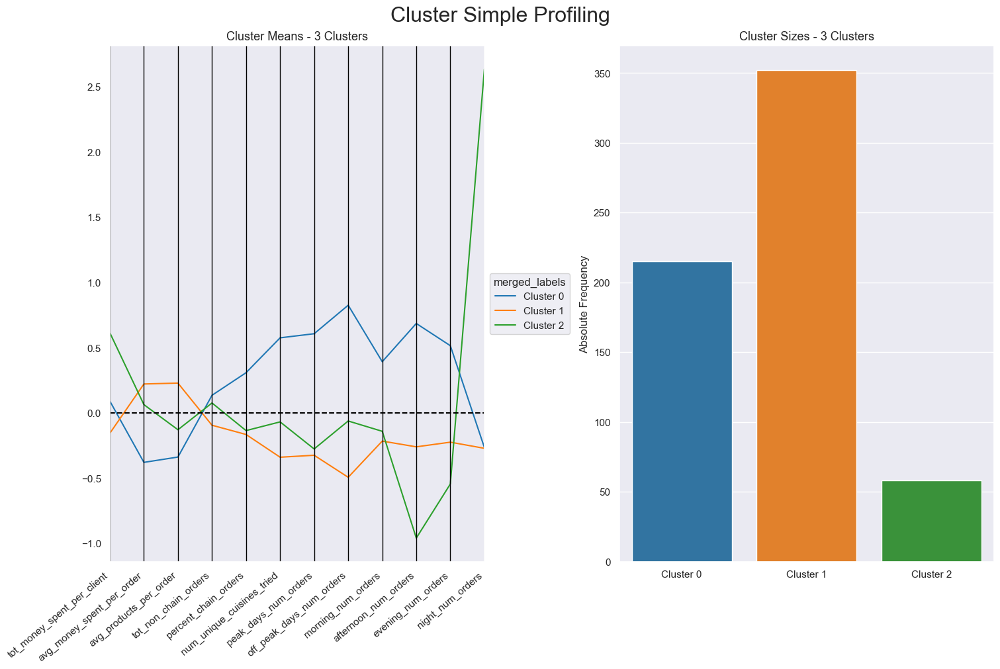

In [944]:
cluster_profiles(df_scaled_multivariate_outliers, ["merged_labels"], figsize=(15, 10))

# **🔗 Bibliography/References**

* Alizade, M., Kheni, R., Price, S. et al. A Comparative Study of Clustering Methods for Nanoindentation Mapping Data. Integr Mater Manuf Innov 13, 526–540 (2024). https://doi.org/10.1007/s40192-024-00349-3
* “Calinski_harabasz_score.” Scikit-Learn.org, 2024, scikit-learn.org/stable/modules/generated/sklearn.metrics.calinski_harabasz_score.html.
* Caliński, Tadeusz & JA, Harabasz. (1974). A Dendrite Method for Cluster Analysis. Communications in Statistics - Theory and Methods. 3. 1-27. 10.1080/03610927408827101.
* Forest, Florent, et al. “A Survey and Implementation of Performance Metrics for Self-Organized Maps.” ArXiv.org, 2020, arxiv.org/abs/2011.05847.
* Martinez-Plumed, Fernando, et al. “CRISP-DM Twenty Years Later: From Data Mining Processes to Data Science Trajectories.” IEEE Transactions on Knowledge and Data Engineering, vol. 33, no. 8, 2020, p. 1.
* Osborne, Jason. “Notes on the Use of Data Transformations.” Practical Assessment, Research & Evaluation, vol. 8, 5 Mar. 2002, www.researchgate.net/publication/200152356_Notes_on_the_Use_of_Data_Transformation
* Rojas, Ignacio , et al. Advances in Computational Intelligence. Lecture Notes in Computer Science, Springer Science+Business Media, 1 Jan. 2015.
* Schröer, Christoph, et al. “A Systematic Literature Review on Applying CRISP-DM Process Model.” Procedia Computer Science, vol. 181, no. 1, 2021, pp. 526–534, www.sciencedirect.com/science/article/pii/S1877050921002416, https://doi.org/10.1016/j.procs.2021.01.199.
* van Leeuwen, Rik, and Ger Koole. “Data-Driven Market Segmentation in Hospitality Using Unsupervised Machine Learning.” Machine Learning with Applications, Sept. 2022, p. 100414, https://doi.org/10.1016/j.mlwa.2022.100414.
* Vesanto, J., and E. Alhoniemi. “Clustering of the Self-Organizing Map.” IEEE Transactions on Neural Networks, vol. 11, no. 3, May 2000, pp. 586–600, https://doi.org/10.1109/72.846731.

